# RaceID3 on E725 data

In [1]:
prdata <- readRDS("source/E725.quantif.matrix")
dim(prdata)

[1] 26939   381

In [80]:
suppressPackageStartupMessages(source("source/RaceID3_StemID2_class.R"))

In [81]:
head(prdata)

,B1_1,B1_2,B1_3,B1_4,B1_5,B1_6,B1_8,B1_9,B1_10,B1_11,⋯,B8_125,B8_129,B8_145,B8_148,B8_154,B8_161,B8_164,B8_169,B8_173,B8_180
0610007P14Rik,0,0,1,4,0,1,0,0,1,1,⋯,4,2,2,0,0,3,0,0,1,1
0610009B22Rik,0,3,4,3,1,4,0,0,1,1,⋯,1,4,1,2,0,2,0,1,0,1
0610009E02Rik,0,0,0,0,0,0,0,0,0,0,⋯,0,0,0,0,0,0,0,0,0,0
0610009L18Rik,0,0,0,0,0,0,0,0,0,0,⋯,0,0,0,0,0,0,0,0,0,0
0610009O20Rik,0,1,0,0,0,1,0,0,0,0,⋯,0,0,0,0,0,2,0,0,0,1
0610010F05Rik,1,0,0,1,0,0,0,0,0,0,⋯,2,0,0,0,0,0,0,0,1,2


## Filtering

Let's have a quick look at the data and see if we can derive any filtering thresholds

In [82]:
sc <- SCseq(data.frame(prdata))

In [70]:
suppressPackageStartupMessages(library(scater))

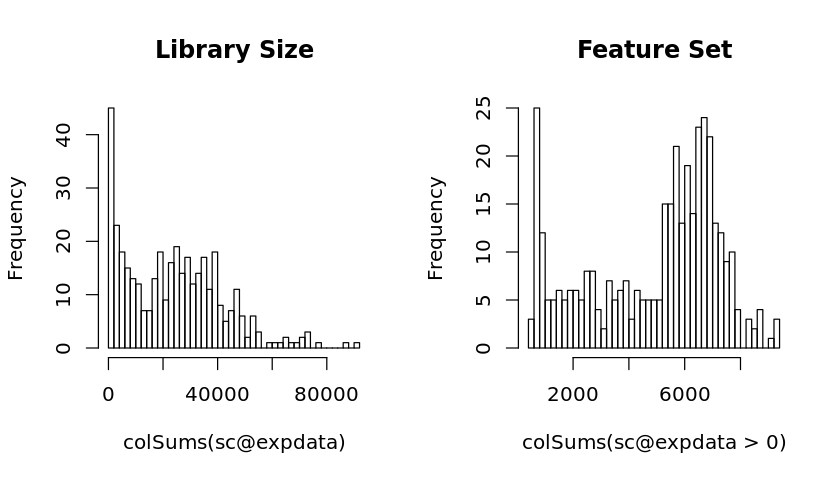

In [83]:
options(repr.plot.height = 4)
par(mfrow=c(1,2))
hist(colSums(sc@expdata), breaks = 50, main = "Library Size")
hist(colSums(sc@expdata > 0), breaks = 50, main = "Feature Set")

Let us first try to derive lower limits based on median absolute deviation, discarding any cells that fall out 3 MADs in either library size or feature set size.

In [84]:
libsize.drop <- isOutlier(colSums(sc@expdata), nmads = 3, type="lower", log = T)
feature.drop <- isOutlier(colSums(sc@expdata > 0), nmads = 3, type="lower", log = T)

In [85]:
tab <- c(sum(libsize.drop), sum(feature.drop), sum(feature.drop | libsize.drop))
names(tab) <- c("Cells < 3 MADS libsize", "Cells < 3 MADs feature", "Cells < 3 MADs both")
tab

Cells < 3 MADS libsize Cells < 3 MADs feature    Cells < 3 MADs both 
                    43                     71                     71

In [86]:
## Attempt to find MAD limits
library(stats)

getMadLowerLim <- function(nmads, submetric, type, min_diff=NA){
    cur.med <- median(submetric, na.rm = TRUE)
    cur.mad <- mad(submetric, center = cur.med, na.rm = TRUE)

    diff.val <- max(min_diff, nmads * cur.mad, na.rm = TRUE)
    upper.limit <- cur.med + diff.val 
    lower.limit <- cur.med - diff.val 
    
    if (type == "lower") {
        upper.limit <- Inf
    } else if (type == "higher") {
        lower.limit <- -Inf
    }
    cat(lower.limit, upper.limit)
    return(submetric < lower.limit | upper.limit < submetric)    
}

#mad(colSums(sc@expdata), constant = 3, low = T)
sum(getMadLowerLim(1, colSums(sc@expdata), "lower"))

2086.962 Inf

[1] 45

In [87]:
# Define our genes of interest
is.embryonic_stemcell <- c("Nanog") # Oct-4 is a marker for Pou5f1
is.mesoderm <- c("Eomes", "T", "Mesp1")
is.antviscendo <- c("Cer1", "Lefty1")
is.neuroectoderm <- c("Sox1", "Sox2", "Pou3f1", "Zfp462", "Slc7a3")

genes_of_interest <- c(is.embryonic_stemcell, is.mesoderm, is.antviscendo, is.neuroectoderm)

The idea here is to filter without losing our genes of interest.

In [88]:
# Attempt different filtering levels
sc3 <- filterdata(
    sc, mintotal=3000, minexpr=5, maxexpr=500, 
    downsample = F, sfn = F, hkn = F,
    dsn = 1, rseed = 17000, CGenes = NULL, FGenes = NULL
)
sc3Inf <- filterdata(
    sc, mintotal=3000, minexpr=5, maxexpr=Inf,
    downsample = F, sfn = F, hkn = F,
    dsn = 1, rseed = 17000, CGenes = NULL, FGenes = NULL
)


sc4 <- filterdata(
    sc, mintotal=4000, minexpr=5, maxexpr=500, 
    downsample = F, sfn = F, hkn = F,
    dsn = 1, rseed = 17000, CGenes = NULL, FGenes = NULL
)

sc4Inf <- filterdata(
    sc, mintotal=4000, minexpr=5, maxexpr=Inf,
    downsample = F, sfn = F, hkn = F,
    dsn = 1, rseed = 17000, CGenes = NULL, FGenes = NULL
)

sc5 <- filterdata(
    sc, mintotal=5000, minexpr=5, maxexpr=500,
    downsample = F, sfn = F, hkn = F,
    dsn = 1, rseed = 17000, CGenes = NULL, FGenes = NULL
)

sc5Inf <- filterdata(
    sc, mintotal=5000, minexpr=5, maxexpr=Inf,
    downsample = F, sfn = F, hkn = F,
    dsn = 1, rseed = 17000, CGenes = NULL, FGenes = NULL
)



In [89]:
rowShow <- function(xer, one=F){
    den <- dim(xer@fdata)
    if (one){
        den <- c(dim(xer@fdata)[1],389)
    }
    res <- c(
        den,
        paste(genes_of_interest[genes_of_interest %in% rownames(xer@fdata)], collapse=", ")
    )
    return(res)
}

out <- rbind(
    rowShow(sc,T),
    rowShow(sc3),
    rowShow(sc3Inf),
    rowShow(sc4),
    rowShow(sc4Inf),
    rowShow(sc5),
    rowShow(sc5Inf)
#    dim(control_sc@fdata)
)
rownames(out) <- c("sc","sc3","sc3+Inf", "sc4", "sc4+Inf", "sc5", "sc5+Inf")
colnames(out) <- c("Genes", "Cells", "Genes of interest")

out


,Genes,Cells,Genes of interest
sc,26939,389,"Nanog, Eomes, T, Mesp1, Cer1, Lefty1, Sox1, Sox2, Pou3f1, Zfp462, Slc7a3"
sc3,392,326,"T, Mesp1, Cer1"
sc3+Inf,392,326,"T, Mesp1, Cer1"
sc4,610,313,"Eomes, T, Mesp1, Cer1, Sox2, Slc7a3"
sc4+Inf,610,313,"Eomes, T, Mesp1, Cer1, Sox2, Slc7a3"
sc5,863,304,"Eomes, T, Mesp1, Cer1, Sox2, Slc7a3"
sc5+Inf,863,304,"Eomes, T, Mesp1, Cer1, Sox2, Slc7a3"


Let us see how much we can extend the mintotal limit until we can recapitulate our genes of interest.

## Filtering Thresholds

We must be careful with the filtering; too much and we lose variability, too little and we lose genes/markers of interest.

In [91]:
limits <- seq(1000,25000, by = 1000)

zzz <- lapply(limits, function(x){
    #print(x)
    res <- filterdata(
        sc, mintotal=x, maxexpr=500,
        downsample = F, sfn = F, hkn = F,
        dsn = 1, rseed = 17000, CGenes = NULL, FGenes = NULL
    )
    return(res)
})



In [334]:
tab <- matrix(unlist(lapply(zzz, rowShow)), nrow=3)
colnames(tab) <- limits
rownames(tab) <- c("Genes", "Cells", "GOI")

t(tab)



,Genes,Cells,GOI
1000,91,365,T
2000,262,336,T
3000,393,326,"T, Mesp1, Cer1"
4000,571,314,"Eomes, T, Mesp1, Cer1, Sox2, Slc7a3"
5000,868,304,"Eomes, T, Mesp1, Cer1, Sox2, Slc7a3"
6000,1042,295,"Eomes, T, Mesp1, Cer1, Sox2, Slc7a3"
7000,1247,288,"Nanog, Eomes, T, Mesp1, Cer1, Sox2, Slc7a3"
8000,1552,280,"Nanog, Eomes, T, Mesp1, Cer1, Sox2, Slc7a3"
9000,1861,275,"Nanog, Eomes, T, Mesp1, Cer1, Sox2, Zfp462, Slc7a3"
10000,1982,267,"Nanog, Eomes, T, Mesp1, Cer1, Sox2, Pou3f1, Zfp462, Slc7a3"


Interestingly:
* The number of cells *decreases* with higher mintotal limits, as expected.
* The number genes *increases* with higher mintotals limits, suggesting that genes are filtered based on the expression of remaining cells, which have a higher proportion of differentially expressed genes
* Lefty1 is not recuperated at any filtering threshold -- not a sig DE gene at any threshold.


### How to proceed

The default limit of > 3000 only seems to keep 3 of our genes of interest, so we will choose a threshold that at least keeps Nanog within scope, namely > 7000.

However we must first remove genes that are of no interest to us (cell cycle/proliferation)

In [93]:
our_sc <- filterdata(
    sc, mintotal= 7000, maxexpr=500,
    downsample = F, sfn = F, hkn = F,
    dsn = 1, rseed = 17000, CGenes = NULL, FGenes = NULL
)

In [ ]:
# Quick plot of our top 50 most differentially expressed genes

In [95]:
sce_o <- SingleCellExperiment(assays=list(counts=as.matrix(our_sc@fdata)))

In [96]:
sce_o <- calculateQCMetrics(sce_o)

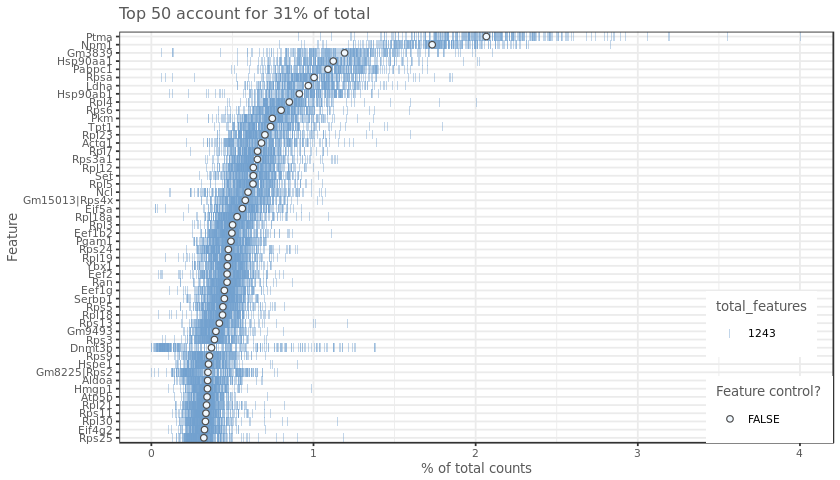

In [97]:
plotQC(sce_o, type="high")

## Cell Cycle removal

### ccCleaner + Biomart

In [130]:
require(biomaRt)
# Annotate the data before adding SC experiment

mart <- useMart(biomart = "ENSEMBL_MART_ENSEMBL", 
                dataset = "mmusculus_gene_ensembl")

k <- getBM(
    filters = "mgi_symbol",
    attributes = c(
            "ensembl_gene_id",              # Gene stable ID
            "external_gene_name",           # Casual name
            "mgi_symbol",
#            "external_transcript_name",     # Transcript-specific name
#            "gene_biotype",                 # Gene biotype
#            "transcript_biotype",           # Trans type
#            "description",                  # Gene description
#            "band",                         # Karyotype band
#            "refseq_mrna",
            "go_id",                        # Go Term accession (cellular domains)
#            "go_linkage_type",              # Go Term evidence code
            "name_1006"                    # Go Term name
#            "definition_1006",              # Go Term definition
#            "namespace_1003"                # Go domain                  
    ),
    values = rownames(our_sc@fdata),
    mart = mart
)

In [101]:
known_cgenes <- c("Mki67", "Pcna-ps2")  # mentioned in vignette
known_fgenes <- c("Hsp90aa1")           # seems to saturate plots

known_cgenes[known_cgenes %in% rownames(our_sc@fdata)]
known_fgenes[known_fgenes %in% rownames(our_sc@fdata)]

[1] "Pcna-ps2"

[1] "Hsp90aa1"

In [143]:
# Two of our cc genes (Lars2 and Pcna-ps2) need to be regressed out


# A quick scout of other potential genes to remove
unique(k[k$name_1006 == "cell cycle",]$mgi_symbol)
unique(k[k$name_1006 == "cell proliferation",]$mgi_symbol)
#unique(k[k$name_1006 == "cell differentiation",]$mgi_symbol)

[1] "Lars2"    "Pcna-ps2"

[1] "Ajuba"   "Anapc13" "Anapc5"  "Arf6"    "Birc5"   "Bub3"    "Ccar1"  
 [8] "Ccna2"   "Ccnb1"   "Ccnd2"   "Ccnf"    "Ccng1"   "Ccno"    "Cd2ap"  
[15] "Cdc123"  "Cdc34"   "Cdk1"    "Cdk2ap1" "Cdk4"    "Cdkn1a"  "Cdkn1b" 
[22] "Cdkn1c"  "Cetn3"   "Cks1b"   "Cks2"    "Cltc"    "Csnk1a1" "Csnk2a1"
[29] "Dbf4"    "Dync1h1" "Erh"     "Fbxo5"   "Gas1"    "Gnai2"   "Hcfc1"  
[36] "Hells"   "Hmga2"   "Hnrnpu"  "Kif20b"  "Kif23"   "Mad2l1"  "Maea"   
[43] "Mapk3"   "Mapre1"  "Mcm3"    "Mcm4"    "Mcm6"    "Mcm7"    "Mlf1"   
[50] "Msh2"    "Nasp"    "Nipbl"   "Nsun2"   "Nudc"    "Pcnp"    "Pim2"   
[57] "Pin1"    "Plk1"    "Ppp1ca"  "Ppp1cc"  "Ppp2r2d" "Psme3"   "Ptp4a1" 
[64] "Rad21"   "Ran"     "Rb1cc1"  "Rcc1"    "Rcc2"    "Rif1"    "Rps3"   
[71] "Seh1l"   "Sept11"  "Sept2"   "Smc1a"   "Smc2"    "Smc3"    "Smc4"   
[78] "Spc24"   "Spin2c"  "Suv39h1" "Tbrg1"   "Tlk2"    "Tpr"     "Tpx2"   
[85] "Uba3"    "Ube2c"   "Ube2i"   "Ube2s"   "Uhrf2"   "Wapl"    "Zfp207" 
[92] "Zwint"

[1] "Cdk1"    "Cited2"  "Cks1b"   "Cks2"    "Cops2"   "Ctnnb1"  "Cul1"   
 [8] "Ddit4"   "Foxc2"   "Gbx2"    "Glul"    "Gnai2"   "Gnb1"    "Gnl3"   
[15] "Gpx1"    "H3f3a"   "H3f3b"   "Hmga2"   "Larp1"   "Lrp2"    "Mcm7"   
[22] "Morf4l1" "Myh10"   "Nanog"   "Nasp"    "Pim1"    "Prkar1a" "Pura"   
[29] "Rap1b"   "Smad4"   "Sox11"   "Tcf7l2"  "Ube2l3"  "Uhrf2"   "Wdr12"  
[36] "Zfp36l1"

Let us see how DE our remaining genes are.

In [162]:
sce <- SingleCellExperiment(assays=list(counts = as.matrix(our_sc@fdata)))

In [163]:
sce <- calculateQCMetrics(sce)

,B1_1,B1_2,B1_3,B1_4,B1_6,B1_10,B1_11,B1_13,B1_15,B1_17,⋯,B8_113,B8_121,B8_125,B8_129,B8_145,B8_148,B8_161,B8_169,B8_173,B8_180
1110004F10Rik,2.3686660,1.8292882,2.6766224,1.7895552,2.5397598,2.3184620,2.3090385,1.7670653,2.251907,2.5059145,⋯,1.3646703,1.9674978,1.6571412,2.3558980,1.746663,3.711108,1.5975280,1.541834,2.944586,1.7215676
1190002N15Rik,0.8558525,0.2919554,0.3144300,0.6627722,0.4047093,1.2085532,0.9832916,1.5816546,2.251907,1.7033548,⋯,0.3807975,0.3663942,0.2944763,0.4003086,0.100000,1.904672,0.3992129,0.820829,0.100000,0.6401263
1700016K19Rik,0.1000000,0.1000000,0.1000000,0.1000000,0.1000000,0.1000000,0.1000000,0.1000000,0.100000,0.6341905,⋯,0.1000000,0.1000000,0.1000000,0.1000000,0.100000,0.100000,0.1000000,0.100000,0.100000,0.1000000
1700019D03Rik,0.1000000,0.1000000,0.1000000,0.1000000,0.1000000,0.1000000,0.1000000,0.1000000,0.100000,0.1000000,⋯,0.3807975,0.6329187,2.8269982,0.1000000,1.297134,0.100000,0.2495882,0.100000,0.100000,0.1000000
1810022K09Rik,0.8558525,0.4839577,0.9580344,1.6016432,1.6242908,0.7649694,0.9832916,0.6552811,1.077422,0.9013836,⋯,1.5053611,1.8338928,0.4890000,1.4525454,1.297134,1.002115,0.8483064,1.541834,1.724882,0.8202564
1810058I24Rik,1.9903240,1.4446731,0.9580344,2.1655172,3.7614307,1.6523538,3.1934099,1.2109693,1.077422,1.1686420,⋯,1.0833919,1.7003206,1.4623320,1.7535155,2.046532,0.100000,1.2977294,2.263015,1.724882,0.4600402


[1] 1247

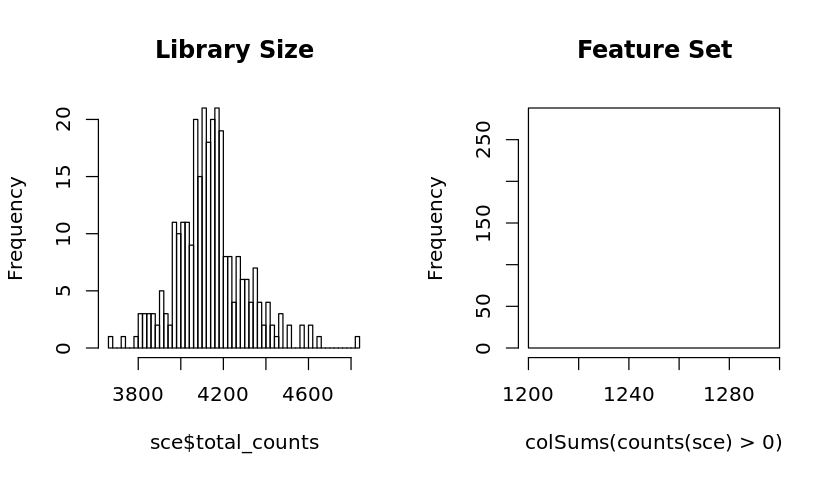

In [164]:
head(counts(sce))
options(repr.plot.height = 4)
par(mfrow=c(1,2))
hist(sce$total_counts, breaks = 50, main = "Library Size")
hist(colSums(counts(sce) > 0), breaks = 100, main = "Feature Set")

unique(colSums(counts(sce) > 0))

Feature set is empty because all cells have the same number of genes (1247)

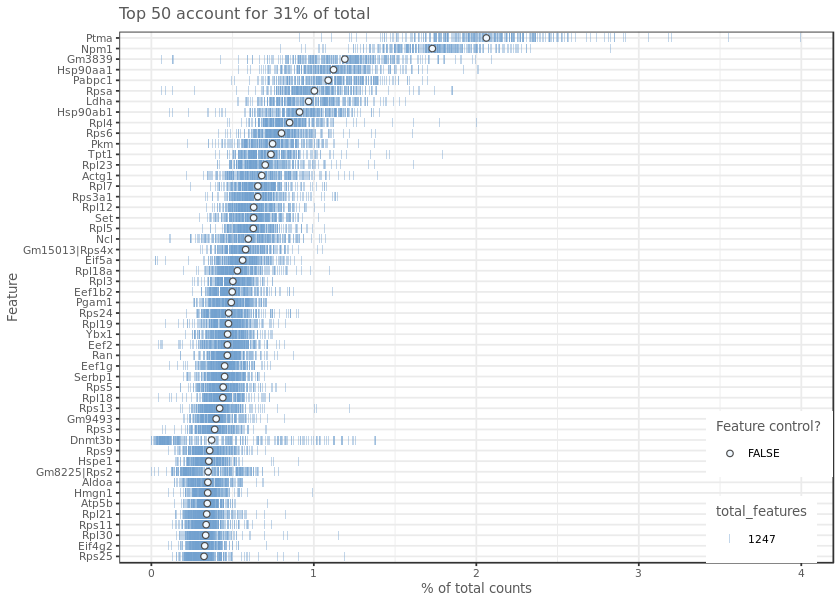

In [165]:
options(repr.plot.height = 5)
plotQC(sce, type = "high")

Ptma, Npm1, Gm3839, Hsp90aa1 are some of our most widely DE (both on filtered and normalised data)

#### Removing Ccycle genes

In [166]:
ccg <- unique(k[k$name_1006 == "cell cycle",]$mgi_symbol)
cpg <- unique(k[k$name_1006 == "cell proliferation",]$mgi_symbol)

vset <- unique(c(ccg,cpg))

length(vset)

x <- CCcorrect(
    our_sc@fdata,
    vset=vset,
    CGenes=NULL,
    ccor=.4, 
    nComp=NULL, pvalue=.05, quant=.01, mode="pca"
)

[1] 120

In [169]:
x$n

[1]  14  19  42  48  82 105 110 123 125 127 129 144 148 251 263 286  17  56
 [19]  75  79  89  90 103 106 154 157 164 171 194 210 240 272  83 135 145 155
 [37] 134 136 141 183 188 205 247 257 260 207 253  30  65  66  76  92 138 142
 [55] 170 201 227 282 237 243 258 276  10  21 162 215   5  23  46  86  93 114
 [73] 152 174 178 212 246   8  87 128 234 242 250  27  33  73  95  99 101 107
 [91] 108 111 121 139 156 180 187 208 232 248  45 140 209  29  43  74 167 214
[109] 273  81  18  58  97   7  31  57  69  78  98 102 146 166 177 190 223 230
[127]  68 109 115 120 122 150 159 179 184 211  36  38  44  49  54  62  67  80
[145]  85  88 131 161 186 189  25  28 130  16 169 255 254 283 281  35 149 185
[163] 193  61 133 163 172 176 204 216 274  20  50 119 137 235  24  53 259 264
[181]   2   9  22  39  70 117 206 285 198 245 268 271 233 287   3  12 196 220
[199]  11 175 181 231 225 261 113 143 279  94 203 241 280 147 217   1  13 126
[217] 197 218 226 228 200 191 267 244 288  41  72  91 112 256 165 275 284  51
[235] 221  37  40 219 277 182   6 116 173 269  15 100  26 199  64  55  59  63
[253]  71 151 192 195 252 266  52 222  34   4  96 278 238 239 160 213 124  32
[271] 158 224 118 132 202 249  77 153 265

Most components after the 14th PC have been removed.

In [170]:
head(our_sc@fdata)
head(x$xcor)

,B1_1,B1_2,B1_3,B1_4,B1_6,B1_10,B1_11,B1_13,B1_15,B1_17,⋯,B8_113,B8_121,B8_125,B8_129,B8_145,B8_148,B8_161,B8_169,B8_173,B8_180
1110004F10Rik,2.3686660,1.8292882,2.6766224,1.7895552,2.5397598,2.3184620,2.3090385,1.7670653,2.251907,2.5059145,⋯,1.3646703,1.9674978,1.6571412,2.3558980,1.746663,3.711108,1.5975280,1.541834,2.944586,1.7215676
1190002N15Rik,0.8558525,0.2919554,0.3144300,0.6627722,0.4047093,1.2085532,0.9832916,1.5816546,2.251907,1.7033548,⋯,0.3807975,0.3663942,0.2944763,0.4003086,0.100000,1.904672,0.3992129,0.820829,0.100000,0.6401263
1700016K19Rik,0.1000000,0.1000000,0.1000000,0.1000000,0.1000000,0.1000000,0.1000000,0.1000000,0.100000,0.6341905,⋯,0.1000000,0.1000000,0.1000000,0.1000000,0.100000,0.100000,0.1000000,0.100000,0.100000,0.1000000
1700019D03Rik,0.1000000,0.1000000,0.1000000,0.1000000,0.1000000,0.1000000,0.1000000,0.1000000,0.100000,0.1000000,⋯,0.3807975,0.6329187,2.8269982,0.1000000,1.297134,0.100000,0.2495882,0.100000,0.100000,0.1000000
1810022K09Rik,0.8558525,0.4839577,0.9580344,1.6016432,1.6242908,0.7649694,0.9832916,0.6552811,1.077422,0.9013836,⋯,1.5053611,1.8338928,0.4890000,1.4525454,1.297134,1.002115,0.8483064,1.541834,1.724882,0.8202564
1810058I24Rik,1.9903240,1.4446731,0.9580344,2.1655172,3.7614307,1.6523538,3.1934099,1.2109693,1.077422,1.1686420,⋯,1.0833919,1.7003206,1.4623320,1.7535155,2.046532,0.100000,1.2977294,2.263015,1.724882,0.4600402


,B1_1,B1_2,B1_3,B1_4,B1_6,B1_10,B1_11,B1_13,B1_15,B1_17,⋯,B8_113,B8_121,B8_125,B8_129,B8_145,B8_148,B8_161,B8_169,B8_173,B8_180
1110004F10Rik,1.6347784,1.7521134,1.7055151,1.6825199,1.7738941,1.8356859,1.8382808,1.8831140,1.5552503,1.6854869,⋯,1.6152149,1.8317441,1.7397894,1.8364311,1.7146275,1.6041334,1.6678084,1.5288844,1.7817070,1.7486294
1190002N15Rik,0.4711777,0.5942060,0.3314919,0.5413438,0.5472459,0.5060293,0.6334723,0.6324617,0.6367632,0.6078180,⋯,0.4590437,0.4577606,0.5469888,0.4707811,0.5591947,0.6280364,0.6329706,0.6509282,0.4828178,0.4964083
1700016K19Rik,0.1075363,0.1149761,0.1283131,0.1206091,0.1256996,0.1003556,0.1105552,0.1131812,0.1277636,0.1285713,⋯,0.1227402,0.1035197,0.1161611,0.1223290,0.1211662,0.1114791,0.1215967,0.1140827,0.1239689,0.1228853
1700019D03Rik,0.1880987,0.1980664,0.1818318,0.1746041,0.2000048,0.1964395,0.2211319,0.2111191,0.1935781,0.1748975,⋯,0.1520668,0.2010096,0.2648008,0.2235597,0.1970515,0.2105742,0.1777911,0.2182619,0.2198597,0.2087950
1810022K09Rik,0.9984707,0.9472844,1.0937599,1.0858693,0.9683029,1.0442731,0.8602862,0.9165632,0.9279611,1.1144569,⋯,1.1817703,0.9078024,0.7204973,0.8738120,0.9893488,0.8768616,1.1080816,0.7375663,0.8979643,0.8477121
1810058I24Rik,1.1014143,1.1987241,0.9788686,1.1064768,0.9848677,1.1089635,1.0238710,1.0410738,1.0516499,1.0470502,⋯,1.0826743,0.9302931,0.9310005,0.9495993,0.9782647,0.9736214,1.1401117,1.0170506,0.9159224,0.8906290


In [171]:
# Genes in the (first removed) 10th component 
y <- x$pca$rotation[,x$n[1]]
tail(y[order(y,decreasing=T)],10)

Csrp2        Dll1        Krt8      Gprc5c        Upp1       Dusp6 
-0.08202467 -0.08361286 -0.08454242 -0.08777319 -0.08820021 -0.10568122 
      Ap1s3        Bex1         Ezr       Krt18 
-0.10874841 -0.11432844 -0.11468263 -0.12015505

In [172]:
# copy and proceed with correction
suppressPackageStartupMessages(library(data.table))
sc_c <- copy(our_sc)

In [173]:
# Apply correction
sc_c@fdata <- x$xcor

### Remove batch effects

In [174]:
sc_e <- sc_c

In [179]:
batch_vars <- data.frame(
    row.names = names(sc_e@fdata),
    batch = sub("B([0-9]+)_.*", "\\1", names(sc_e@fdata))
)

t(rbind(head(batch_vars, 5), tail(batch_vars, 5)))

,B1_1,B1_2,B1_3,B1_4,B1_6,B8_148,B8_161,B8_169,B8_173,B8_180
batch,1,1,1,1,1,8,8,8,8,8


In [180]:
sc_e@fdata <- varRegression(sc_e@fdata, batch_vars)

### Perform K-medoids clustering

In [35]:
rbind(control_sc@clusterpar)

clustnr,bootnr,metric,do.gap,sat,SE.method,SE.factor,B.gap,cln,rseed,FUNcluster,FSelect
30,50,pearson,FALSE,TRUE,firstSEmax,0.25,50,12,17000,kmedoids,TRUE


### Defaults with gap

2 clusters are suggested. Odd...

clustnr,bootnr,metric,do.gap,sat,SE.method,SE.factor,B.gap,cln,rseed,FUNcluster,FSelect
20,50,pearson,TRUE,TRUE,Tibs2001SEmax,0.25,50,0,17000,kmedoids,TRUE


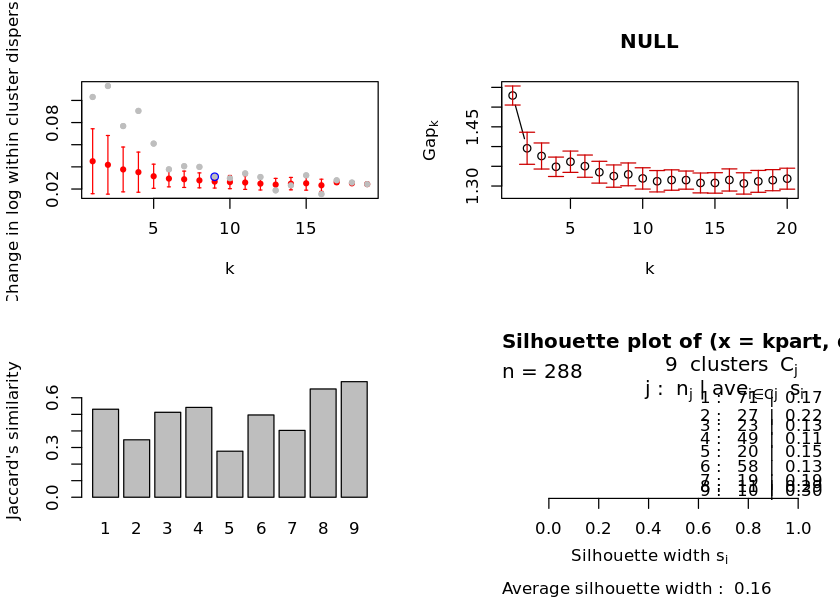

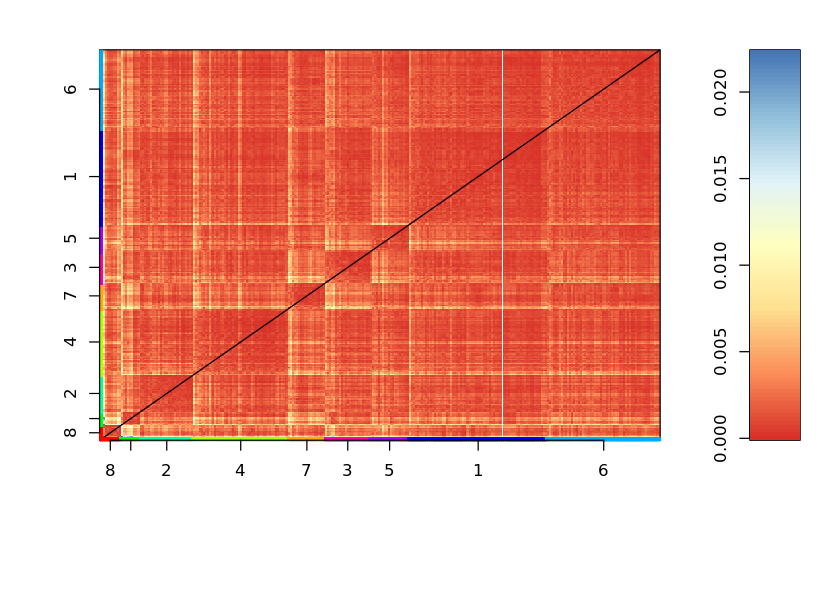

In [181]:
zzz <- capture.output(sc_e <- clustexp(sc_e, do.gap = T))

rbind(sc_e@clusterpar)
par(mfrow=c(2,2))
plotsaturation(sc_e,disp=F)
plotgap(sc_e)
plotjaccard(sc_e)
plotsilhouette(sc_e)

x <- clustheatmap(sc_e, final=F, hmethod="single")

### With firstSEMax and gap

2 Clusters are again suggested, instead of 12. Weak.

Change in method showed no difference, but we can see from the plateau that the Gap is around 12.

clustnr,bootnr,metric,do.gap,sat,SE.method,SE.factor,B.gap,cln,rseed,FUNcluster,FSelect
20,50,pearson,TRUE,TRUE,firstSEmax,0.25,50,0,17000,kmedoids,TRUE


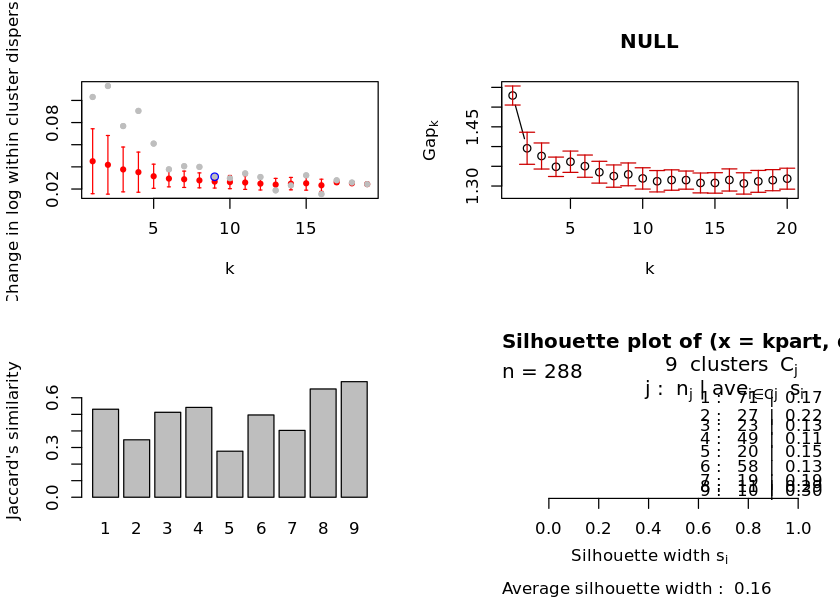

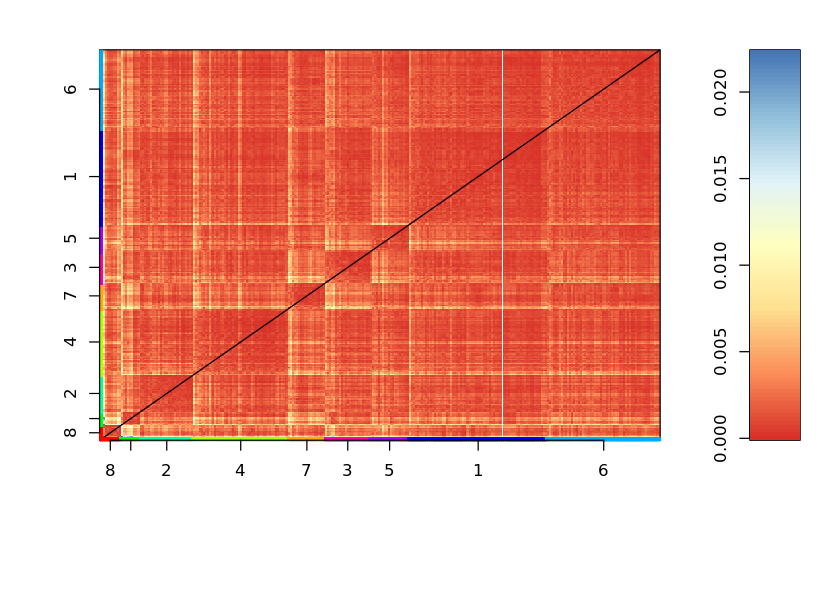

In [182]:
zzz <- capture.output(sc_e <- clustexp(sc_e, do.gap = T, SE.method = "firstSEmax"))

rbind(sc_e@clusterpar)
par(mfrow=c(2,2))
plotsaturation(sc_e,disp=F)
plotgap(sc_e)
plotjaccard(sc_e)
plotsilhouette(sc_e)

x <- clustheatmap(sc_e, final=F, hmethod="single")


This method took twice as long and does not appear to improve the expected cluster number of 12.

### Proceeding with 9

I can now understand why defaults are not desirable -- namely that the number of predicted clusters was far too low.

In [183]:
zzz <- capture.output(sc_e <- clustexp(sc_e, do.gap = F, SE.method = "firstSEmax", cln = 9))

clustnr,bootnr,metric,do.gap,sat,SE.method,SE.factor,B.gap,cln,rseed,FUNcluster,FSelect
20,50,pearson,FALSE,TRUE,firstSEmax,0.25,50,9,17000,kmedoids,TRUE


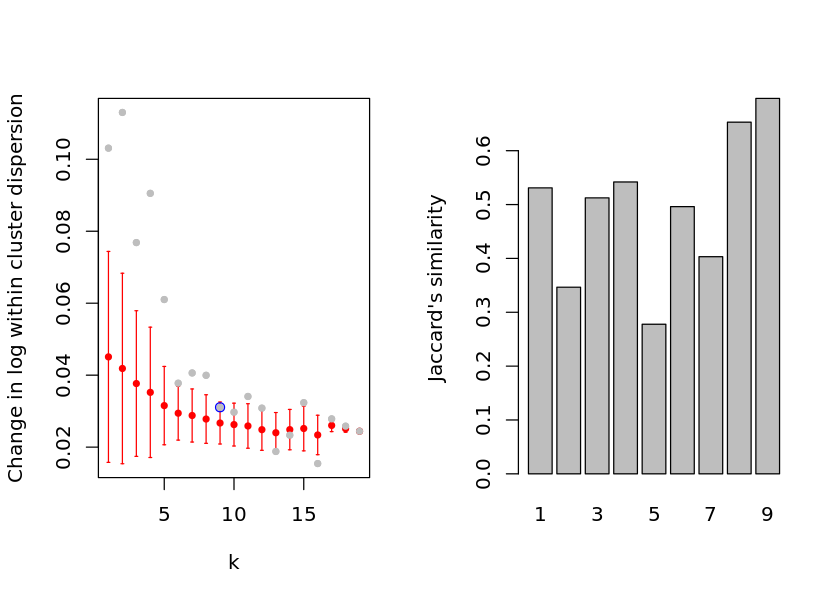

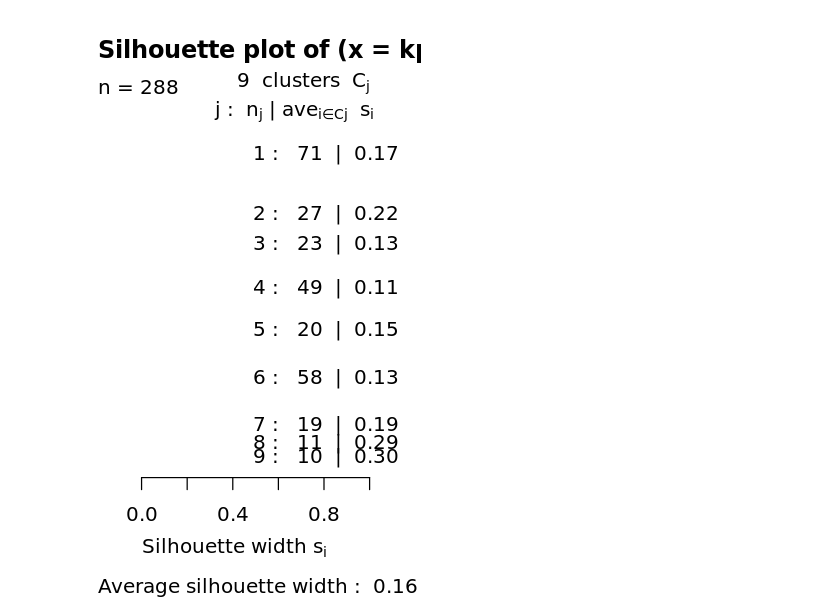

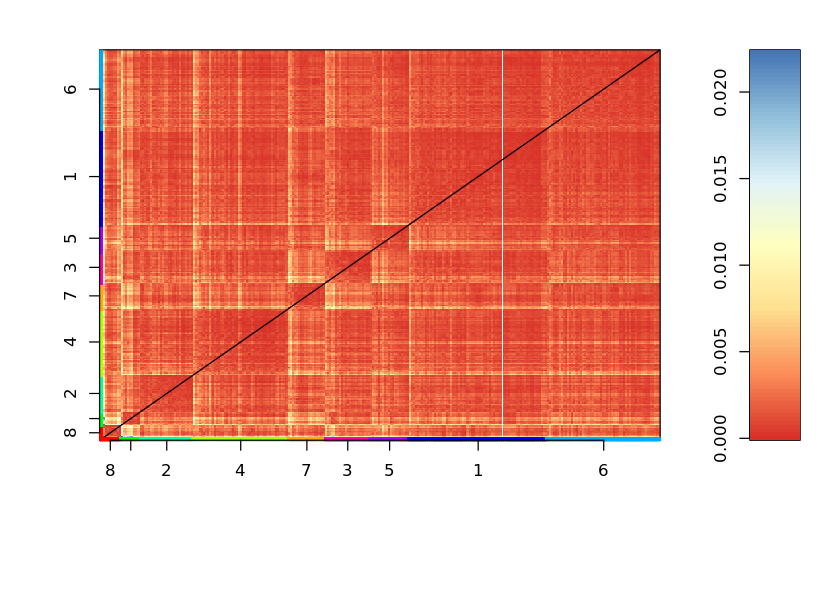

In [184]:
rbind(sc_e@clusterpar)
par(mfrow=c(1,2))
plotsaturation(sc_e,disp=F)
plotjaccard(sc_e)
#plotgap(sc_e)

plotsilhouette(sc_e)
x <- clustheatmap(sc_e, final=F, hmethod="single")

sigma summary: Min. : 0.00850979082808278 |1st Qu. : 0.0107739885269936 |Median : 0.0120507103596008 |Mean : 0.0127980979208767 |3rd Qu. : 0.0136565855582355 |Max. : 0.033871936519664 |
Epoch: Iteration #100 error is: 1.00006105445244
Epoch: Iteration #200 error is: 0.998217176196317
Epoch: Iteration #300 error is: 0.997433047040064
Epoch: Iteration #400 error is: 0.997371786033132
Epoch: Iteration #500 error is: 0.997370779141477
Epoch: Iteration #600 error is: 0.997370739030004
Epoch: Iteration #700 error is: 0.997370737315024
Epoch: Iteration #800 error is: 0.997370737237835
Epoch: Iteration #900 error is: 0.997370737234474
Epoch: Iteration #1000 error is: 0.997370737234317


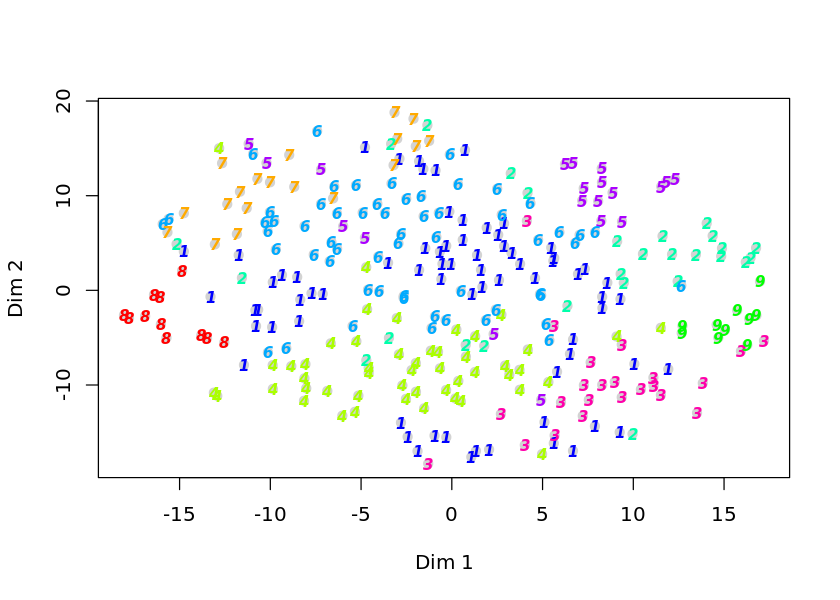

In [186]:
sc_e <- comptsne(sc_e)
plottsne(sc_e, final=F)

## Different Thresholds

As you can see the initial clustering gives far too much noise, probably from too many genes in the analysis. Let's retry with a different filtering threshold from the *Filtering Thresholds*.

#### Methods

In [295]:
allForOne <- function(filter_truth, clna=NULL, semeth="Tibs2001SEmax", discover_cc = T){

    new_sc <- filterdata(
        sc, mintotal = filter_truth, maxexpr=500,
        downsample = F, sfn = F, hkn = F,
        dsn = 1, rseed = 17000, CGenes = NULL, FGenes = NULL
    )

    suppressPackageStartupMessages(require(biomaRt))

    mart <- useMart(biomart = "ENSEMBL_MART_ENSEMBL", dataset = "mmusculus_gene_ensembl")

    k <- getBM(
        filters = "mgi_symbol",
        attributes = c("ensembl_gene_id", "external_gene_name", "mgi_symbol", "go_id", "name_1006"),
        values = rownames(new_sc@fdata),
        mart = mart
    )

    sce <- SingleCellExperiment(assays=list(counts = as.matrix(new_sc@fdata)))
    sce <- calculateQCMetrics(sce)

    options(repr.plot.height = 5)
    par(mfrow=c(1,2))
    hist(sce$total_counts, breaks = 50, main = "Library Size")
    hist(colSums(counts(sce) > 0), breaks = 100, main = "Feature Set")

    # Feature set is empty because all cells have the same number of genes (1247)
    unique(colSums(counts(sce) > 0))

    plotQC(sce, type = "high")

    if (discover_cc){
        ccg <- unique(k[k$name_1006 == "cell cycle",]$mgi_symbol)
        cpg <- unique(k[k$name_1006 == "cell proliferation",]$mgi_symbol)
        vset <- unique(c(ccg,cpg))
    } else {
        custom_cGenes = c("Malat1", "Lars2", "Mki67", "Pcna-ps2")
        custom_sGenes = c("Hsp90aa1", "Jun", "Fos")
        vset <- c(custom_cGenes, custom_sGenes)
    }    

    length(vset)

    x <- CCcorrect(
        new_sc@fdata, vset=vset, CGenes=NULL, ccor=.4, nComp=NULL, pvalue=.05, quant=.01, mode="pca"
    )
    new_sc@fdata <- x$xcor

    batch_vars <- data.frame(
        row.names = names(new_sc@fdata), batch = sub("B([0-9]+)_.*", "\\1", names(new_sc@fdata))
    )
    new_sc@fdata <- varRegression(new_sc@fdata, batch_vars)

    if (is.null(clna)){
        zzz <- capture.output(new_sc <- clustexp(new_sc, do.gap = T))
    } else {
        zzz <- capture.output(new_sc <- clustexp(new_sc, cln = clna, SE.method = semeth))
    }

    rbind(new_sc@clusterpar)
    par(mfrow=c(2,2))
    plotsaturation(new_sc,disp=F)
    if (is.null(clna)){
        plotgap(new_sc)
    }
    plotjaccard(new_sc)
    plotsilhouette(new_sc)

    x <- clustheatmap(new_sc, final=F, hmethod="single")
    
    new_sc <- comptsne(new_sc)
    plottsne(new_sc, final=F)
    
    new_sc <- findoutliers(new_sc)
    new_sc <- rfcorrect(new_sc)
    cdiff <- clustdiffgenes(new_sc, pvalue = .01)

    plottsne(new_sc, final=T)#
    return(new_sc)
}


### Mintotal > 2000

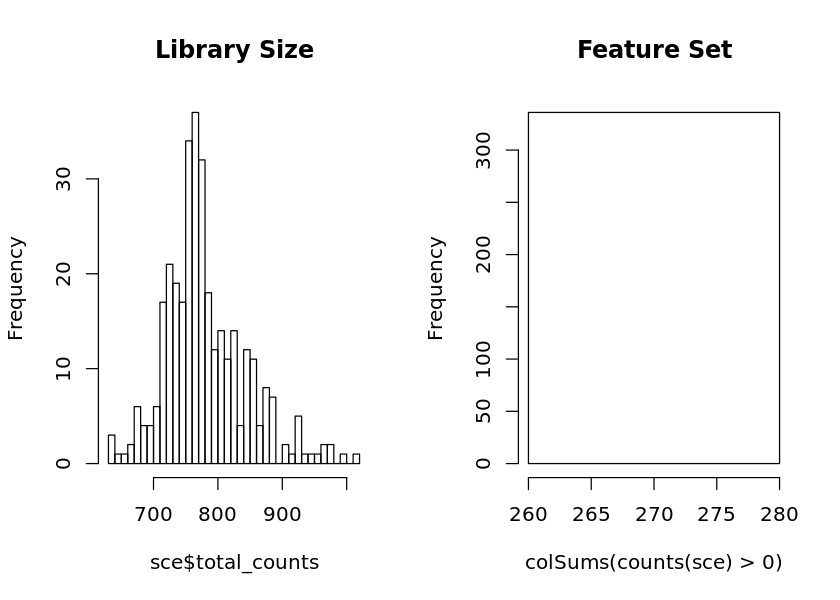

sigma summary: Min. : 0.0374332763446254 |1st Qu. : 0.0484282496701634 |Median : 0.0545755810823409 |Mean : 0.0629559519770086 |3rd Qu. : 0.0667972615751205 |Max. : 0.324273611961204 |
Epoch: Iteration #100 error is: 0.867164986760258
Epoch: Iteration #200 error is: 0.864000949321486
Epoch: Iteration #300 error is: 0.863335038198761
Epoch: Iteration #400 error is: 0.863254778659889
Epoch: Iteration #500 error is: 0.863250440302993
Epoch: Iteration #600 error is: 0.863250162691001
Epoch: Iteration #700 error is: 0.863250144236755
Epoch: Iteration #800 error is: 0.863250142947034
Epoch: Iteration #900 error is: 0.863250142861069
Epoch: Iteration #1000 error is: 0.863250142855112


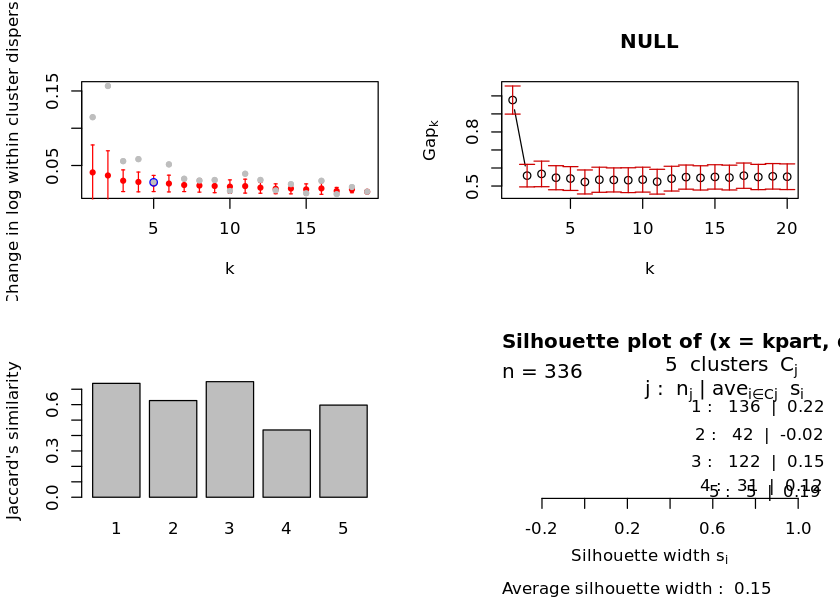

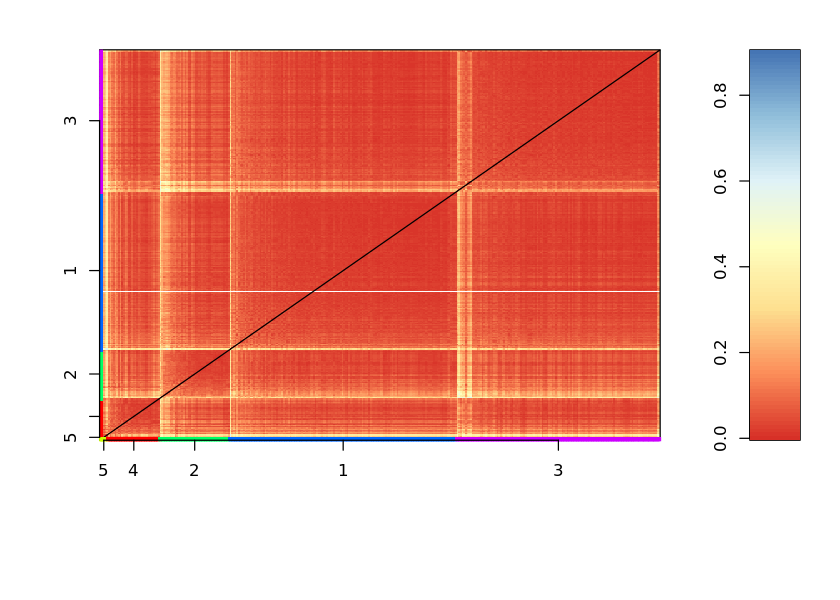

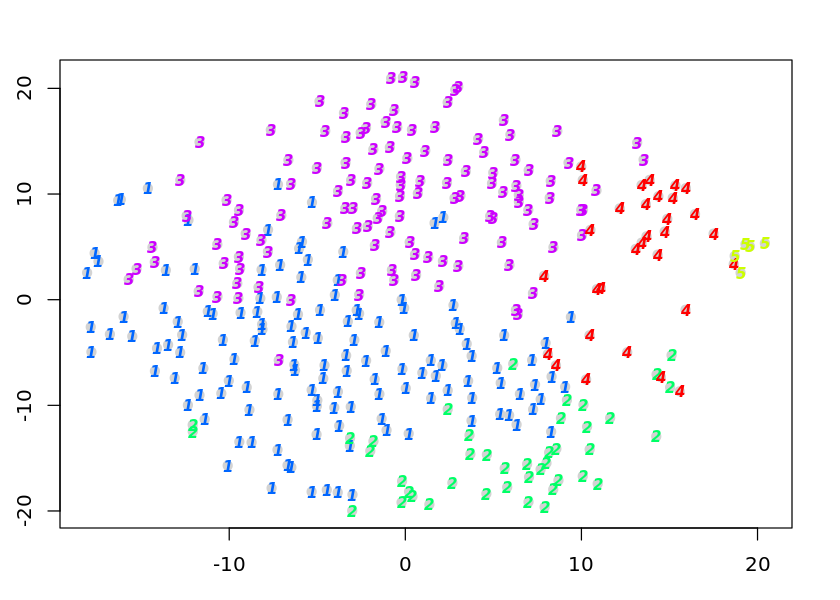

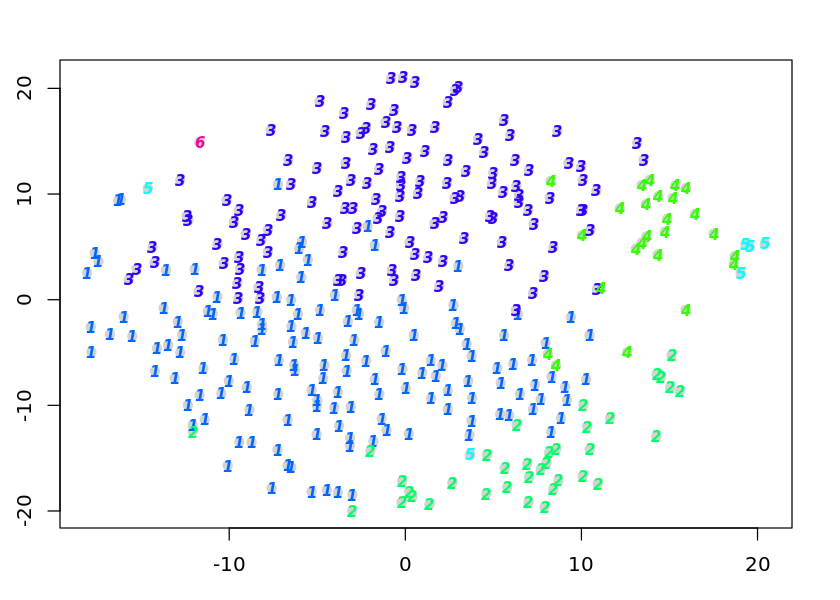

In [204]:
sc_2000 <- allForOne(2000)

### Mintotal > 3000

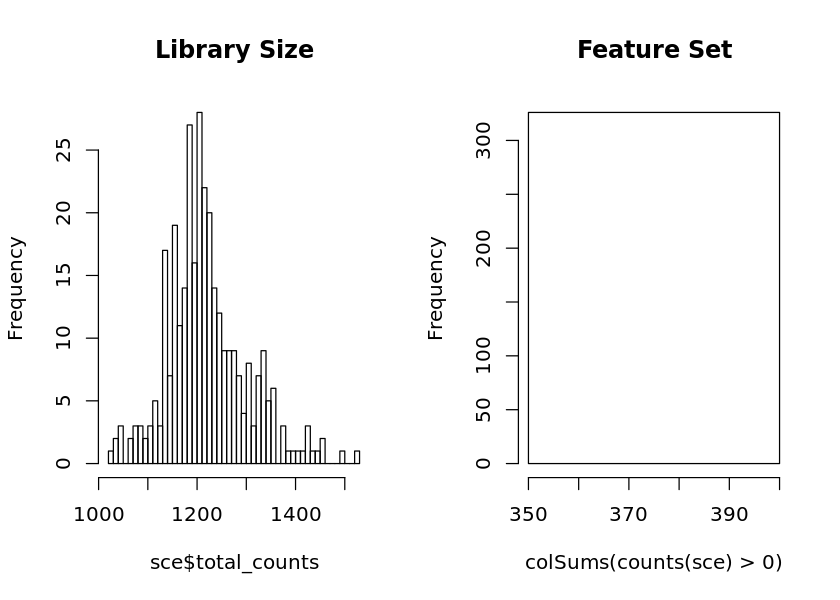

sigma summary: Min. : 0.0335449673250196 |1st Qu. : 0.0420088771962774 |Median : 0.0481310908868325 |Mean : 0.0588090096404974 |3rd Qu. : 0.061144430785192 |Max. : 0.309675556392898 |
Epoch: Iteration #100 error is: 0.837621951007396
Epoch: Iteration #200 error is: 0.832909527177666
Epoch: Iteration #300 error is: 0.832063878935838
Epoch: Iteration #400 error is: 0.83193736328587
Epoch: Iteration #500 error is: 0.831927719181732
Epoch: Iteration #600 error is: 0.831926767860422
Epoch: Iteration #700 error is: 0.831926669958365
Epoch: Iteration #800 error is: 0.831926659609134
Epoch: Iteration #900 error is: 0.831926658547479
Epoch: Iteration #1000 error is: 0.831926658429507


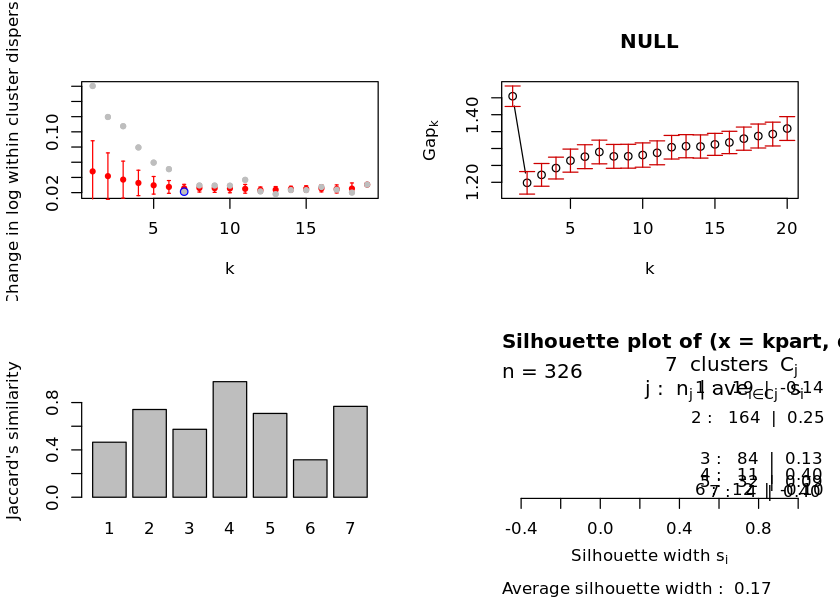

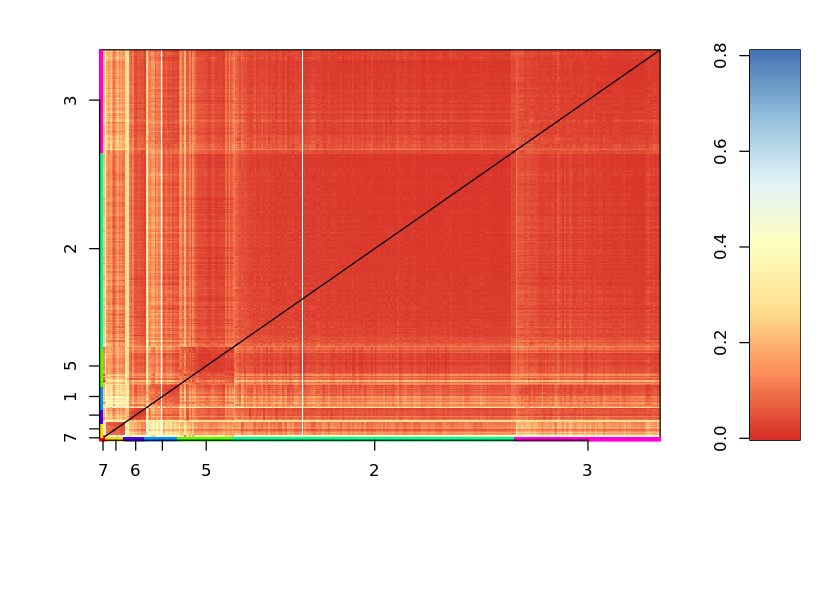

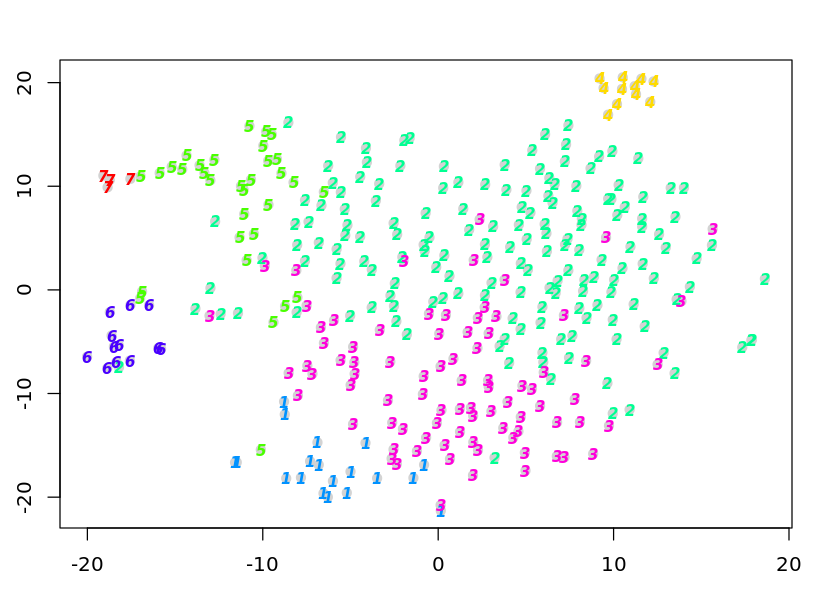

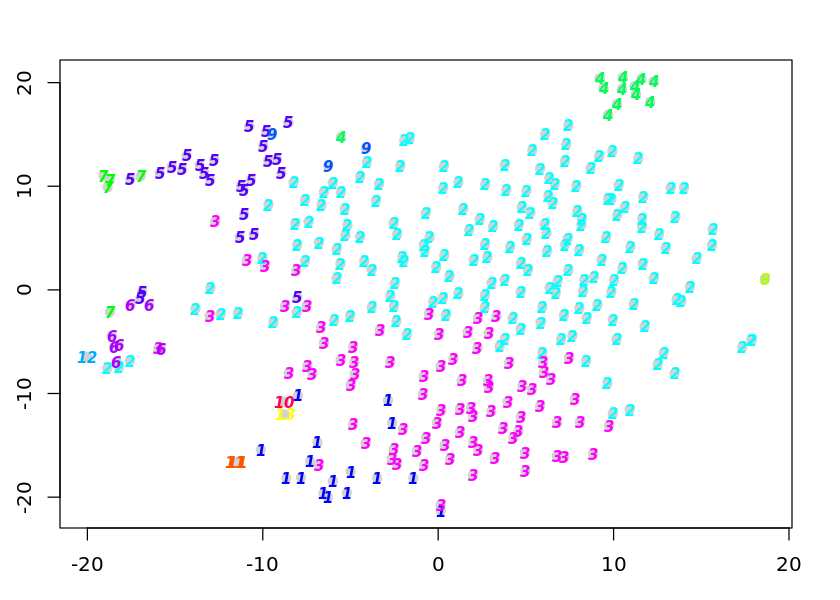

In [205]:
sc_3000 <- allForOne(3000)

### Mintotal > 4000

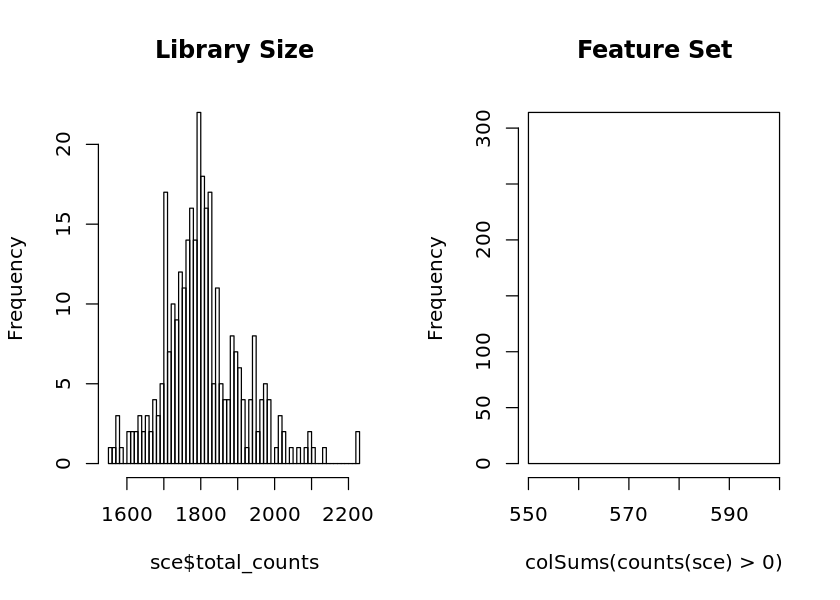

sigma summary: Min. : 0.0192088042601587 |1st Qu. : 0.0236947389939155 |Median : 0.0257763614297945 |Mean : 0.0276696854722281 |3rd Qu. : 0.0292864844706225 |Max. : 0.0697614087551841 |
Epoch: Iteration #100 error is: 1.146009844613
Epoch: Iteration #200 error is: 1.14358434297583
Epoch: Iteration #300 error is: 1.14326823719963
Epoch: Iteration #400 error is: 1.1432515055658
Epoch: Iteration #500 error is: 1.14325129736825
Epoch: Iteration #600 error is: 1.14325129448665
Epoch: Iteration #700 error is: 1.1432512944462
Epoch: Iteration #800 error is: 1.14325129444567
Epoch: Iteration #900 error is: 1.14325129444566
Epoch: Iteration #1000 error is: 1.14325129444566


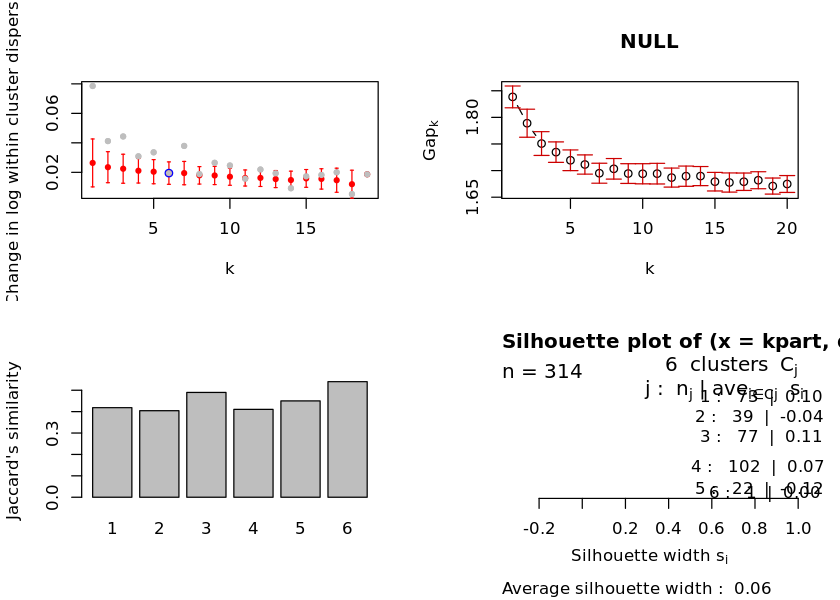

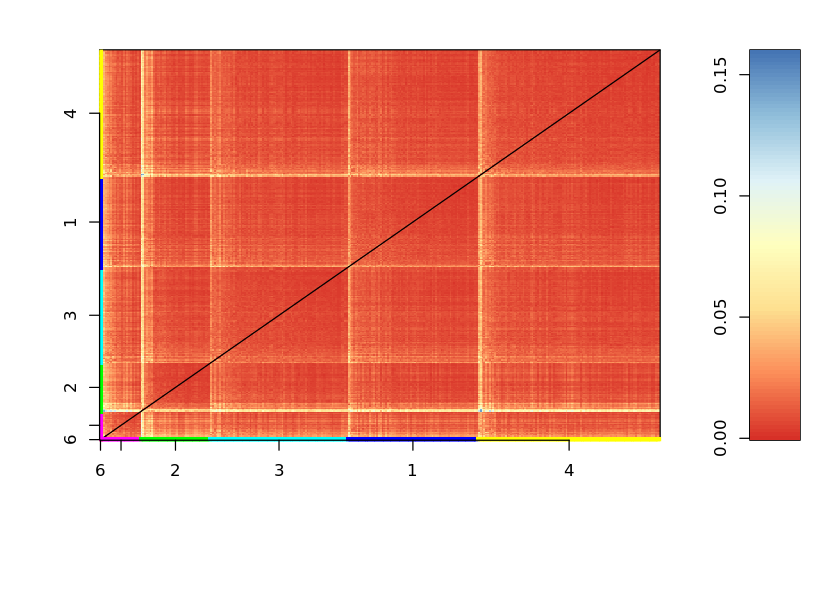

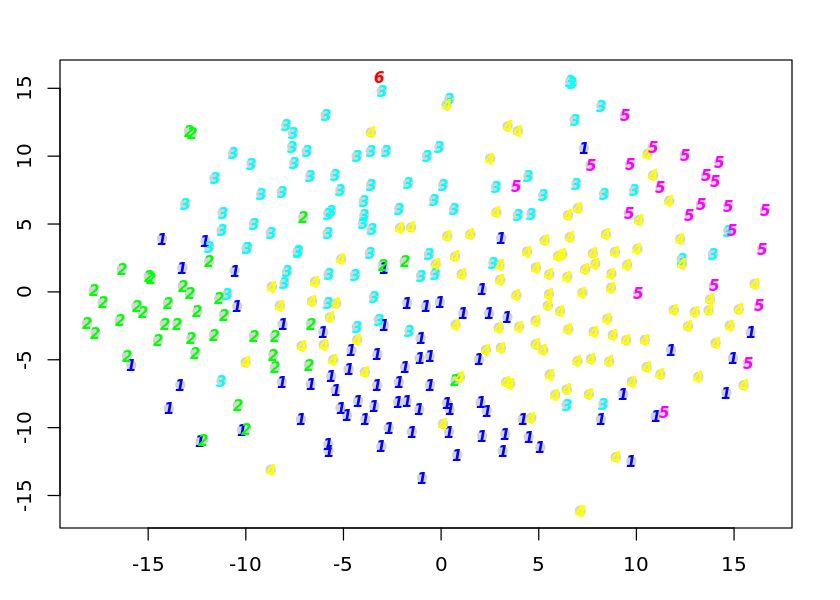

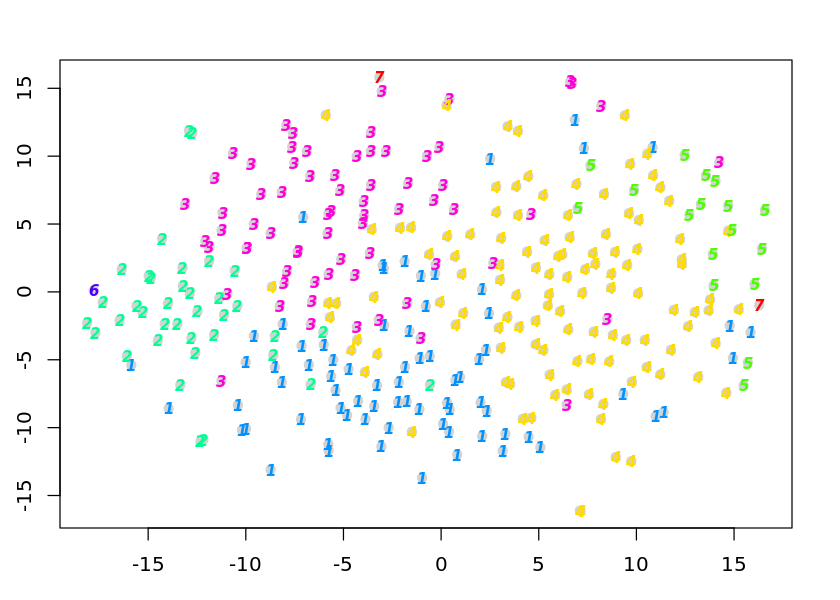

In [206]:
sc_4000 <- allForOne(4000)

### Mintotal > 5000

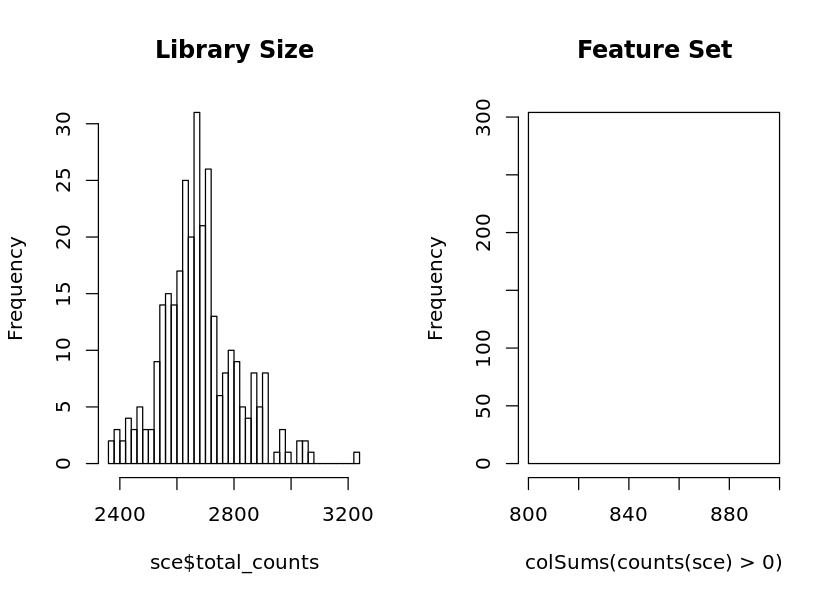

sigma summary: Min. : 0.0161719486531581 |1st Qu. : 0.0202335760666798 |Median : 0.0223302286720869 |Mean : 0.0254994191829608 |3rd Qu. : 0.0257043593624722 |Max. : 0.0824476693322376 |
Epoch: Iteration #100 error is: 0.942858090991594
Epoch: Iteration #200 error is: 0.939184340859181
Epoch: Iteration #300 error is: 0.938310911135474
Epoch: Iteration #400 error is: 0.938192924338872
Epoch: Iteration #500 error is: 0.938185364777055
Epoch: Iteration #600 error is: 0.9381847629667
Epoch: Iteration #700 error is: 0.938184710081164
Epoch: Iteration #800 error is: 0.938184705244591
Epoch: Iteration #900 error is: 0.938184704796518
Epoch: Iteration #1000 error is: 0.938184704756378


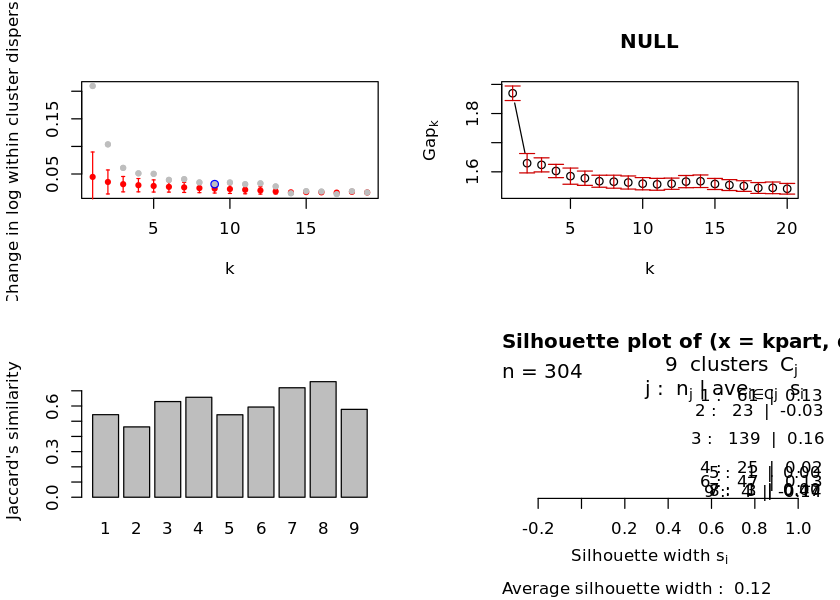

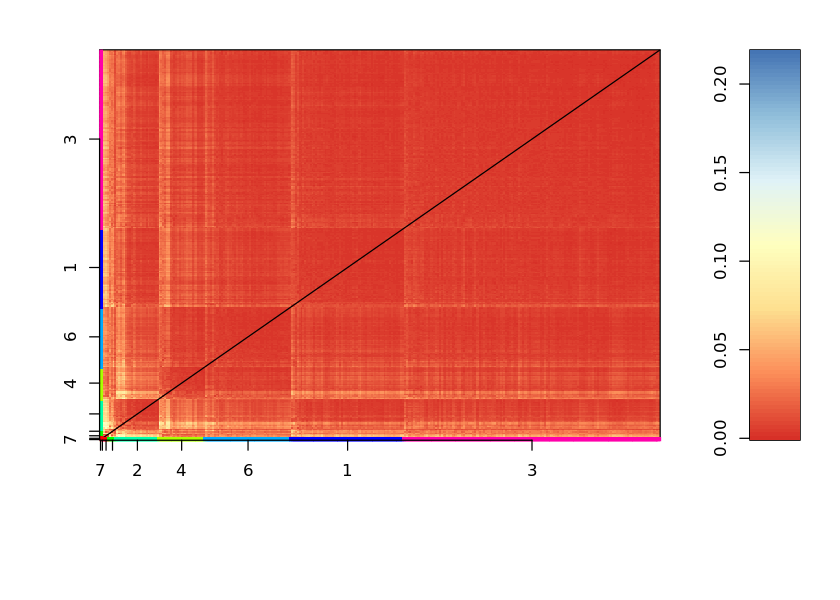

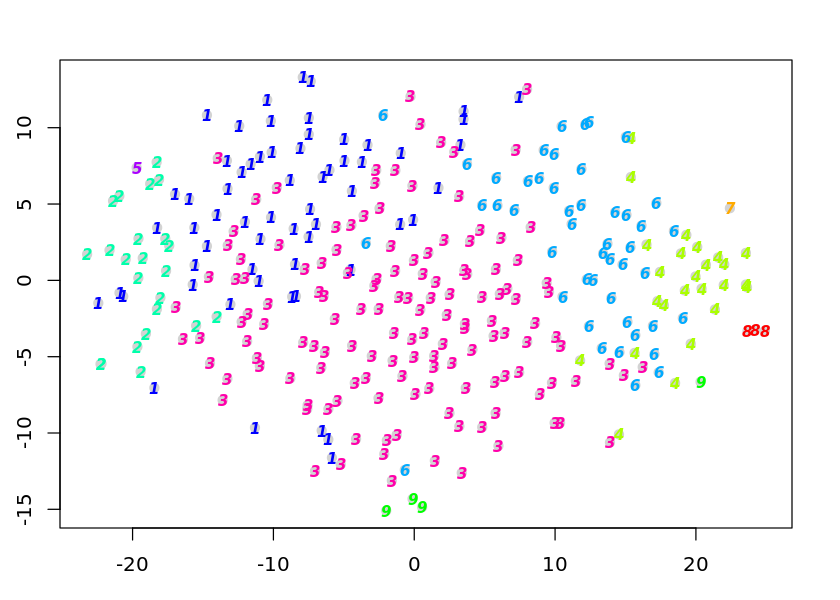

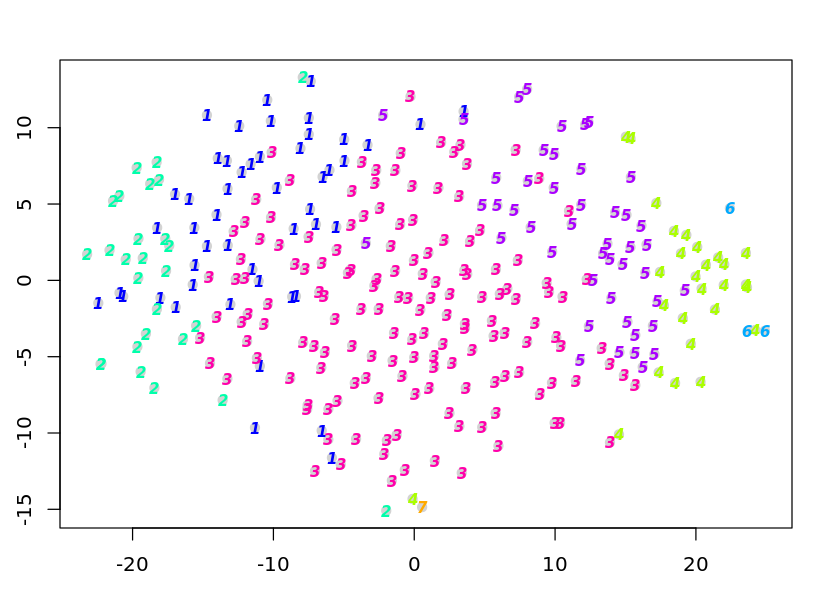

In [220]:
sc_5000_list <- allForOne(5000)

### Mintotal > 6000

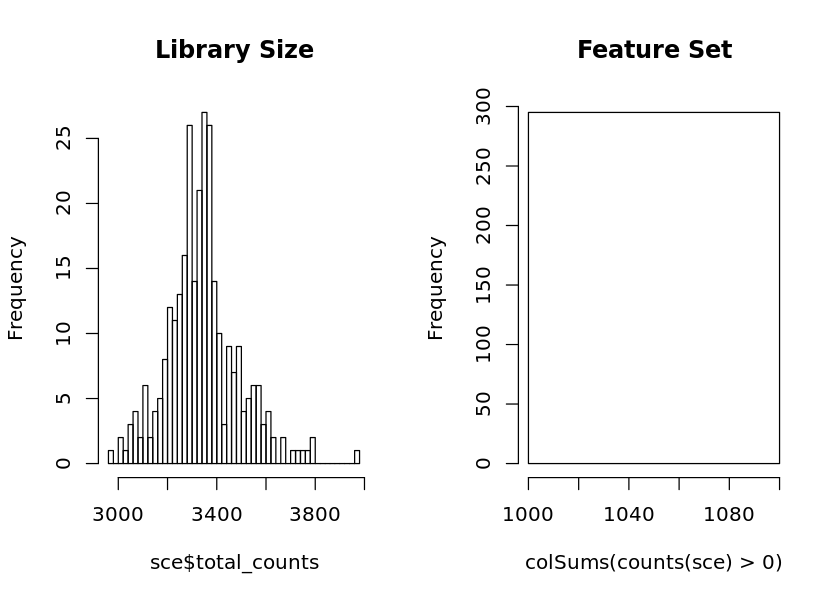

sigma summary: Min. : 0.0143718552726466 |1st Qu. : 0.0179075360518057 |Median : 0.0194171897527046 |Mean : 0.0211125485742474 |3rd Qu. : 0.0214206793180868 |Max. : 0.0644321132259916 |
Epoch: Iteration #100 error is: 0.997047186256003
Epoch: Iteration #200 error is: 0.995105828554698
Epoch: Iteration #300 error is: 0.994735154146585
Epoch: Iteration #400 error is: 0.994706528130274
Epoch: Iteration #500 error is: 0.994705890356411
Epoch: Iteration #600 error is: 0.994705873128112
Epoch: Iteration #700 error is: 0.994705872667533
Epoch: Iteration #800 error is: 0.994705872654688
Epoch: Iteration #900 error is: 0.994705872654339
Epoch: Iteration #1000 error is: 0.99470587265433


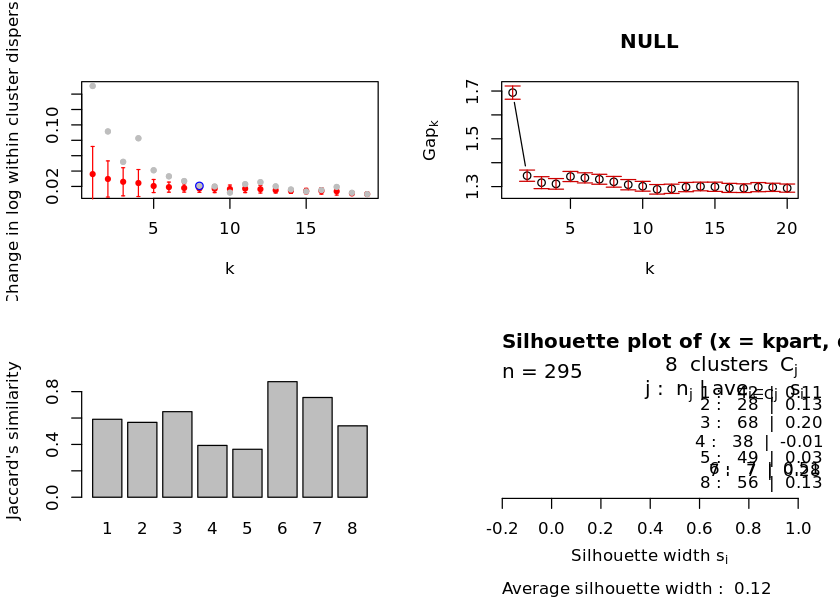

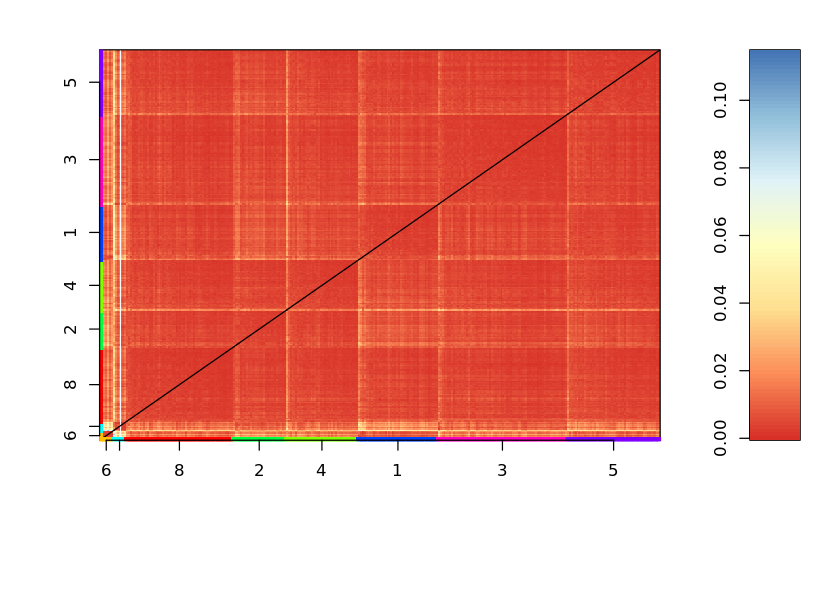

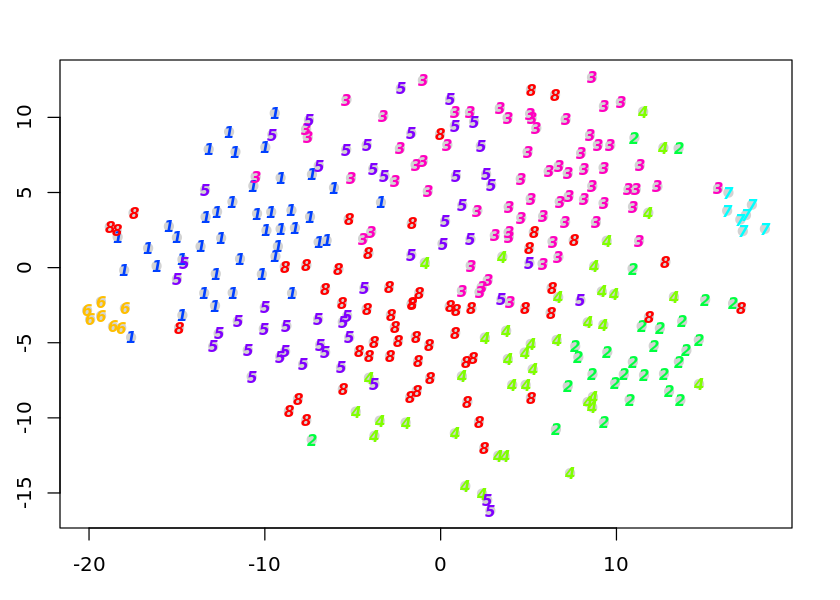

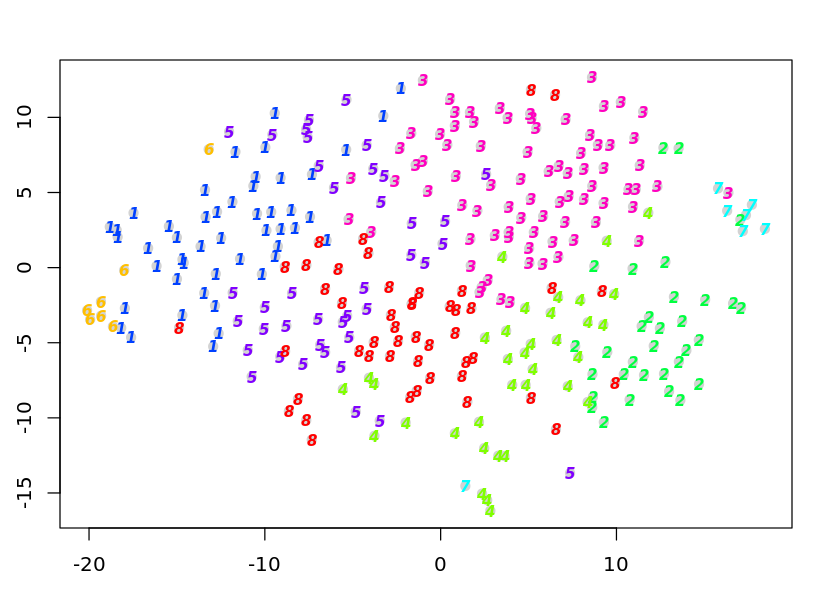

In [208]:
sc_6000 <- allForOne(6000)

### Mintotal > 7000

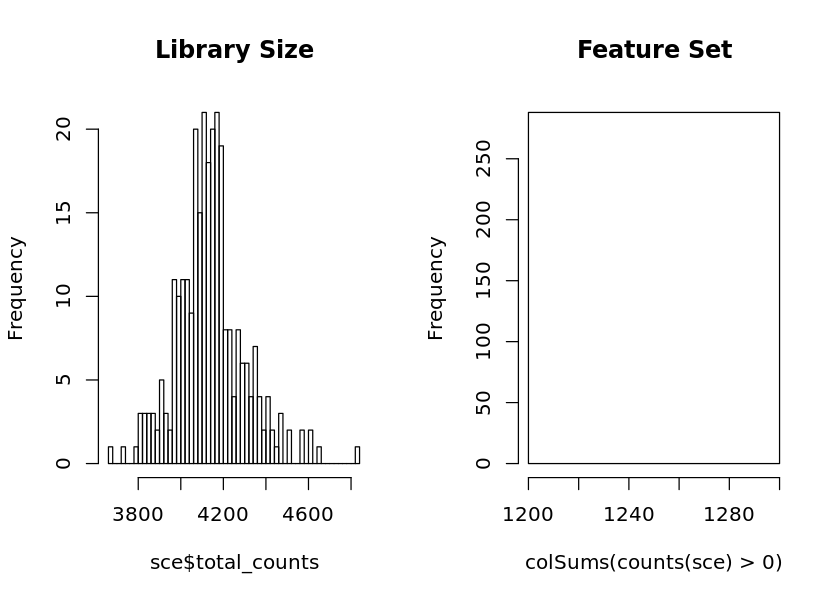

sigma summary: Min. : 0.00850979082808278 |1st Qu. : 0.0107739885269936 |Median : 0.0120507103596008 |Mean : 0.0127980979208767 |3rd Qu. : 0.0136565855582355 |Max. : 0.033871936519664 |
Epoch: Iteration #100 error is: 1.00006105445244
Epoch: Iteration #200 error is: 0.998217176196317
Epoch: Iteration #300 error is: 0.997433047040064
Epoch: Iteration #400 error is: 0.997371786033132
Epoch: Iteration #500 error is: 0.997370779141477
Epoch: Iteration #600 error is: 0.997370739030004
Epoch: Iteration #700 error is: 0.997370737315024
Epoch: Iteration #800 error is: 0.997370737237835
Epoch: Iteration #900 error is: 0.997370737234474
Epoch: Iteration #1000 error is: 0.997370737234317


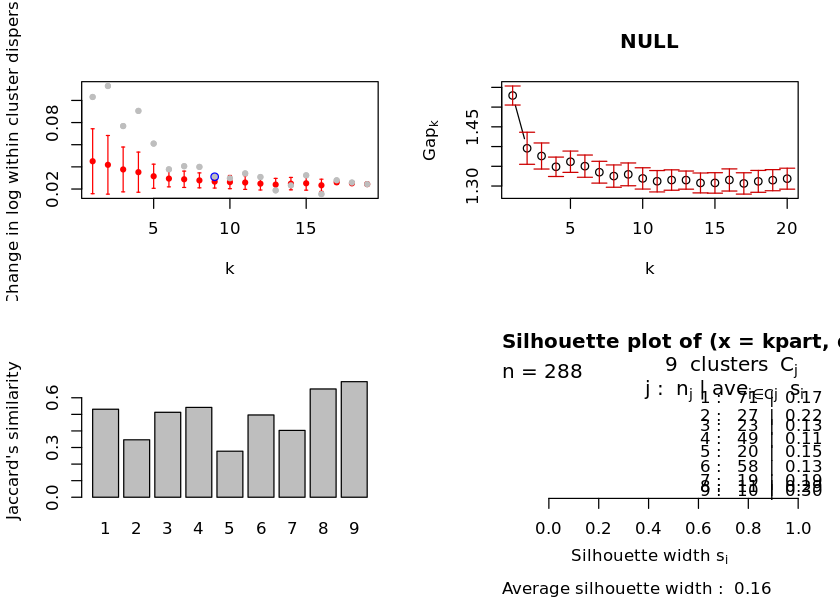

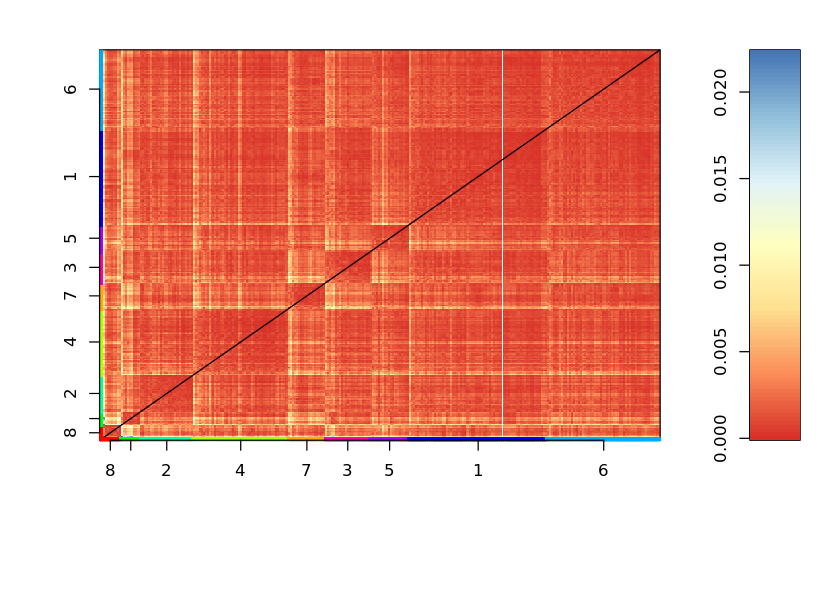

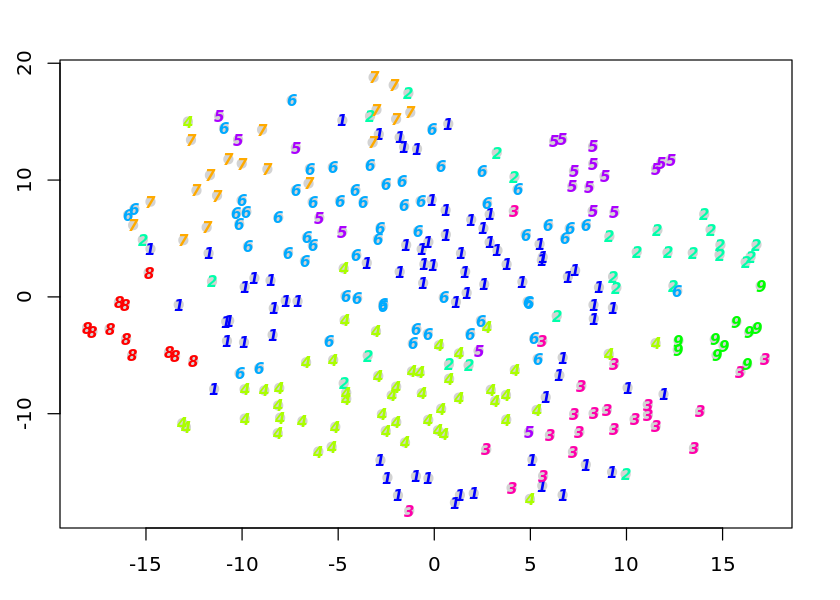

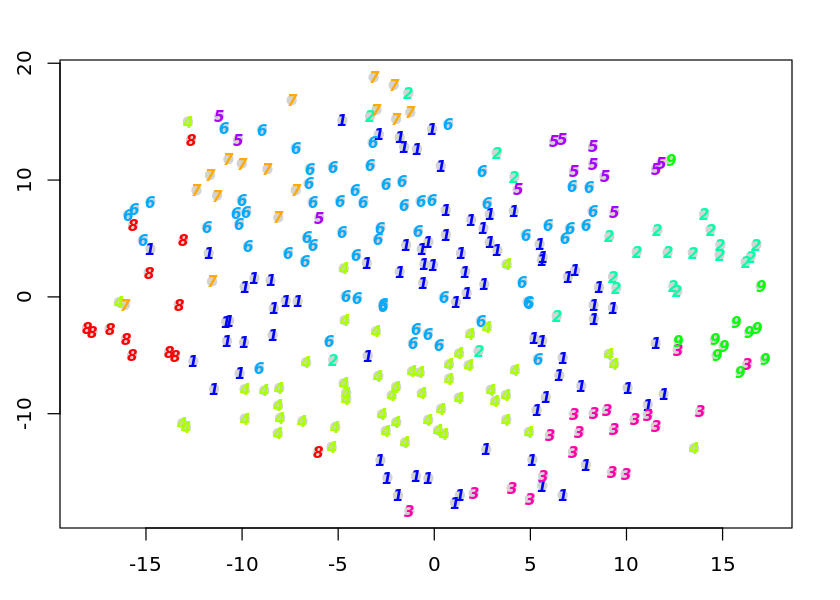

In [209]:
sc_7000 <- allForOne(7000)

### Summary

By looking at the Jaccard similarity plots we get the most number of stable clusters (> 0.6) for > 5000, also showing clusters more distinct from one another than other thresholds.

## Outlier sensitivity (mintotal > 5000)

Here we will repeat some of the finer points of the clustering, using different values of k to see if the clustering stability improves.

### clusters = 7

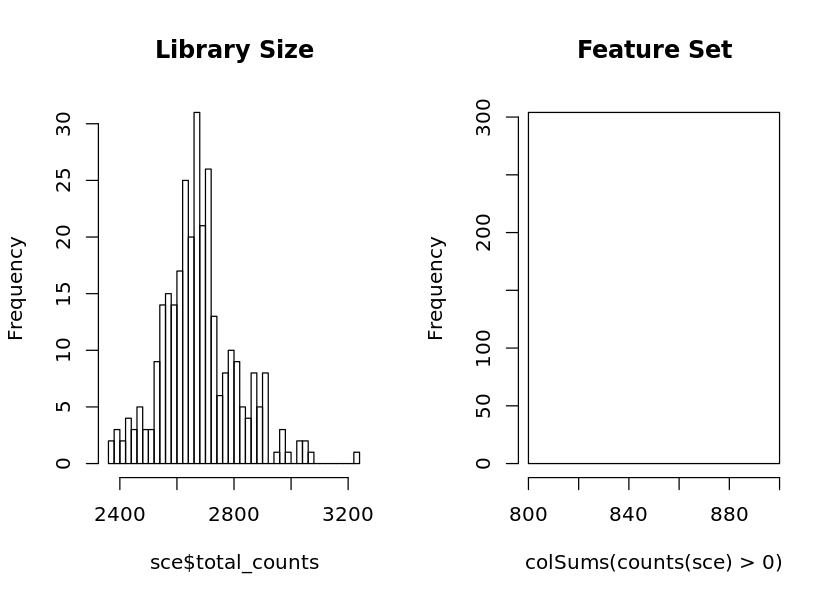

sigma summary: Min. : 0.0161719486531581 |1st Qu. : 0.0202335760666798 |Median : 0.0223302286720869 |Mean : 0.0254994191829608 |3rd Qu. : 0.0257043593624722 |Max. : 0.0824476693322376 |
Epoch: Iteration #100 error is: 0.942858090991594
Epoch: Iteration #200 error is: 0.939184340859181
Epoch: Iteration #300 error is: 0.938310911135474
Epoch: Iteration #400 error is: 0.938192924338872
Epoch: Iteration #500 error is: 0.938185364777055
Epoch: Iteration #600 error is: 0.9381847629667
Epoch: Iteration #700 error is: 0.938184710081164
Epoch: Iteration #800 error is: 0.938184705244591
Epoch: Iteration #900 error is: 0.938184704796518
Epoch: Iteration #1000 error is: 0.938184704756378


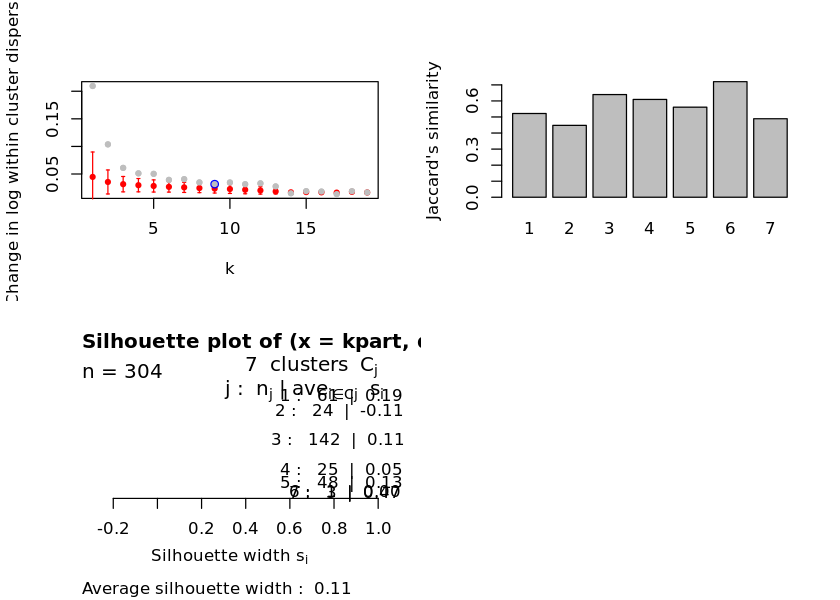

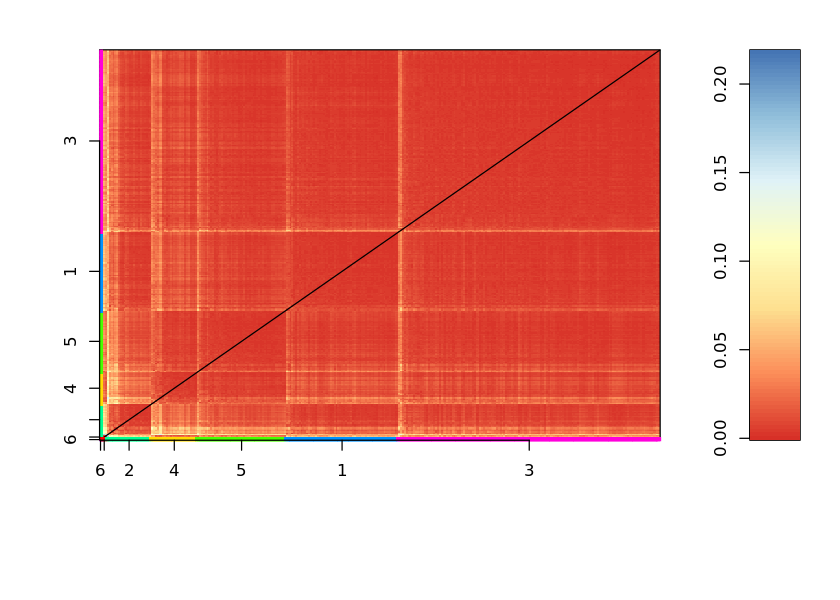

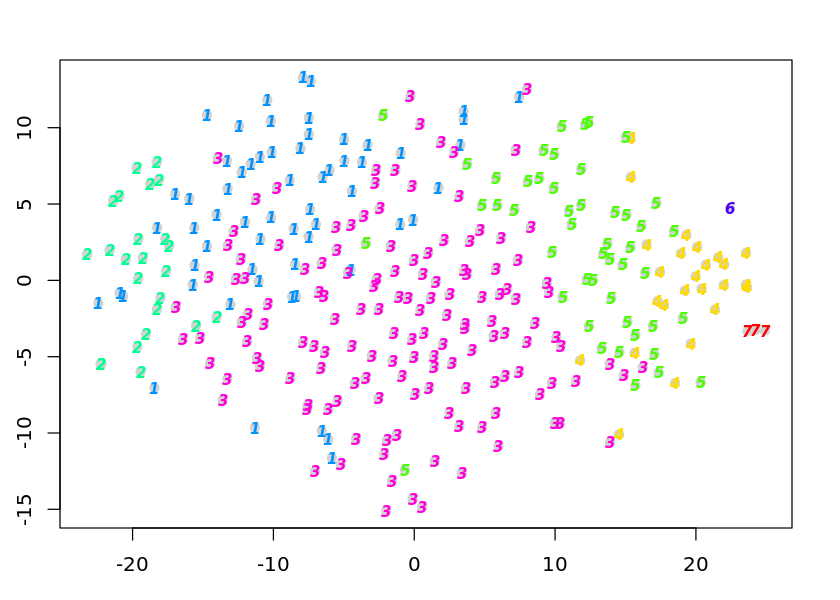

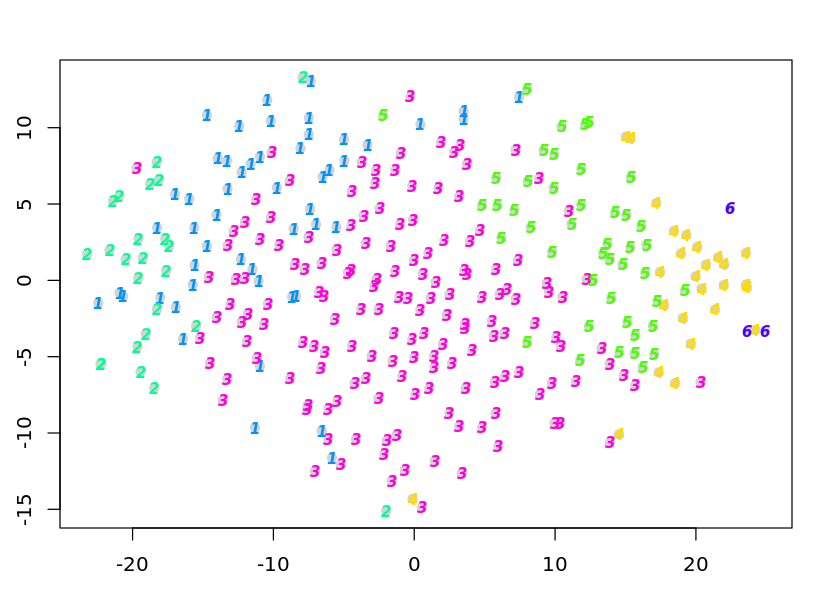

In [243]:
sc_5000_7 <- allForOne(5000, 7)

### clusters = 8

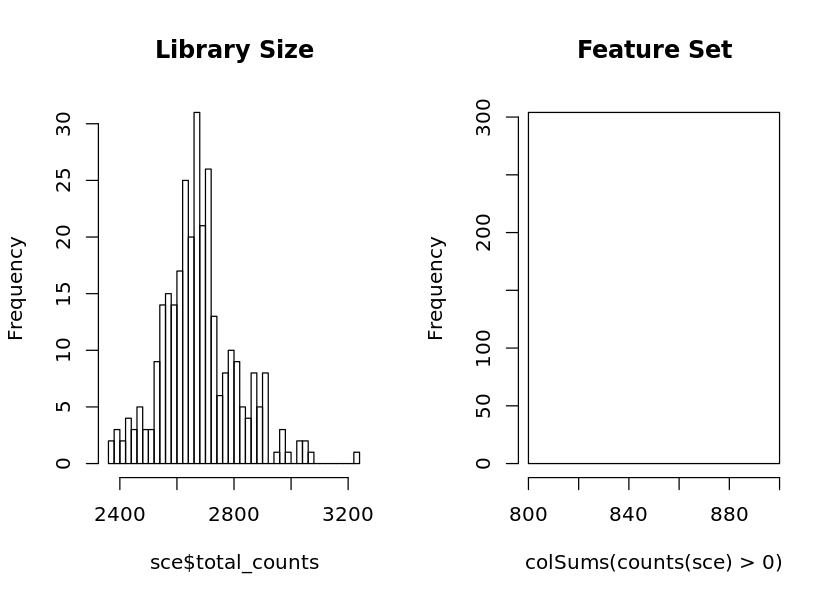

sigma summary: Min. : 0.0161719486531581 |1st Qu. : 0.0202335760666798 |Median : 0.0223302286720869 |Mean : 0.0254994191829608 |3rd Qu. : 0.0257043593624722 |Max. : 0.0824476693322376 |
Epoch: Iteration #100 error is: 0.942858090991594
Epoch: Iteration #200 error is: 0.939184340859181
Epoch: Iteration #300 error is: 0.938310911135474
Epoch: Iteration #400 error is: 0.938192924338872
Epoch: Iteration #500 error is: 0.938185364777055
Epoch: Iteration #600 error is: 0.9381847629667
Epoch: Iteration #700 error is: 0.938184710081164
Epoch: Iteration #800 error is: 0.938184705244591
Epoch: Iteration #900 error is: 0.938184704796518
Epoch: Iteration #1000 error is: 0.938184704756378


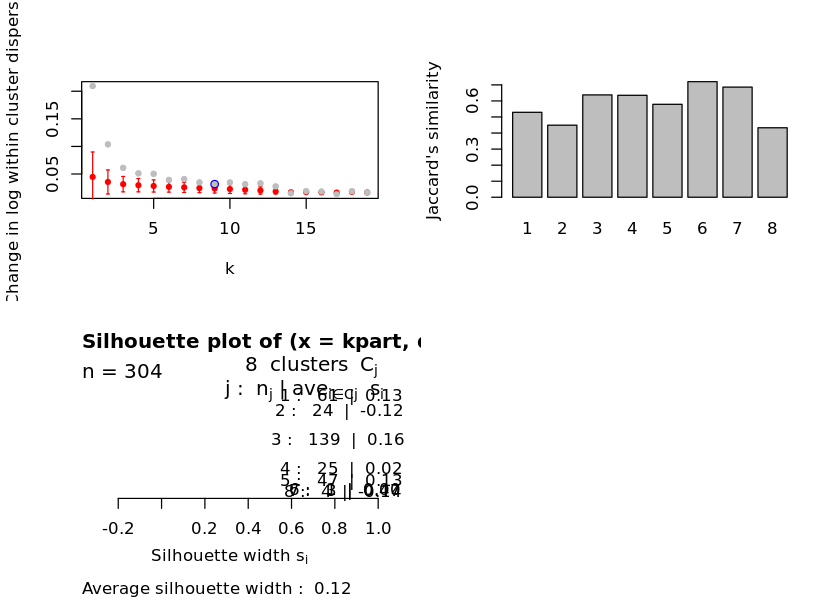

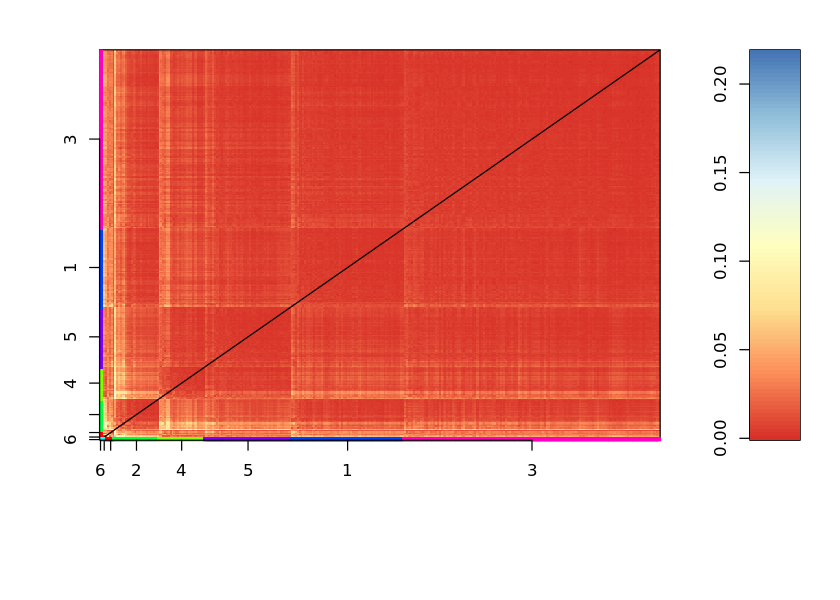

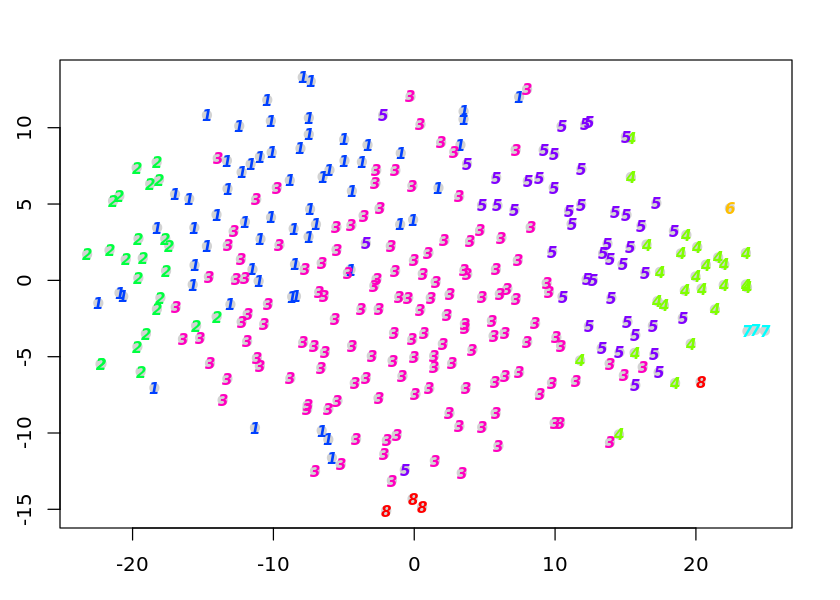

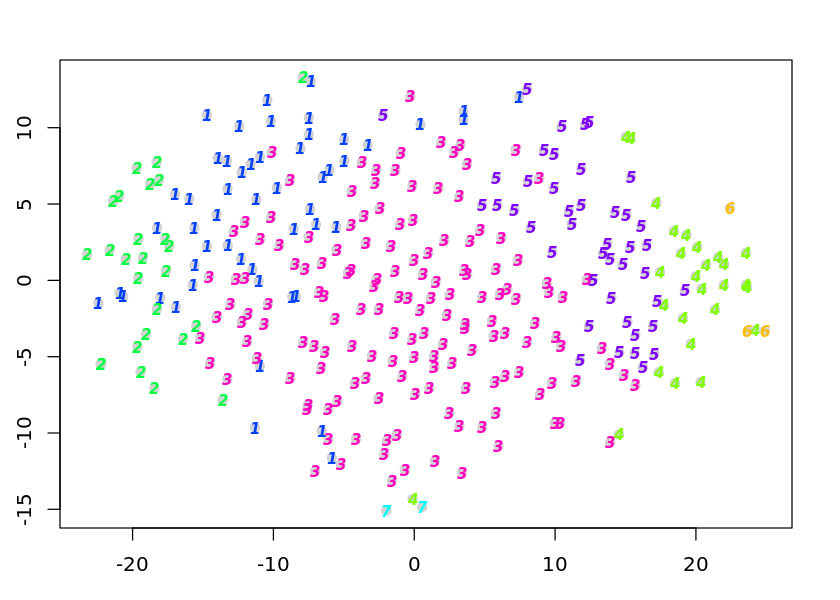

In [242]:
sc_5000_8 <- allForOne(5000, 8)

### clusters = 9

Most clusters under 0.6

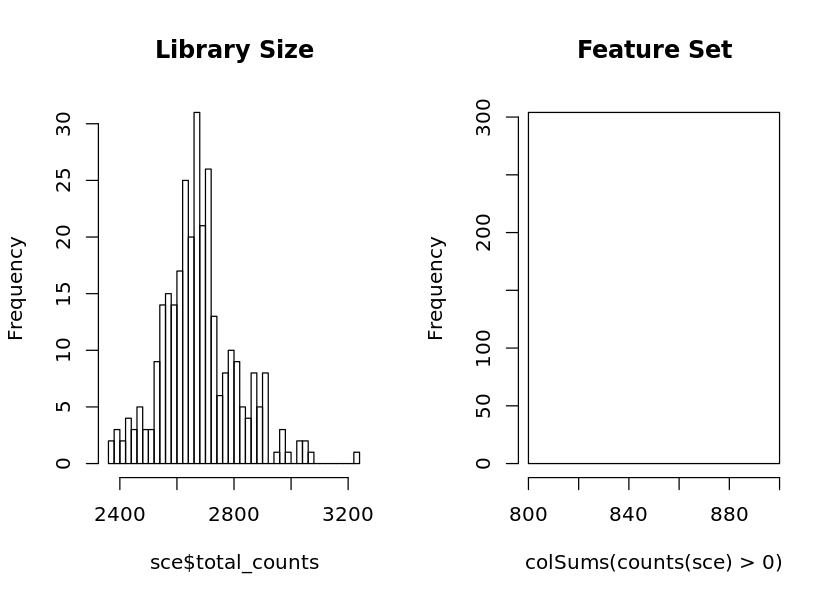

sigma summary: Min. : 0.0161719486531581 |1st Qu. : 0.0202335760666798 |Median : 0.0223302286720869 |Mean : 0.0254994191829608 |3rd Qu. : 0.0257043593624722 |Max. : 0.0824476693322376 |
Epoch: Iteration #100 error is: 0.942858090991594
Epoch: Iteration #200 error is: 0.939184340859181
Epoch: Iteration #300 error is: 0.938310911135474
Epoch: Iteration #400 error is: 0.938192924338872
Epoch: Iteration #500 error is: 0.938185364777055
Epoch: Iteration #600 error is: 0.9381847629667
Epoch: Iteration #700 error is: 0.938184710081164
Epoch: Iteration #800 error is: 0.938184705244591
Epoch: Iteration #900 error is: 0.938184704796518
Epoch: Iteration #1000 error is: 0.938184704756378


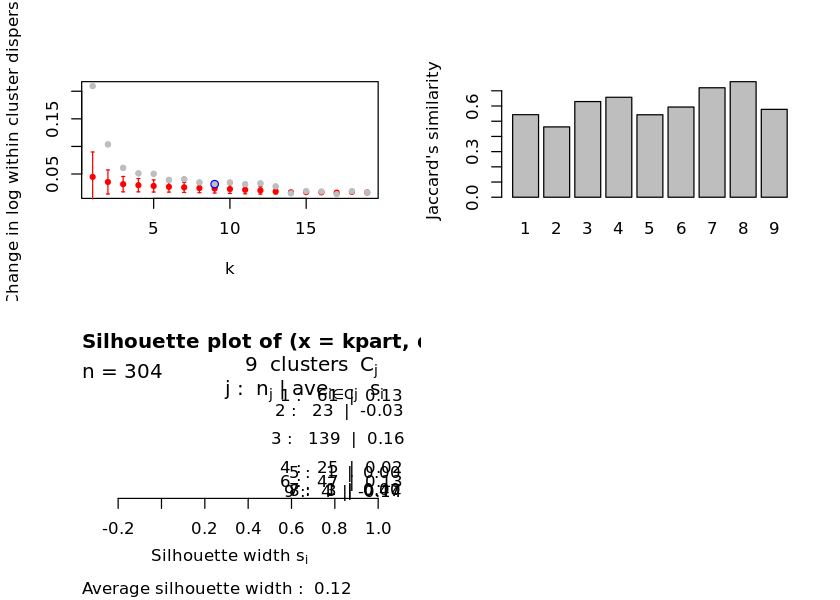

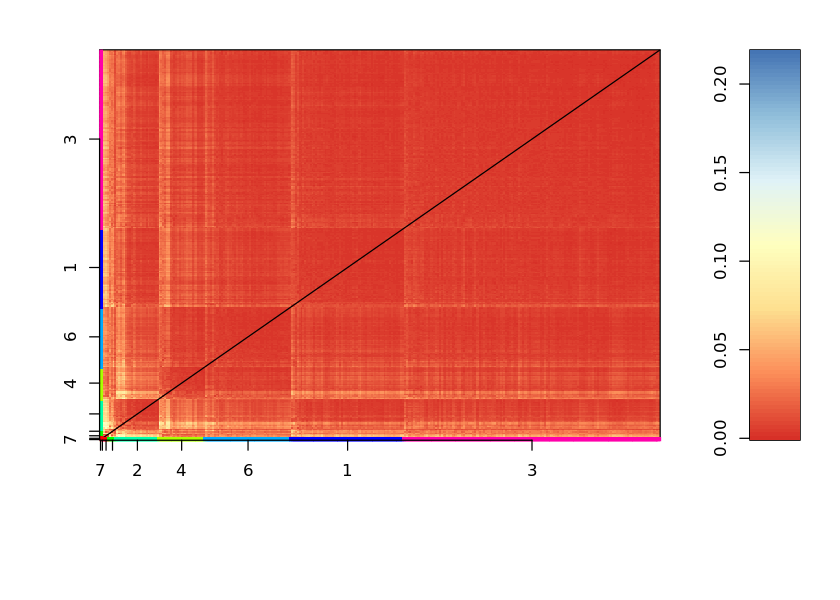

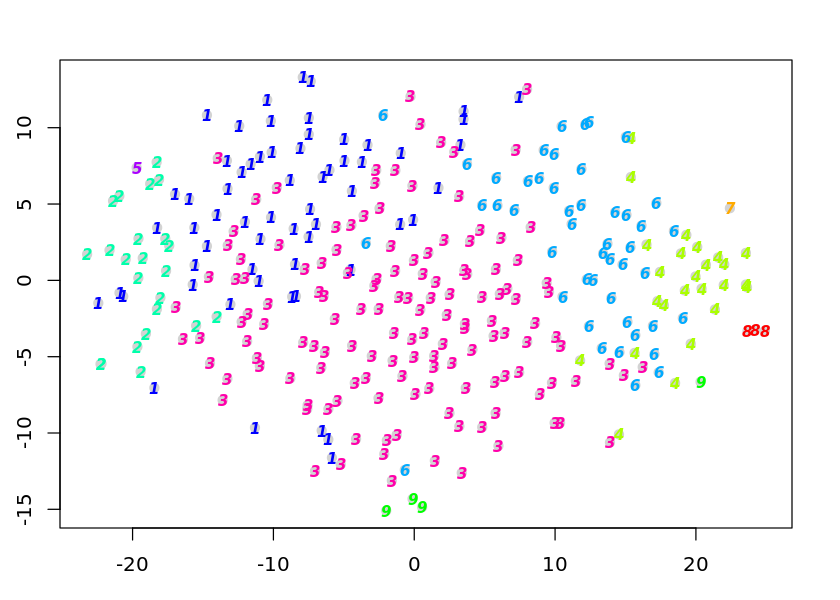

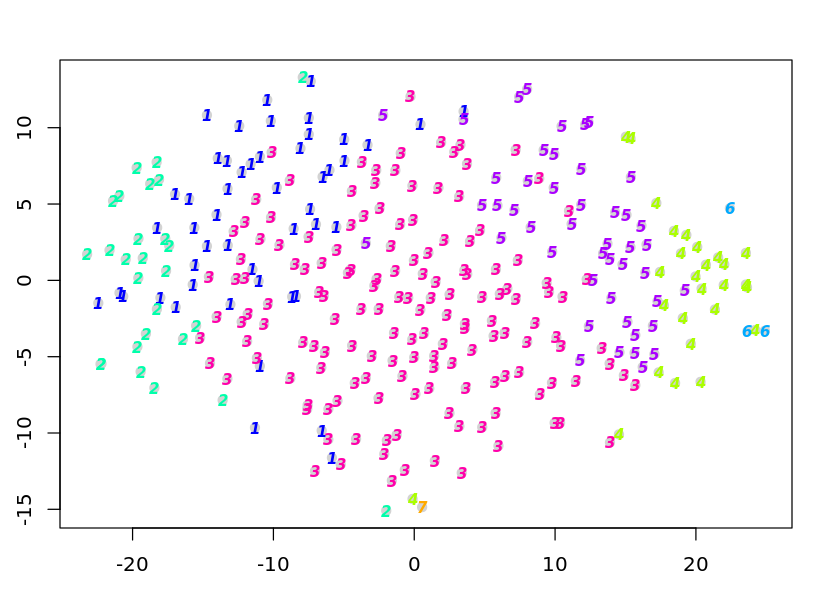

In [241]:
sc_5000_9 <- allForOne(5000, 9)

### clusters = 10

Most clusters under 0.6

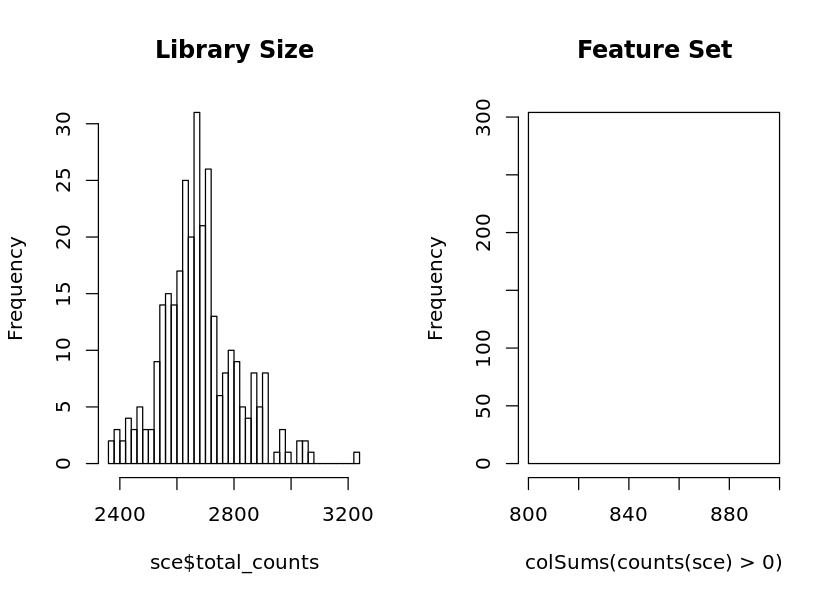

sigma summary: Min. : 0.0161719486531581 |1st Qu. : 0.0202335760666798 |Median : 0.0223302286720869 |Mean : 0.0254994191829608 |3rd Qu. : 0.0257043593624722 |Max. : 0.0824476693322376 |
Epoch: Iteration #100 error is: 0.942858090991594
Epoch: Iteration #200 error is: 0.939184340859181
Epoch: Iteration #300 error is: 0.938310911135474
Epoch: Iteration #400 error is: 0.938192924338872
Epoch: Iteration #500 error is: 0.938185364777055
Epoch: Iteration #600 error is: 0.9381847629667
Epoch: Iteration #700 error is: 0.938184710081164
Epoch: Iteration #800 error is: 0.938184705244591
Epoch: Iteration #900 error is: 0.938184704796518
Epoch: Iteration #1000 error is: 0.938184704756378


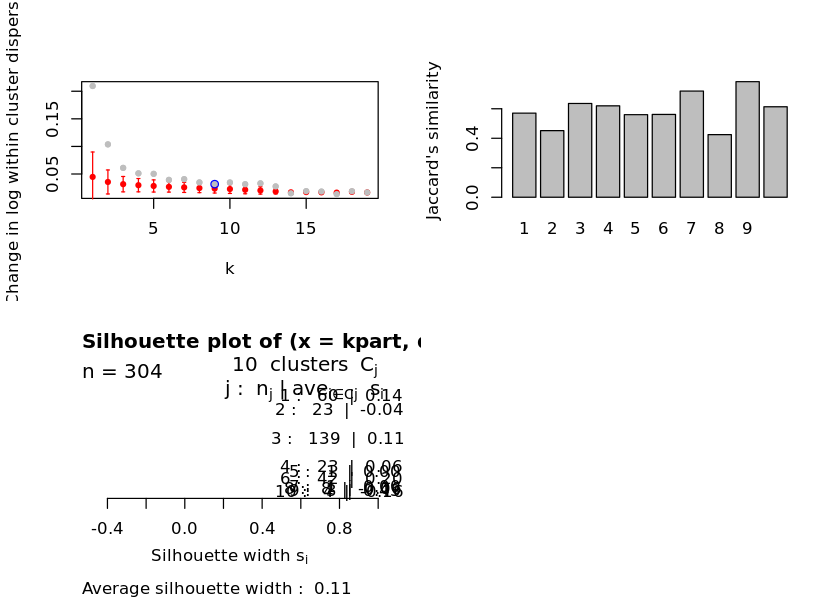

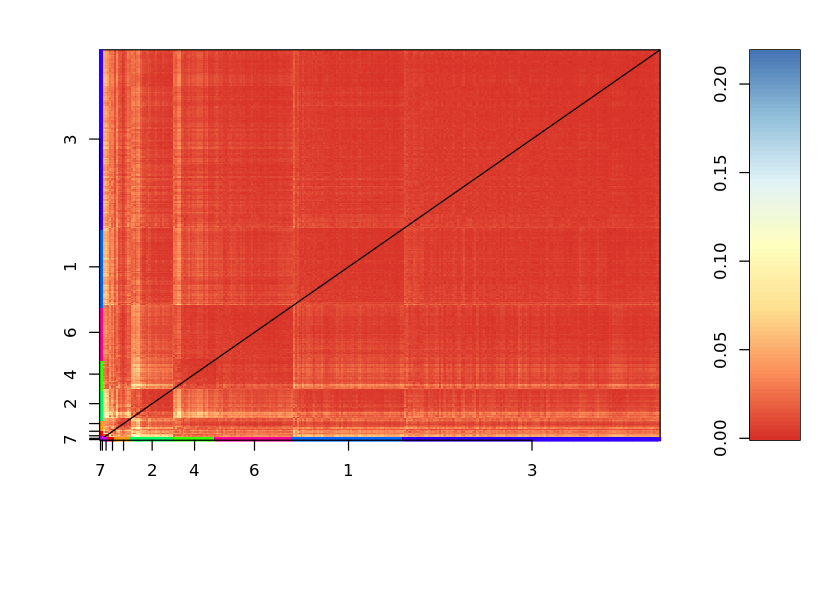

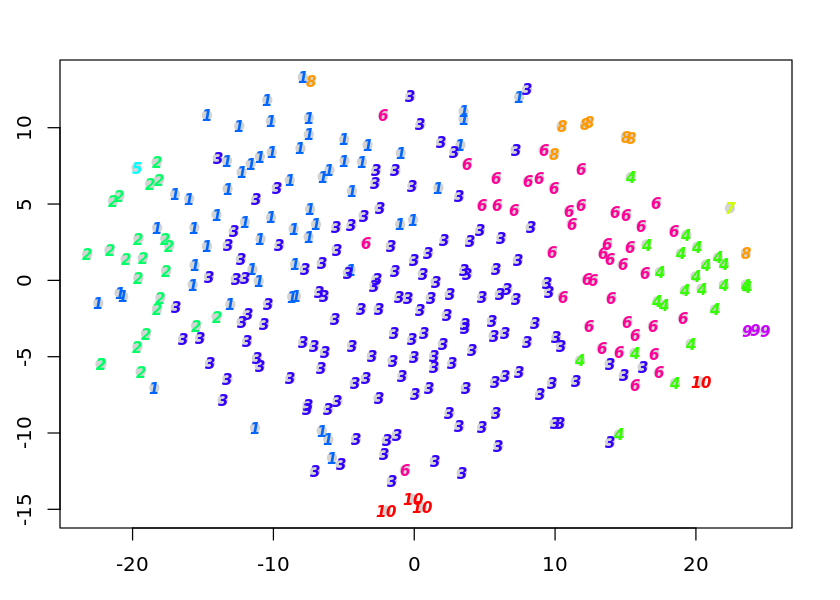

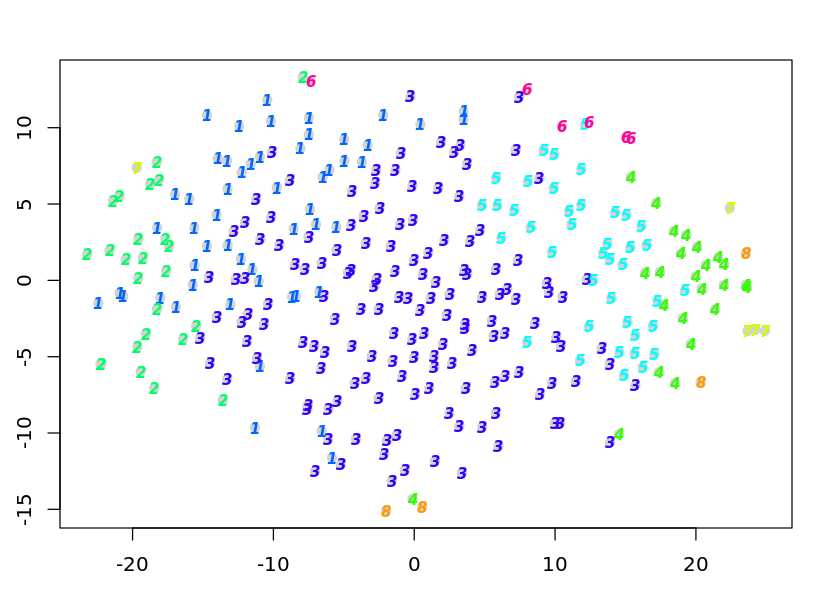

In [245]:
sc_5000_10 <- allForOne(5000, 10)

### clusters = 11

6 clusters under 0.6, 1 at 0.7, 1 at 0.8

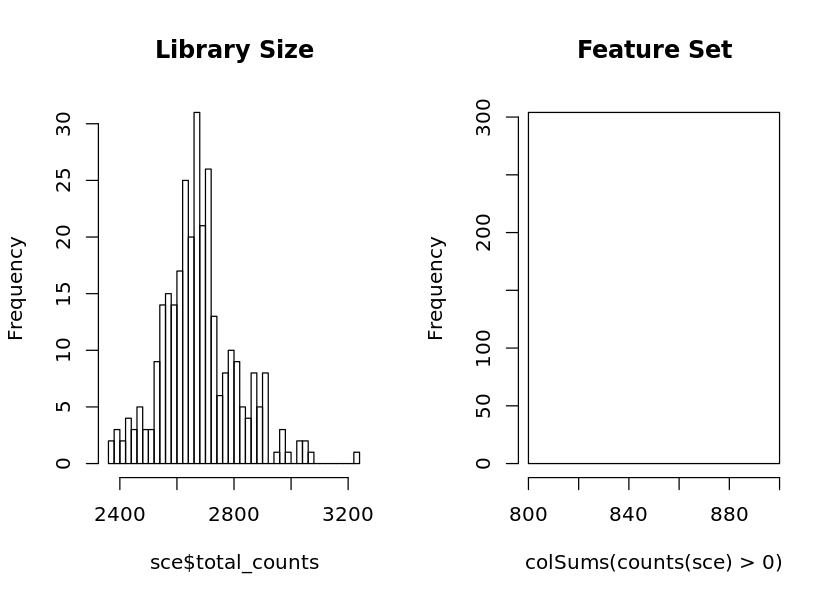

sigma summary: Min. : 0.0161719486531581 |1st Qu. : 0.0202335760666798 |Median : 0.0223302286720869 |Mean : 0.0254994191829608 |3rd Qu. : 0.0257043593624722 |Max. : 0.0824476693322376 |
Epoch: Iteration #100 error is: 0.942858090991594
Epoch: Iteration #200 error is: 0.939184340859181
Epoch: Iteration #300 error is: 0.938310911135474
Epoch: Iteration #400 error is: 0.938192924338872
Epoch: Iteration #500 error is: 0.938185364777055
Epoch: Iteration #600 error is: 0.9381847629667
Epoch: Iteration #700 error is: 0.938184710081164
Epoch: Iteration #800 error is: 0.938184705244591
Epoch: Iteration #900 error is: 0.938184704796518
Epoch: Iteration #1000 error is: 0.938184704756378


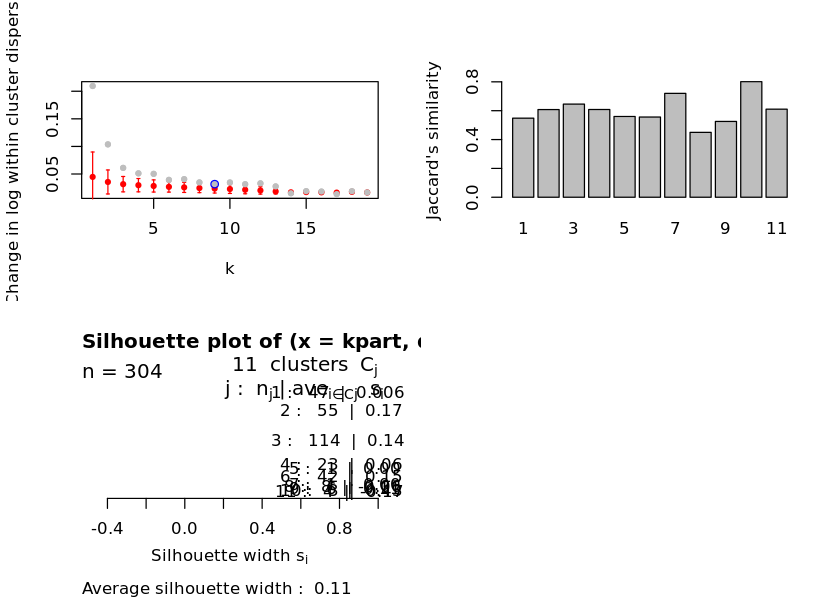

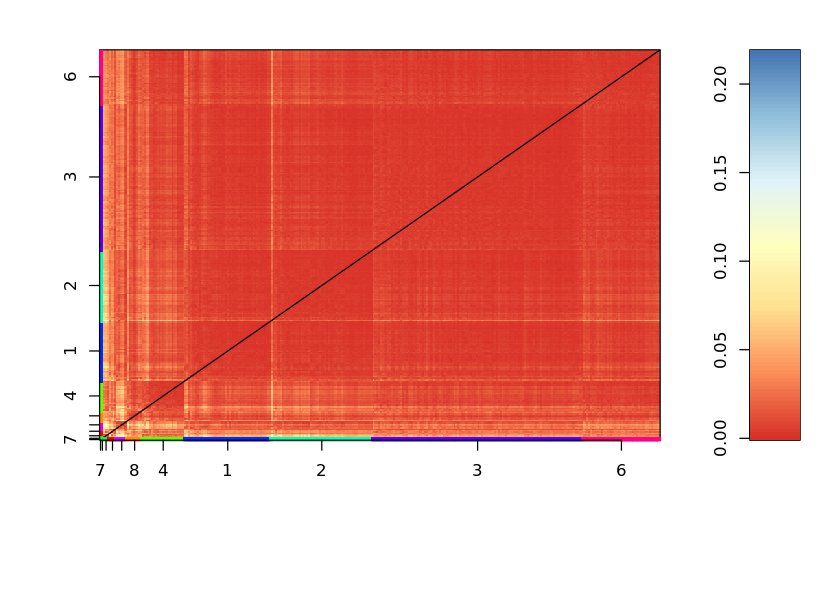

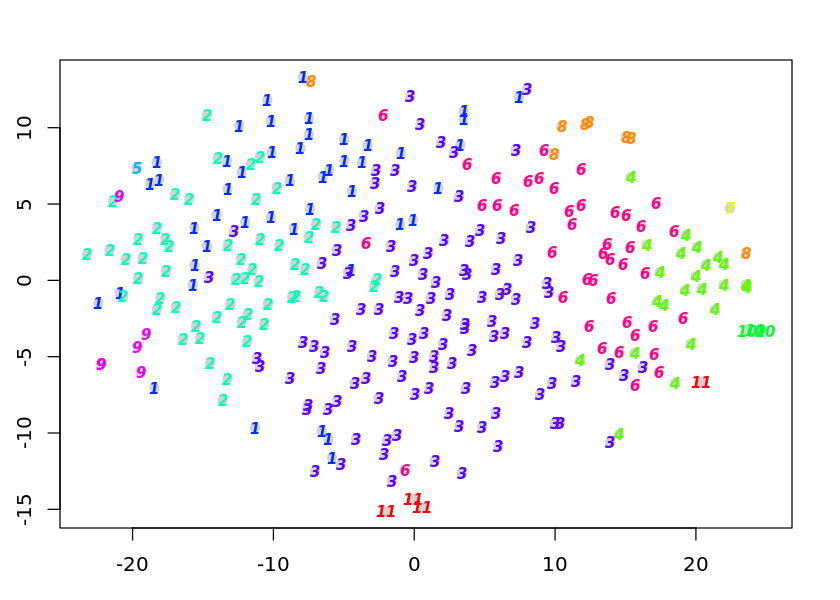

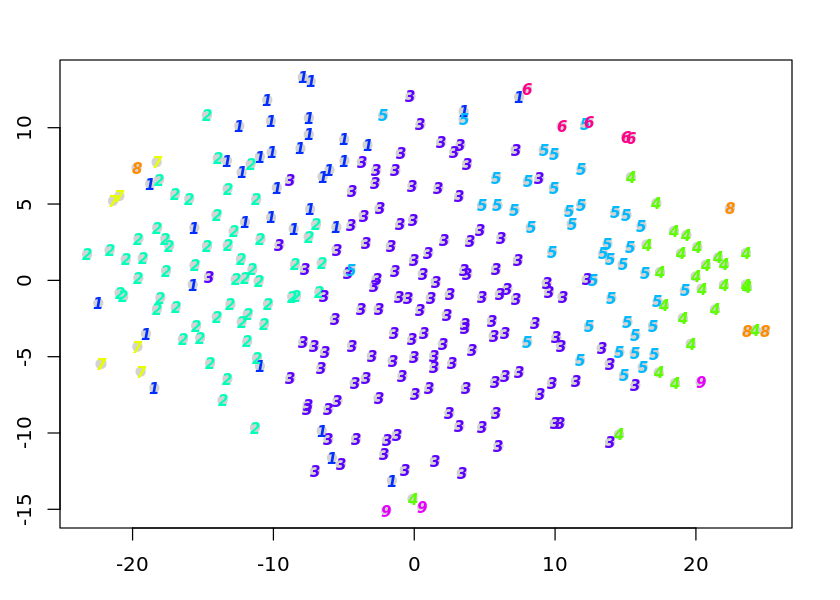

In [246]:
sc_5000_11 <- allForOne(5000, 11)

### clusters = 12

6 clusters under 0.6

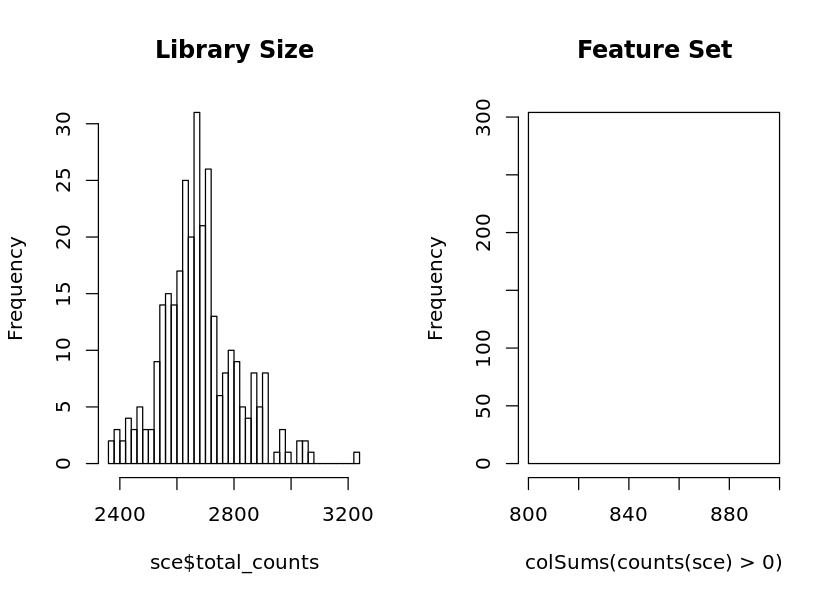

sigma summary: Min. : 0.0161719486531581 |1st Qu. : 0.0202335760666798 |Median : 0.0223302286720869 |Mean : 0.0254994191829608 |3rd Qu. : 0.0257043593624722 |Max. : 0.0824476693322376 |
Epoch: Iteration #100 error is: 0.942858090991594
Epoch: Iteration #200 error is: 0.939184340859181
Epoch: Iteration #300 error is: 0.938310911135474
Epoch: Iteration #400 error is: 0.938192924338872
Epoch: Iteration #500 error is: 0.938185364777055
Epoch: Iteration #600 error is: 0.9381847629667
Epoch: Iteration #700 error is: 0.938184710081164
Epoch: Iteration #800 error is: 0.938184705244591
Epoch: Iteration #900 error is: 0.938184704796518
Epoch: Iteration #1000 error is: 0.938184704756378


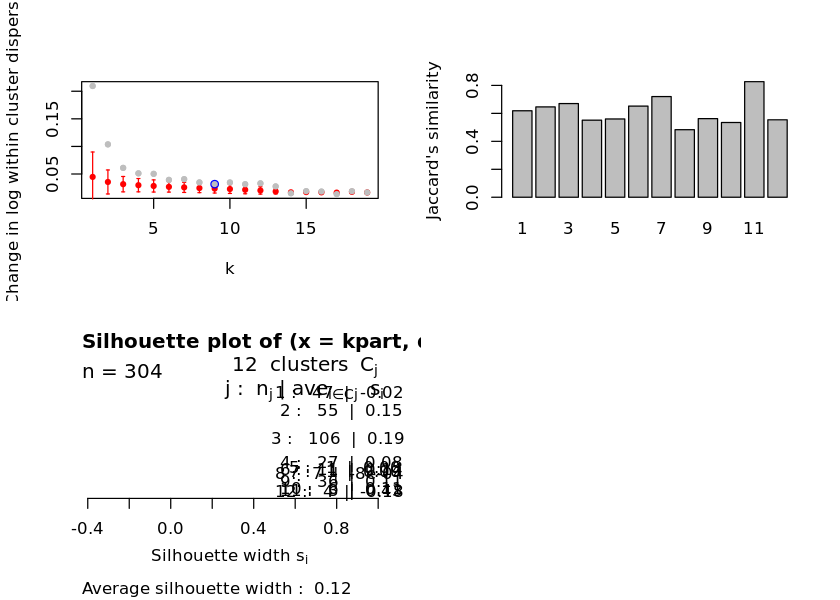

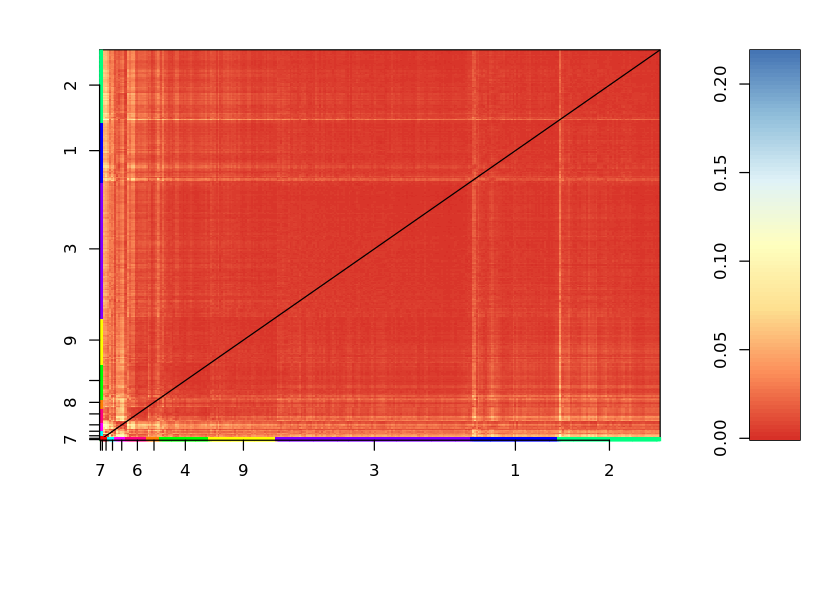

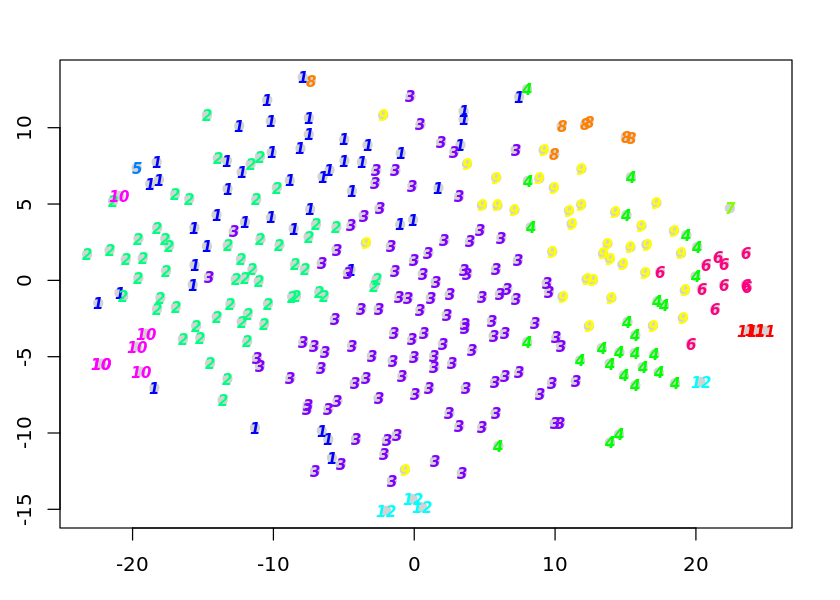

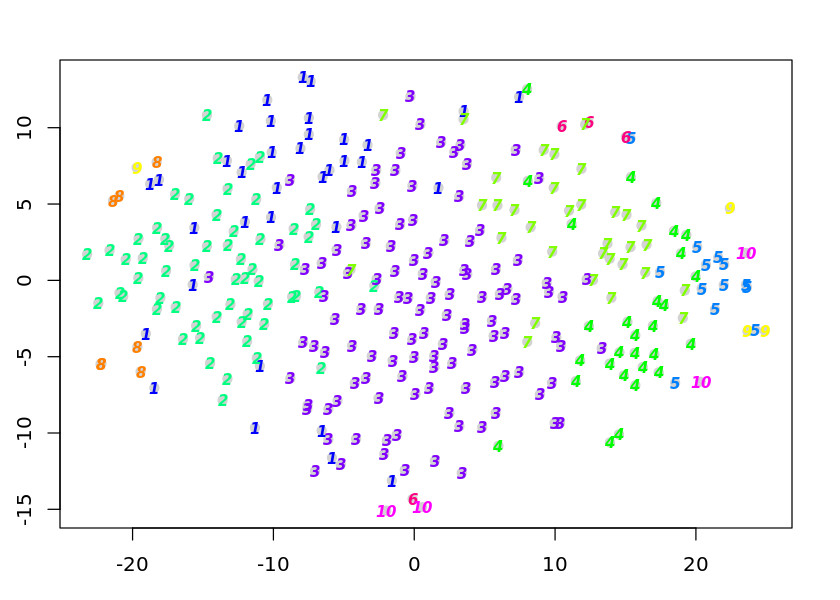

In [269]:
sc_5000_12 <- allForOne(5000, 12)

### clusters = 13

5 clusters under 0.6, 4 over 0.7

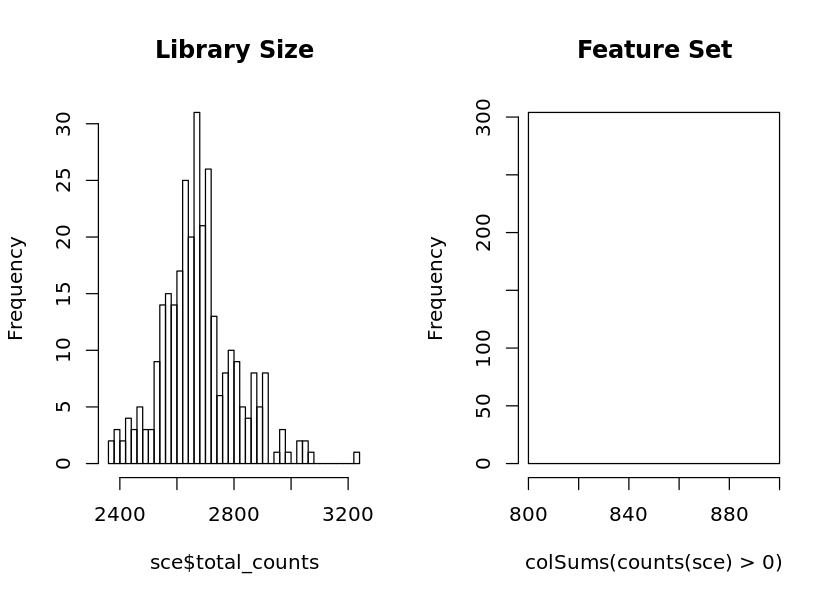

sigma summary: Min. : 0.0161719486531581 |1st Qu. : 0.0202335760666798 |Median : 0.0223302286720869 |Mean : 0.0254994191829608 |3rd Qu. : 0.0257043593624722 |Max. : 0.0824476693322376 |
Epoch: Iteration #100 error is: 0.942858090991594
Epoch: Iteration #200 error is: 0.939184340859181
Epoch: Iteration #300 error is: 0.938310911135474
Epoch: Iteration #400 error is: 0.938192924338872
Epoch: Iteration #500 error is: 0.938185364777055
Epoch: Iteration #600 error is: 0.9381847629667
Epoch: Iteration #700 error is: 0.938184710081164
Epoch: Iteration #800 error is: 0.938184705244591
Epoch: Iteration #900 error is: 0.938184704796518
Epoch: Iteration #1000 error is: 0.938184704756378


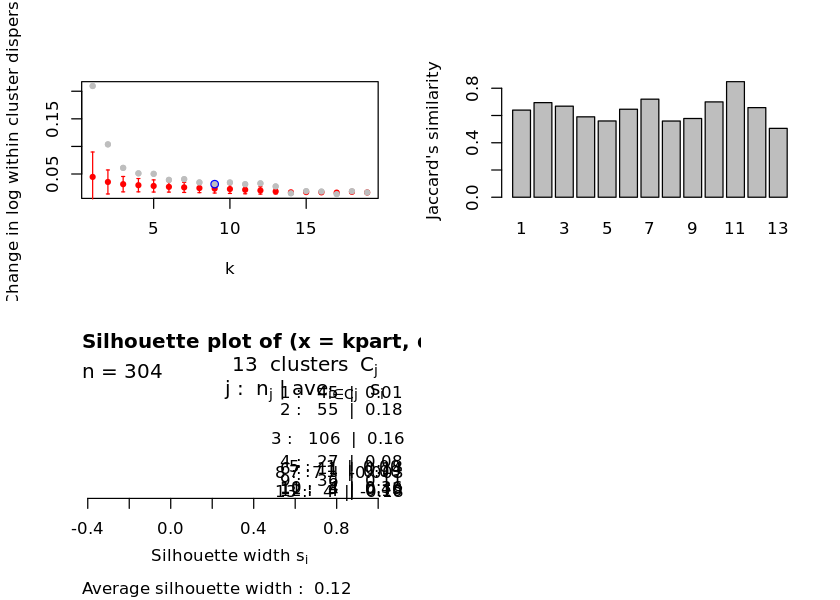

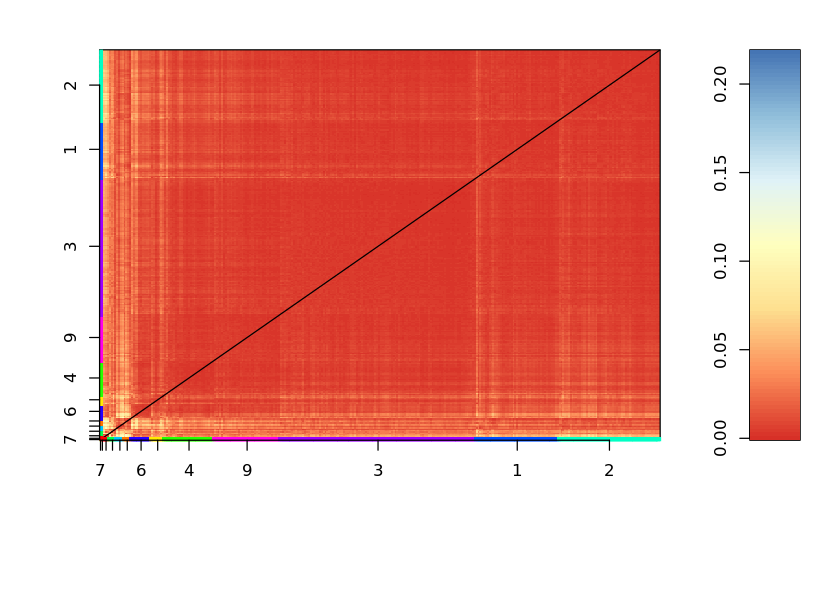

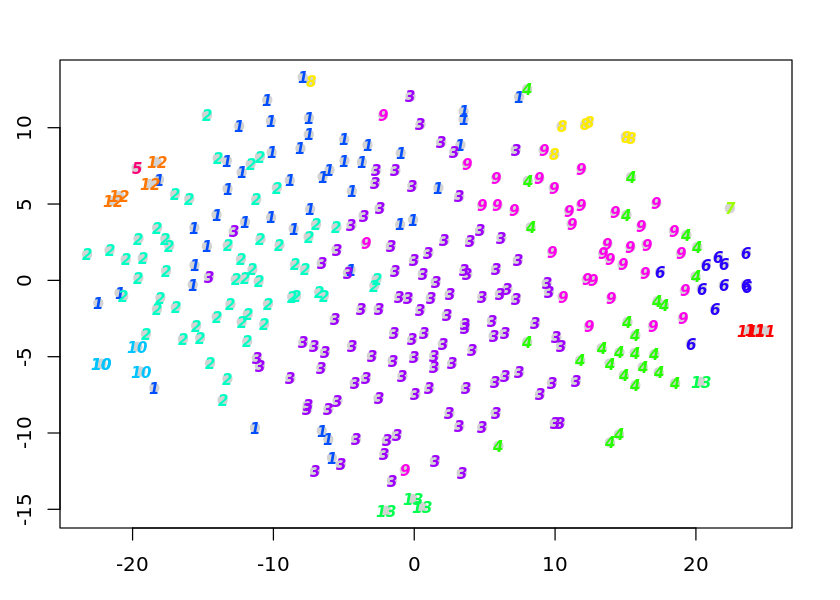

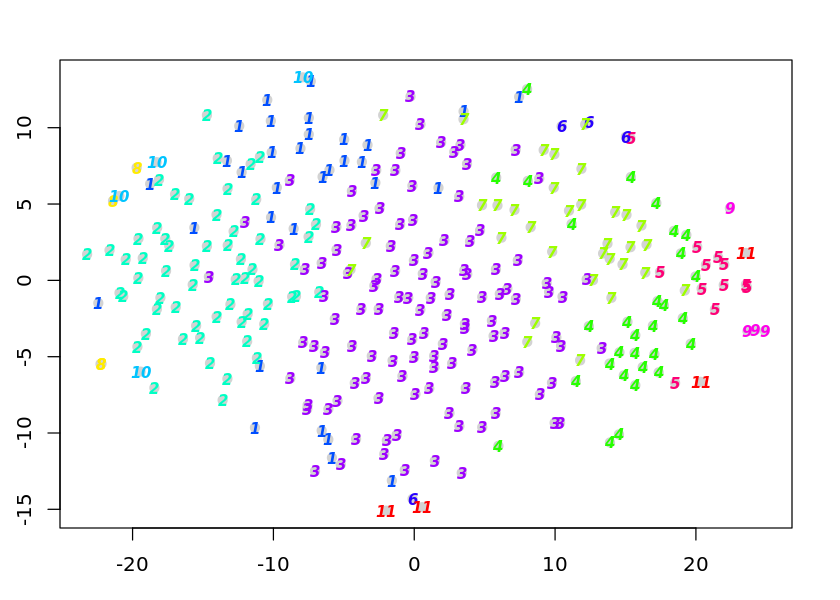

In [249]:
sc_5000_13 <- allForOne(5000, 13)

### clusters = 14

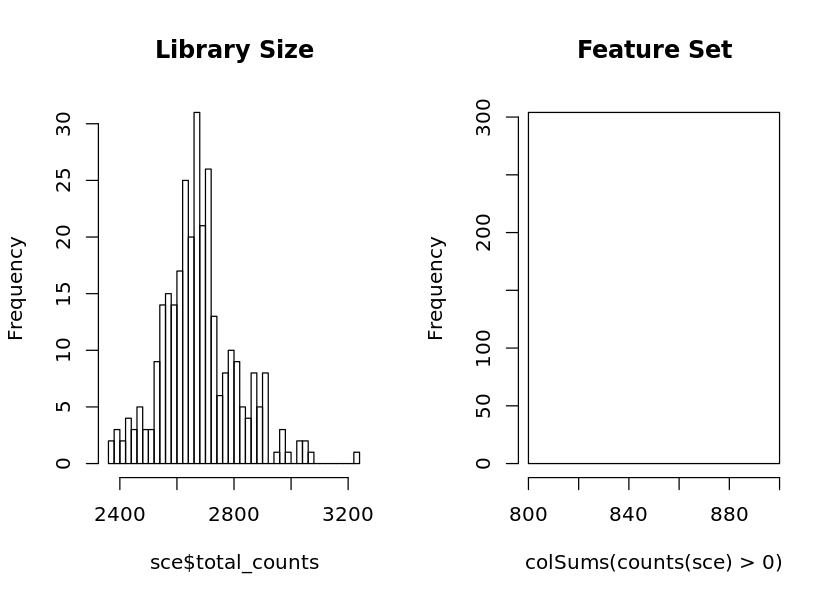

sigma summary: Min. : 0.0161719486531581 |1st Qu. : 0.0202335760666798 |Median : 0.0223302286720869 |Mean : 0.0254994191829608 |3rd Qu. : 0.0257043593624722 |Max. : 0.0824476693322376 |
Epoch: Iteration #100 error is: 0.942858090991594
Epoch: Iteration #200 error is: 0.939184340859181
Epoch: Iteration #300 error is: 0.938310911135474
Epoch: Iteration #400 error is: 0.938192924338872
Epoch: Iteration #500 error is: 0.938185364777055
Epoch: Iteration #600 error is: 0.9381847629667
Epoch: Iteration #700 error is: 0.938184710081164
Epoch: Iteration #800 error is: 0.938184705244591
Epoch: Iteration #900 error is: 0.938184704796518
Epoch: Iteration #1000 error is: 0.938184704756378


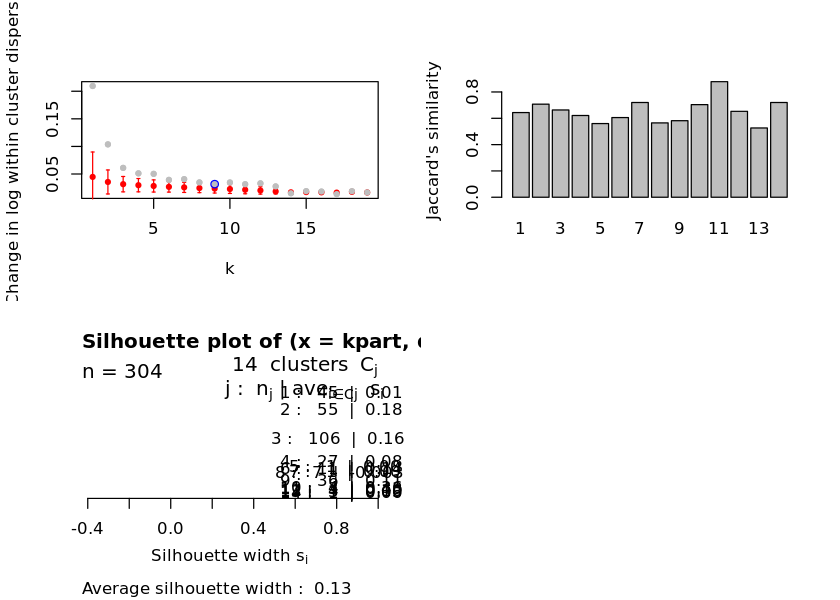

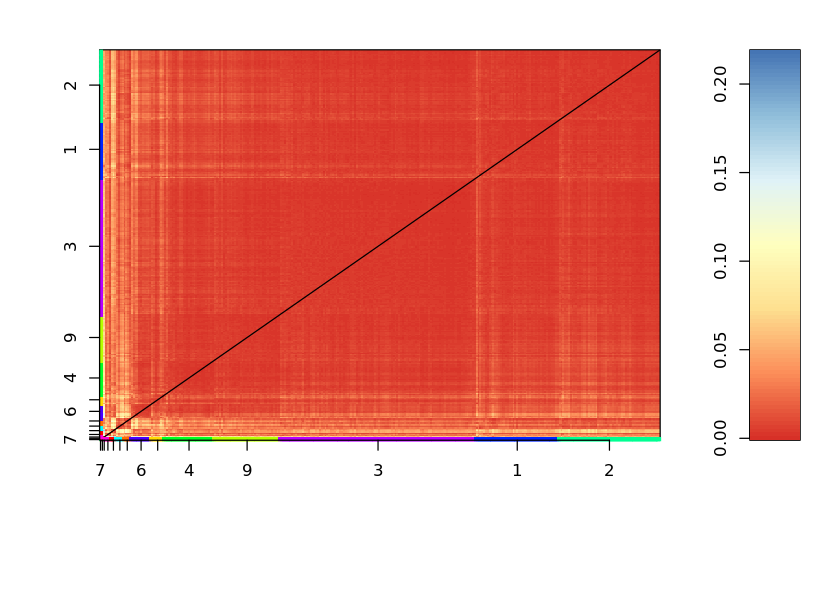

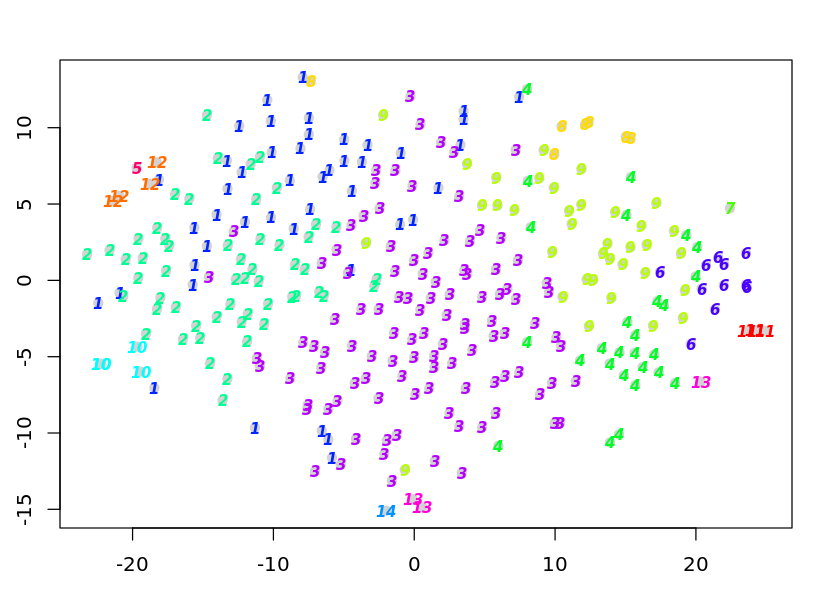

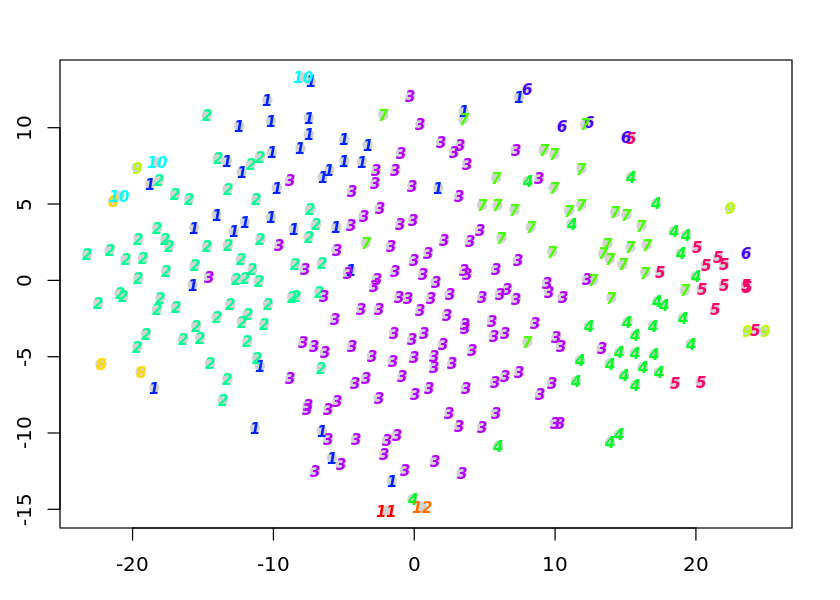

In [250]:
sc_5000_14 <- allForOne(5000, 14)

### clusters = 15

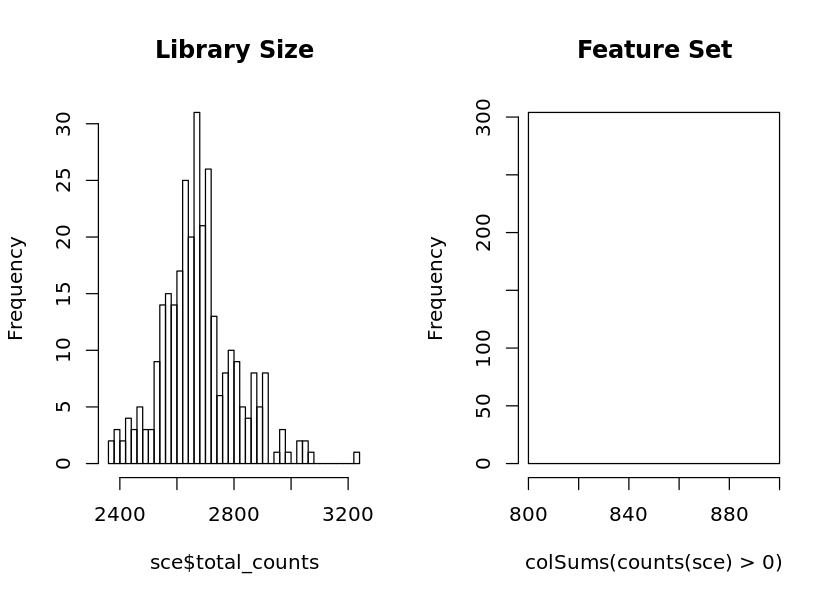

sigma summary: Min. : 0.0161719486531581 |1st Qu. : 0.0202335760666798 |Median : 0.0223302286720869 |Mean : 0.0254994191829608 |3rd Qu. : 0.0257043593624722 |Max. : 0.0824476693322376 |
Epoch: Iteration #100 error is: 0.942858090991594
Epoch: Iteration #200 error is: 0.939184340859181
Epoch: Iteration #300 error is: 0.938310911135474
Epoch: Iteration #400 error is: 0.938192924338872
Epoch: Iteration #500 error is: 0.938185364777055
Epoch: Iteration #600 error is: 0.9381847629667
Epoch: Iteration #700 error is: 0.938184710081164
Epoch: Iteration #800 error is: 0.938184705244591
Epoch: Iteration #900 error is: 0.938184704796518
Epoch: Iteration #1000 error is: 0.938184704756378


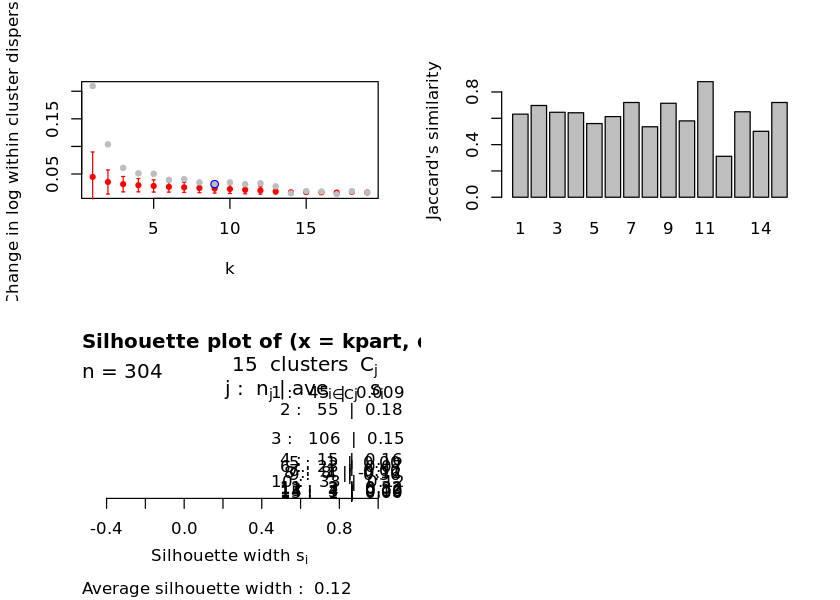

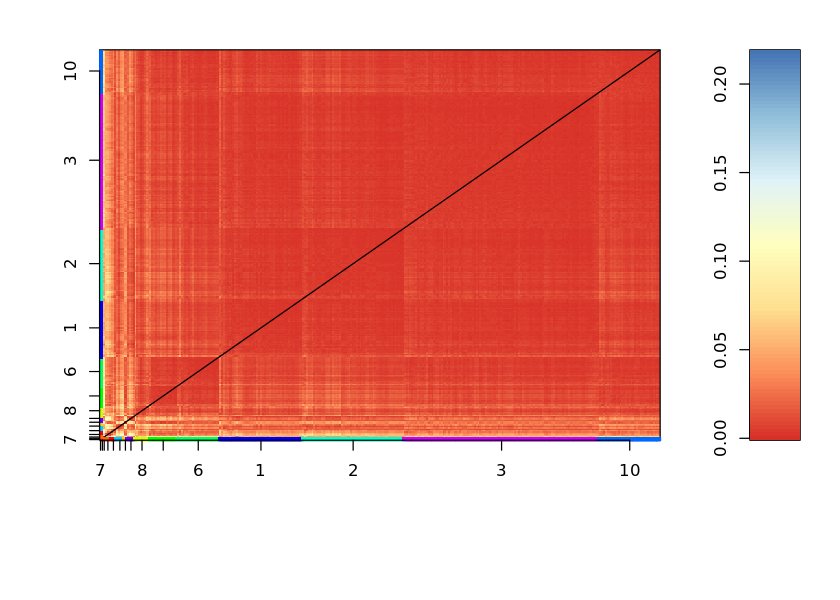

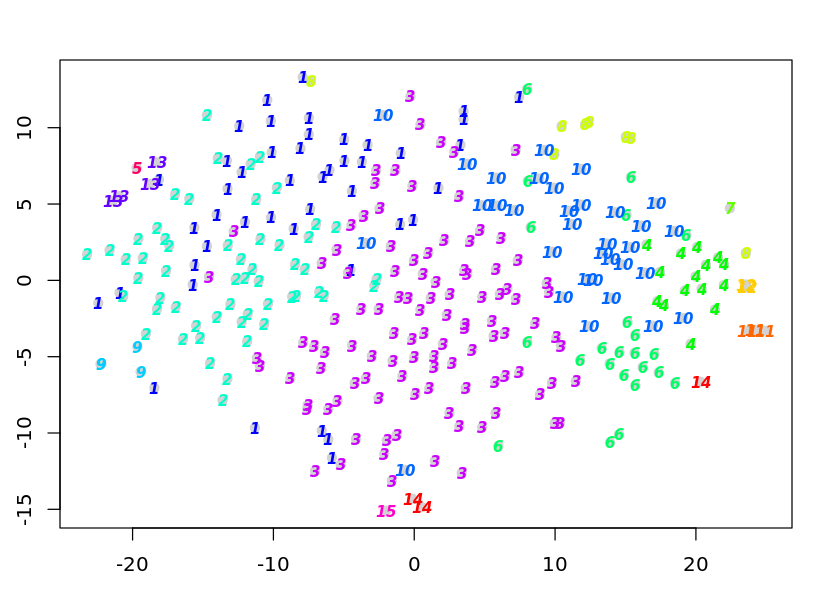

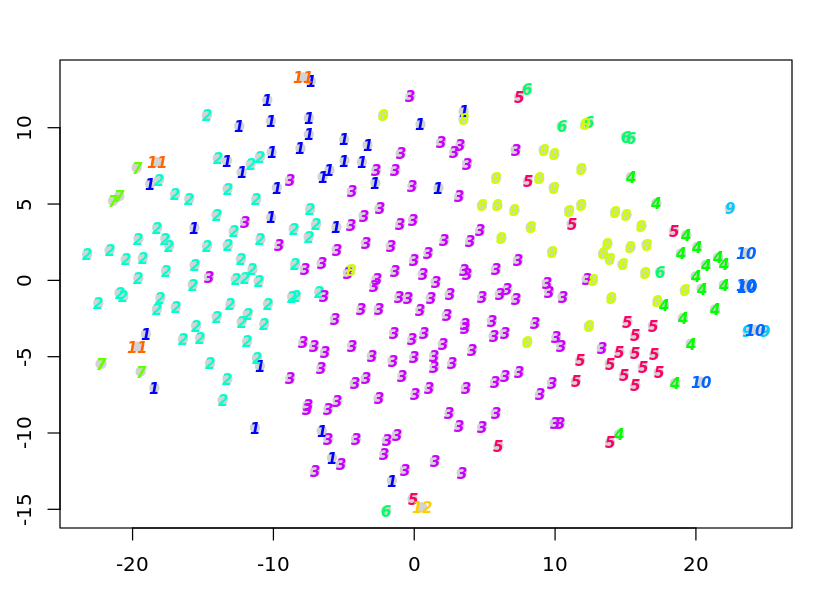

In [251]:
sc_5000_15 <- allForOne(5000, 15)

Clusters beyond 12 seem to introduce too much single outlier clusters, despite marginal gains in some of the larger clusters.

We will proceed with clusters = 12

## Silhouette plot stability

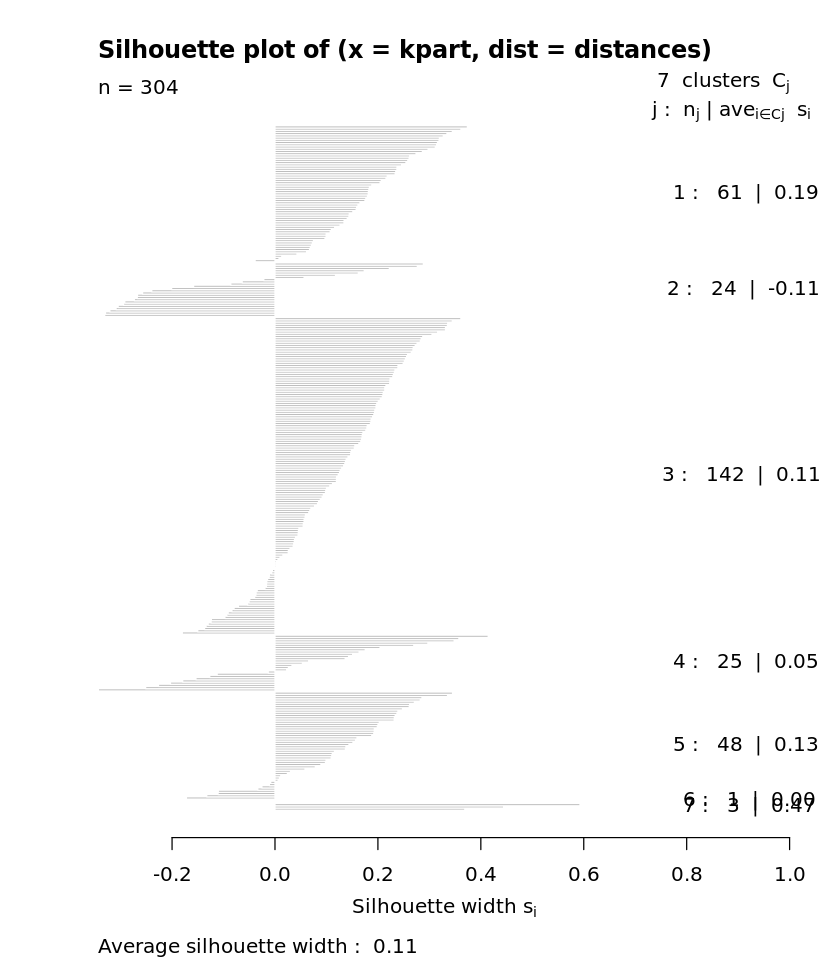

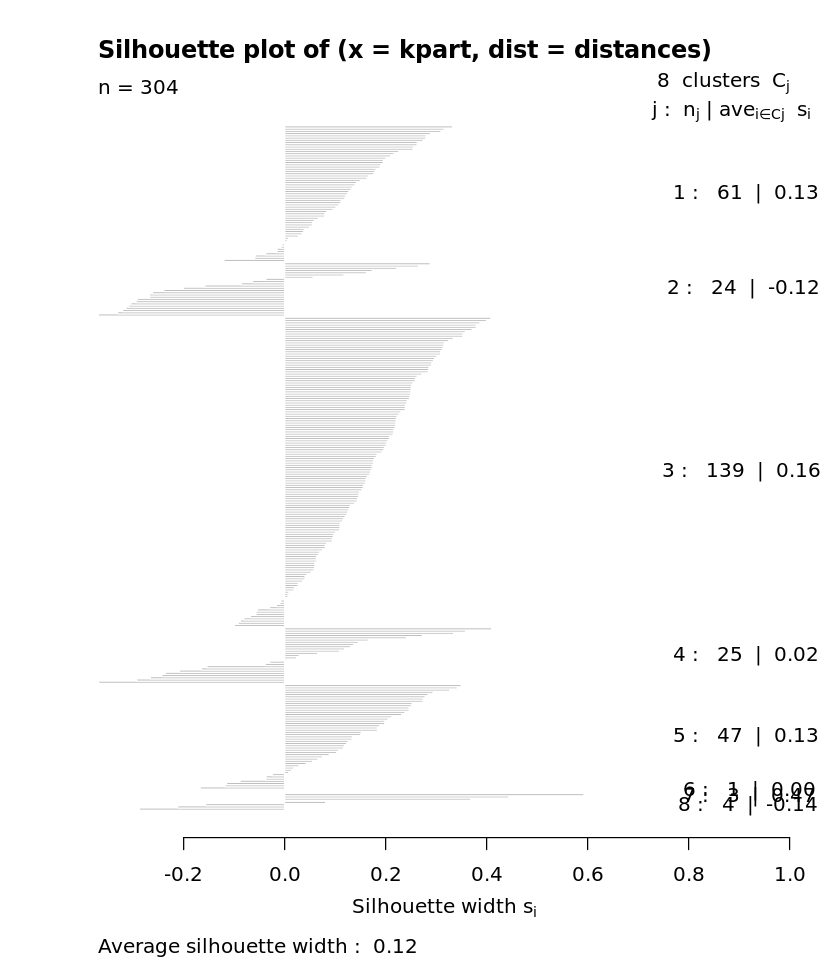

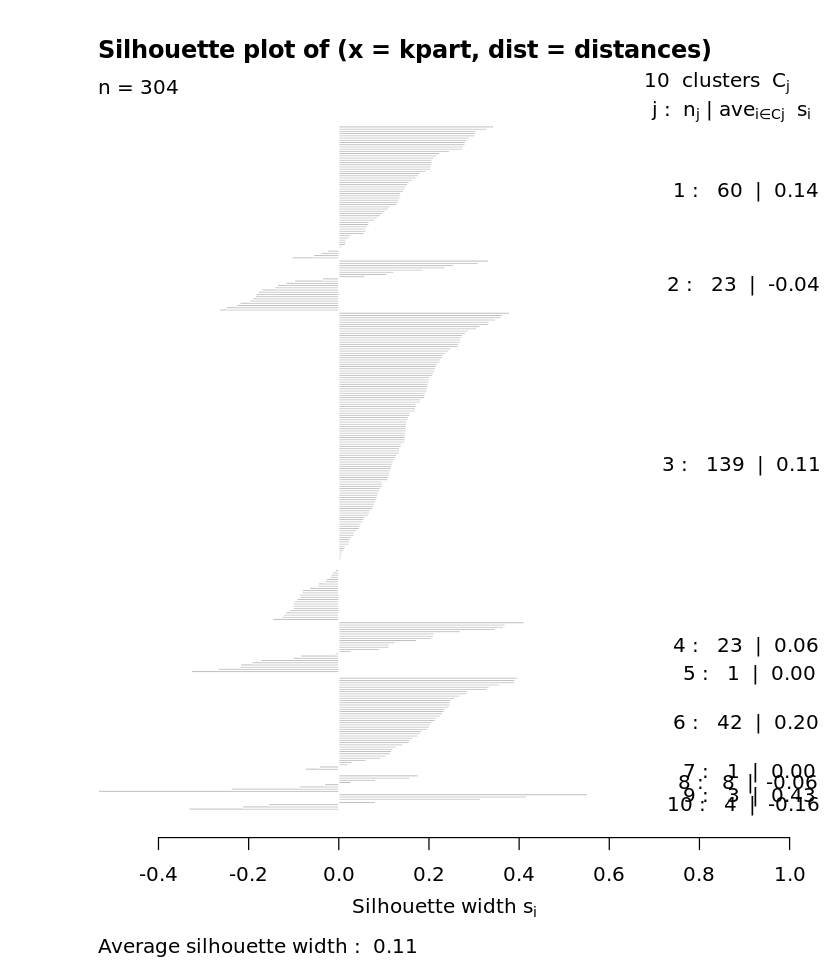

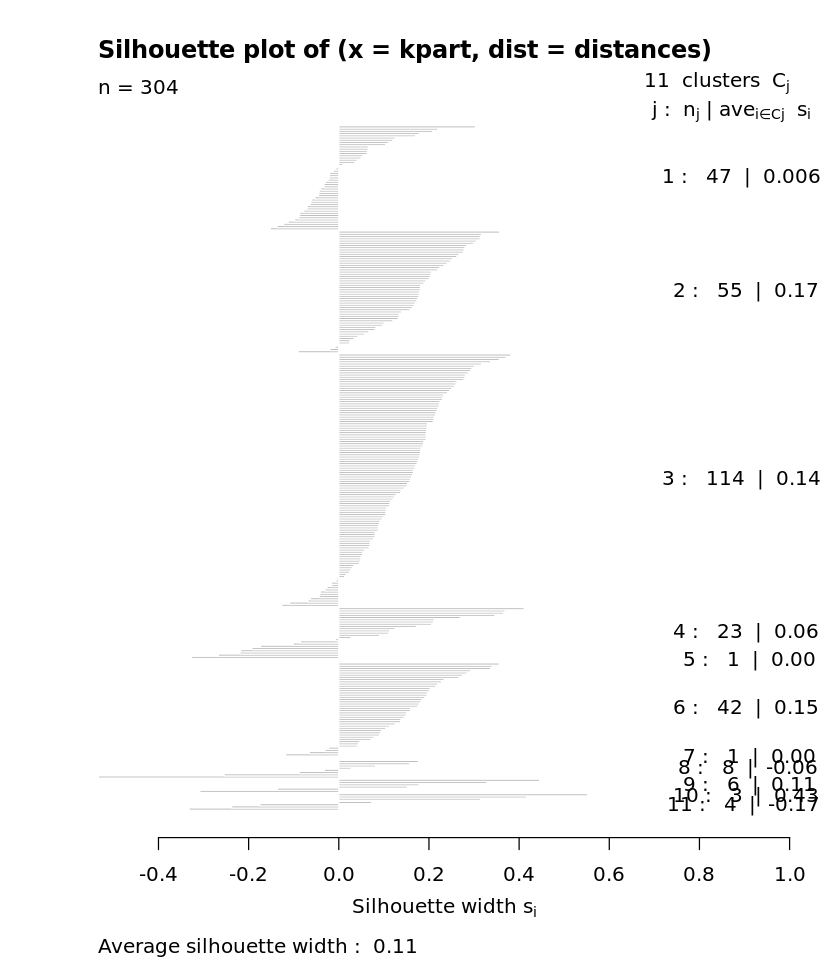

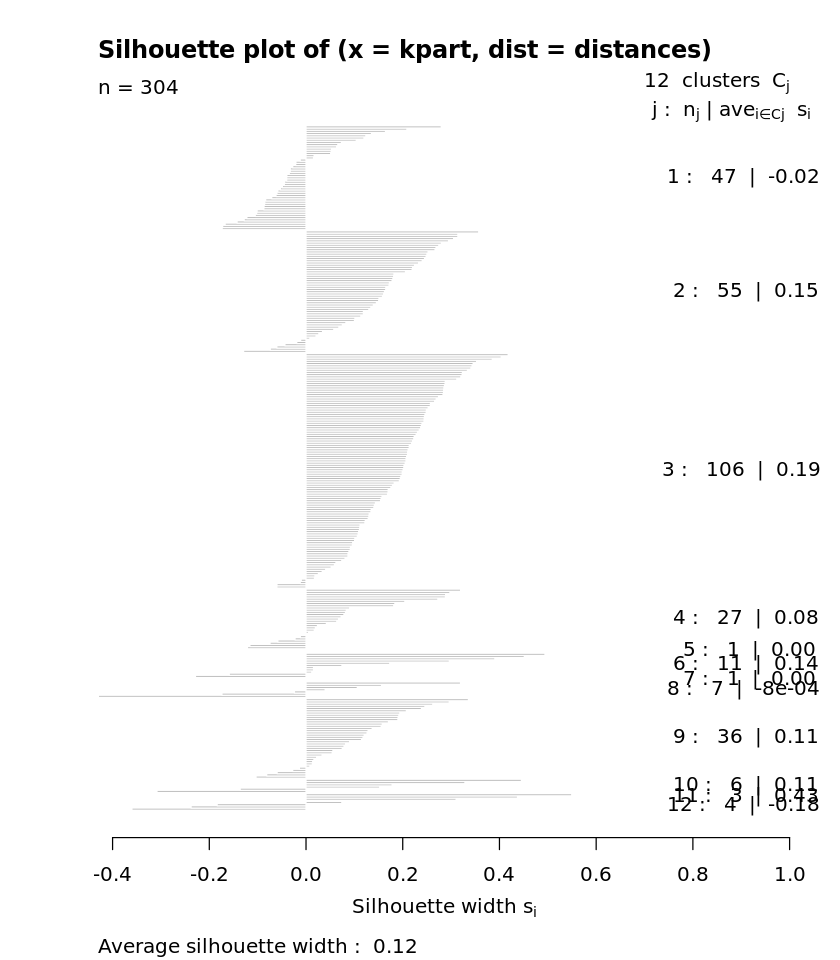

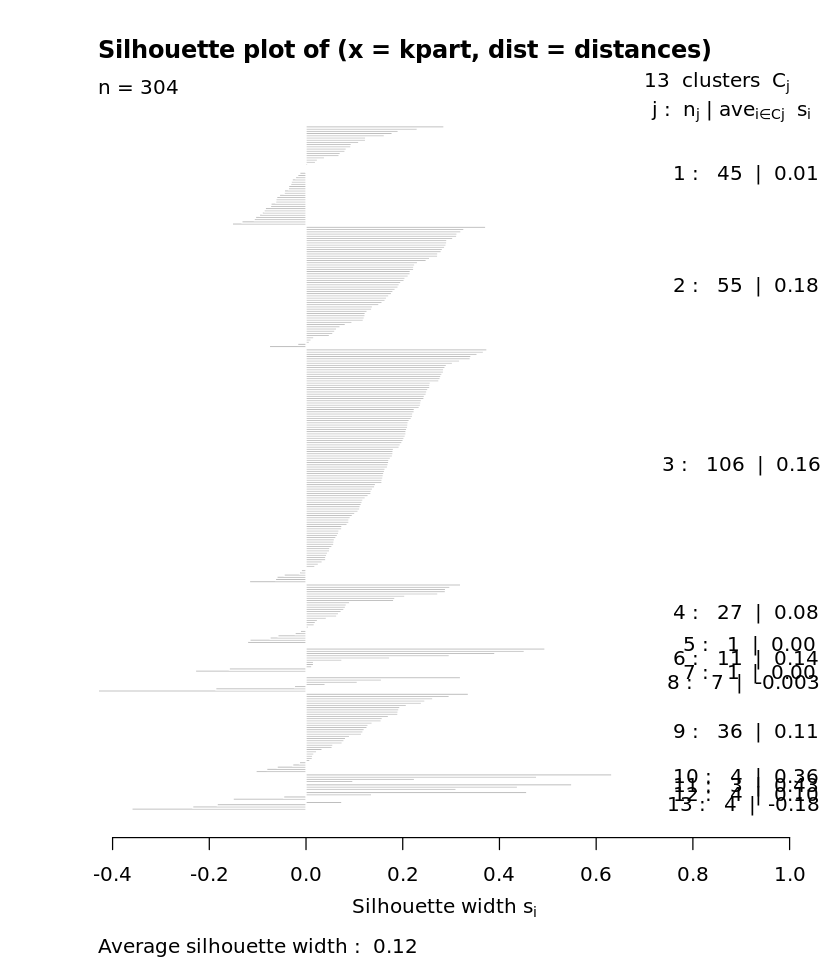

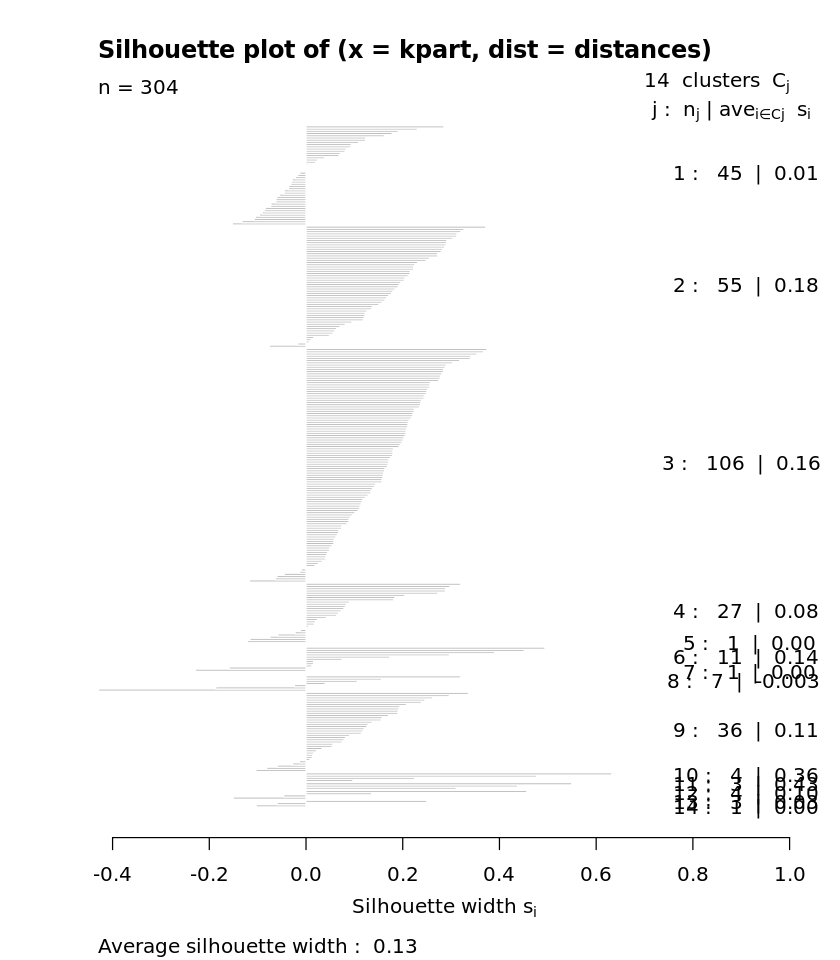

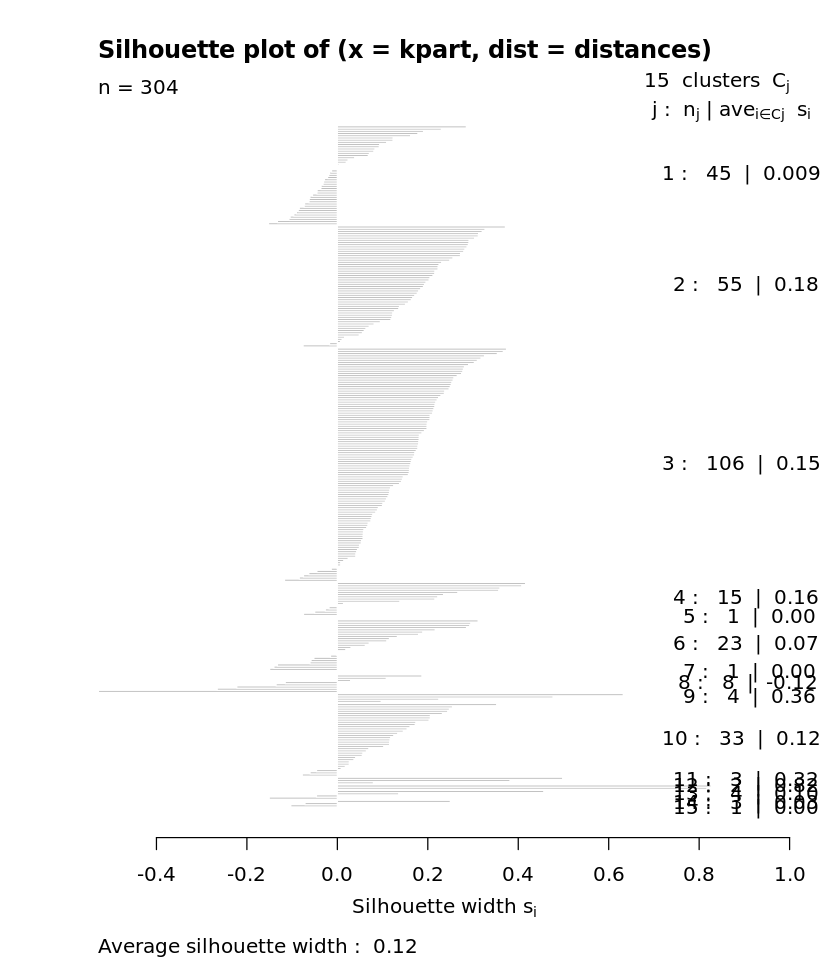

In [268]:
options(repr.plot.height = 8)
plotsilhouette(sc_5000_7)
plotsilhouette(sc_5000_8)
plotsilhouette(sc_5000_9)
plotsilhouette(sc_5000_10)
plotsilhouette(sc_5000_11)
plotsilhouette(sc_5000_12)
plotsilhouette(sc_5000_13)
plotsilhouette(sc_5000_14)
plotsilhouette(sc_5000_15)

Silhouette plot seems show a better clustering for clusters=10, although the tsne plots don't really reflect this.

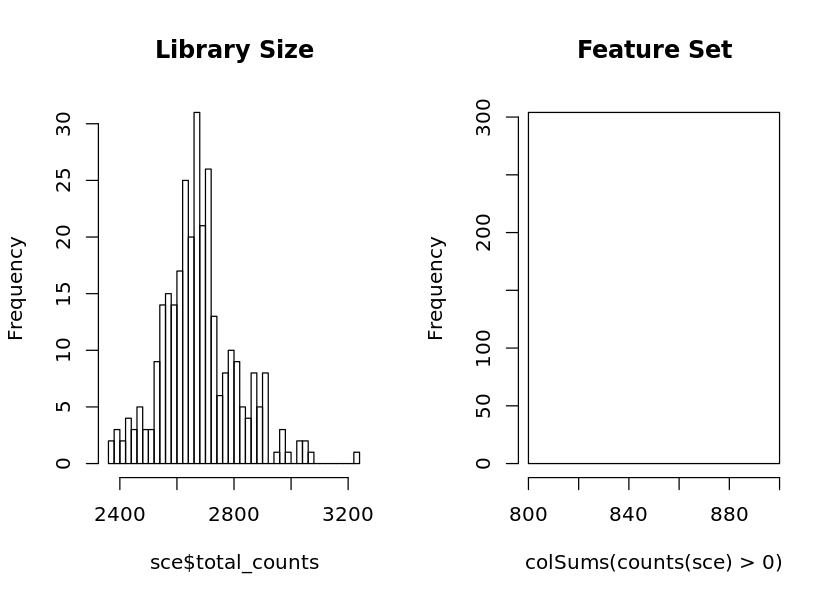

sigma summary: Min. : 0.0161719486531581 |1st Qu. : 0.0202335760666798 |Median : 0.0223302286720869 |Mean : 0.0254994191829608 |3rd Qu. : 0.0257043593624722 |Max. : 0.0824476693322376 |
Epoch: Iteration #100 error is: 0.942858090991594
Epoch: Iteration #200 error is: 0.939184340859181
Epoch: Iteration #300 error is: 0.938310911135474
Epoch: Iteration #400 error is: 0.938192924338872
Epoch: Iteration #500 error is: 0.938185364777055
Epoch: Iteration #600 error is: 0.9381847629667
Epoch: Iteration #700 error is: 0.938184710081164
Epoch: Iteration #800 error is: 0.938184705244591
Epoch: Iteration #900 error is: 0.938184704796518
Epoch: Iteration #1000 error is: 0.938184704756378


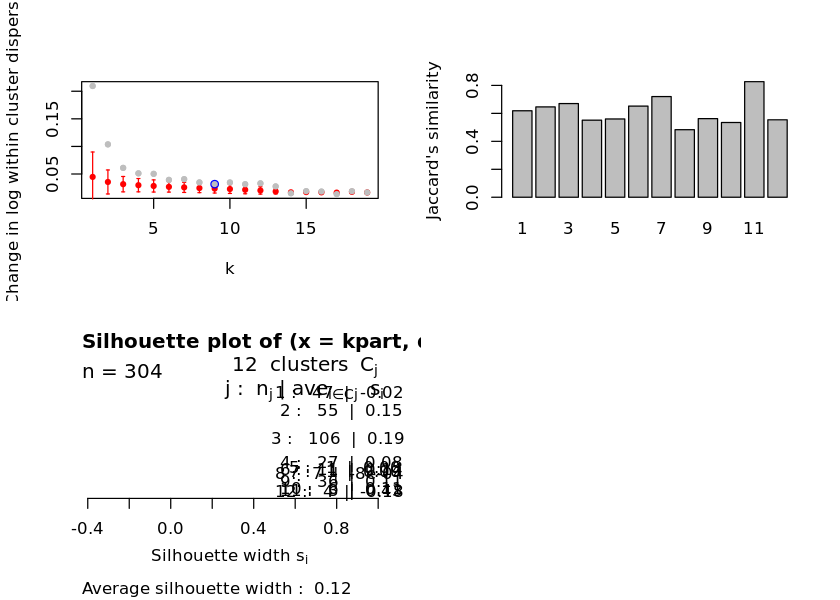

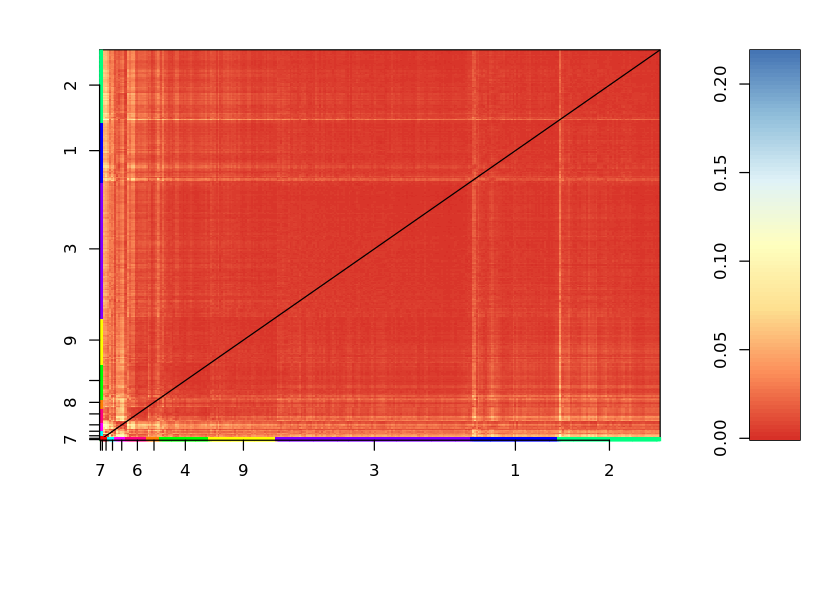

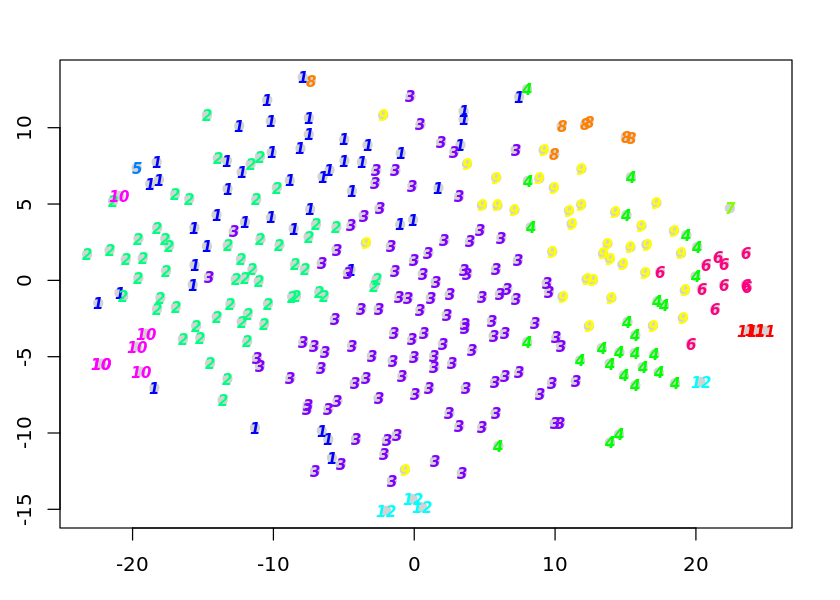

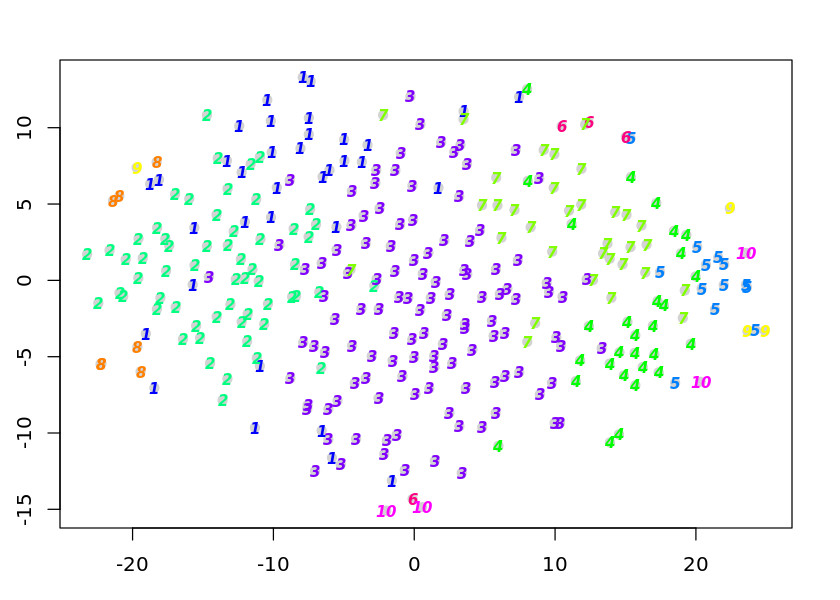

In [274]:
### Final clustering and heatmap with different maximisation method
sc_5000_12_first = allForOne(5000, 12, "firstSEmax")

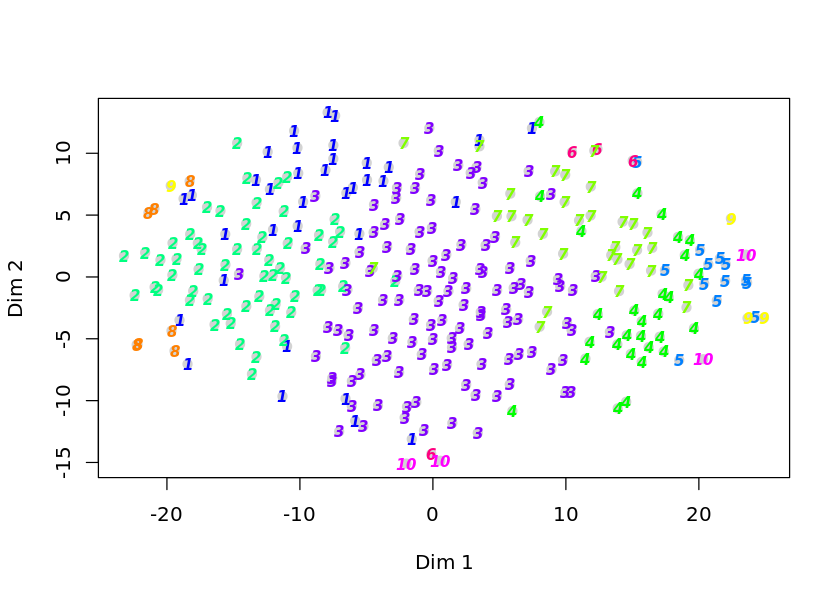

In [284]:
#plottsne(sc_5000_12_first)
plottsne(sc_5000_12_first, final = T)
#x <- clustheatmap(sc_5000_12, final=T)
#x <- clustheatmap(sc_5000_12_first, final=T)

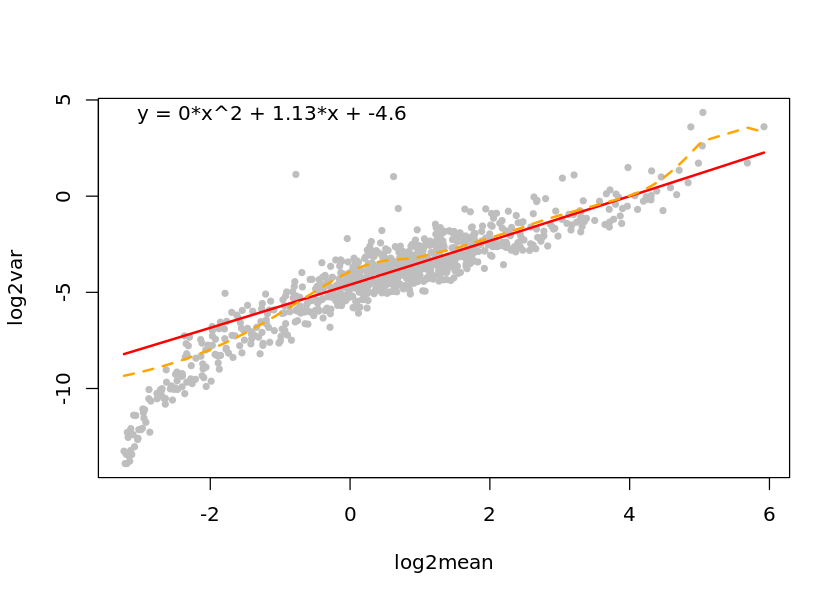

In [285]:
plotbackground(sc_5000_12_first)

sigma summary: Min. : 0.0161719486531581 |1st Qu. : 0.0202335760666798 |Median : 0.0223302286720869 |Mean : 0.0254994191829608 |3rd Qu. : 0.0257043593624722 |Max. : 0.0824476693322376 |
Epoch: Iteration #100 error is: 0.942858090991594
Epoch: Iteration #200 error is: 0.939184340859181
Epoch: Iteration #300 error is: 0.938310911135474
Epoch: Iteration #400 error is: 0.938192924338872
Epoch: Iteration #500 error is: 0.938185364777055
Epoch: Iteration #600 error is: 0.9381847629667
Epoch: Iteration #700 error is: 0.938184710081164
Epoch: Iteration #800 error is: 0.938184705244591
Epoch: Iteration #900 error is: 0.938184704796518
Epoch: Iteration #1000 error is: 0.938184704756378


Initial stress        : 0.38454
stress after  10 iters: 0.05313, magic = 0.152
stress after  20 iters: 0.04609, magic = 0.500
stress after  30 iters: 0.04599, magic = 0.500
stress after  40 iters: 0.04597, magic = 0.500


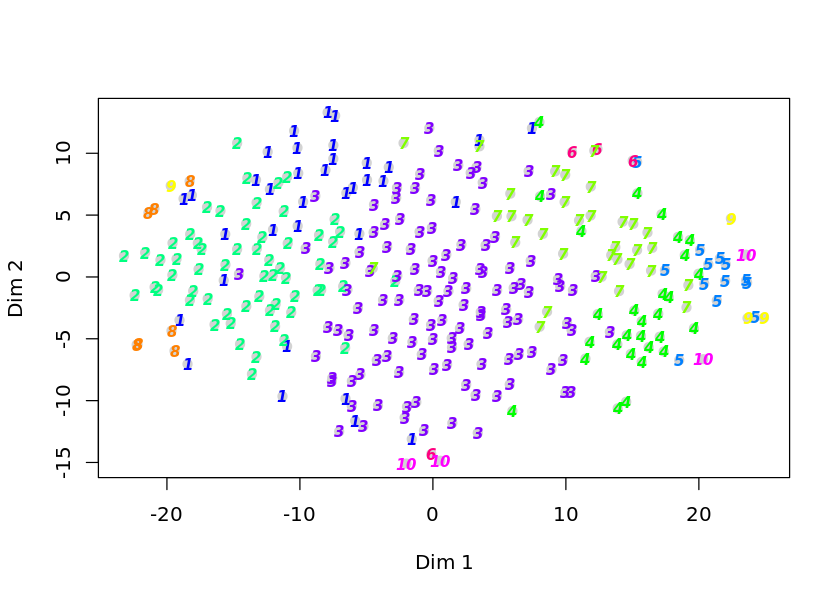

sigma summary: Min. : 0.0161719486531581 |1st Qu. : 0.0202335760666798 |Median : 0.0223302286720869 |Mean : 0.0254994191829608 |3rd Qu. : 0.0257043593624722 |Max. : 0.0824476693322376 |
Epoch: Iteration #100 error is: 16.3791066856392
Epoch: Iteration #200 error is: 0.984551180239812
Epoch: Iteration #300 error is: 0.967971676921367
Epoch: Iteration #400 error is: 0.966766261542267
Epoch: Iteration #500 error is: 0.959537459372311
Epoch: Iteration #600 error is: 0.959279676650446
Epoch: Iteration #700 error is: 0.95927959723393
Epoch: Iteration #800 error is: 0.959279595643662
Epoch: Iteration #900 error is: 0.959279595534418
Epoch: Iteration #1000 error is: 0.95927959552708


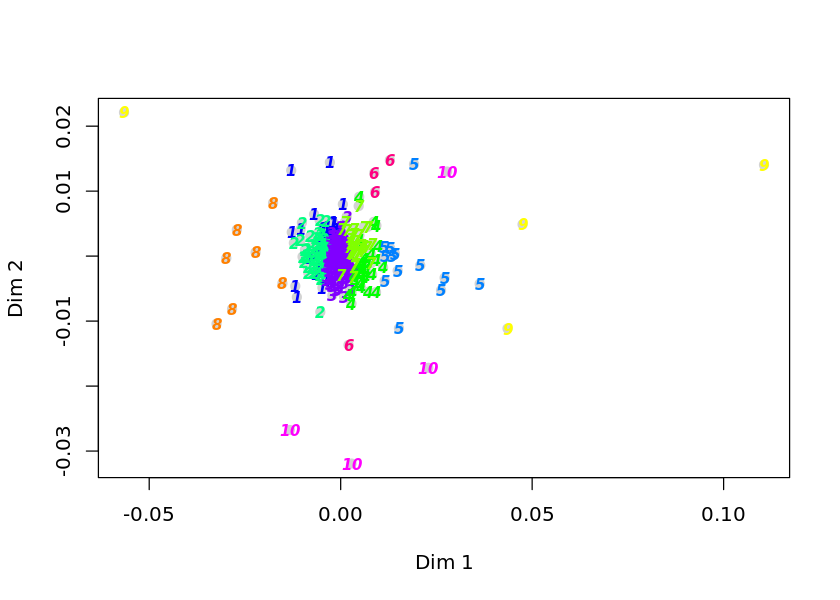

Initial stress        : 0.38454
stress after  10 iters: 0.05313, magic = 0.152
stress after  20 iters: 0.04609, magic = 0.500
stress after  30 iters: 0.04599, magic = 0.500
stress after  40 iters: 0.04597, magic = 0.500


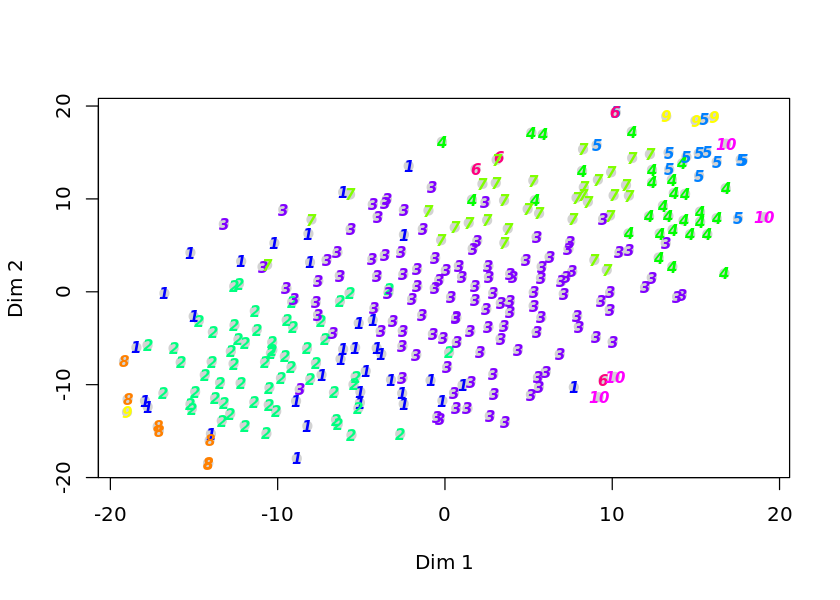

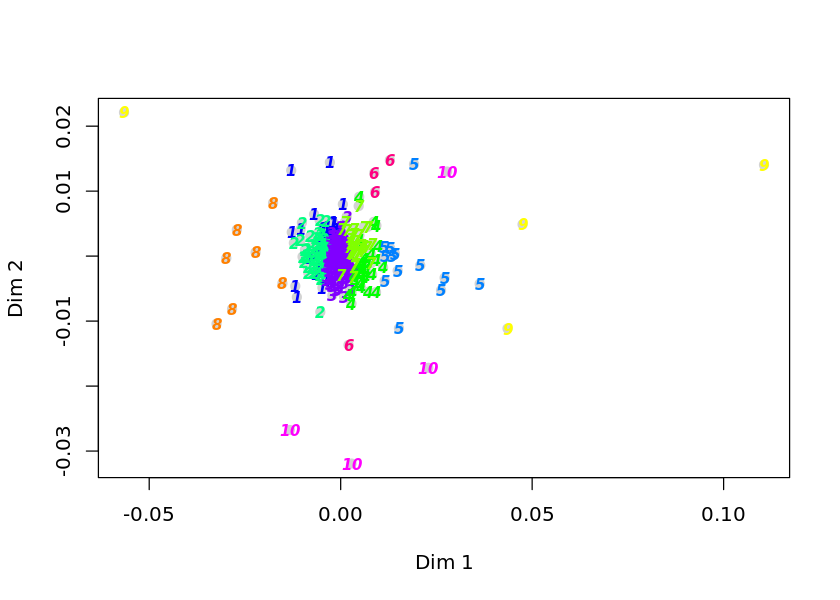

In [288]:
# Quick check that the clustering parameters aren't affecting the analysis
# answer: no
sce_samF_cmdT <- comptsne(sc_5000_12_first, rseed=15555, sammonmap=FALSE, initial_cmd=TRUE)
plottsne(sce_samF_cmdT)
sce_samT_cmdT <- comptsne(sc_5000_12_first, rseed=15555, sammonmap=T, initial_cmd=TRUE)
plottsne(sce_samT_cmdT)
sce_samF_cmdF <- comptsne(sc_5000_12_first, rseed=15555, sammonmap=F, initial_cmd=F)
plottsne(sce_samF_cmdF)
sce_samT_cmdF <- comptsne(sc_5000_12_first, rseed=15555, sammonmap=T, initial_cmd=F)
plottsne(sce_samT_cmdF)

In [289]:
print("Outlier Cells")
sort(sc_5000_12_first@out$out)

print("Outlier Genes in each Cluster")
tab <- lapply(sc_5000_12_first@out$outgene, rownames)
tab

[1] "Outlier Cells"


Warning message in is.na(x):
“is.na() applied to non-(list or vector) of type 'NULL'”

NULL

[1] "Outlier Genes in each Cluster"


[[1]]
NULL

[[2]]
NULL

[[3]]
NULL

[[4]]
NULL

[[5]]
NULL

[[6]]
NULL

[[7]]
NULL

[[8]]
NULL

[[9]]
NULL

[[10]]
NULL

[[11]]
NULL

[[12]]
NULL

### Reclassify cells based on random forest

In [89]:
sc_e <- rfcorrect(sc_e)

In [90]:
cdiff <- clustdiffgenes(sc_e, pvalue = .01)

In [91]:
head(cdiff)
# mean.ncl average expression of cells not in cluster
# mean.cl average expression of cells in cluster
# fc fold change

,mean.ncl,mean.cl,fc,pv,padj
H19,12.3611705,1.9861602,0.1606774,6.398798e-112,5.554157e-109
Igf2,6.9055621,1.0010798,0.1449672,2.668822e-102,1.158269e-99
Fn1,8.7983371,2.3885946,0.2714825,6.718897e-84,1.944001e-81
T,9.2950947,2.7649410,0.2974624,4.637770e-80,1.006396e-77
Phlda2,6.3506695,1.3022469,0.2050566,4.168383e-76,7.236313e-74
Peg3,10.7881266,5.5829423,0.5175080,8.872697e-39,1.283584e-36
Ifitm1,3.8123966,1.2288090,0.3223193,5.848577e-31,7.252235e-29
Hand1,2.2313770,0.4470692,0.2003557,3.507023e-28,3.805120e-26
Prtg,8.5381217,4.6285072,0.5420990,1.554884e-27,1.499600e-25
Peg10,1.5099100,0.3102306,0.2054630,1.852254e-19,1.607757e-17


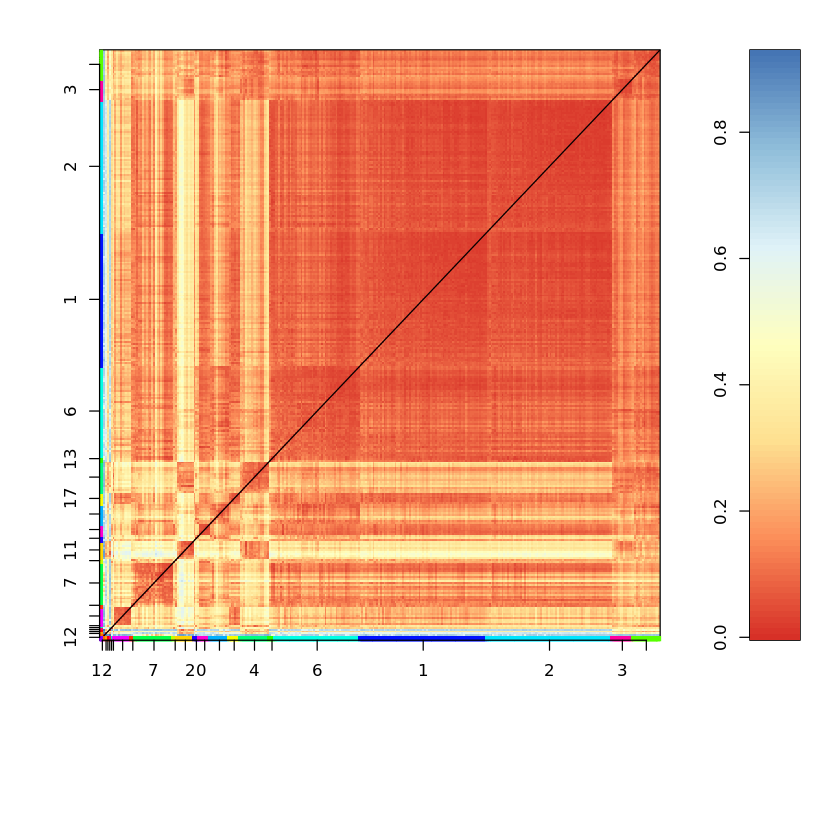

In [92]:
x <- clustheatmap(sc_e, final=T, hmethod="single")

In [98]:
sc_e <- comptsne(sc_e)

sigma summary: Min. : 0.0525214412284736 |1st Qu. : 0.0674958147610216 |Median : 0.0833678283016824 |Mean : 0.101834619968057 |3rd Qu. : 0.118850776350931 |Max. : 0.328986887190178 |
Epoch: Iteration #100 error is: 0.616174504895324
Epoch: Iteration #200 error is: 0.610920893350571
Epoch: Iteration #300 error is: 0.609851009868558
Epoch: Iteration #400 error is: 0.608248632802685
Epoch: Iteration #500 error is: 0.608240114844534
Epoch: Iteration #600 error is: 0.608239523244946
Epoch: Iteration #700 error is: 0.608239478796476
Epoch: Iteration #800 error is: 0.608239475407498
Epoch: Iteration #900 error is: 0.608239475146147
Epoch: Iteration #1000 error is: 0.608239475126322


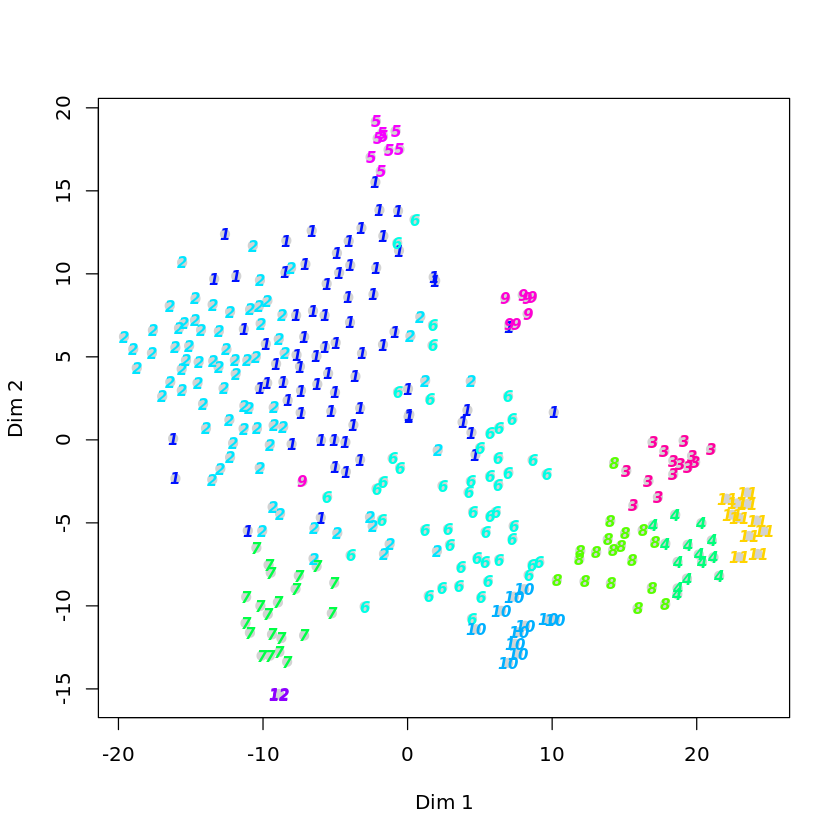

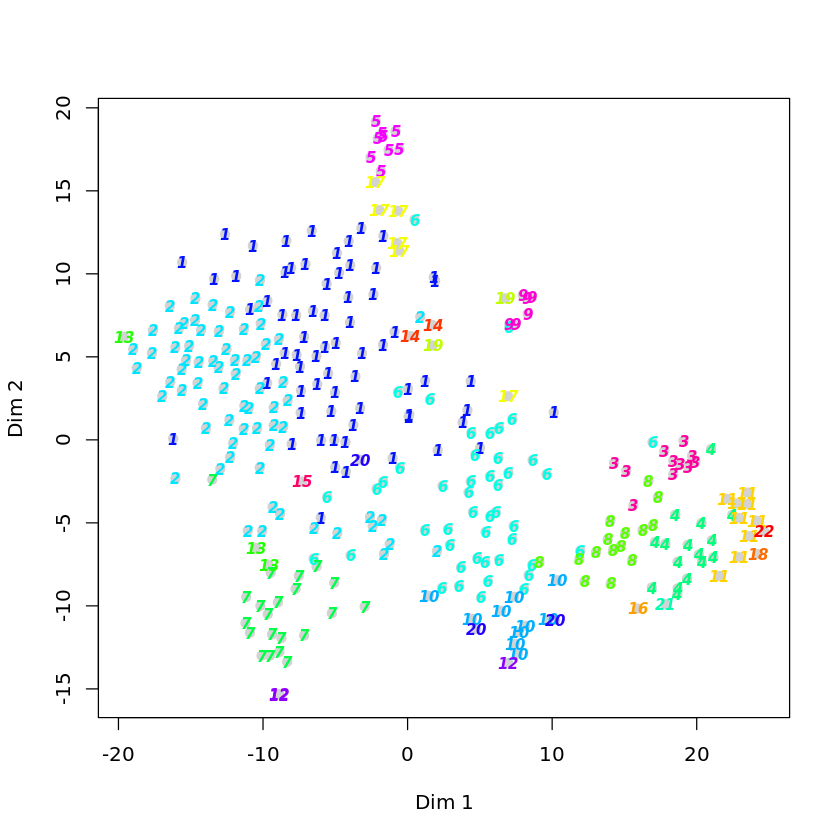

In [99]:
plottsne(sc_e, final=F)
plottsne(sc_e, final=T)

### Explore some of our expected cell types

In [290]:
is.embryonic_stemcell <- c("Nanog") # Oct-4 is a marker for Pou5f1
is.mesoderm <- c("Eomes", "T", "Mesp1")
is.antviscendo <- c("Cer1", "Lefty1")
is.neuroectoderm <- c("Sox1", "Sox2", "Pou3f1", "Zfp462", "Slc7a3")

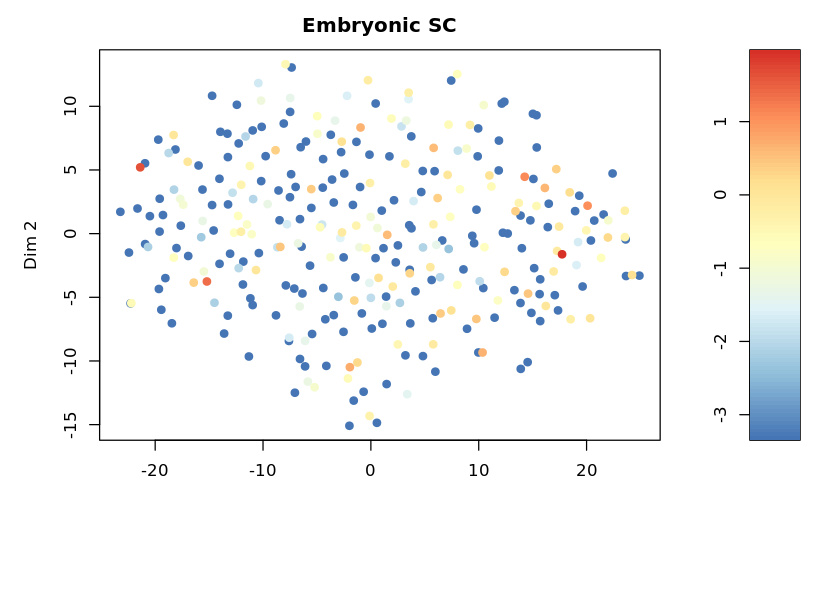

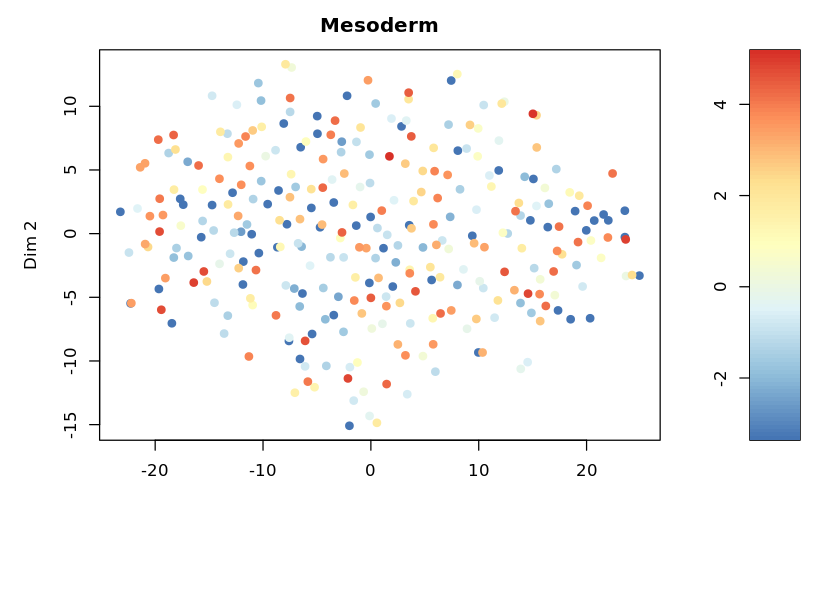

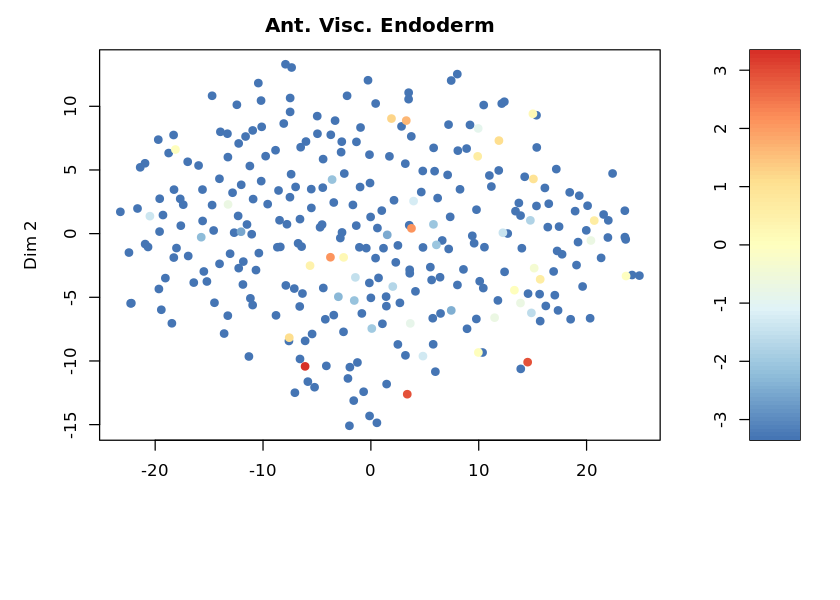

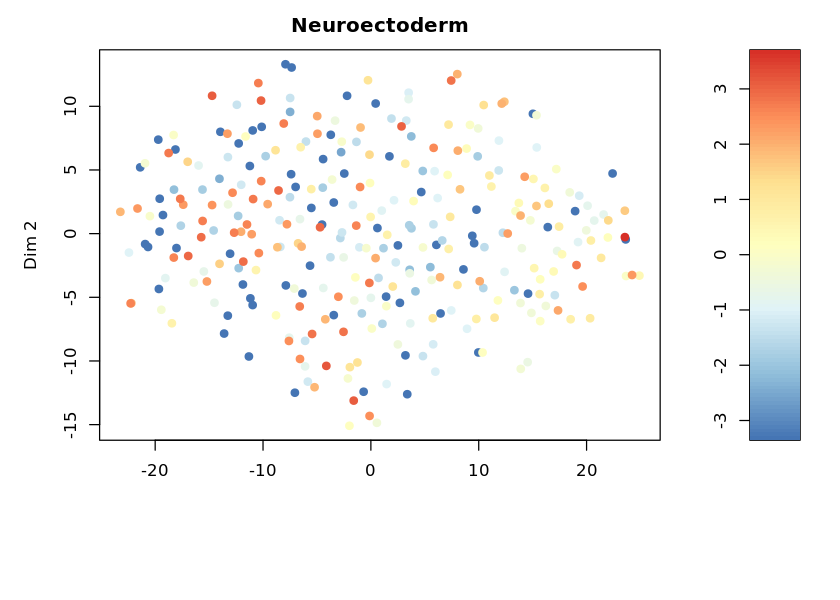

In [291]:
plotexptsne(sc_5000_12_first, is.embryonic_stemcell, n="Embryonic SC", logsc=T)
plotexptsne(sc_5000_12_first, is.mesoderm, n="Mesoderm", logsc=T)
plotexptsne(sc_5000_12_first, is.antviscendo, n="Ant. Visc. Endoderm", logsc=T)
plotexptsne(sc_5000_12_first, is.neuroectoderm, n="Neuroectoderm", logsc=T)

In [294]:
#### Massive fuckup here.... 
# Heatmaps confirmed it too, we need to re-run the analysis again and try and find this clustering again...

## Examining known clusters

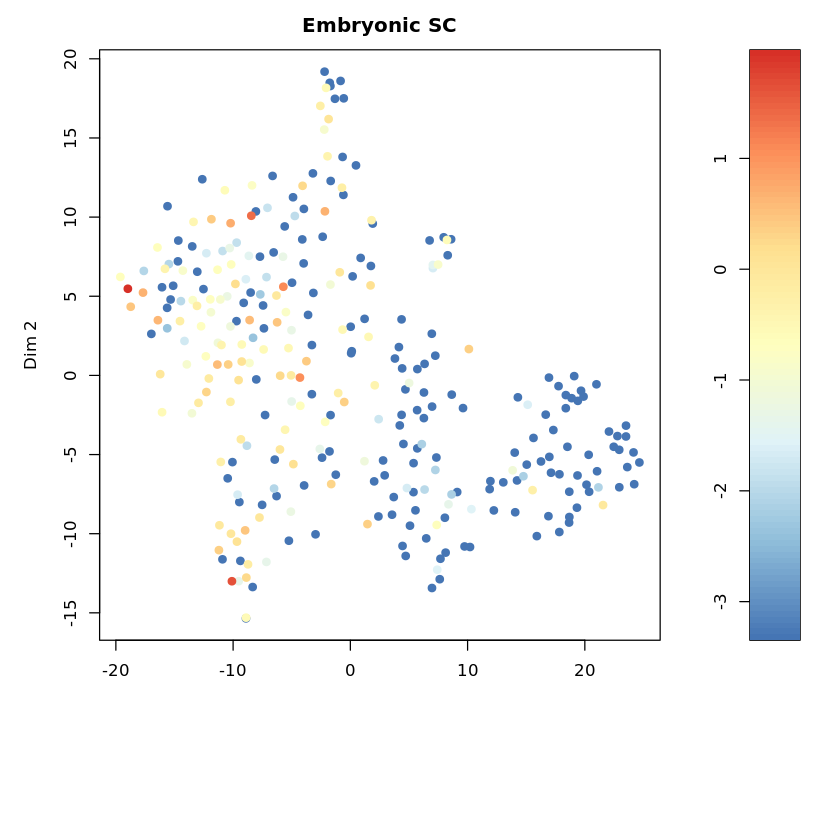

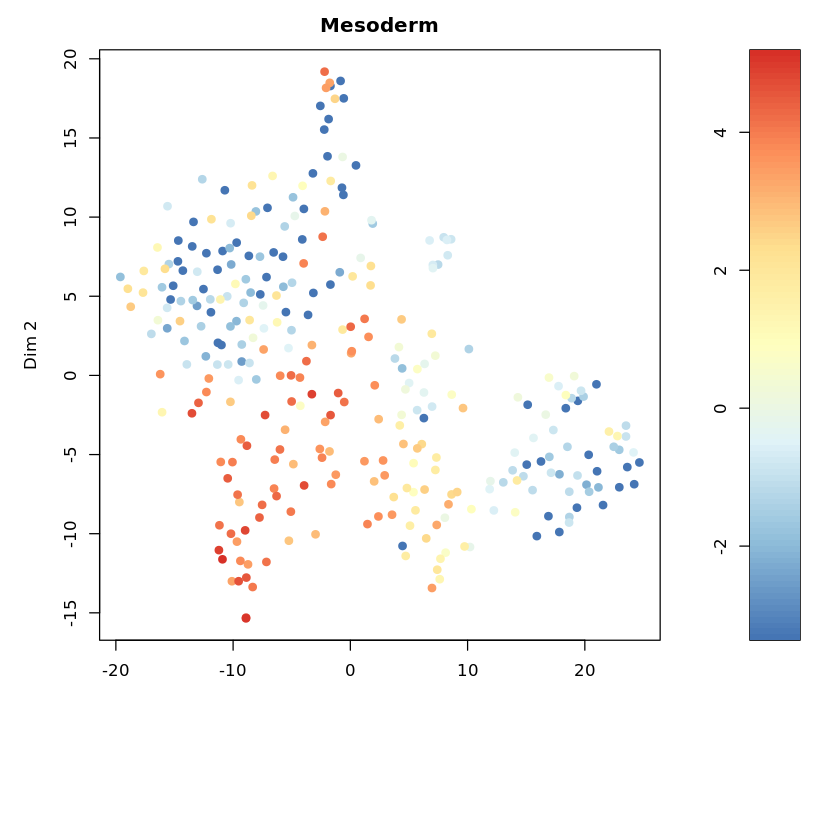

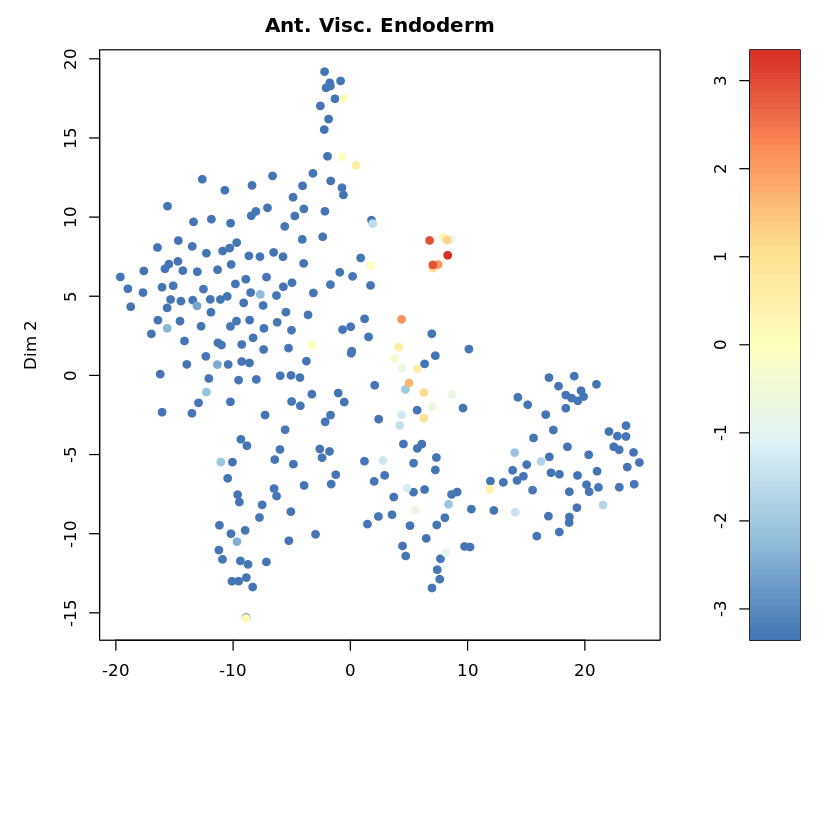

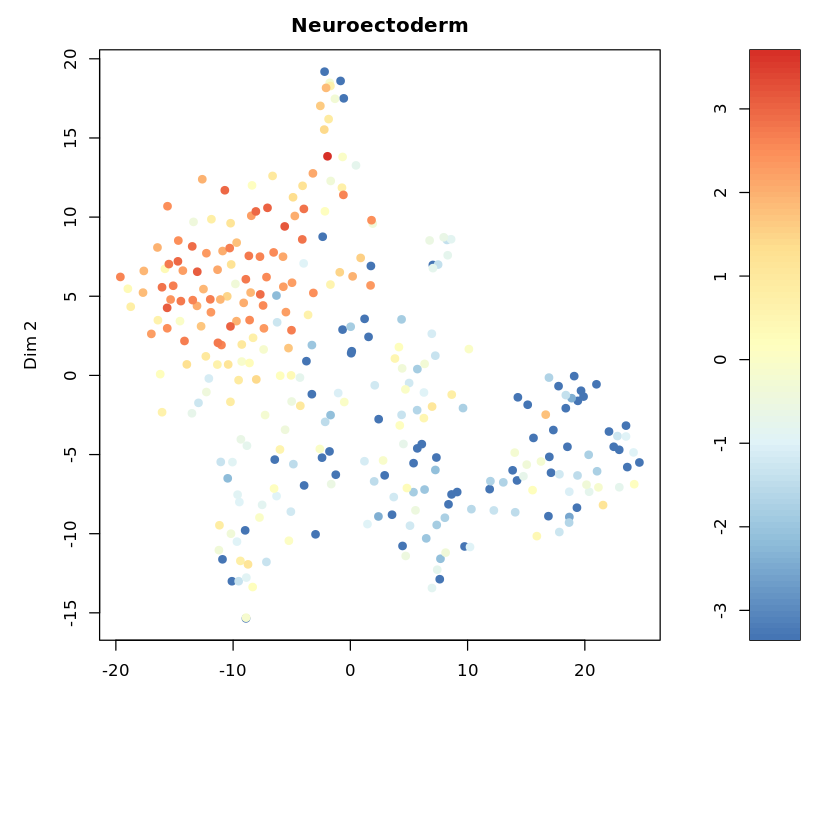

In [102]:
plotexptsne(sc_e, is.embryonic_stemcell, n="Embryonic SC", logsc=T)
plotexptsne(sc_e, is.mesoderm, n="Mesoderm", logsc=T)
plotexptsne(sc_e, is.antviscendo, n="Ant. Visc. Endoderm", logsc=T)
plotexptsne(sc_e, is.neuroectoderm, n="Neuroectoderm", logsc=T)

This is strange. Expected cell-type markers do not seem to be well defined, and the heat maps are consistently high expressing across all clusters. 

Maybe we have removed too much biological variability from the cell-cycle and cell-proliferation regression.


# Re-run with reduced CC and CP regression

## Mintotal Analysis

### Mintotal > 2000

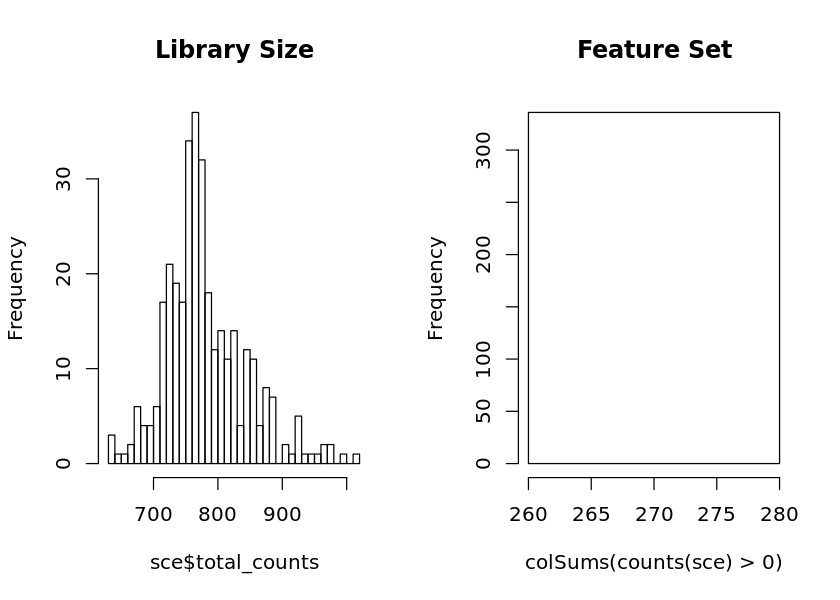

sigma summary: Min. : 0.0534150020199504 |1st Qu. : 0.0706374249334471 |Median : 0.0854610232924539 |Mean : 0.1003661574806 |3rd Qu. : 0.116385632425775 |Max. : 0.271201048999211 |
Epoch: Iteration #100 error is: 0.717015155398997
Epoch: Iteration #200 error is: 0.711724495551881
Epoch: Iteration #300 error is: 0.707609308702519
Epoch: Iteration #400 error is: 0.704169057599569
Epoch: Iteration #500 error is: 0.704107554852159
Epoch: Iteration #600 error is: 0.704098627061052
Epoch: Iteration #700 error is: 0.704096928379683
Epoch: Iteration #800 error is: 0.704096550202094
Epoch: Iteration #900 error is: 0.704096464757167
Epoch: Iteration #1000 error is: 0.704096445318027


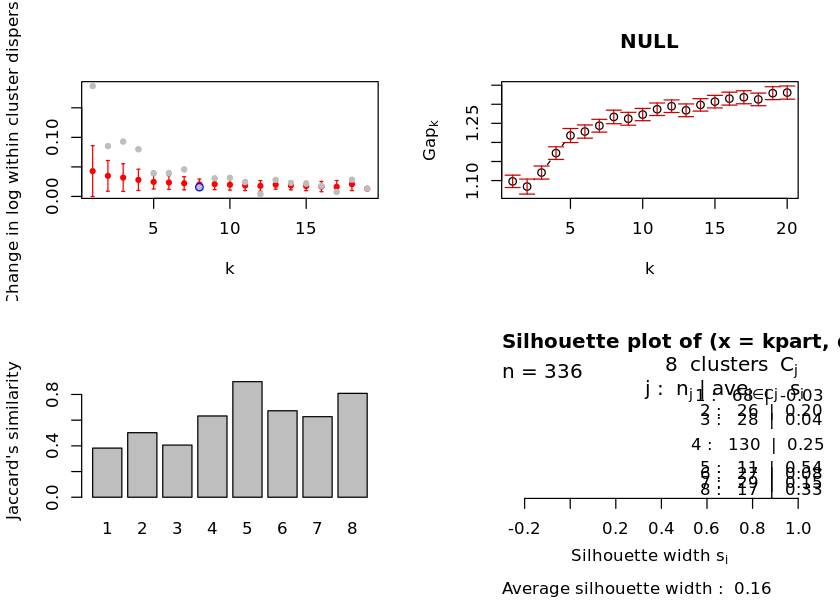

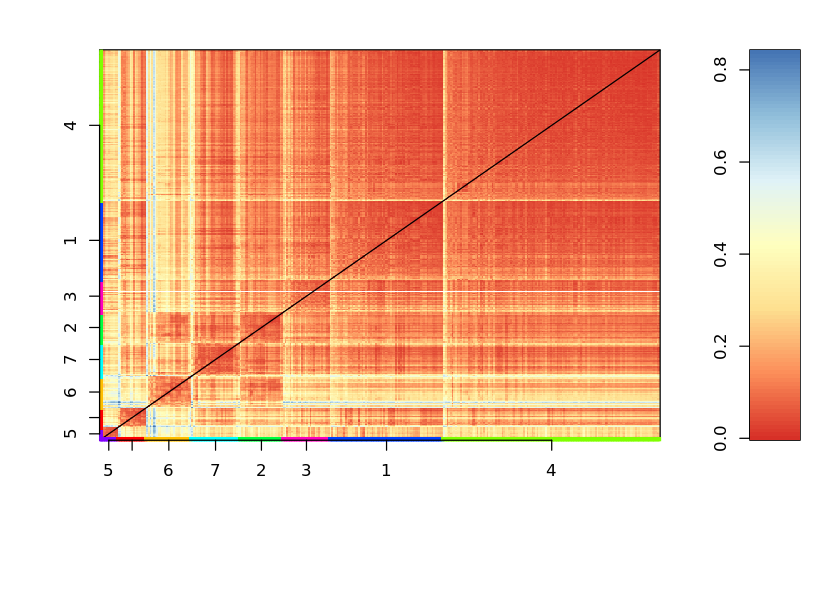

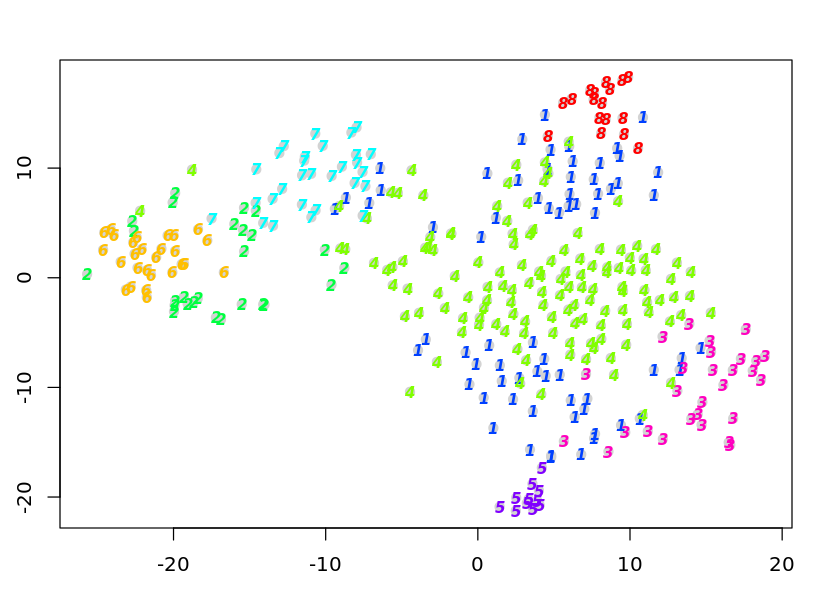

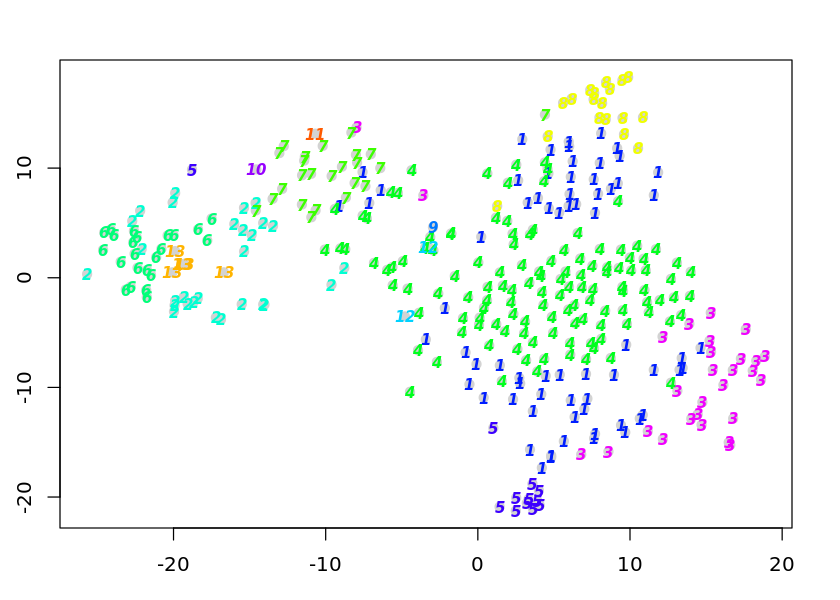

In [296]:
sc_2000_cpcg <- allForOne(2000, discover_cc = F)

### Mintotal > 3000

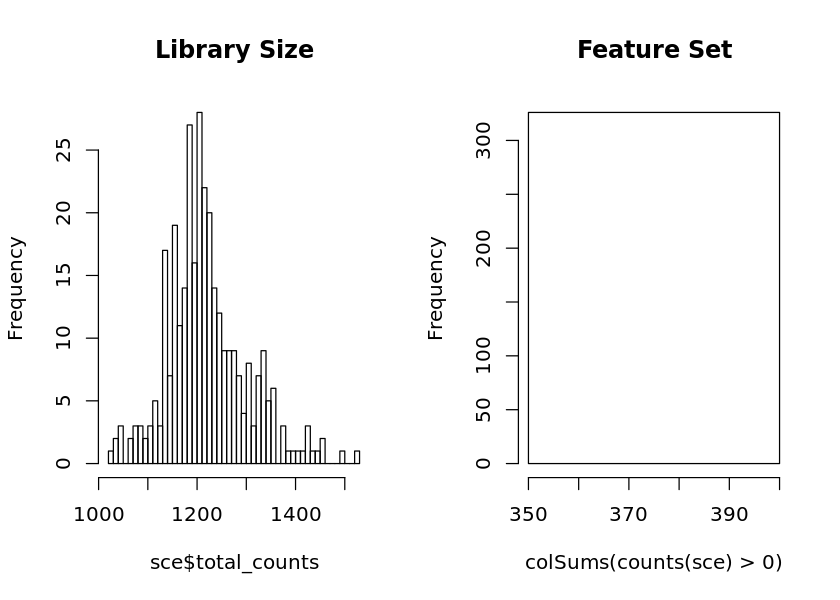

sigma summary: Min. : 0.0540503527778805 |1st Qu. : 0.0707385103815402 |Median : 0.0866899945275141 |Mean : 0.102148934288931 |3rd Qu. : 0.118848314984342 |Max. : 0.306659186616276 |
Epoch: Iteration #100 error is: 0.67944050470212
Epoch: Iteration #200 error is: 0.676405895668821
Epoch: Iteration #300 error is: 0.673866423939473
Epoch: Iteration #400 error is: 0.673780635730556
Epoch: Iteration #500 error is: 0.67377511459939
Epoch: Iteration #600 error is: 0.673774700776639
Epoch: Iteration #700 error is: 0.673774667515712
Epoch: Iteration #800 error is: 0.673774664737806
Epoch: Iteration #900 error is: 0.673774664505332
Epoch: Iteration #1000 error is: 0.673774664486832


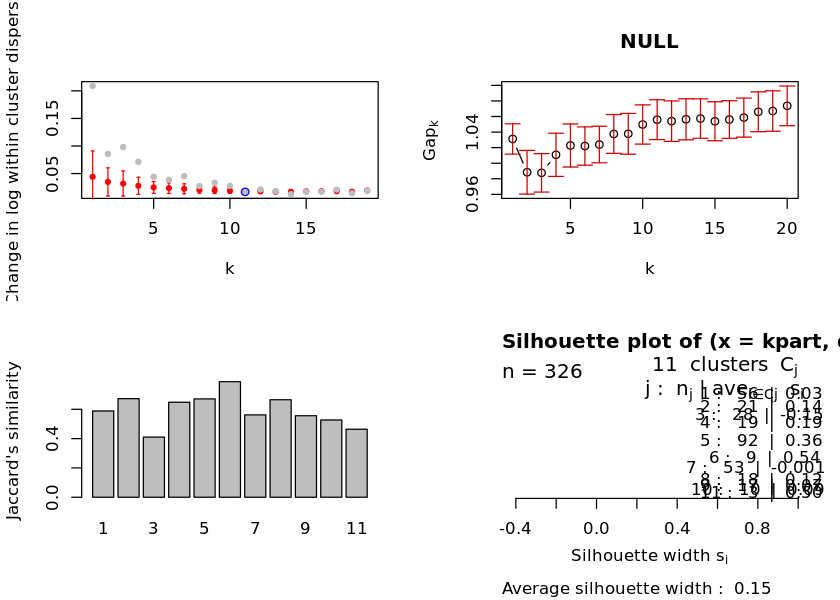

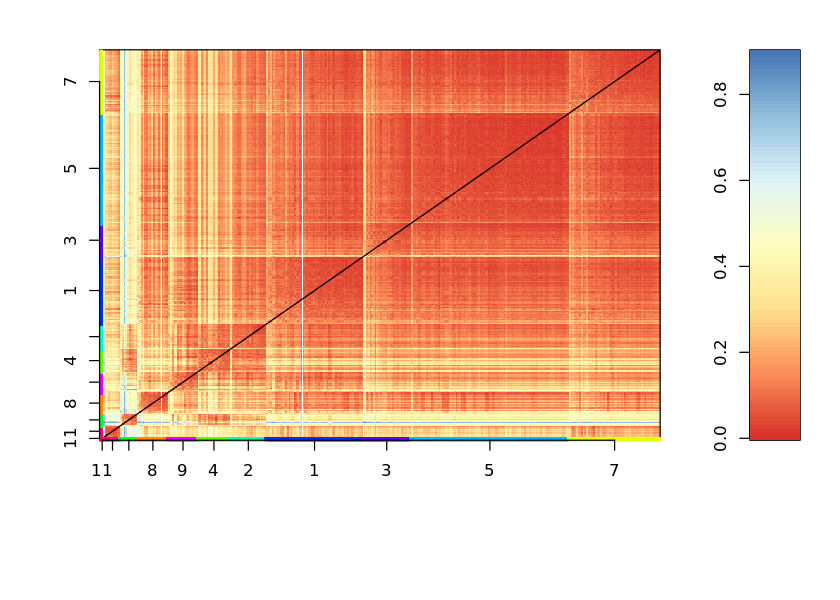

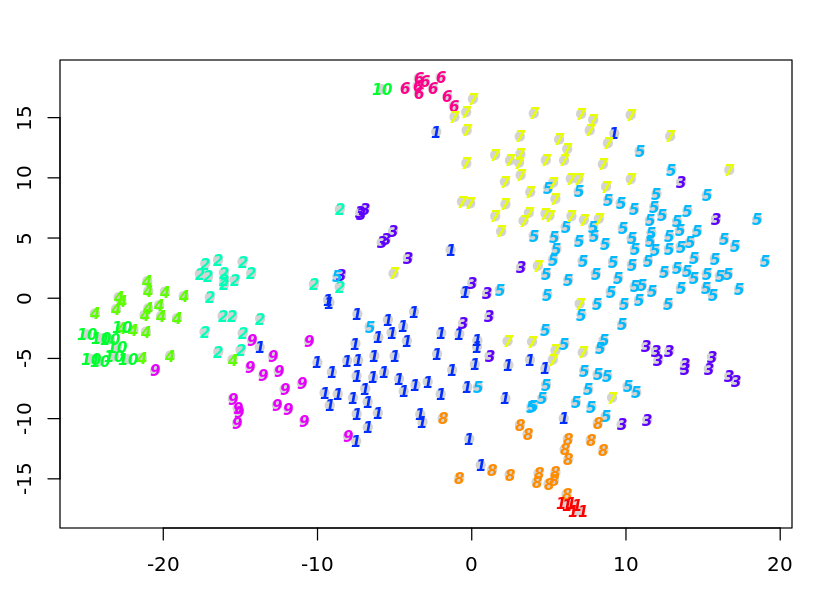

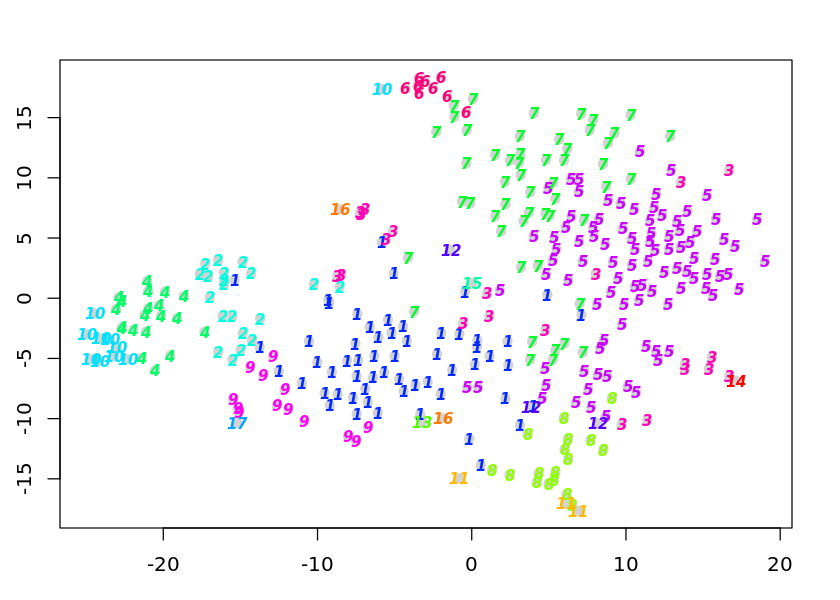

In [297]:
sc_3000_cpcg <- allForOne(3000, discover_cc = F)

### Mintotal > 4000

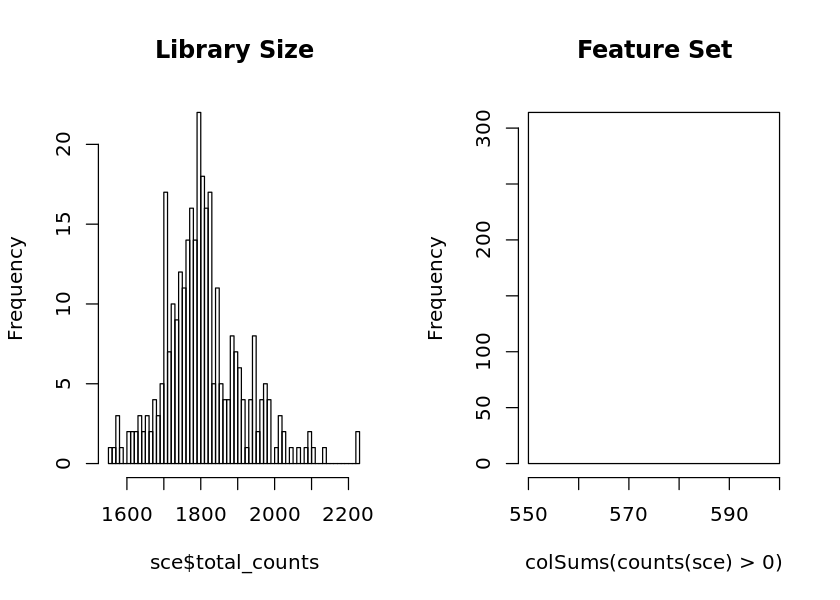

sigma summary: Min. : 0.0530394835305437 |1st Qu. : 0.0713046890920103 |Median : 0.0876208109821969 |Mean : 0.106042607260405 |3rd Qu. : 0.128378450048052 |Max. : 0.320677143278479 |
Epoch: Iteration #100 error is: 0.643463282644811
Epoch: Iteration #200 error is: 0.640185690949468
Epoch: Iteration #300 error is: 0.6395316405904
Epoch: Iteration #400 error is: 0.639457466666394
Epoch: Iteration #500 error is: 0.639453587828687
Epoch: Iteration #600 error is: 0.639453349299802
Epoch: Iteration #700 error is: 0.639453333870573
Epoch: Iteration #800 error is: 0.63945333289398
Epoch: Iteration #900 error is: 0.63945333283172
Epoch: Iteration #1000 error is: 0.639453332827724


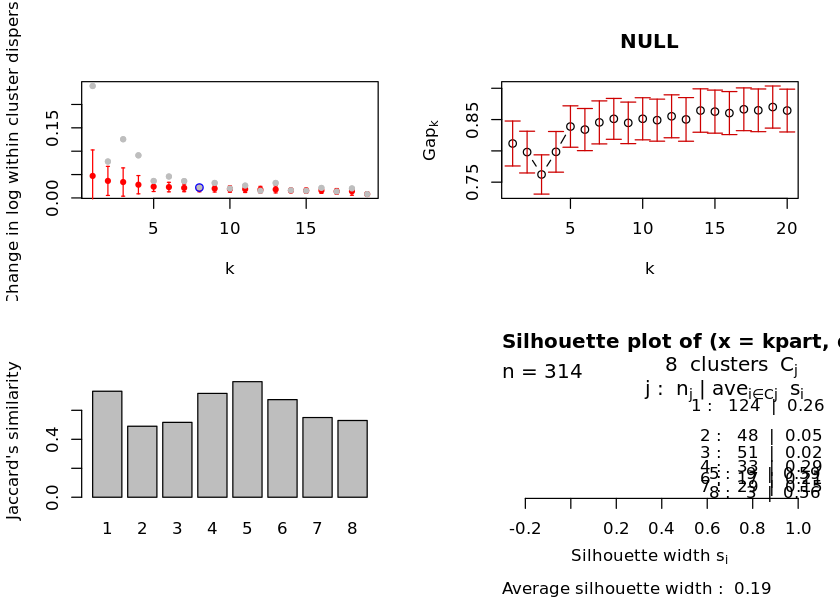

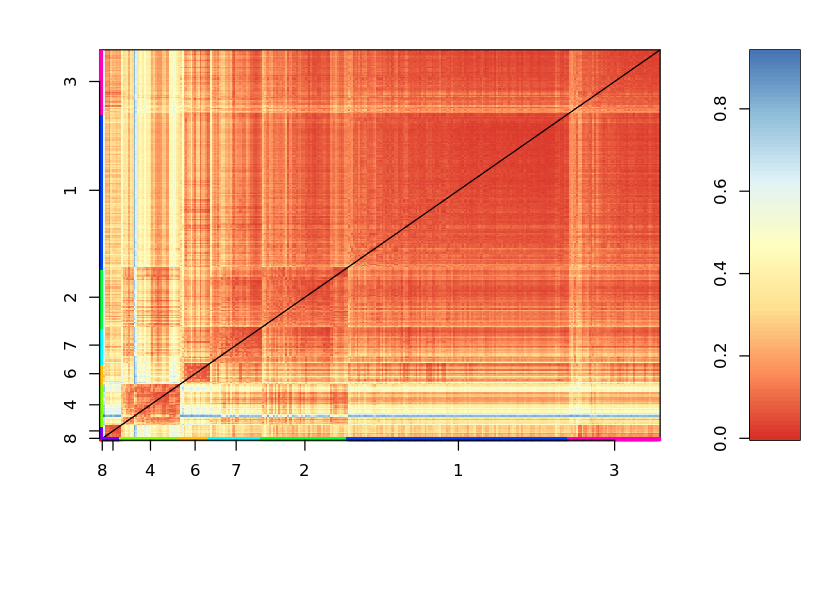

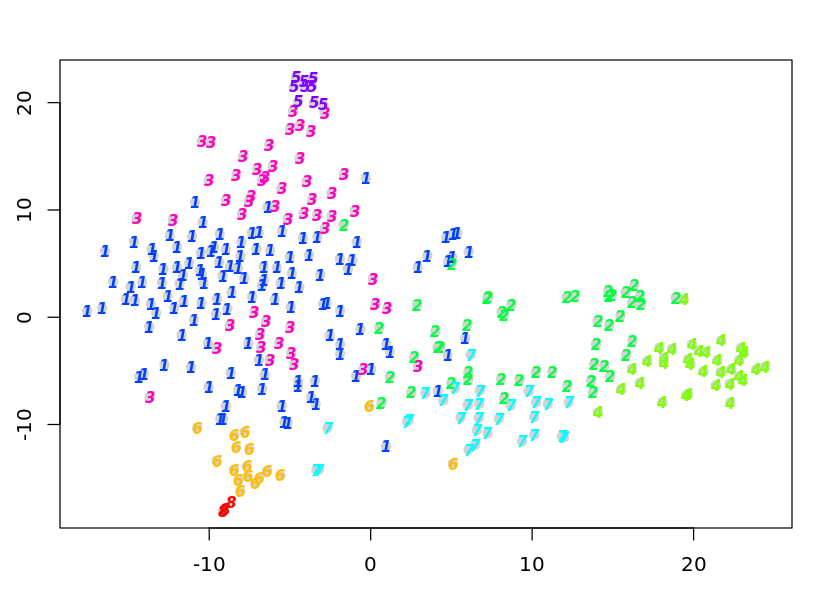

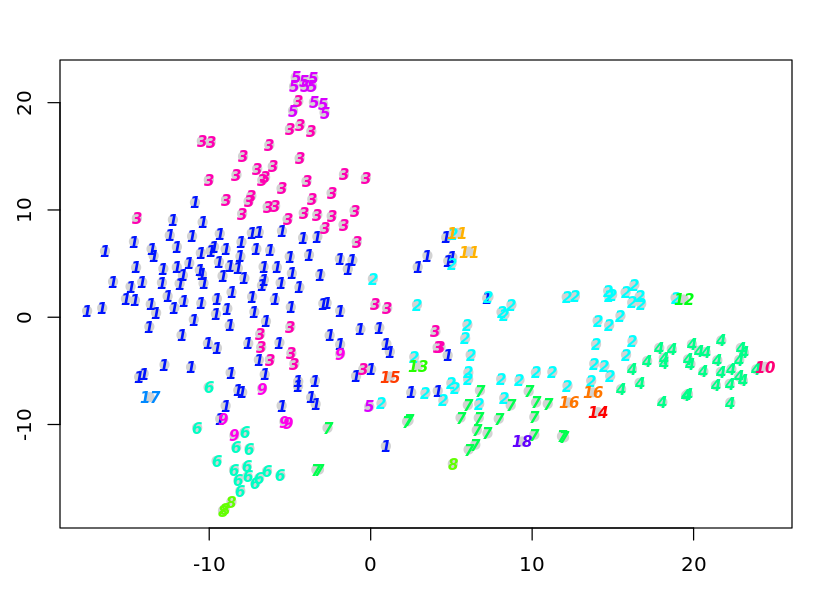

In [298]:
sc_4000_cpcg <- allForOne(4000, discover_cc = F)

### Mintotal > 5000

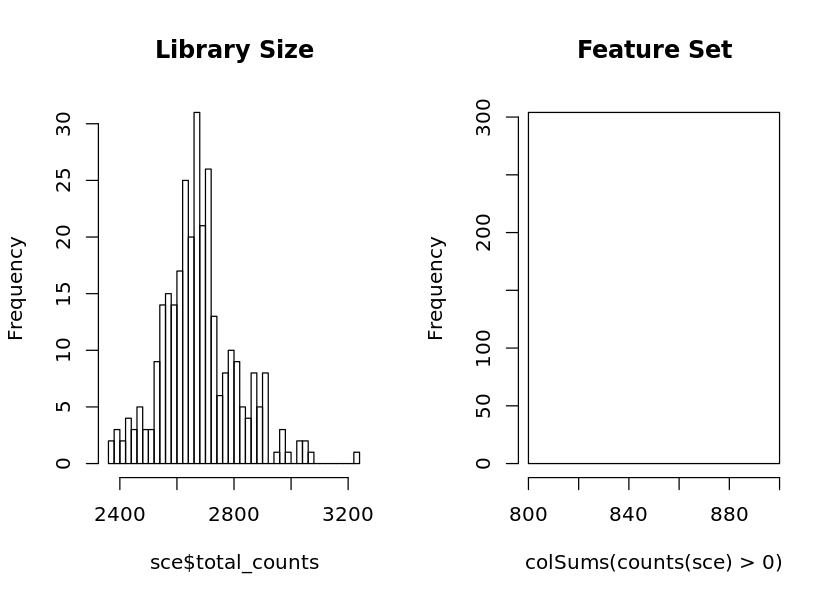

sigma summary: Min. : 0.0525214412284736 |1st Qu. : 0.0674958147610216 |Median : 0.0833678283016824 |Mean : 0.101834619968057 |3rd Qu. : 0.118850776350931 |Max. : 0.328986887190178 |
Epoch: Iteration #100 error is: 0.616174504895324
Epoch: Iteration #200 error is: 0.610920893350571
Epoch: Iteration #300 error is: 0.609851009868558
Epoch: Iteration #400 error is: 0.608248632802685
Epoch: Iteration #500 error is: 0.608240114844534
Epoch: Iteration #600 error is: 0.608239523244946
Epoch: Iteration #700 error is: 0.608239478796476
Epoch: Iteration #800 error is: 0.608239475407498
Epoch: Iteration #900 error is: 0.608239475146147
Epoch: Iteration #1000 error is: 0.608239475126322


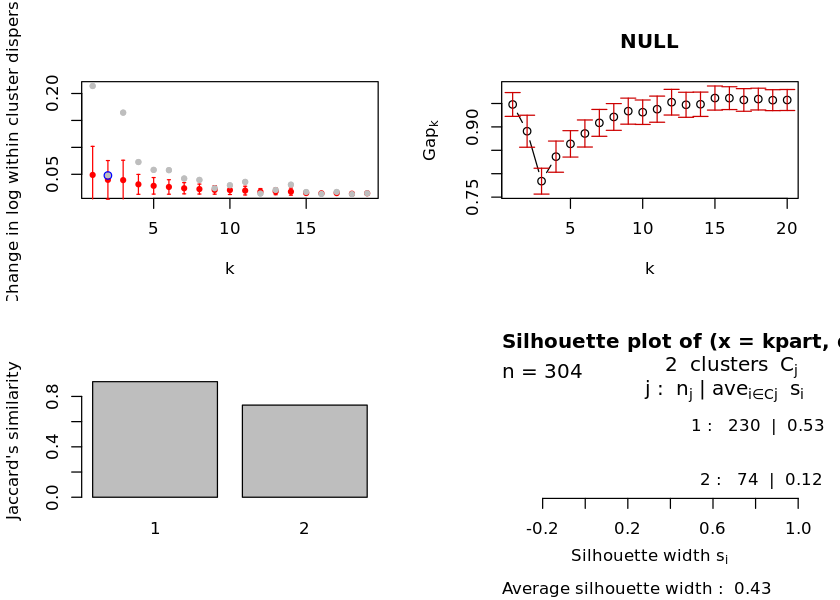

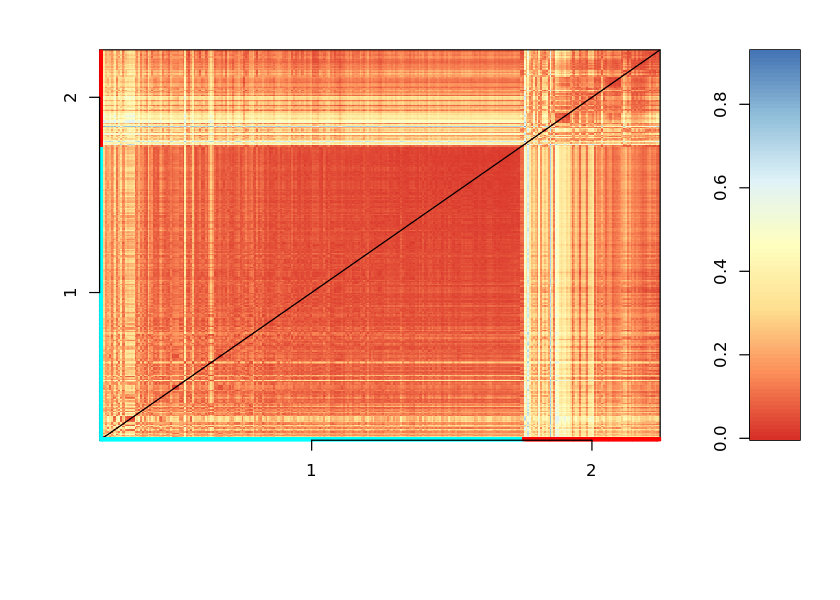

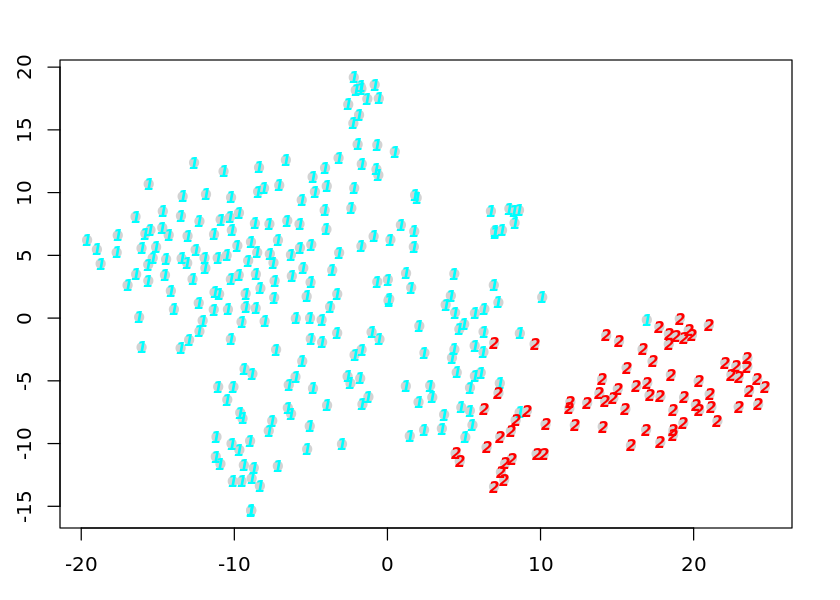

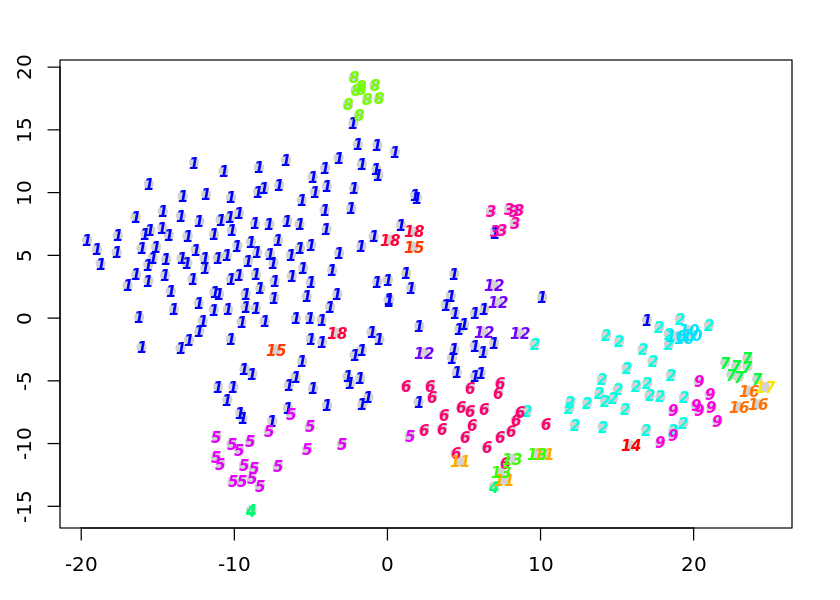

In [299]:
sc_5000_cpcg <- allForOne(5000, discover_cc = F)

### Mintotal > 6000

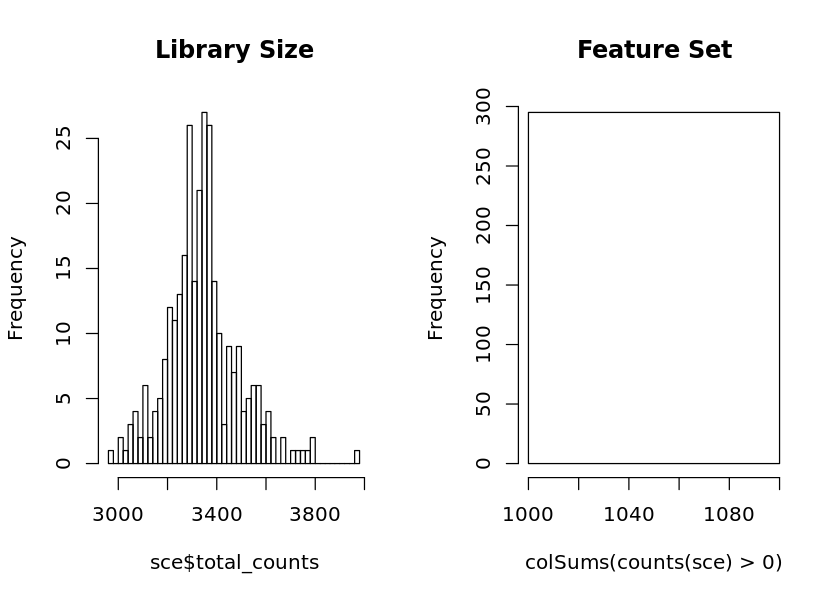

sigma summary: Min. : 0.0563488580048399 |1st Qu. : 0.0765550241641803 |Median : 0.0916005305654065 |Mean : 0.11562521701063 |3rd Qu. : 0.139340052701183 |Max. : 0.332779747640819 |
Epoch: Iteration #100 error is: 0.595507160825063
Epoch: Iteration #200 error is: 0.592630742458954
Epoch: Iteration #300 error is: 0.591986417977596
Epoch: Iteration #400 error is: 0.591913893746361
Epoch: Iteration #500 error is: 0.591910278119514
Epoch: Iteration #600 error is: 0.591910069776003
Epoch: Iteration #700 error is: 0.591910056907708
Epoch: Iteration #800 error is: 0.591910056144438
Epoch: Iteration #900 error is: 0.591910056097394
Epoch: Iteration #1000 error is: 0.591910056094499


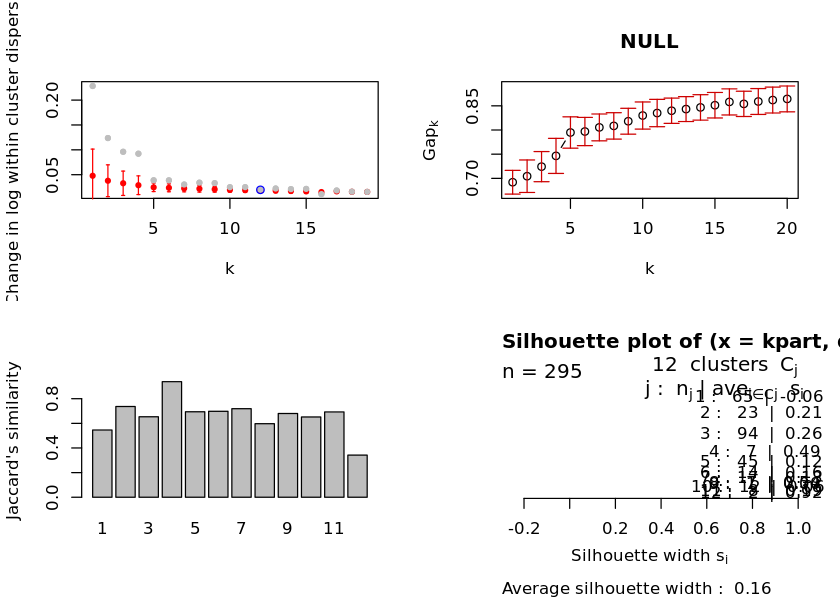

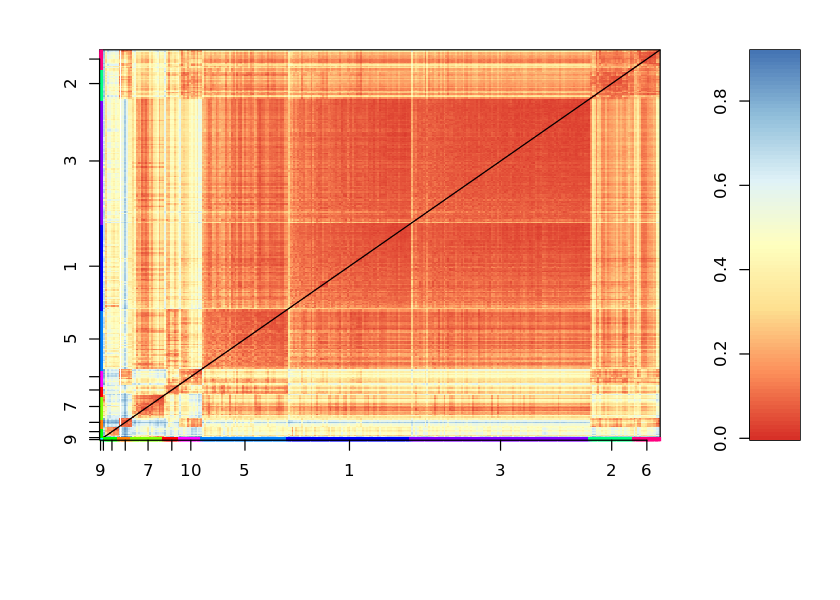

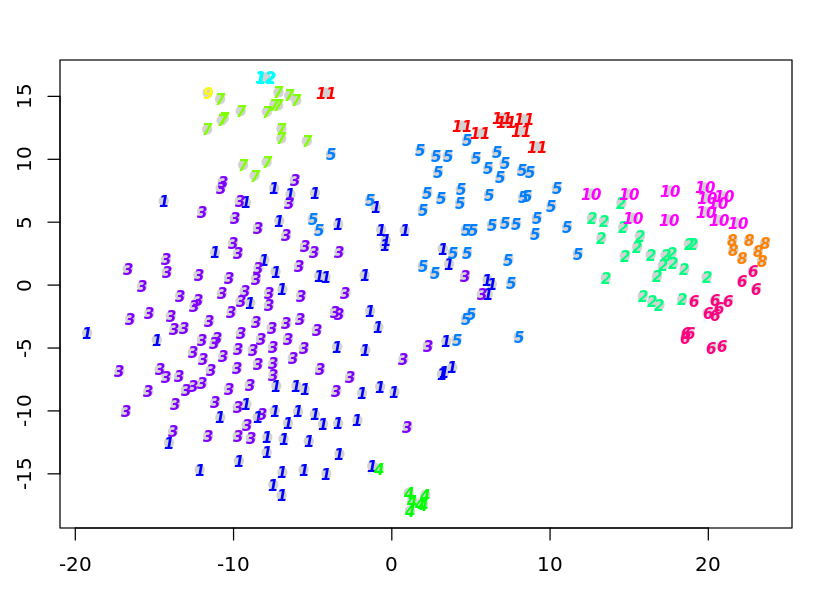

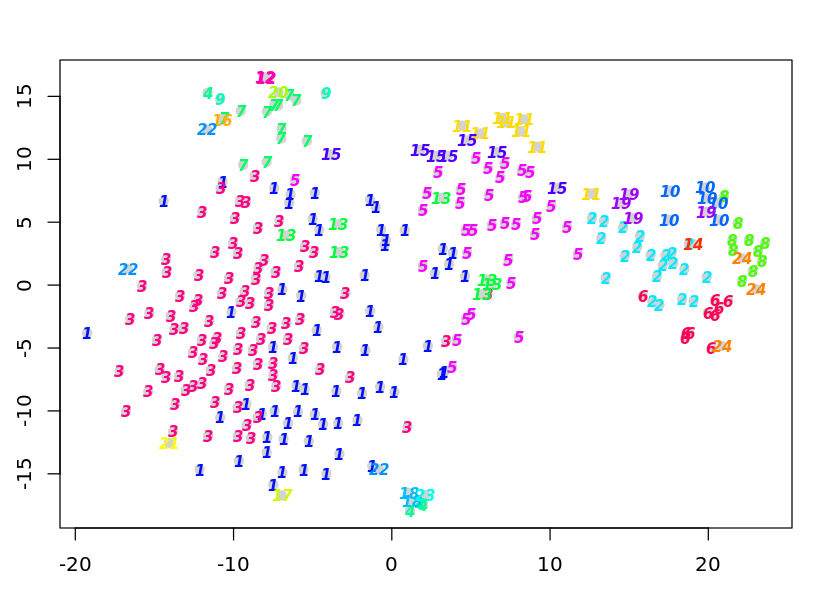

In [300]:
sc_6000_cpcg <- allForOne(6000, discover_cc = F)

### Mintotal > 7000

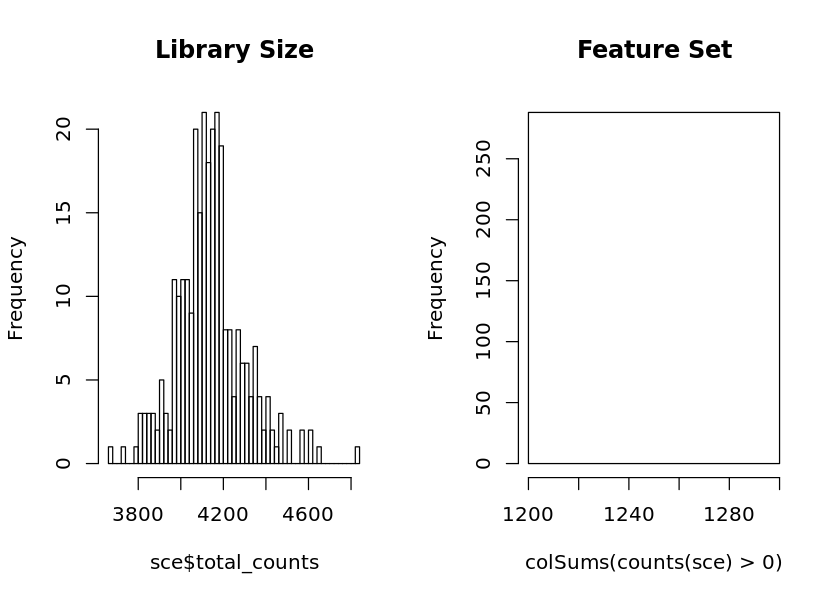

sigma summary: Min. : 0.0586813290505128 |1st Qu. : 0.074786803532601 |Median : 0.0904333074977899 |Mean : 0.111834364107058 |3rd Qu. : 0.129911843140876 |Max. : 0.316163127453701 |
Epoch: Iteration #100 error is: 0.575756765703808
Epoch: Iteration #200 error is: 0.572462880926916
Epoch: Iteration #300 error is: 0.571718413758776
Epoch: Iteration #400 error is: 0.571643179591701
Epoch: Iteration #500 error is: 0.571640518454182
Epoch: Iteration #600 error is: 0.571640436280769
Epoch: Iteration #700 error is: 0.571640433644844
Epoch: Iteration #800 error is: 0.571640433561516
Epoch: Iteration #900 error is: 0.571640433558945
Epoch: Iteration #1000 error is: 0.571640433558862


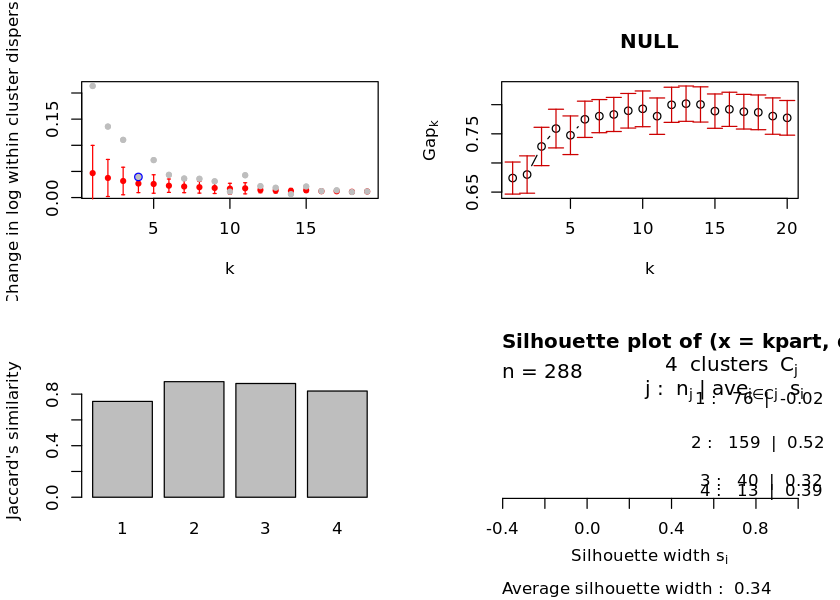

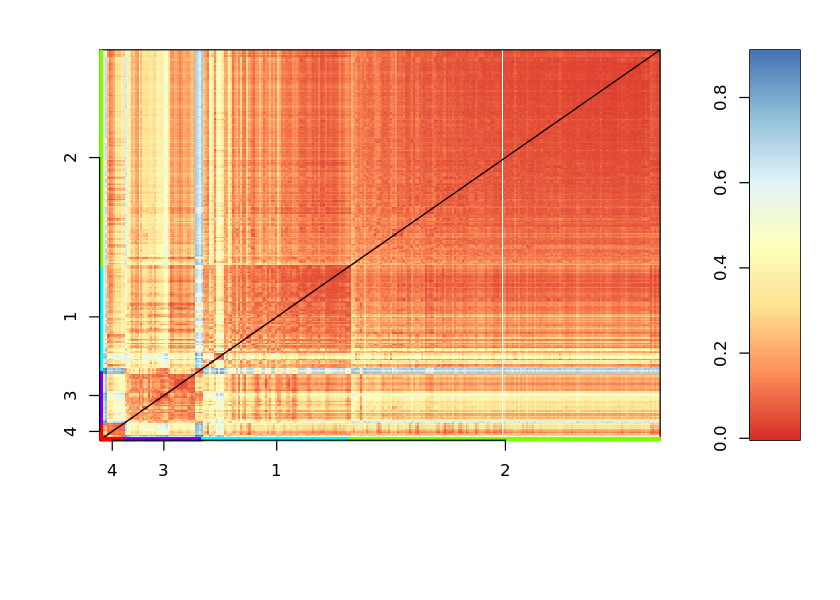

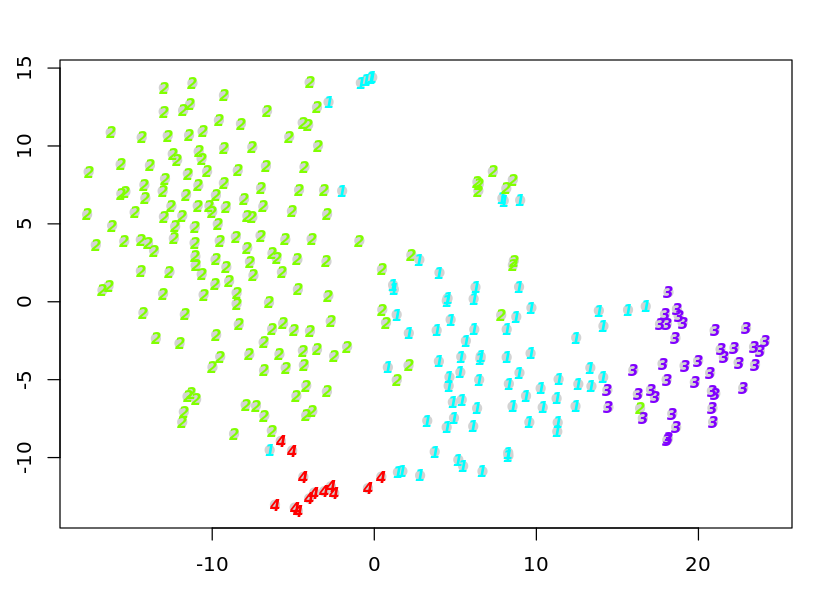

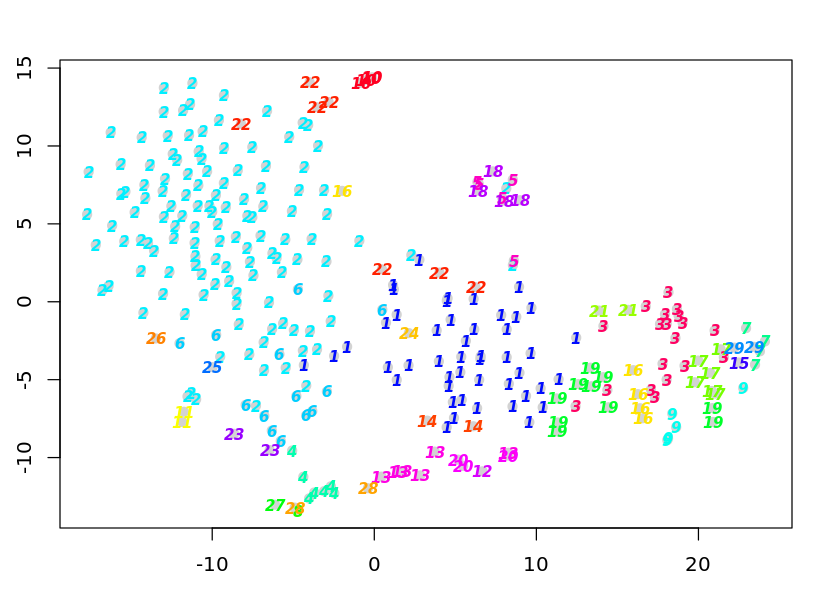

In [301]:
sc_7000_cpcg <- allForOne(7000, discover_cc = F)

## Cluster Size (mintotal > 5000)

### clusters = 7

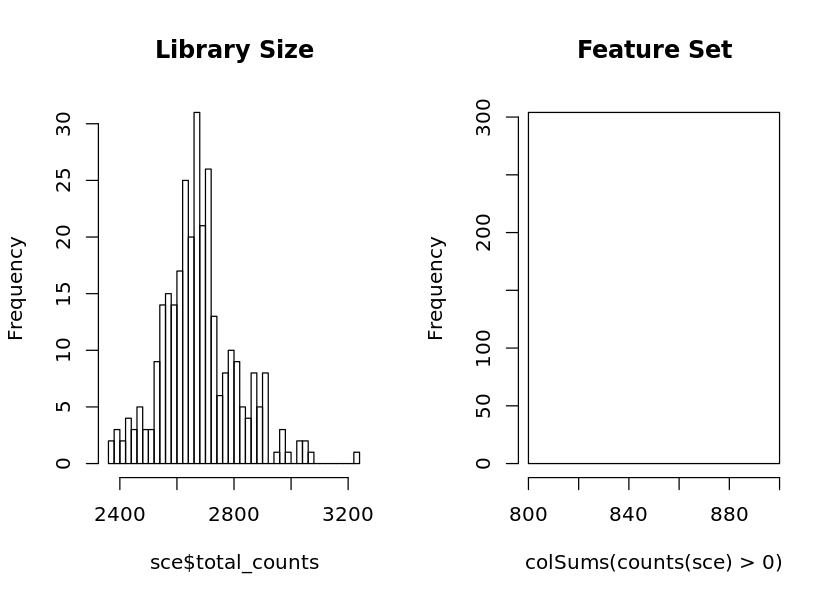

sigma summary: Min. : 0.0525214412284736 |1st Qu. : 0.0674958147610216 |Median : 0.0833678283016824 |Mean : 0.101834619968057 |3rd Qu. : 0.118850776350931 |Max. : 0.328986887190178 |
Epoch: Iteration #100 error is: 0.616174504895324
Epoch: Iteration #200 error is: 0.610920893350571
Epoch: Iteration #300 error is: 0.609851009868558
Epoch: Iteration #400 error is: 0.608248632802685
Epoch: Iteration #500 error is: 0.608240114844534
Epoch: Iteration #600 error is: 0.608239523244946
Epoch: Iteration #700 error is: 0.608239478796476
Epoch: Iteration #800 error is: 0.608239475407498
Epoch: Iteration #900 error is: 0.608239475146147
Epoch: Iteration #1000 error is: 0.608239475126322


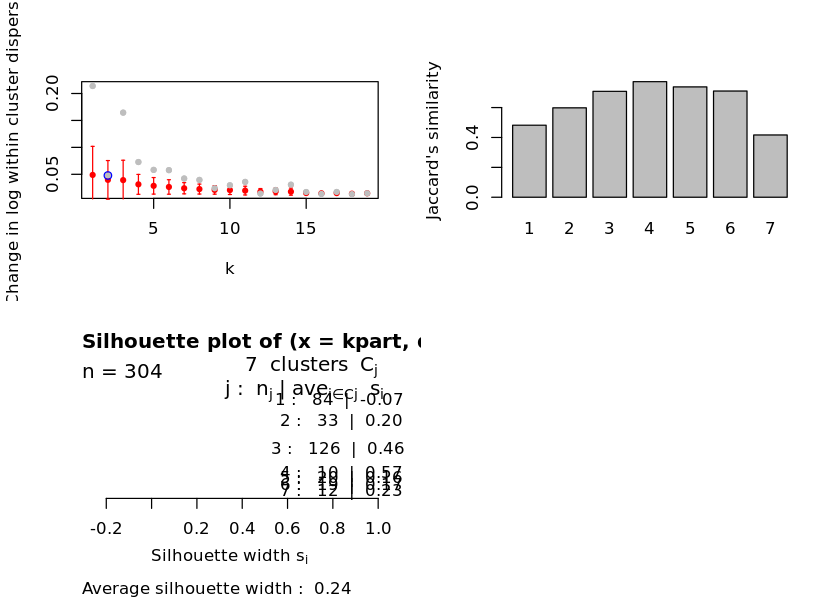

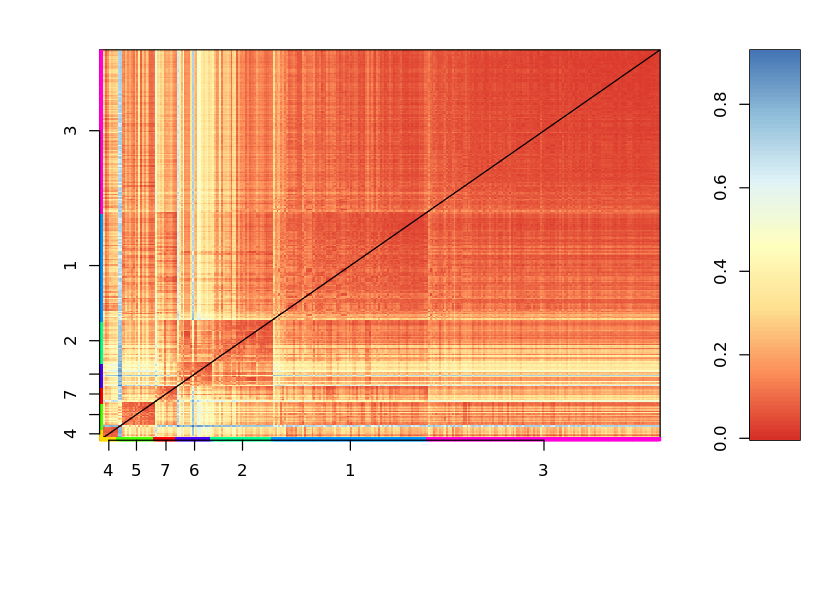

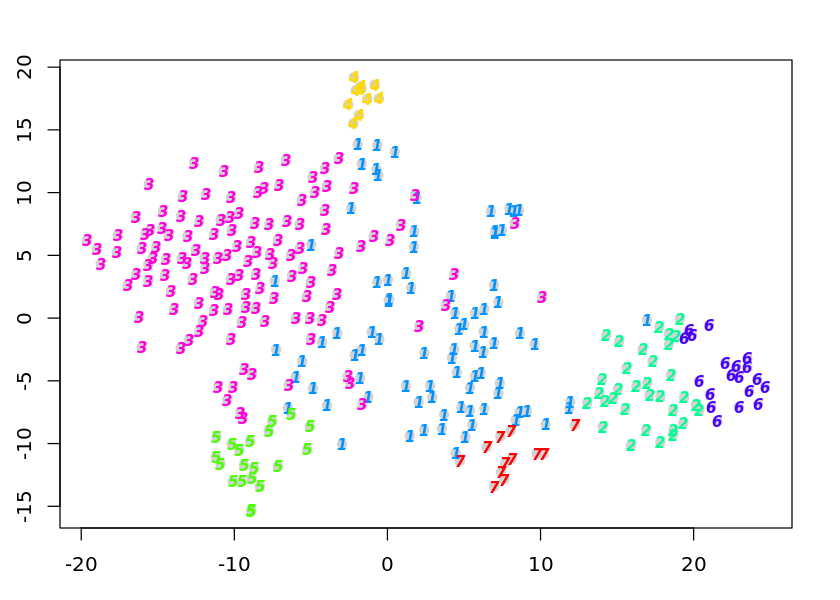

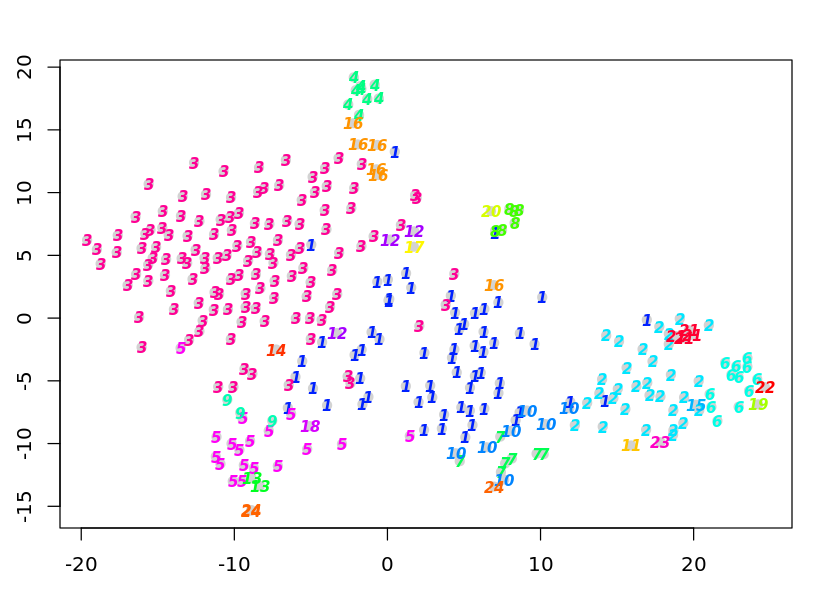

In [304]:
sc_5000_cpcg_7 <- allForOne(5000, clna=7, discover_cc = F)

### clusters = 8

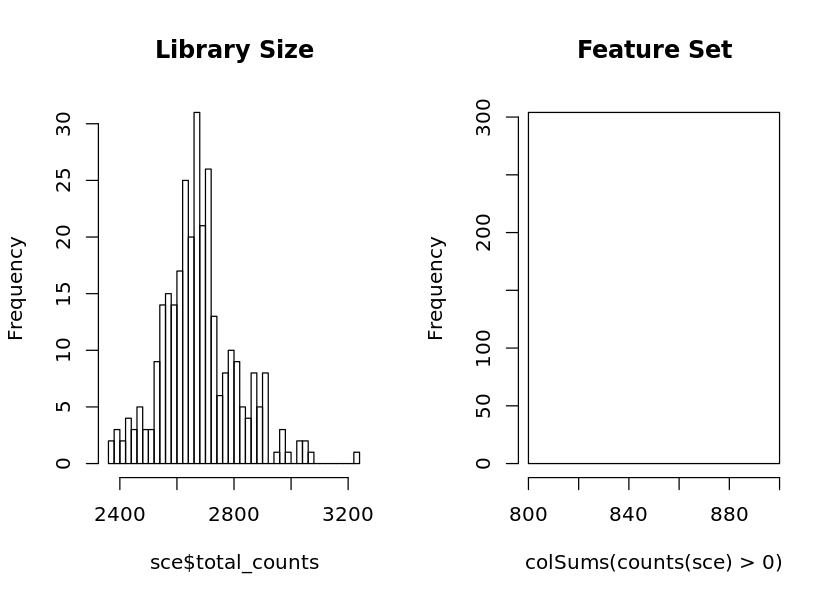

sigma summary: Min. : 0.0525214412284736 |1st Qu. : 0.0674958147610216 |Median : 0.0833678283016824 |Mean : 0.101834619968057 |3rd Qu. : 0.118850776350931 |Max. : 0.328986887190178 |
Epoch: Iteration #100 error is: 0.616174504895324
Epoch: Iteration #200 error is: 0.610920893350571
Epoch: Iteration #300 error is: 0.609851009868558
Epoch: Iteration #400 error is: 0.608248632802685
Epoch: Iteration #500 error is: 0.608240114844534
Epoch: Iteration #600 error is: 0.608239523244946
Epoch: Iteration #700 error is: 0.608239478796476
Epoch: Iteration #800 error is: 0.608239475407498
Epoch: Iteration #900 error is: 0.608239475146147
Epoch: Iteration #1000 error is: 0.608239475126322


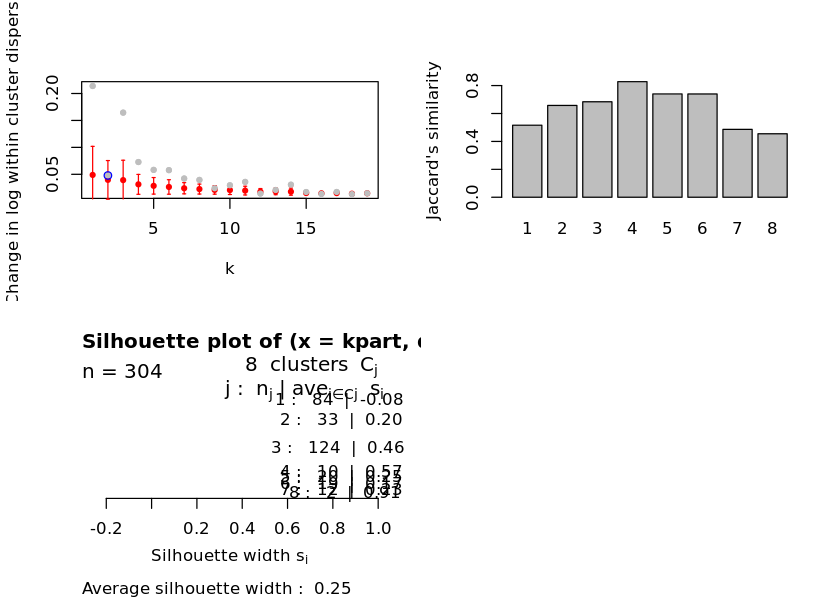

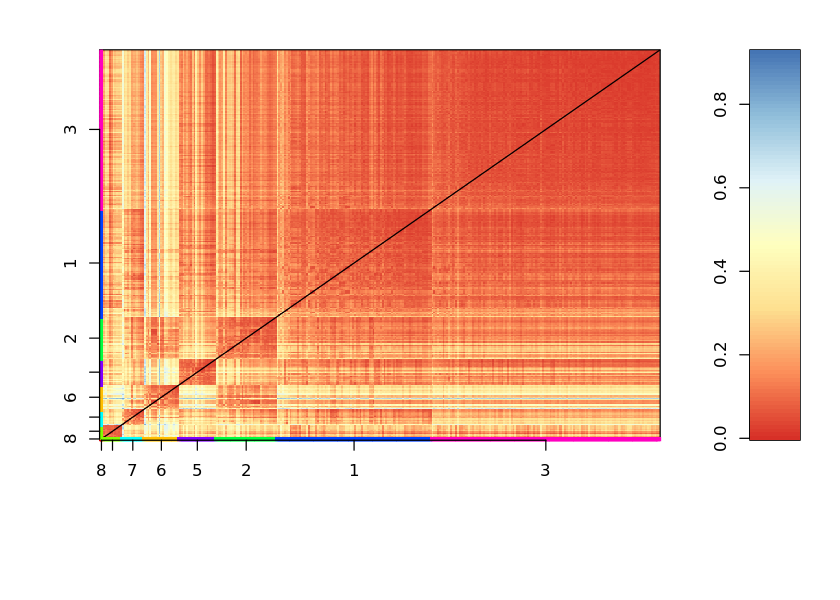

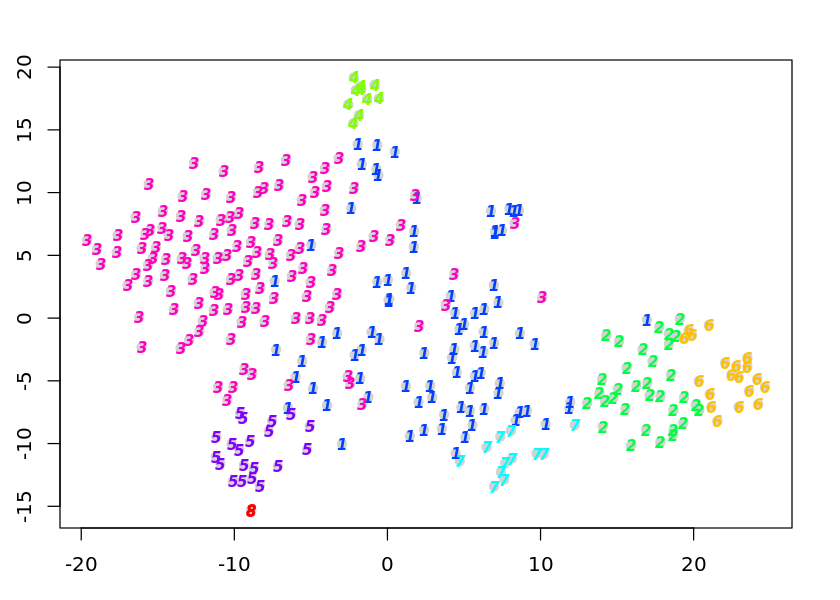

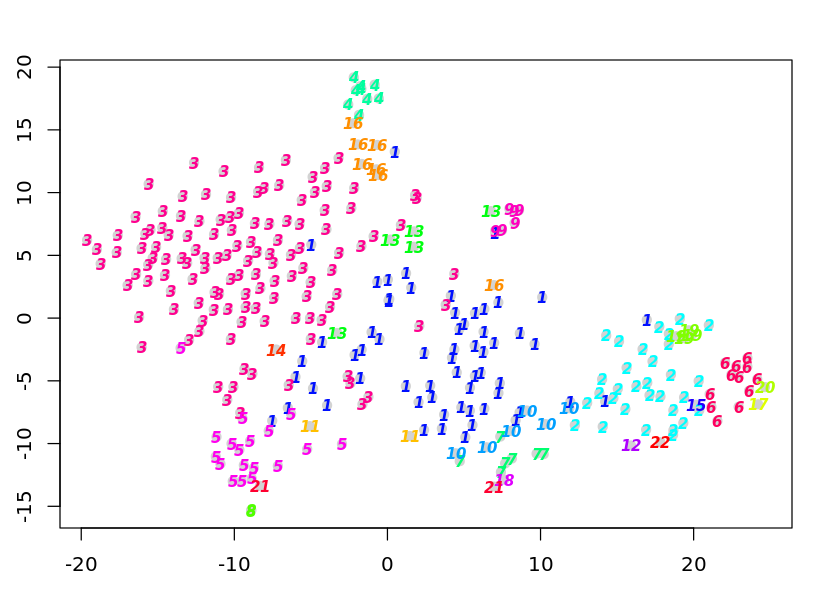

In [305]:
sc_5000_cpcg_8 <- allForOne(5000, clna=8, discover_cc = F)

### clusters = 9

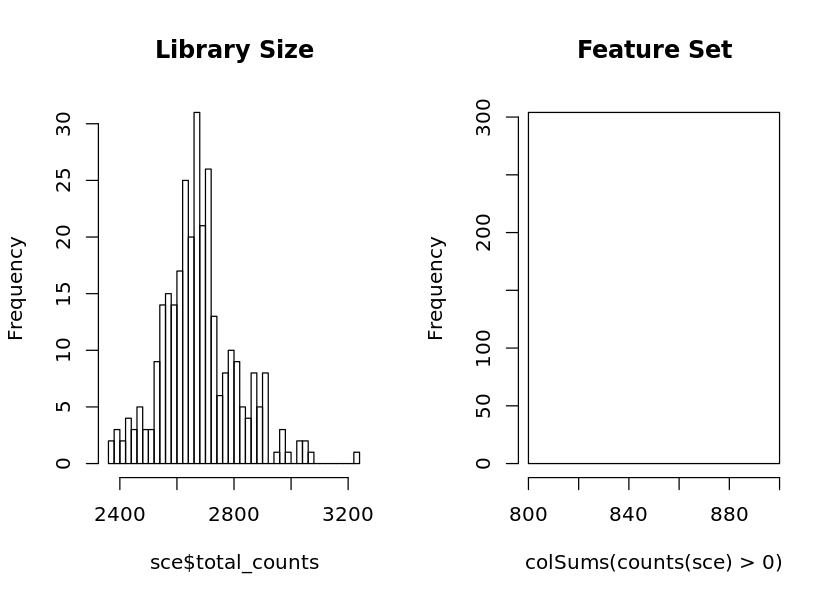

sigma summary: Min. : 0.0525214412284736 |1st Qu. : 0.0674958147610216 |Median : 0.0833678283016824 |Mean : 0.101834619968057 |3rd Qu. : 0.118850776350931 |Max. : 0.328986887190178 |
Epoch: Iteration #100 error is: 0.616174504895324
Epoch: Iteration #200 error is: 0.610920893350571
Epoch: Iteration #300 error is: 0.609851009868558
Epoch: Iteration #400 error is: 0.608248632802685
Epoch: Iteration #500 error is: 0.608240114844534
Epoch: Iteration #600 error is: 0.608239523244946
Epoch: Iteration #700 error is: 0.608239478796476
Epoch: Iteration #800 error is: 0.608239475407498
Epoch: Iteration #900 error is: 0.608239475146147
Epoch: Iteration #1000 error is: 0.608239475126322


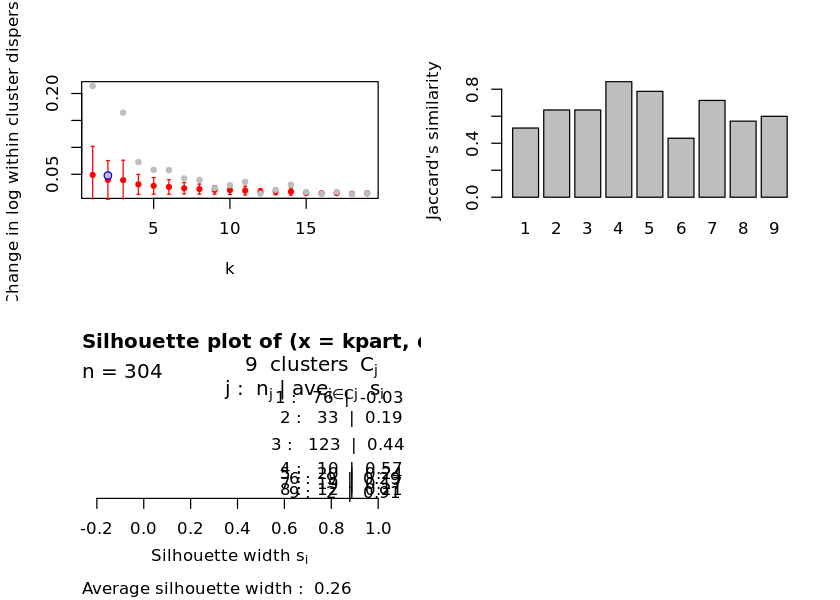

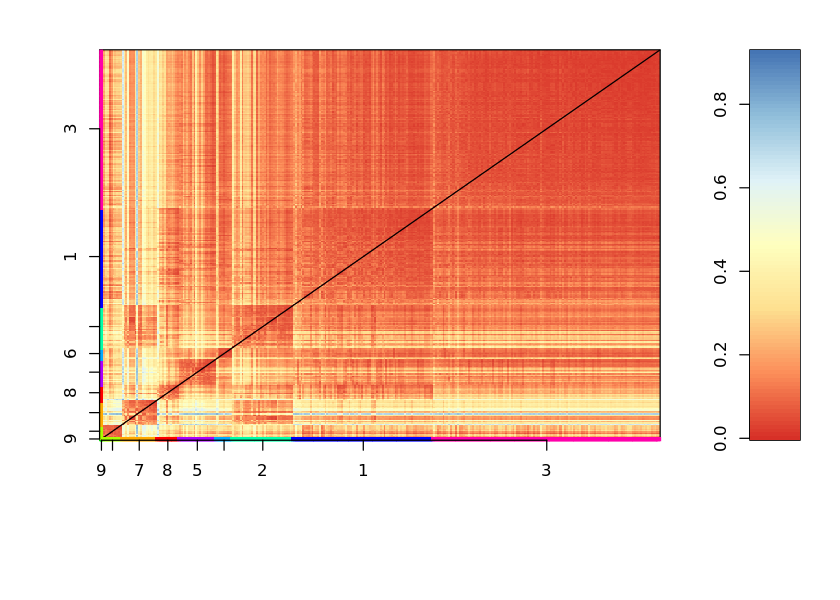

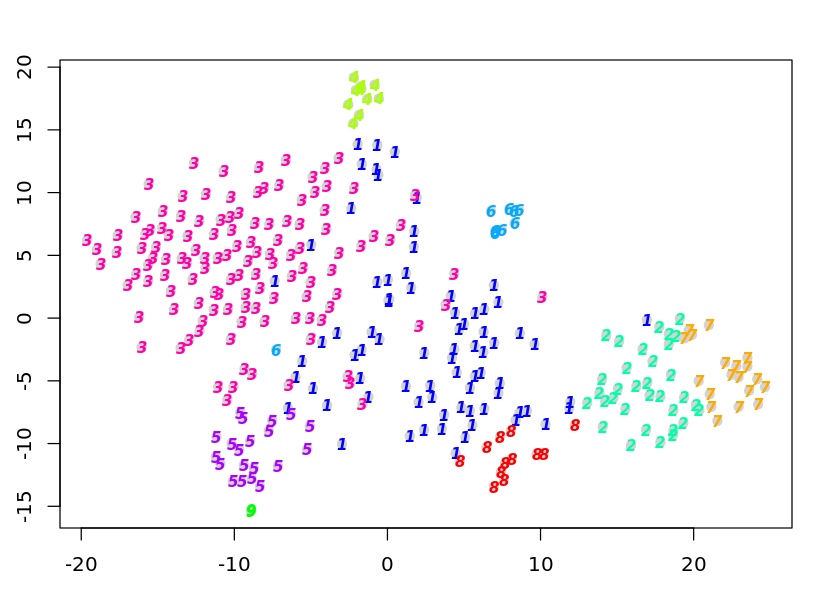

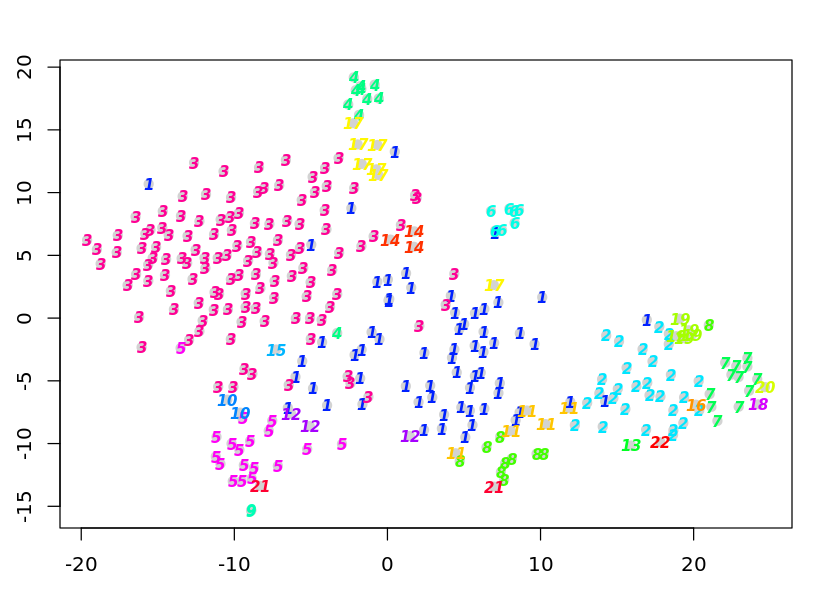

In [306]:
sc_5000_cpcg_9 <- allForOne(5000, clna=9, discover_cc = F)

### clusters = 10

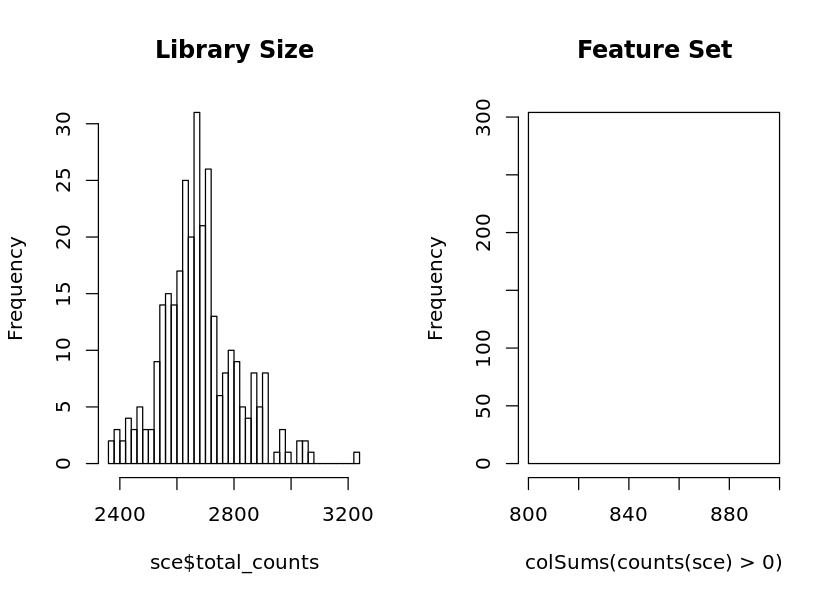

sigma summary: Min. : 0.0525214412284736 |1st Qu. : 0.0674958147610216 |Median : 0.0833678283016824 |Mean : 0.101834619968057 |3rd Qu. : 0.118850776350931 |Max. : 0.328986887190178 |
Epoch: Iteration #100 error is: 0.616174504895324
Epoch: Iteration #200 error is: 0.610920893350571
Epoch: Iteration #300 error is: 0.609851009868558
Epoch: Iteration #400 error is: 0.608248632802685
Epoch: Iteration #500 error is: 0.608240114844534
Epoch: Iteration #600 error is: 0.608239523244946
Epoch: Iteration #700 error is: 0.608239478796476
Epoch: Iteration #800 error is: 0.608239475407498
Epoch: Iteration #900 error is: 0.608239475146147
Epoch: Iteration #1000 error is: 0.608239475126322


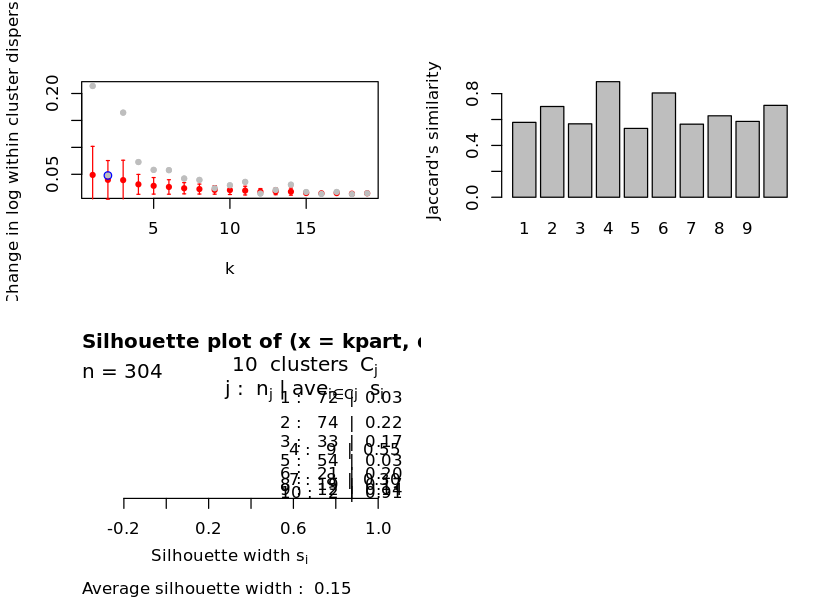

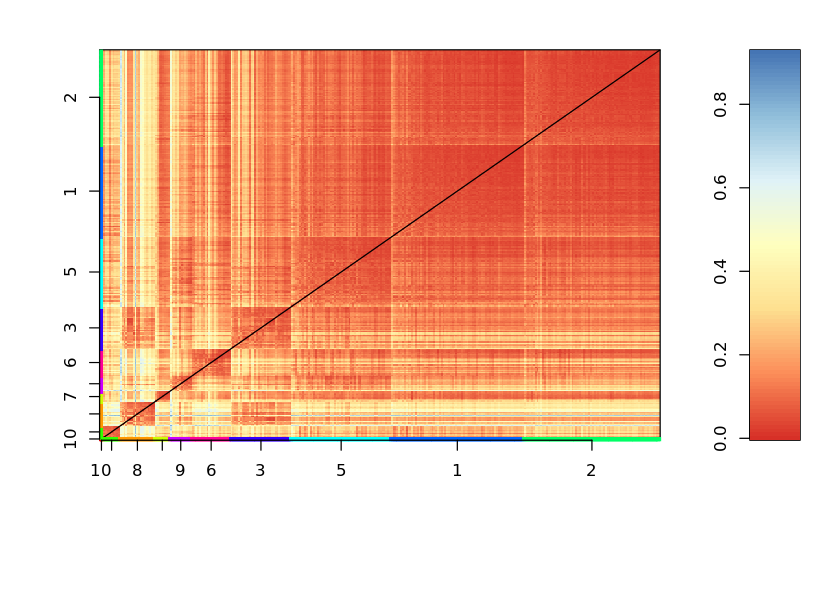

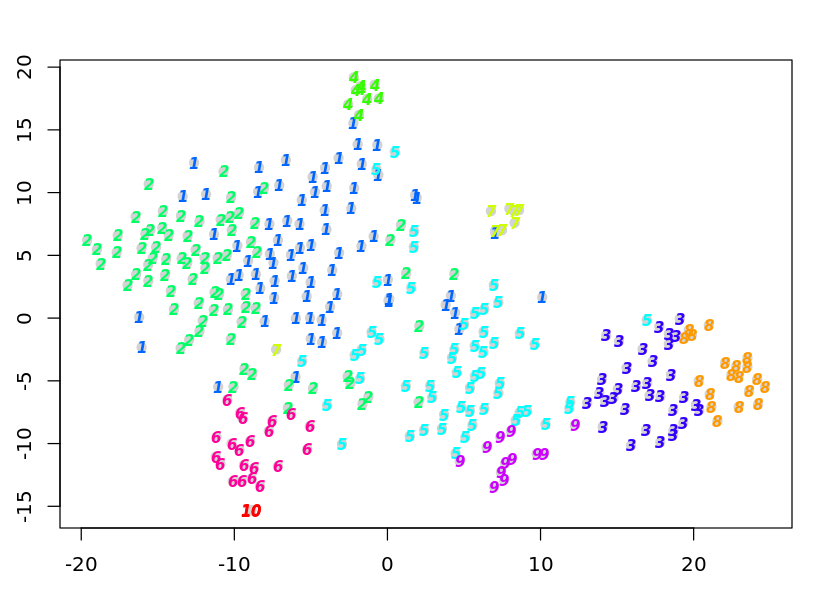

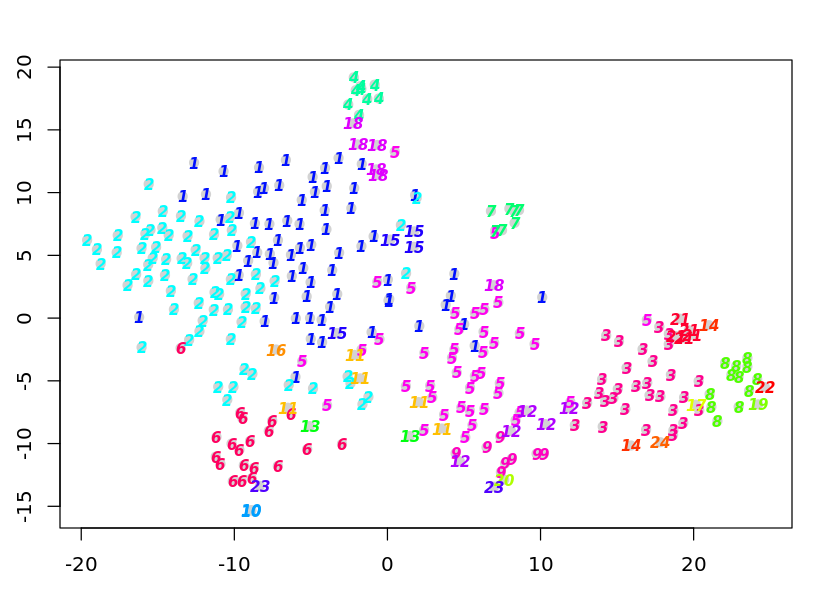

In [307]:
sc_5000_cpcg_10 <- allForOne(5000, clna=10, discover_cc = F)

### clusters = 11

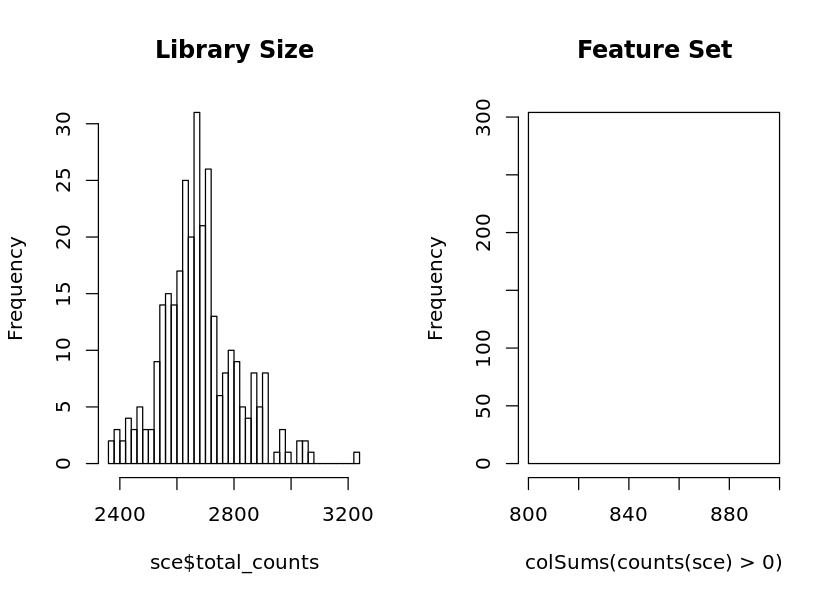

sigma summary: Min. : 0.0525214412284736 |1st Qu. : 0.0674958147610216 |Median : 0.0833678283016824 |Mean : 0.101834619968057 |3rd Qu. : 0.118850776350931 |Max. : 0.328986887190178 |
Epoch: Iteration #100 error is: 0.616174504895324
Epoch: Iteration #200 error is: 0.610920893350571
Epoch: Iteration #300 error is: 0.609851009868558
Epoch: Iteration #400 error is: 0.608248632802685
Epoch: Iteration #500 error is: 0.608240114844534
Epoch: Iteration #600 error is: 0.608239523244946
Epoch: Iteration #700 error is: 0.608239478796476
Epoch: Iteration #800 error is: 0.608239475407498
Epoch: Iteration #900 error is: 0.608239475146147
Epoch: Iteration #1000 error is: 0.608239475126322


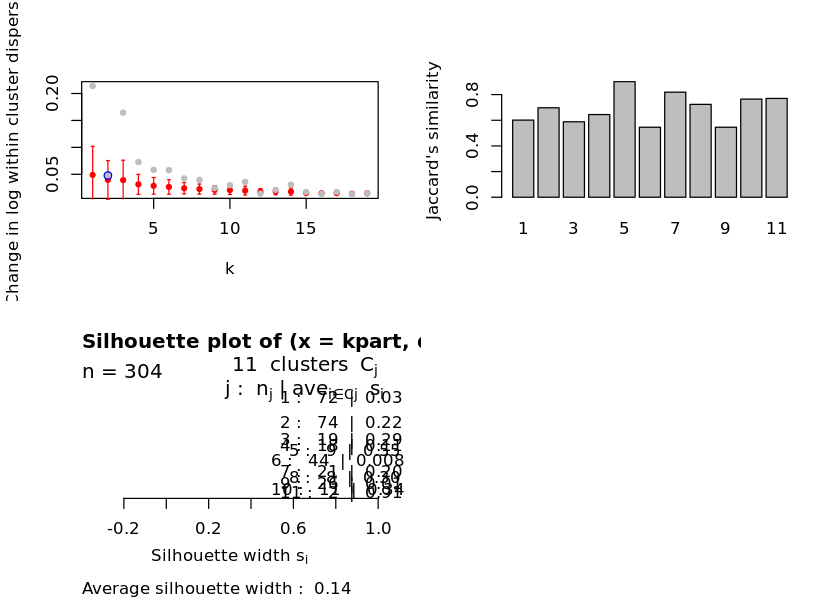

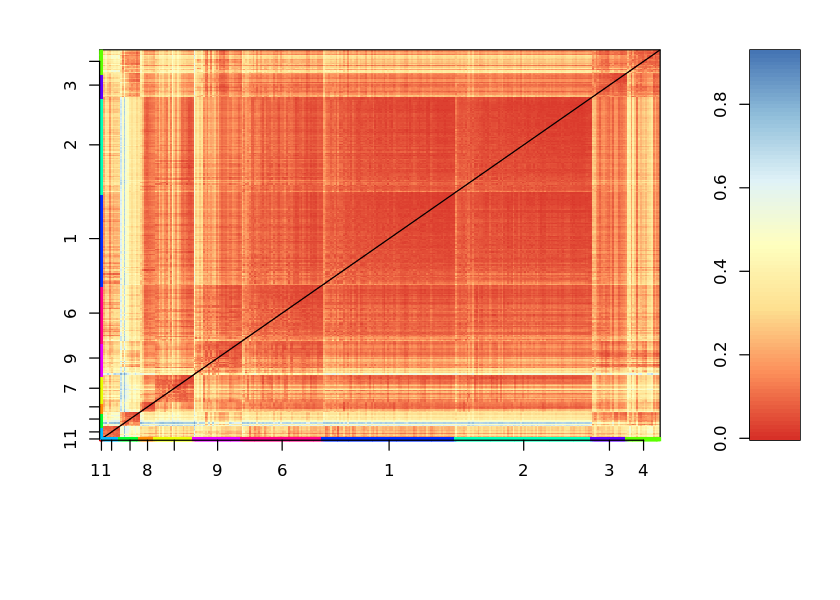

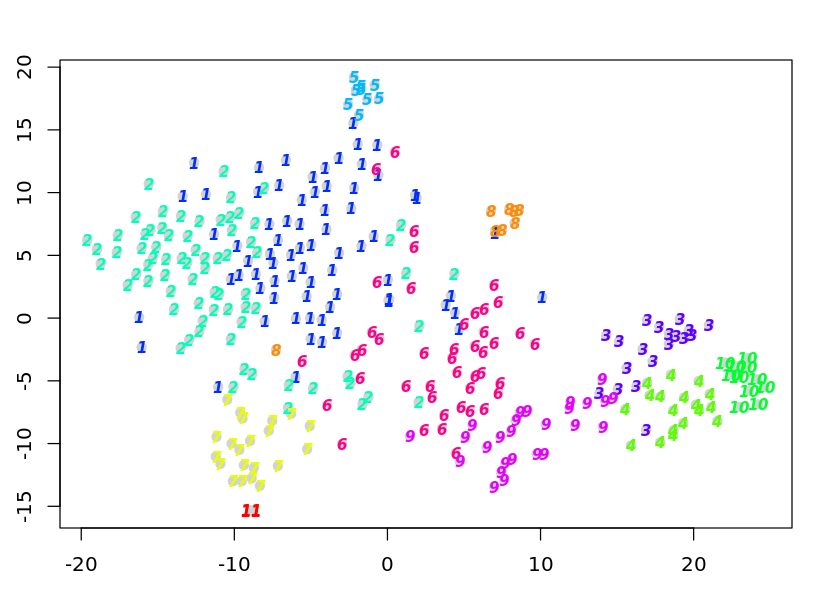

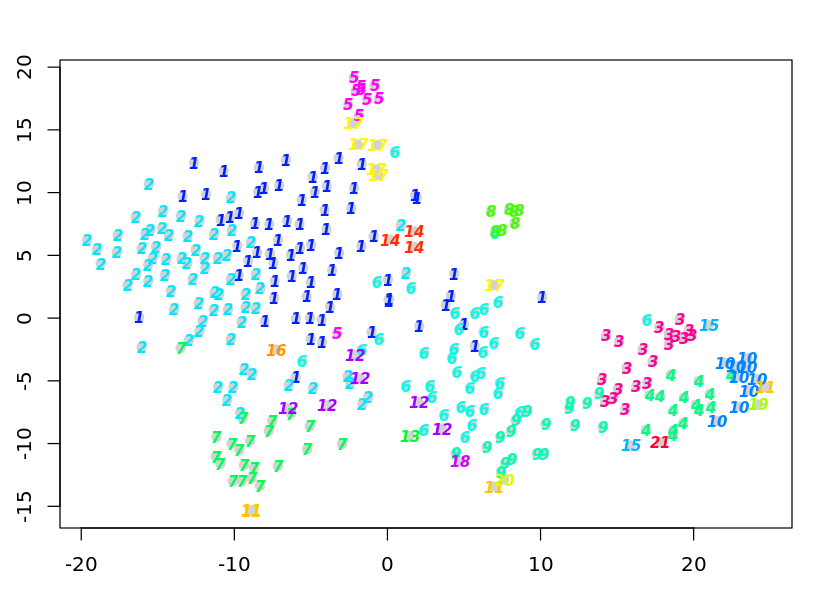

In [308]:
sc_5000_cpcg_11 <- allForOne(5000, clna=11, discover_cc = F)

### clusters = 12

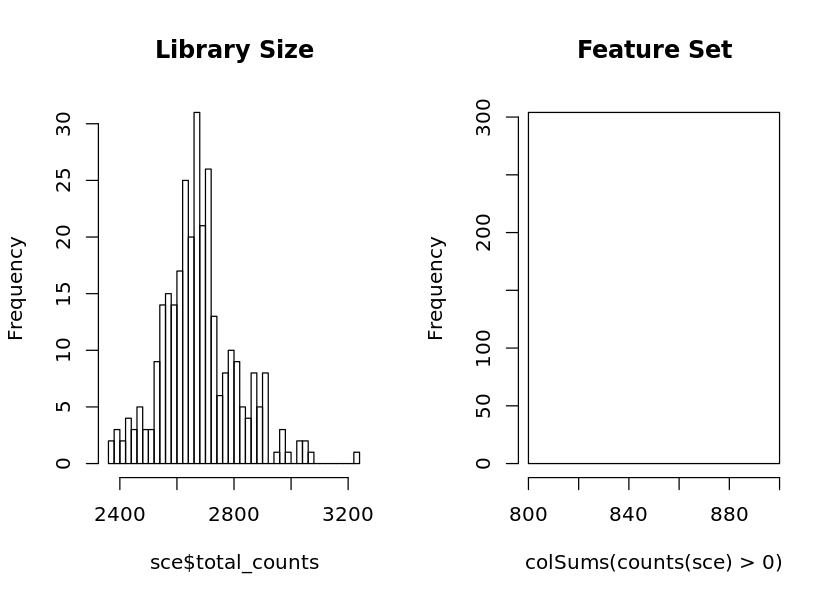

sigma summary: Min. : 0.0525214412284736 |1st Qu. : 0.0674958147610216 |Median : 0.0833678283016824 |Mean : 0.101834619968057 |3rd Qu. : 0.118850776350931 |Max. : 0.328986887190178 |
Epoch: Iteration #100 error is: 0.616174504895324
Epoch: Iteration #200 error is: 0.610920893350571
Epoch: Iteration #300 error is: 0.609851009868558
Epoch: Iteration #400 error is: 0.608248632802685
Epoch: Iteration #500 error is: 0.608240114844534
Epoch: Iteration #600 error is: 0.608239523244946
Epoch: Iteration #700 error is: 0.608239478796476
Epoch: Iteration #800 error is: 0.608239475407498
Epoch: Iteration #900 error is: 0.608239475146147
Epoch: Iteration #1000 error is: 0.608239475126322


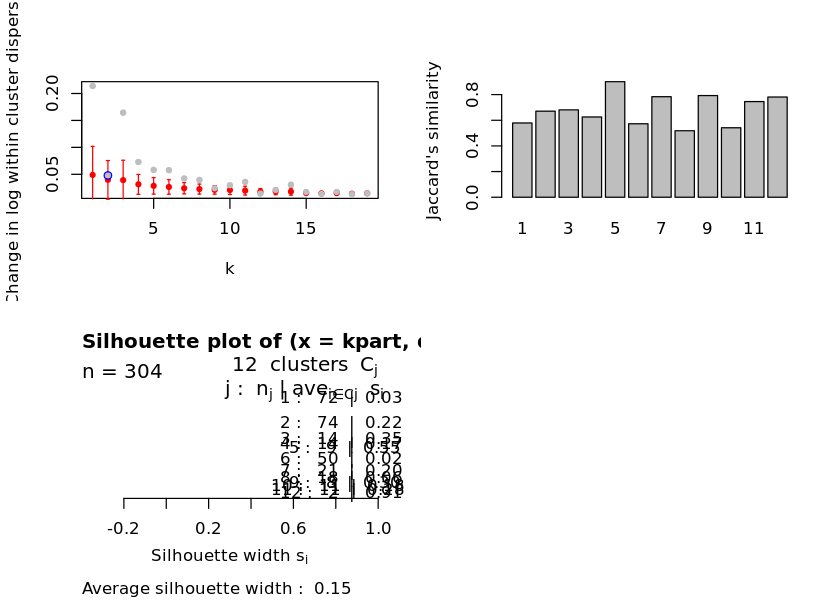

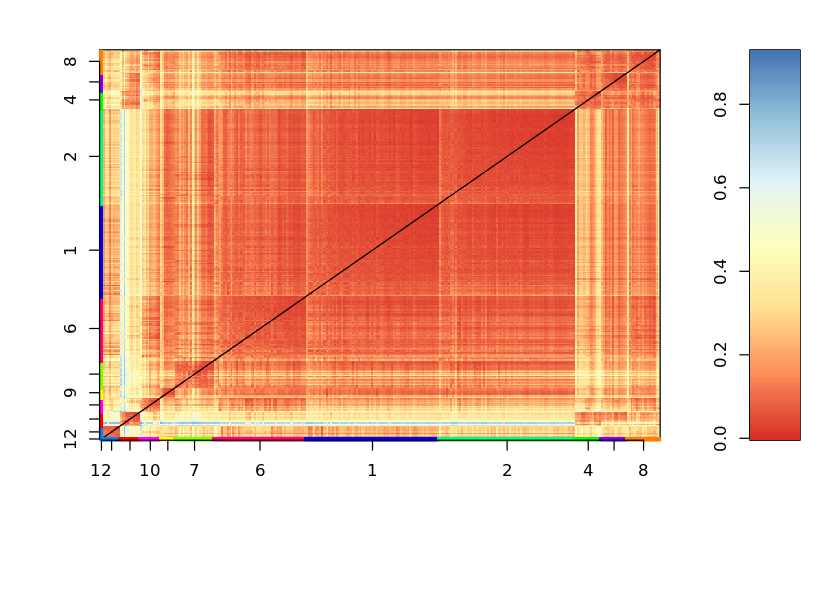

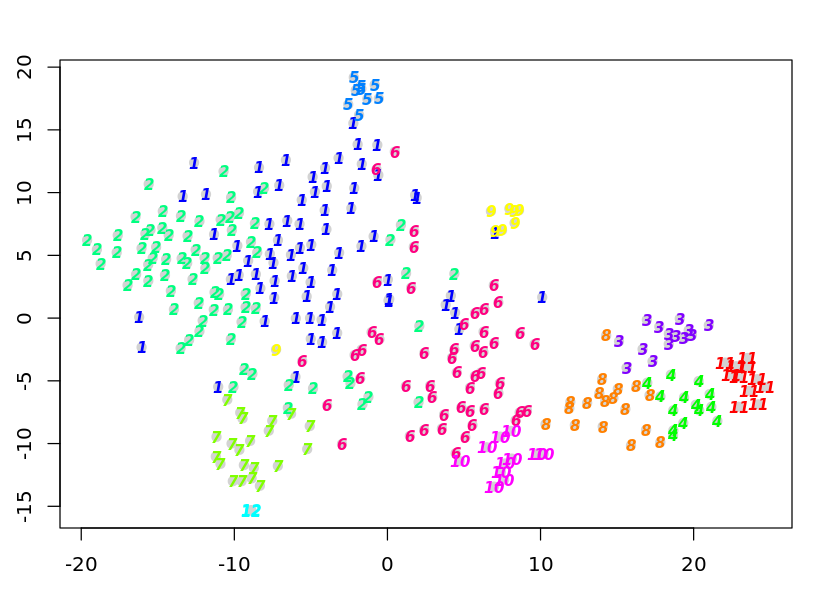

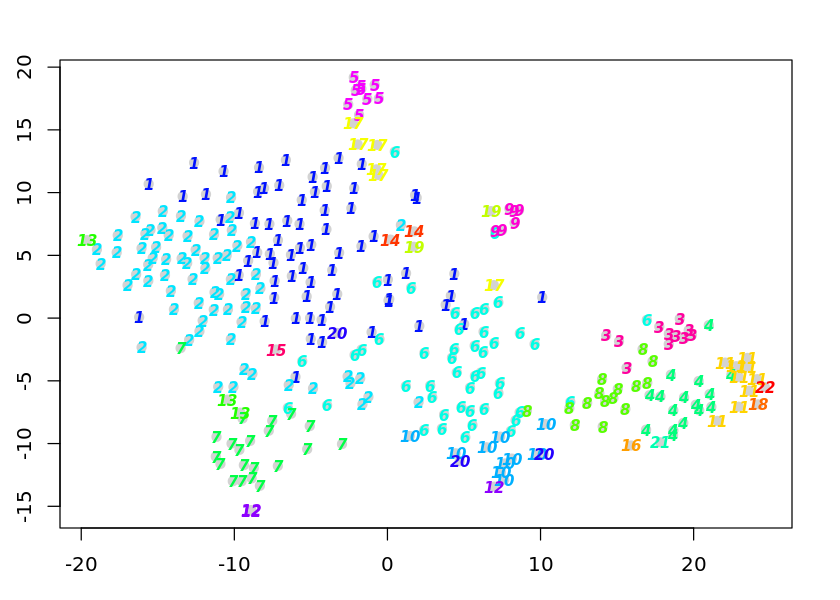

In [309]:
sc_5000_cpcg_12 <- allForOne(5000, clna=12, discover_cc = F)

### clusters = 13

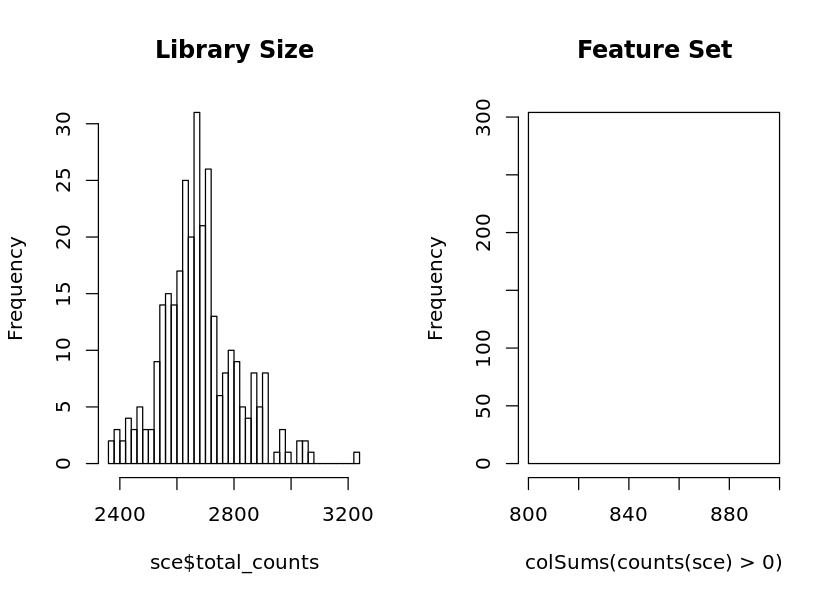

sigma summary: Min. : 0.0525214412284736 |1st Qu. : 0.0674958147610216 |Median : 0.0833678283016824 |Mean : 0.101834619968057 |3rd Qu. : 0.118850776350931 |Max. : 0.328986887190178 |
Epoch: Iteration #100 error is: 0.616174504895324
Epoch: Iteration #200 error is: 0.610920893350571
Epoch: Iteration #300 error is: 0.609851009868558
Epoch: Iteration #400 error is: 0.608248632802685
Epoch: Iteration #500 error is: 0.608240114844534
Epoch: Iteration #600 error is: 0.608239523244946
Epoch: Iteration #700 error is: 0.608239478796476
Epoch: Iteration #800 error is: 0.608239475407498
Epoch: Iteration #900 error is: 0.608239475146147
Epoch: Iteration #1000 error is: 0.608239475126322


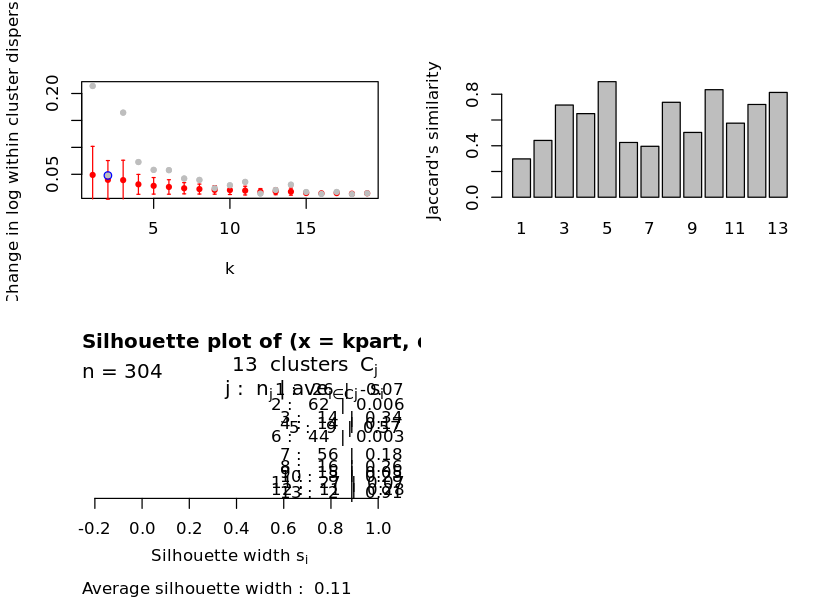

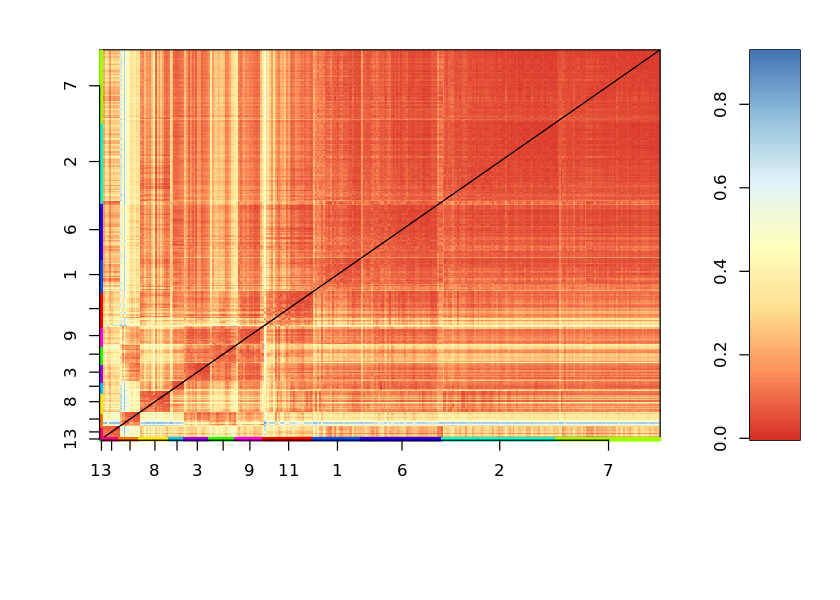

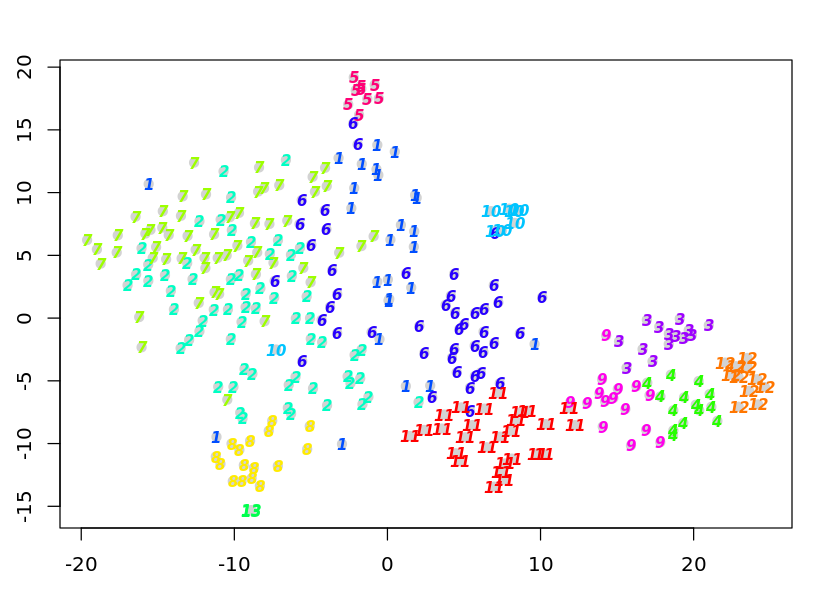

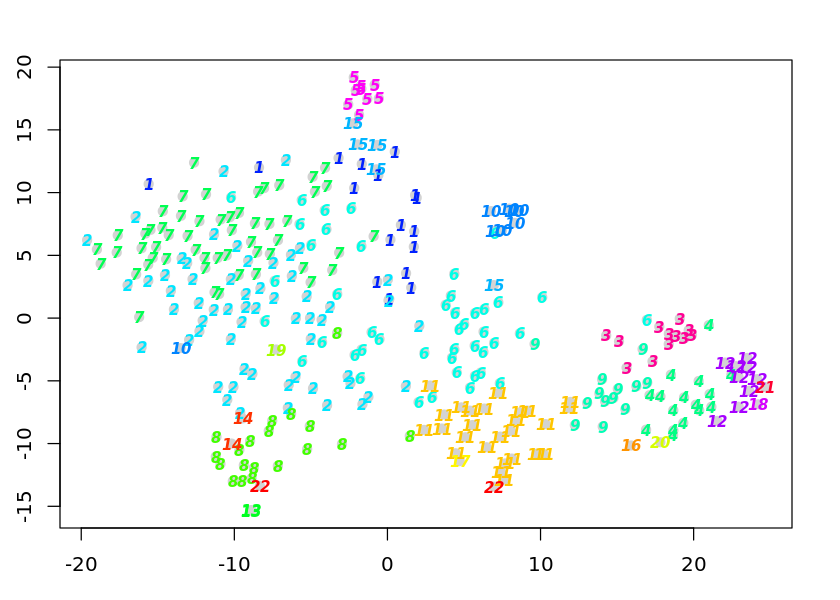

In [310]:
sc_5000_cpcg_13 <- allForOne(5000, clna=13, discover_cc = F)

### clusters = 14

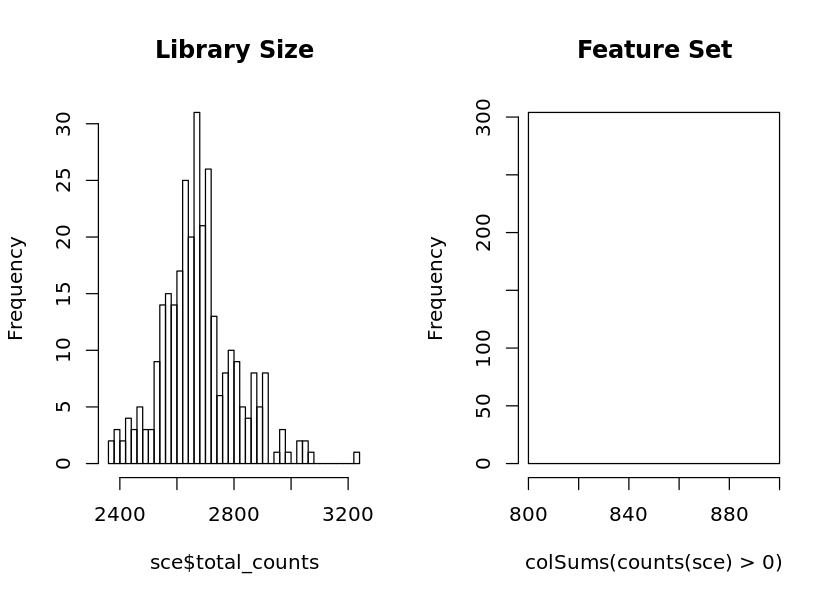

sigma summary: Min. : 0.0525214412284736 |1st Qu. : 0.0674958147610216 |Median : 0.0833678283016824 |Mean : 0.101834619968057 |3rd Qu. : 0.118850776350931 |Max. : 0.328986887190178 |
Epoch: Iteration #100 error is: 0.616174504895324
Epoch: Iteration #200 error is: 0.610920893350571
Epoch: Iteration #300 error is: 0.609851009868558
Epoch: Iteration #400 error is: 0.608248632802685
Epoch: Iteration #500 error is: 0.608240114844534
Epoch: Iteration #600 error is: 0.608239523244946
Epoch: Iteration #700 error is: 0.608239478796476
Epoch: Iteration #800 error is: 0.608239475407498
Epoch: Iteration #900 error is: 0.608239475146147
Epoch: Iteration #1000 error is: 0.608239475126322


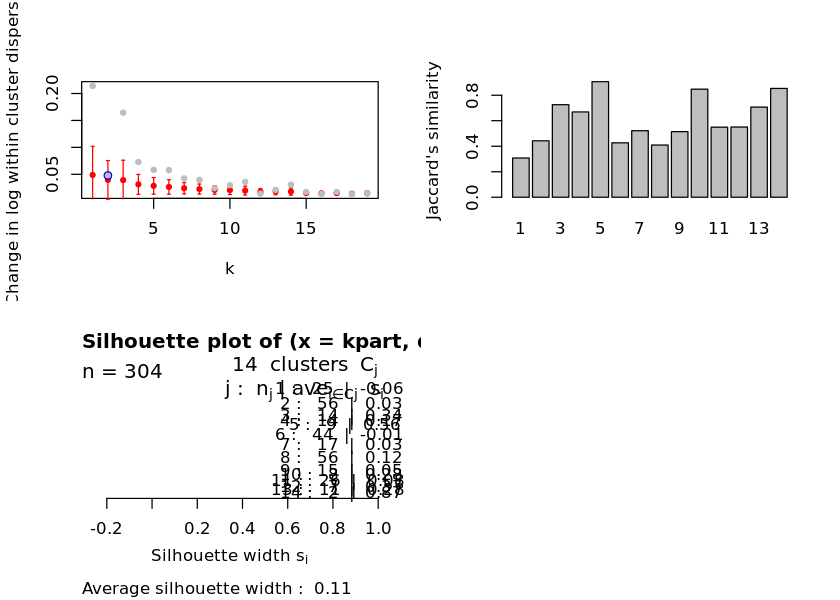

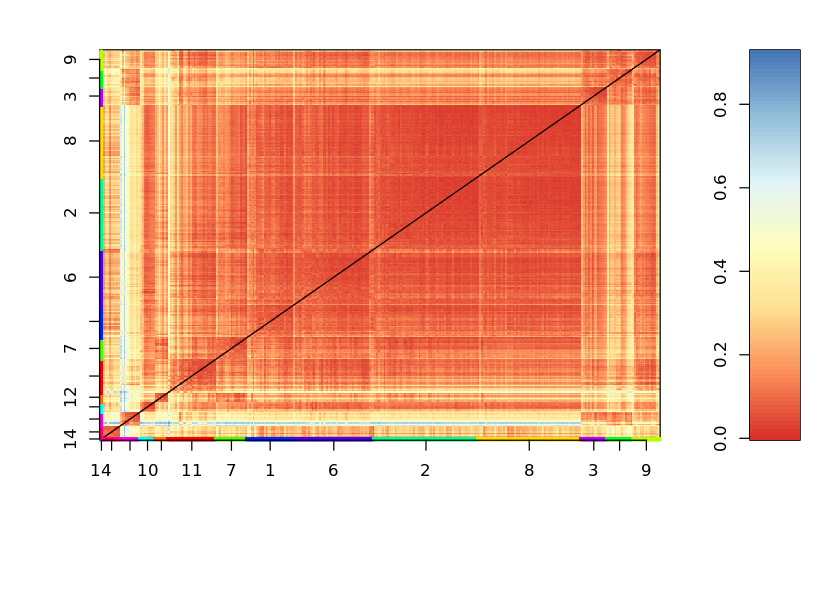

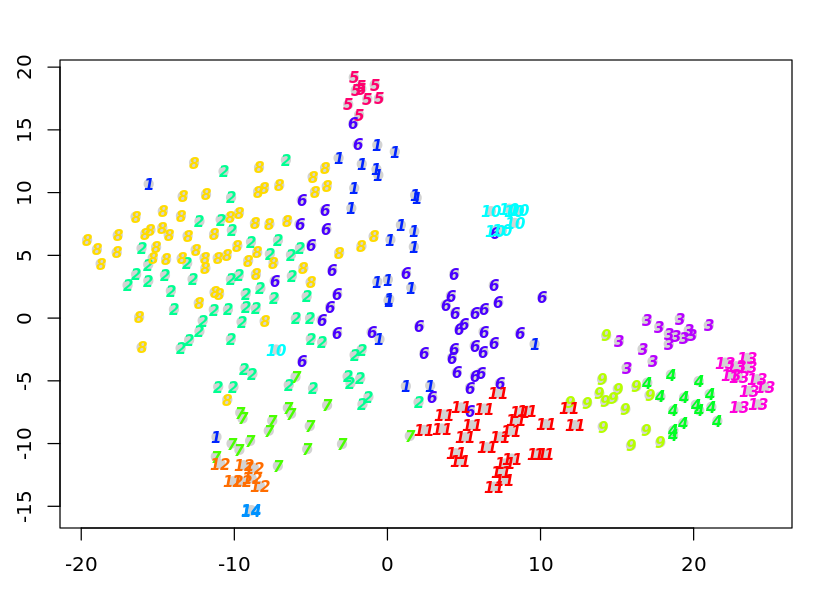

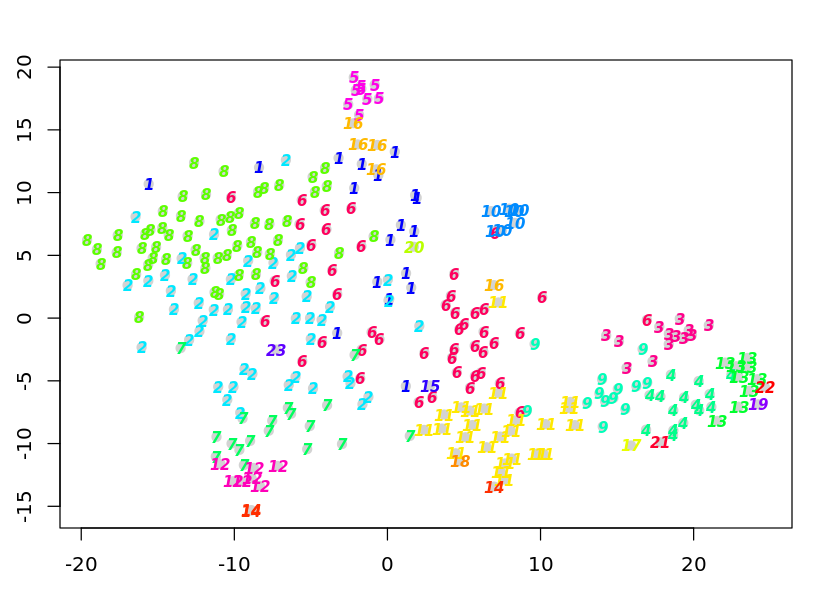

In [311]:
sc_5000_cpcg_14 <- allForOne(5000, clna=14, discover_cc = F)

### clusters = 15

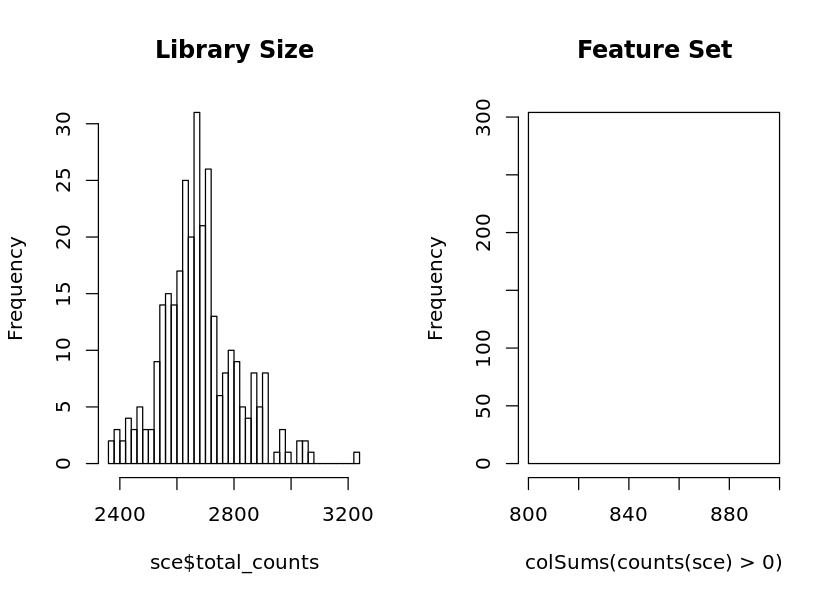

sigma summary: Min. : 0.0525214412284736 |1st Qu. : 0.0674958147610216 |Median : 0.0833678283016824 |Mean : 0.101834619968057 |3rd Qu. : 0.118850776350931 |Max. : 0.328986887190178 |
Epoch: Iteration #100 error is: 0.616174504895324
Epoch: Iteration #200 error is: 0.610920893350571
Epoch: Iteration #300 error is: 0.609851009868558
Epoch: Iteration #400 error is: 0.608248632802685
Epoch: Iteration #500 error is: 0.608240114844534
Epoch: Iteration #600 error is: 0.608239523244946
Epoch: Iteration #700 error is: 0.608239478796476
Epoch: Iteration #800 error is: 0.608239475407498
Epoch: Iteration #900 error is: 0.608239475146147
Epoch: Iteration #1000 error is: 0.608239475126322


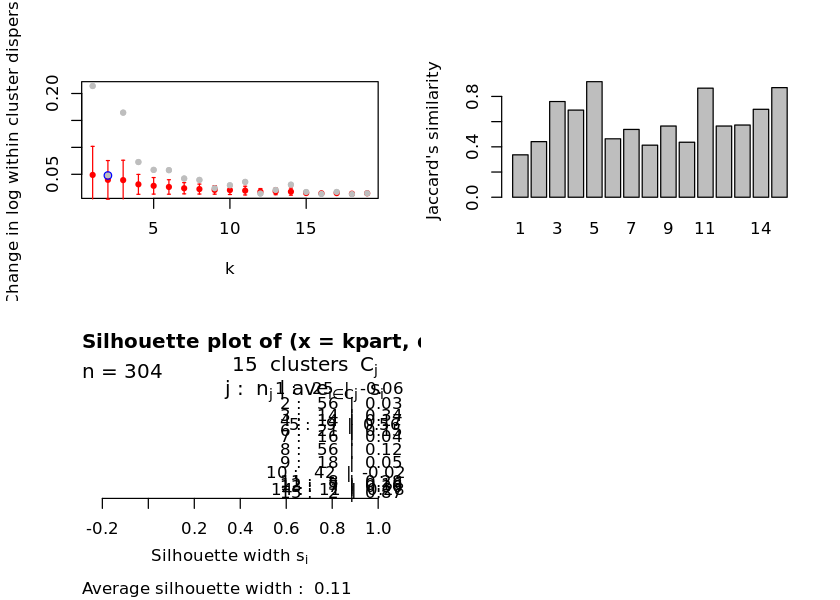

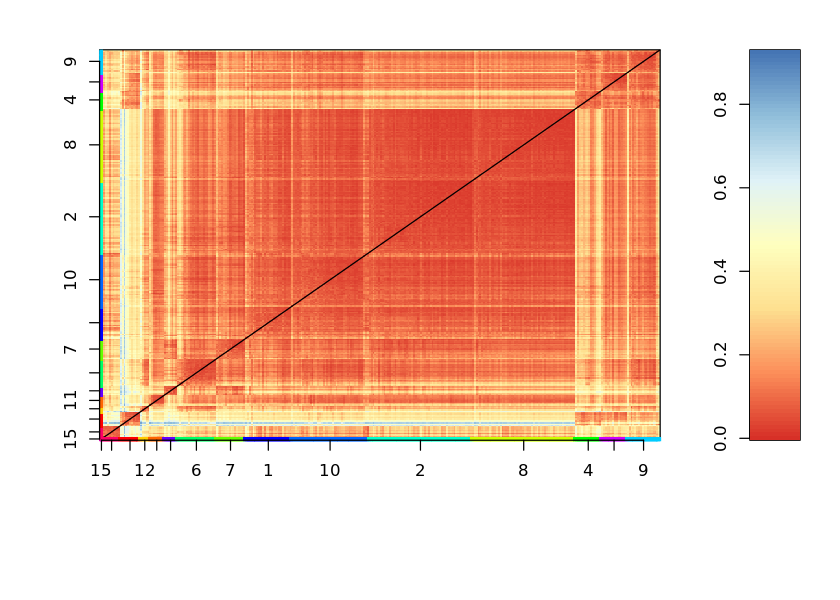

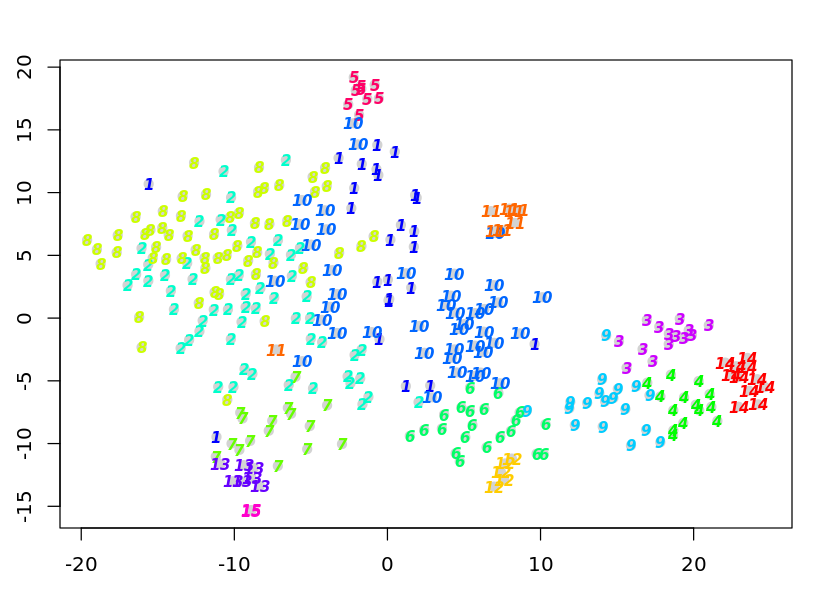

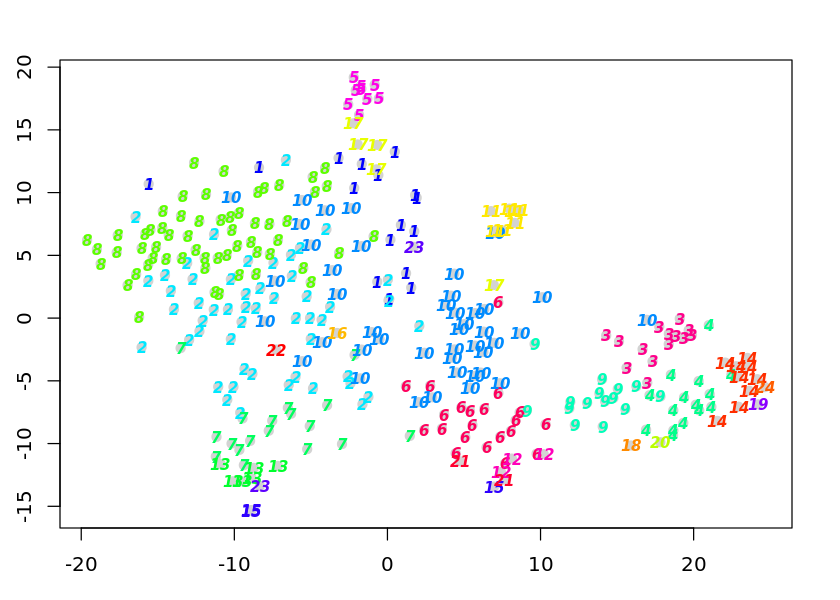

In [312]:
sc_5000_cpcg_15 <- allForOne(5000, clna=15, discover_cc = F)

### Summary

Better. By looking at the Jaccard similarity we get the most number of stable clusters ~ 12

## Re-examining known markers

Better definition than with CC and CP regression, and heatmaps show much clearer contrast.


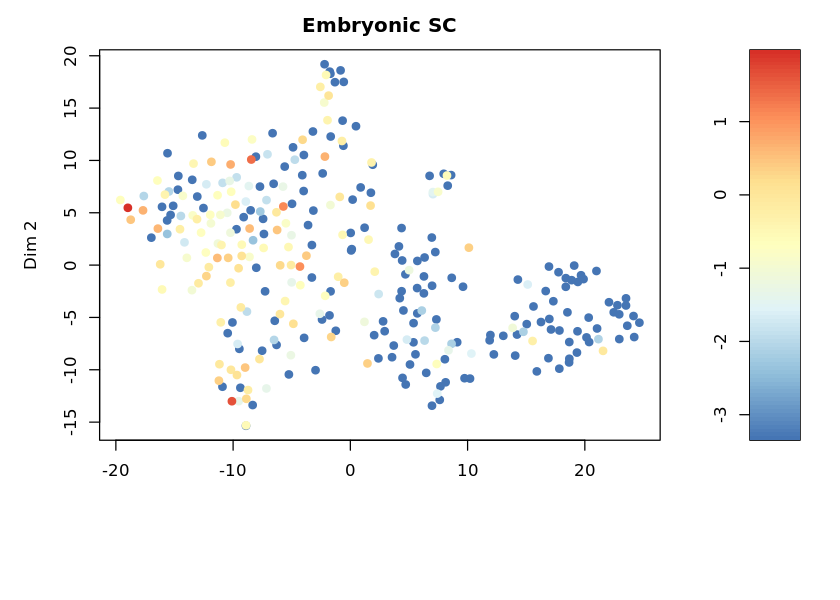

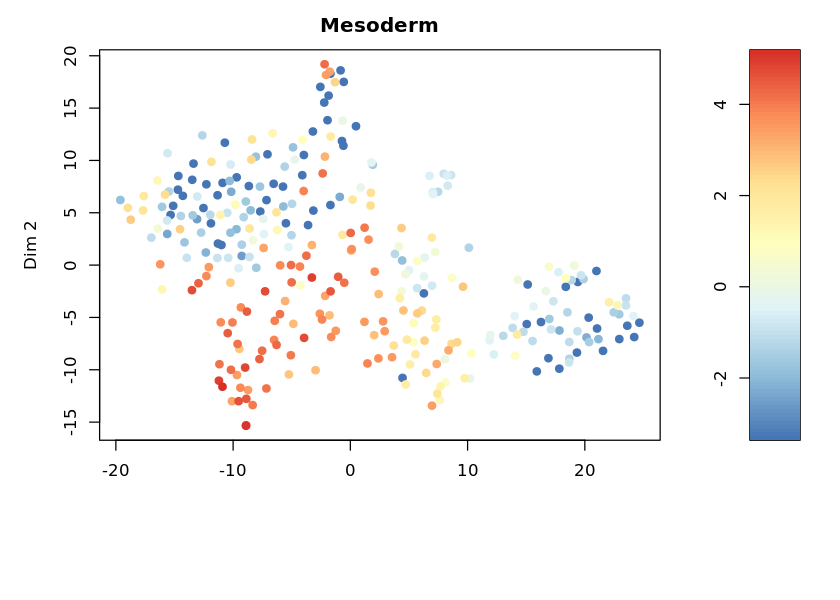

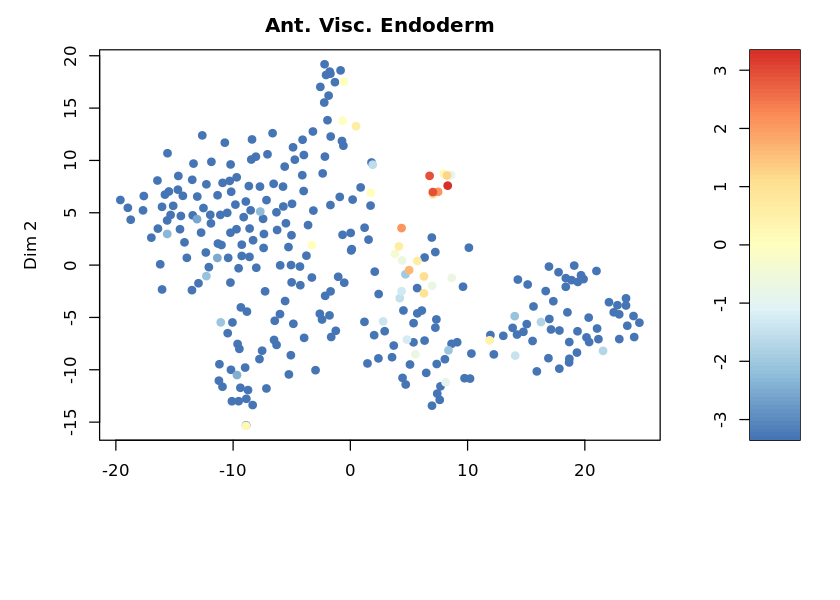

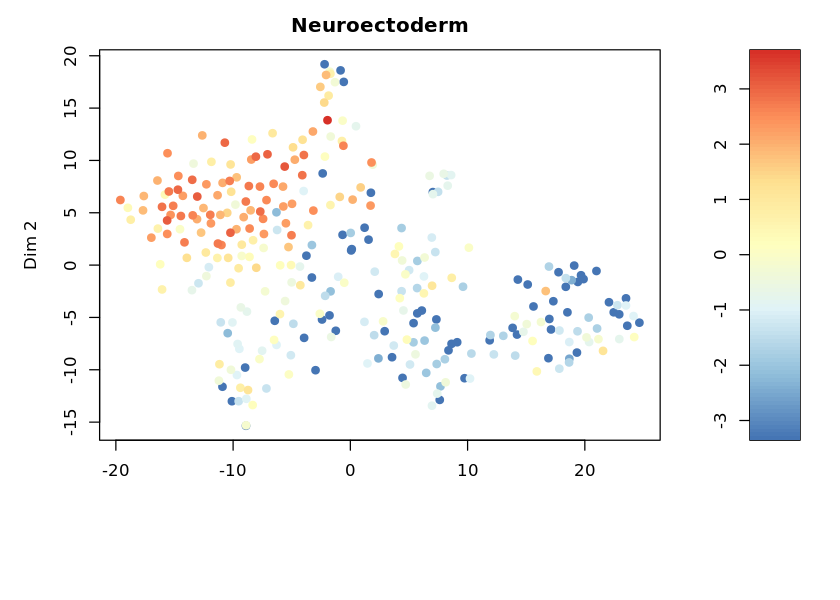

In [320]:
plotexptsne(sc_5000_cpcg_12, is.embryonic_stemcell, n="Embryonic SC", logsc=T)
plotexptsne(sc_5000_cpcg_12, is.mesoderm, n="Mesoderm", logsc=T)
plotexptsne(sc_5000_cpcg_12, is.antviscendo, n="Ant. Visc. Endoderm", logsc=T)
plotexptsne(sc_5000_cpcg_12, is.neuroectoderm, n="Neuroectoderm", logsc=T)

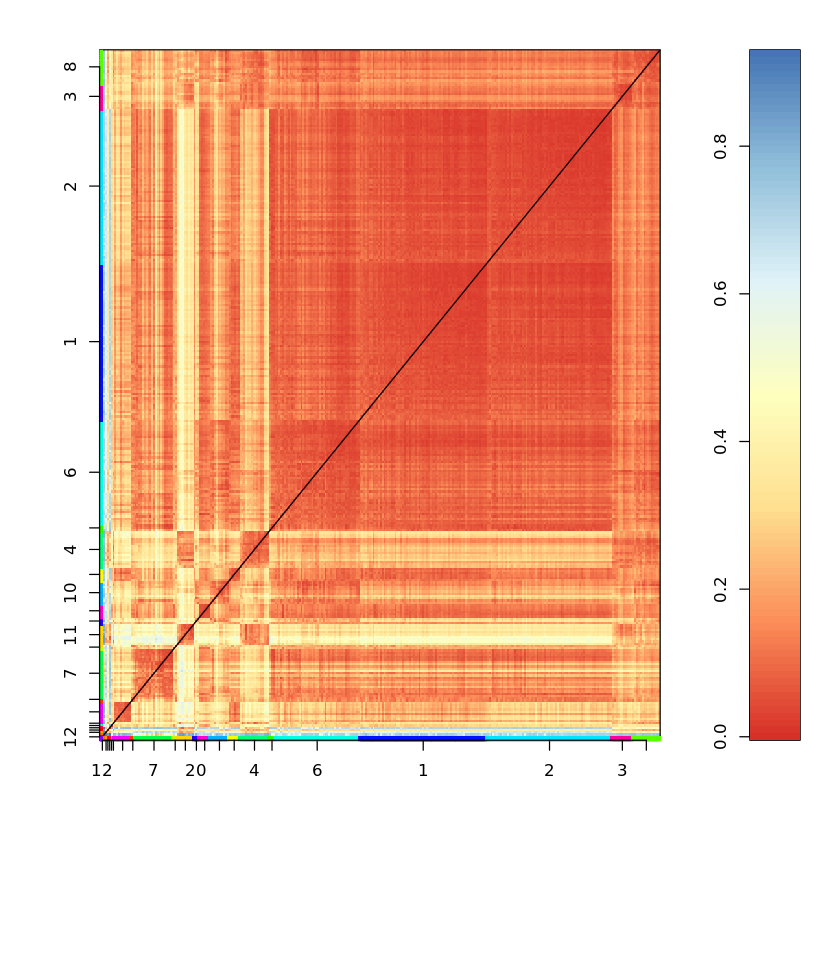

In [340]:
# Final heatmap
zz <- clustheatmap(sc_5000_cpcg_12, final=T)

## Examine of final clusters

(Aggravatingly no gene/cell heatmap to show clustering, must inspect textually)

In [345]:
cdiff <- clustdiffgenes(sc_5000_cpcg_12, pvalue=0.1)

In [401]:
tab <- c()
for (n in names(cdiff)){
    tabr <- cdiff[[n]]
    tab <- rbind(
        tab,
        cbind(n,
            rbind(
              head(tabr), #[tabr$pv < 1e-30,])
              tabr[rownames(tabr) == "Eomes",]
            )
        )
    )
}
tab[(tab$pv < 1e-20 | rownames(tab) == "Eomes"),]

,n,mean.ncl,mean.cl,fc,pv,padj
H19,cl.1,12.3611705,1.9861602,0.16067735,6.398798e-112,5.554157e-109
Igf2,cl.1,6.9055621,1.0010798,0.14496717,2.668822e-102,1.158269e-99
Fn1,cl.1,8.7983371,2.3885946,0.27148250,6.718897e-84,1.944001e-81
T,cl.1,9.2950947,2.7649410,0.29746238,4.637770e-80,1.006396e-77
Phlda2,cl.1,6.3506695,1.3022469,0.20505663,4.168383e-76,7.236313e-74
Peg3,cl.1,10.7881266,5.5829423,0.51750805,8.872697e-39,1.283584e-36
H191,cl.2,12.4696455,1.4571145,0.11685292,3.469321e-116,3.011371e-113
Igf21,cl.2,6.9789989,0.6593803,0.09448064,1.979307e-111,8.590194e-109
Fn11,cl.2,8.8495802,2.1164899,0.23916275,1.449274e-93,4.193234e-91
Phlda21,cl.2,6.4100128,1.0220491,0.15944572,1.621728e-89,3.519149e-87


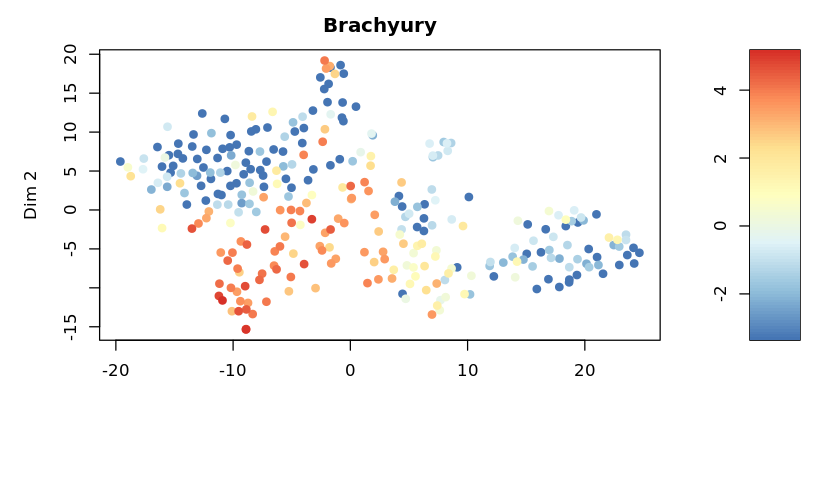

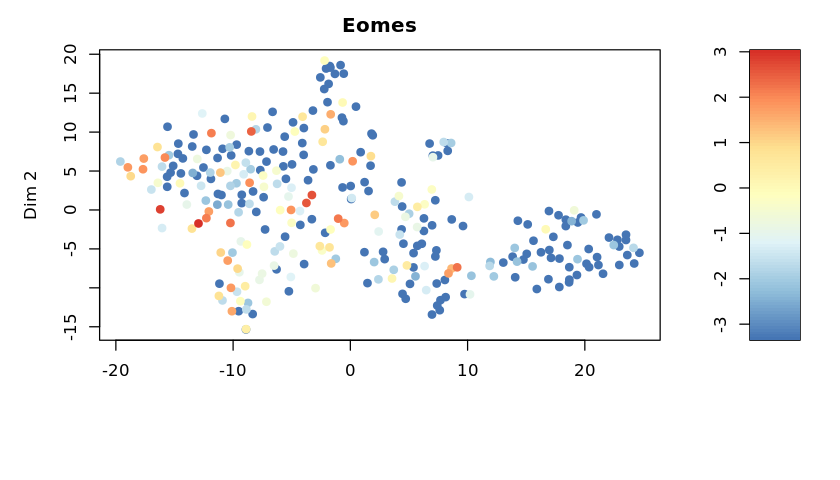

In [404]:
options(repr.plot.height = 4)
plotexptsne(sc_5000_cpcg_12, "T", n="Brachyury", logsc=T)
#plotexptsne(sc_5000_cpcg_12, is.mesoderm, n="Mesoderm", logsc=T)
plotexptsne(sc_5000_cpcg_12, "Eomes", n="Eomes", logsc=T)
#plotexptsne(sc_5000_cpcg_12, is.embryonic_stemcell, n="Embryonic SC", logsc=T)

T seems to be well defined but Eomes is weak.

## StemID

Init. lineage tree, measure entropy of each cell type, and determine cell projections.

https://github.com/dgrun/RaceID3_StemID2/blob/master/RaceID3_StemID2_class.R

In [341]:
ltr <- Ltree(sc_5000_cpcg_12)
ltr <- compentropy(ltr)
ltr <- projcells(ltr, cthr = 2, nmode=F)

In [342]:
# apply randomisation
ltr <- projback(ltr, nmode=F)

pdishuffle: 1 
pdishuffle: 2 
pdishuffle: 3 
pdishuffle: 4 
pdishuffle: 5 
pdishuffle: 6 
pdishuffle: 7 
pdishuffle: 8 
pdishuffle: 9 
pdishuffle: 10 
pdishuffle: 11 
pdishuffle: 12 
pdishuffle: 13 
pdishuffle: 14 
pdishuffle: 15 
pdishuffle: 16 
pdishuffle: 17 
pdishuffle: 18 
pdishuffle: 19 
pdishuffle: 20 
pdishuffle: 21 
pdishuffle: 22 
pdishuffle: 23 
pdishuffle: 24 
pdishuffle: 25 
pdishuffle: 26 
pdishuffle: 27 
pdishuffle: 28 
pdishuffle: 29 
pdishuffle: 30 
pdishuffle: 31 
pdishuffle: 32 
pdishuffle: 33 
pdishuffle: 34 
pdishuffle: 35 
pdishuffle: 36 
pdishuffle: 37 
pdishuffle: 38 
pdishuffle: 39 
pdishuffle: 40 
pdishuffle: 41 
pdishuffle: 42 
pdishuffle: 43 
pdishuffle: 44 
pdishuffle: 45 
pdishuffle: 46 
pdishuffle: 47 
pdishuffle: 48 
pdishuffle: 49 
pdishuffle: 50 
pdishuffle: 51 
pdishuffle: 52 
pdishuffle: 53 
pdishuffle: 54 
pdishuffle: 55 
pdishuffle: 56 
pdishuffle: 57 
pdishuffle: 58 
pdishuffle: 59 
pdishuffle: 60 
pdishuffle: 61 
pdishuffle: 62 
pdishuffle: 63 
p

#### Lineage Tree

Assemble the lineage tree

In [343]:
ltr <- lineagetree(ltr,pth=0.01, nmode = F, fast=F)
ltr <- comppvalue(ltr, pethr=0.01, nmode = F, fast = F)

#### Visualization of lineage tree

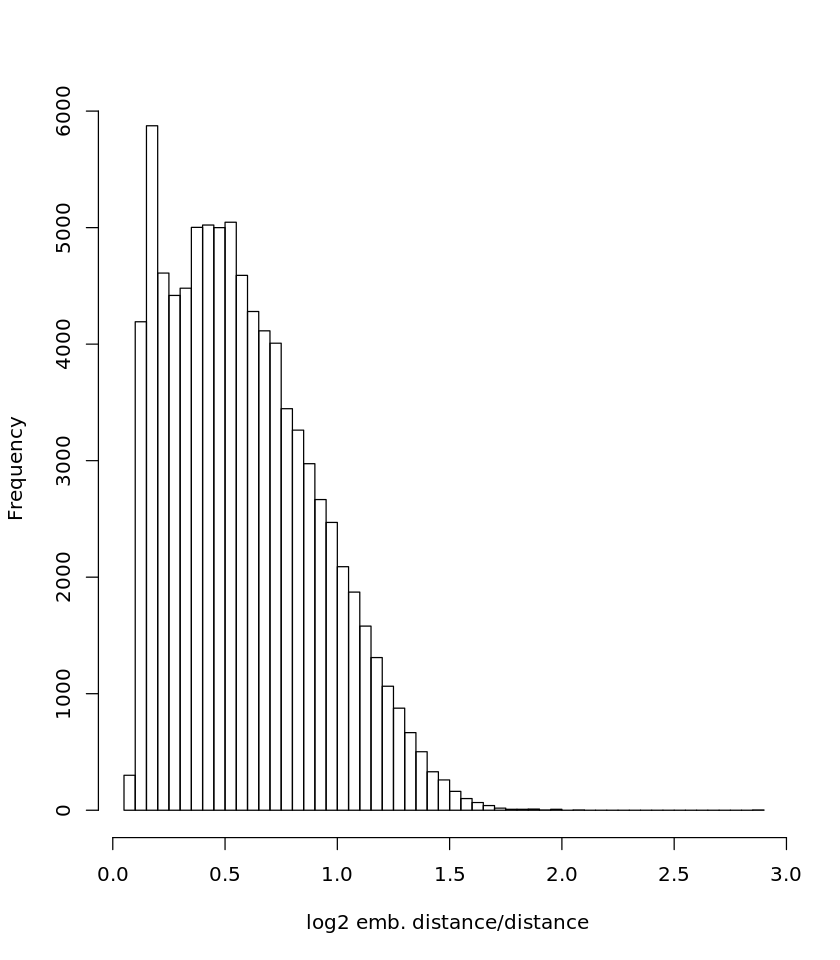

In [344]:
plotdistanceratio(ltr)

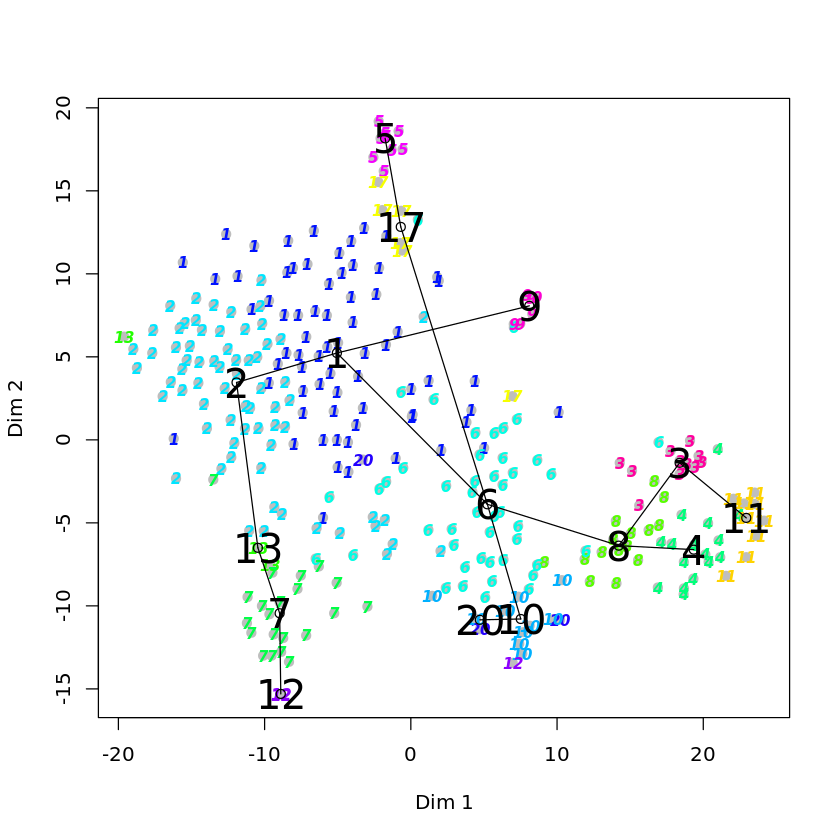

In [407]:
options(repr.plot.height = 7)
plotmap(ltr)

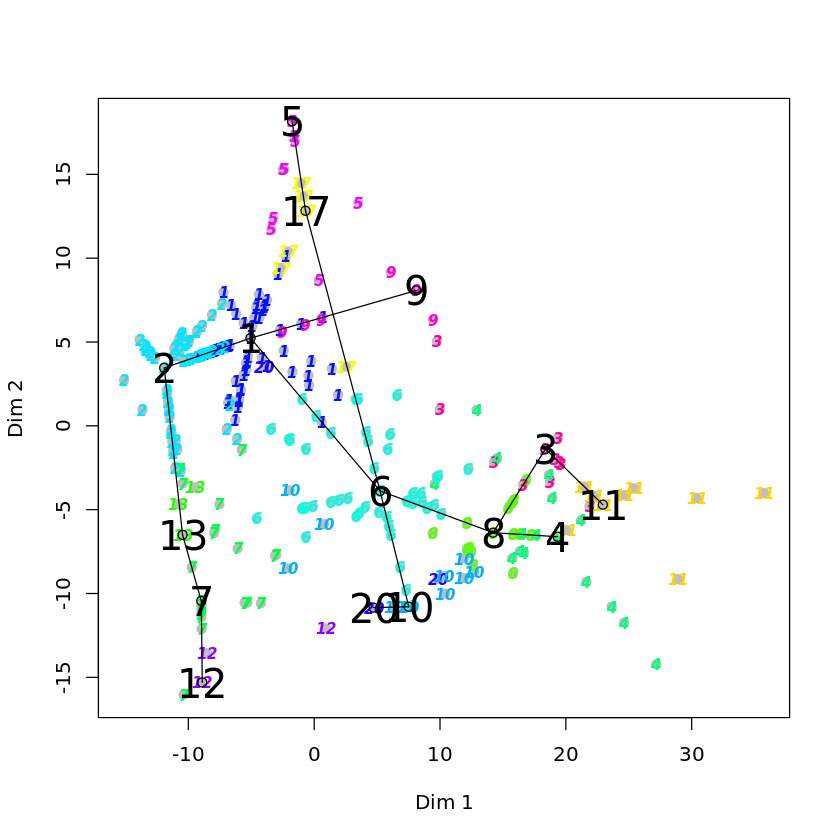

In [408]:
plotmapprojections(ltr)

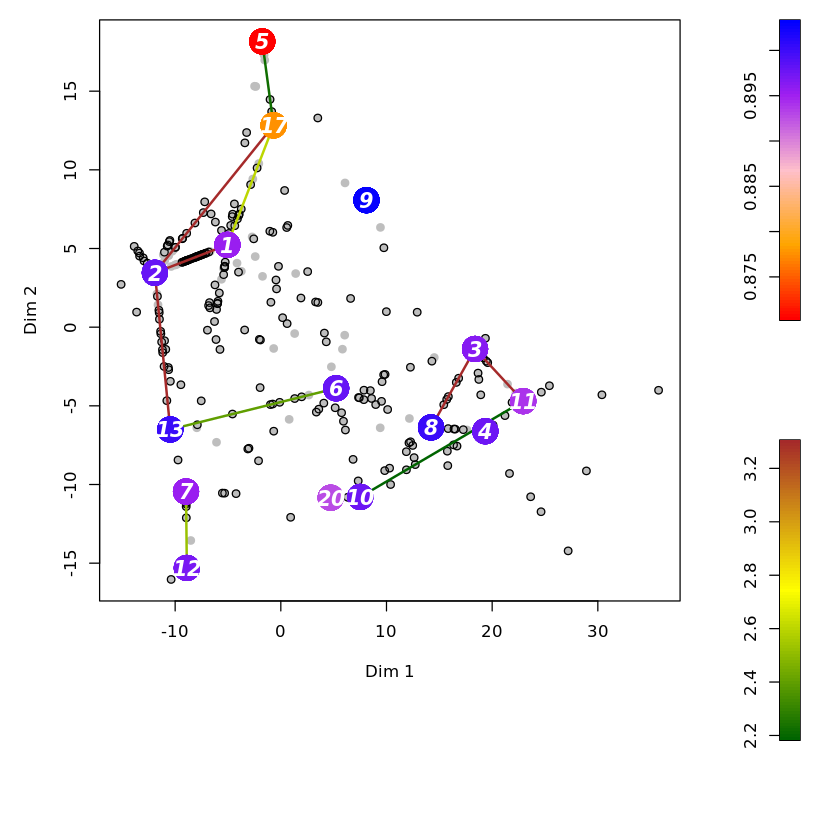

In [409]:
plottree(ltr,showCells=T,nmode=F,scthr=.3)

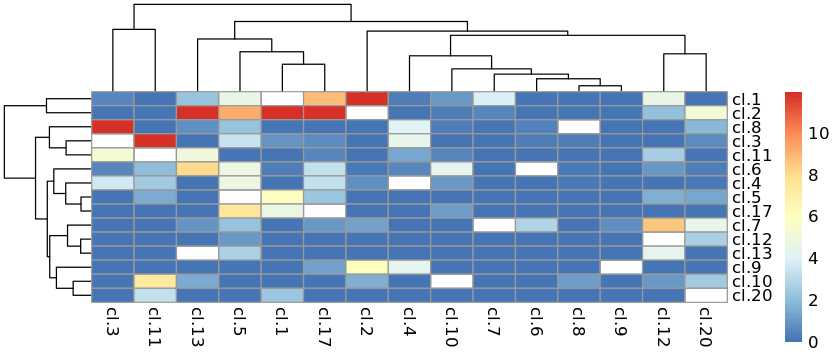

In [411]:
# As above, matrix
options(repr.plot.height=3)
plotlinkpv(ltr)

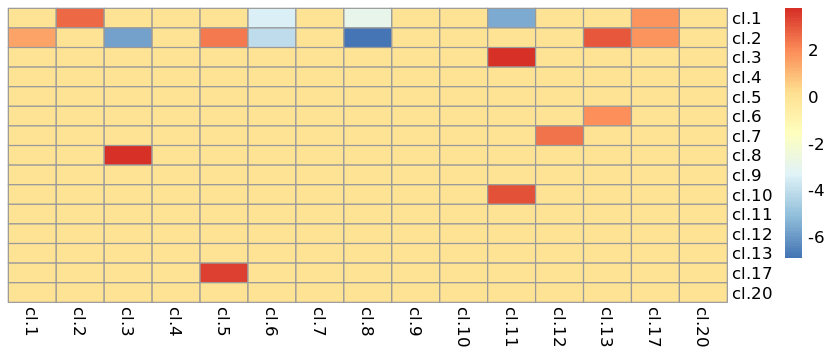

In [412]:
# Log2ratio number cells:background model
projenrichment(ltr)

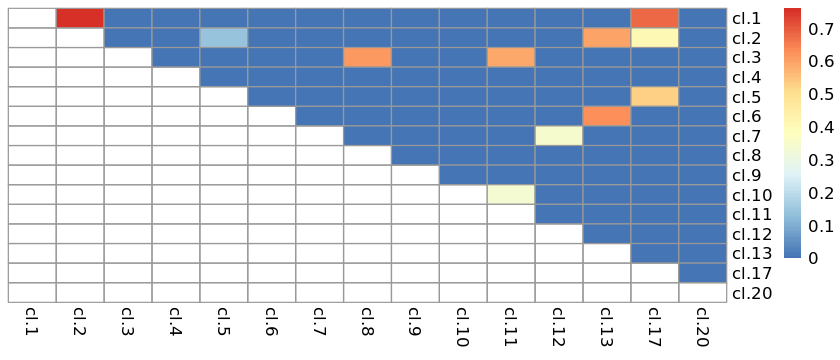

In [413]:
plotlinkscore(ltr)

#### Analysing lineage tree: Cluster / Cell designations

Quick overview of how specific cells fit into their cluster designations. Strong for early cluster numbers, weaker for late.

[1]  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22

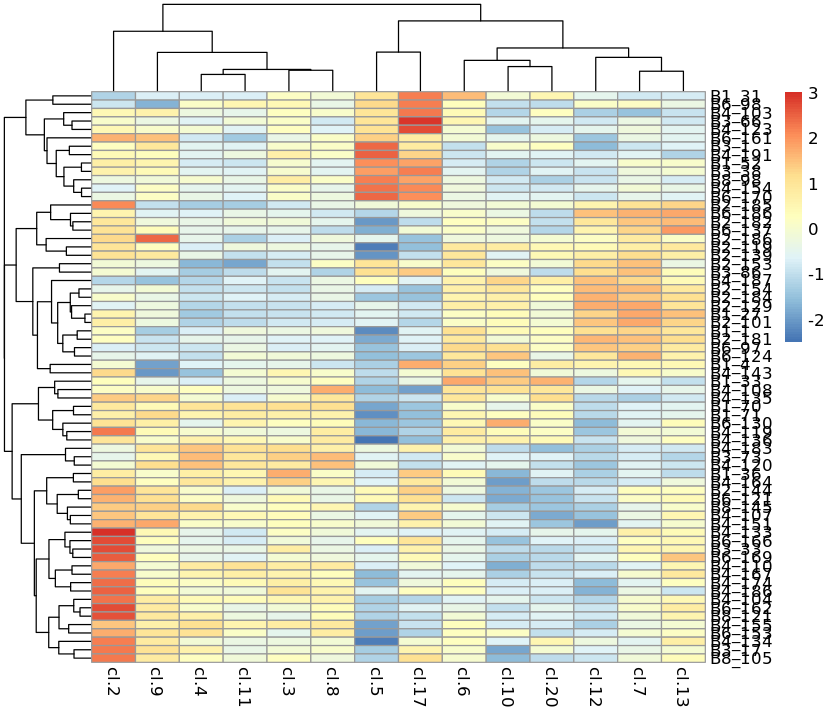

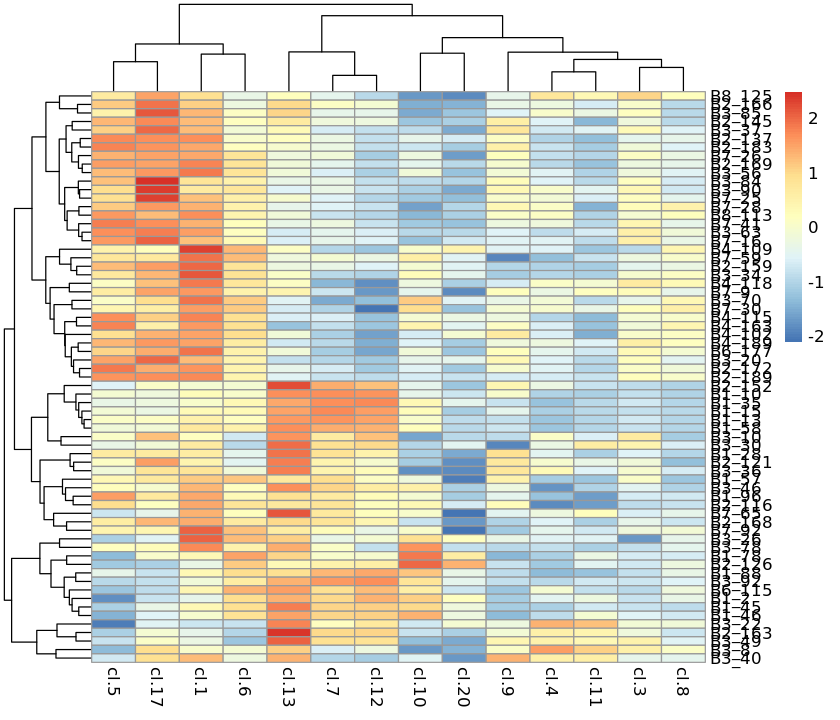

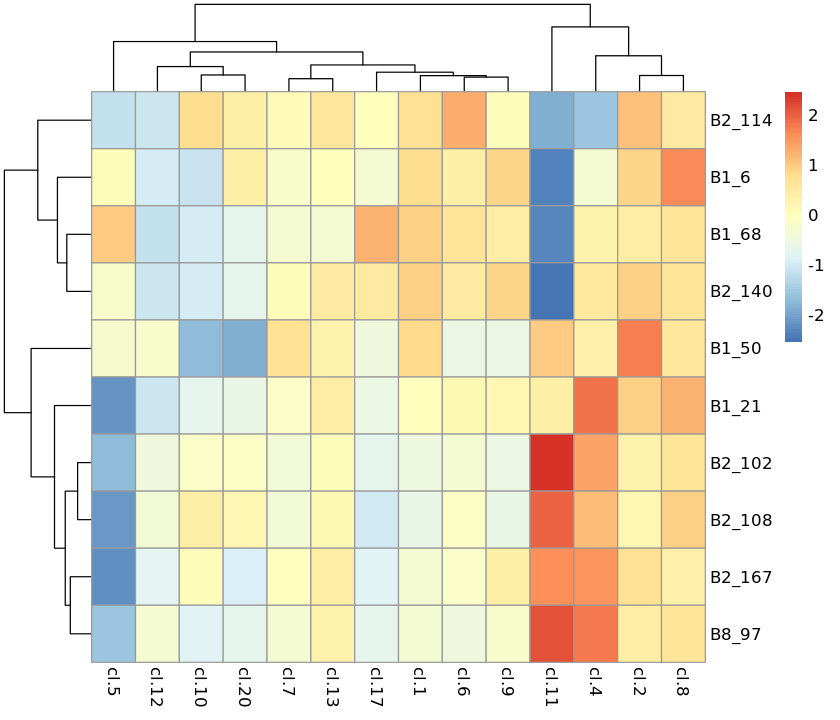

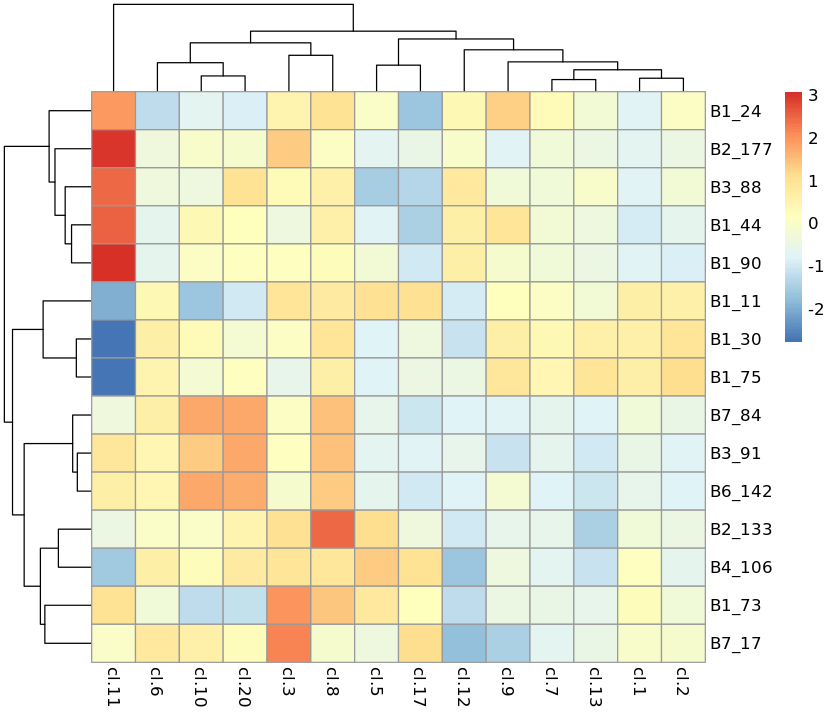

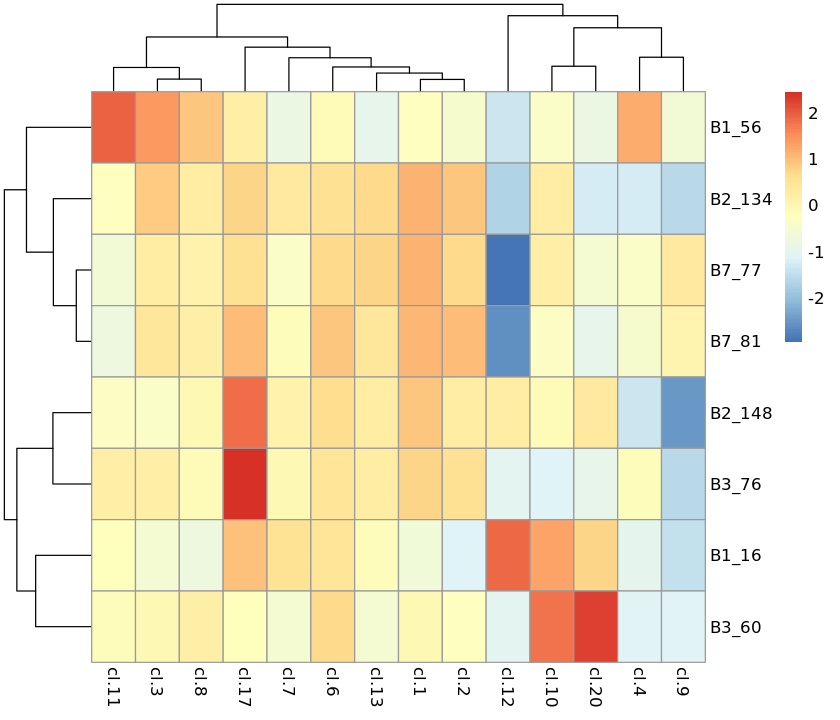

...

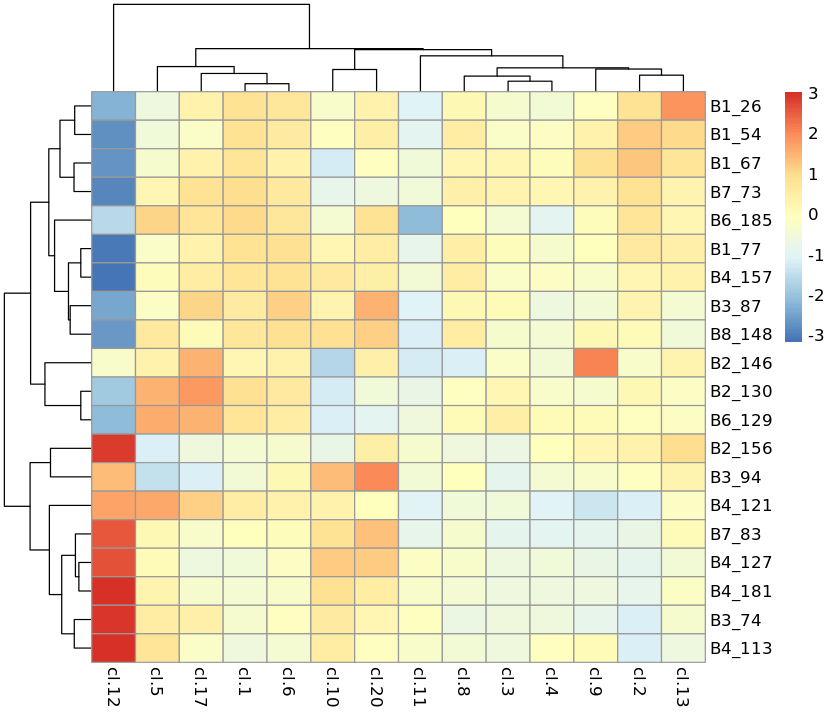

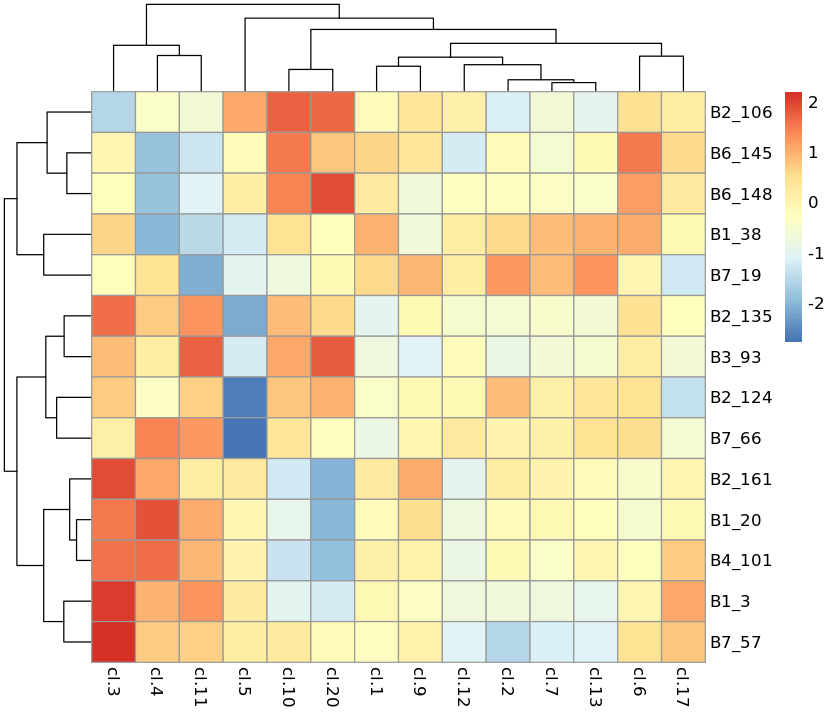

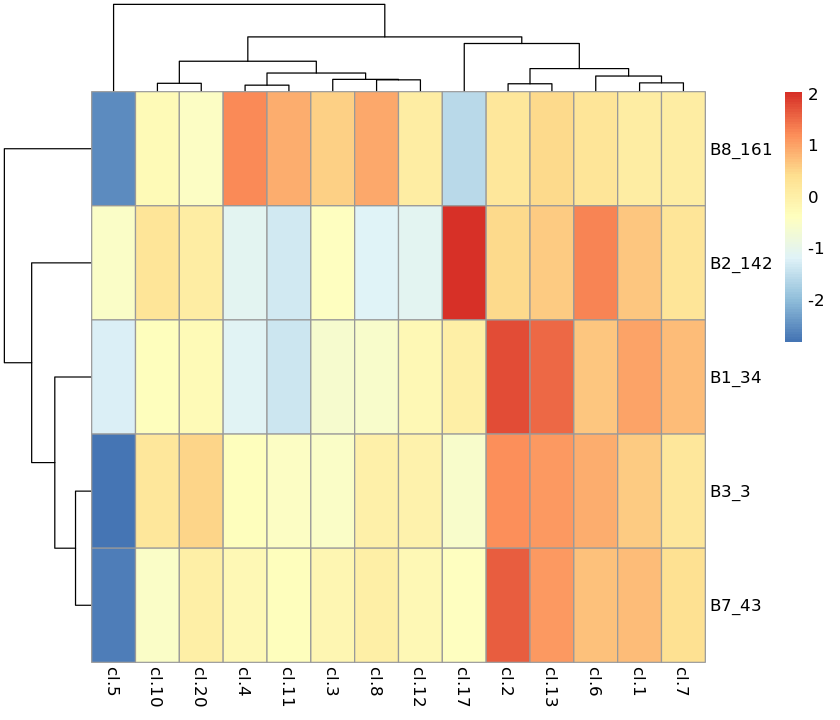

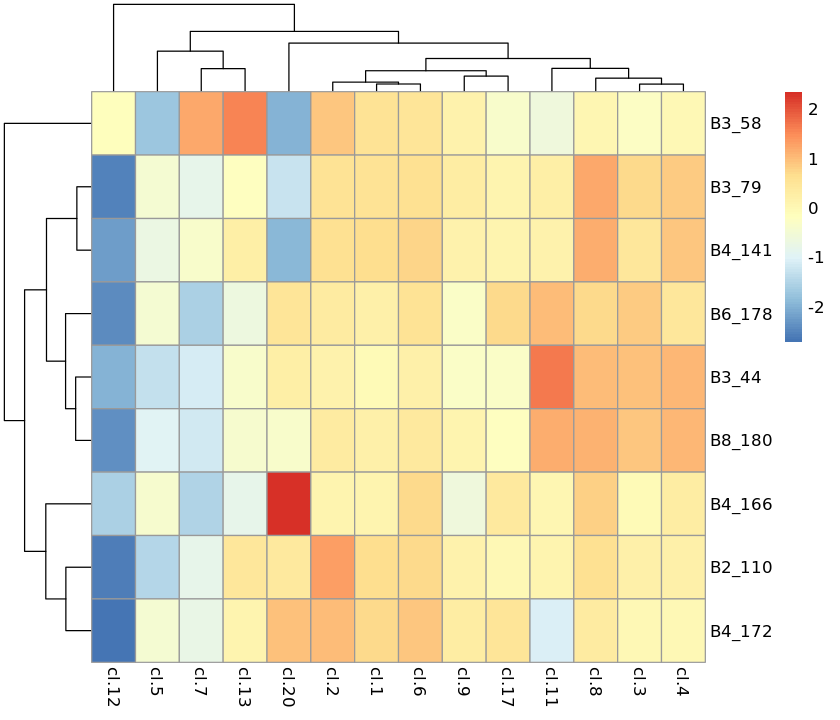

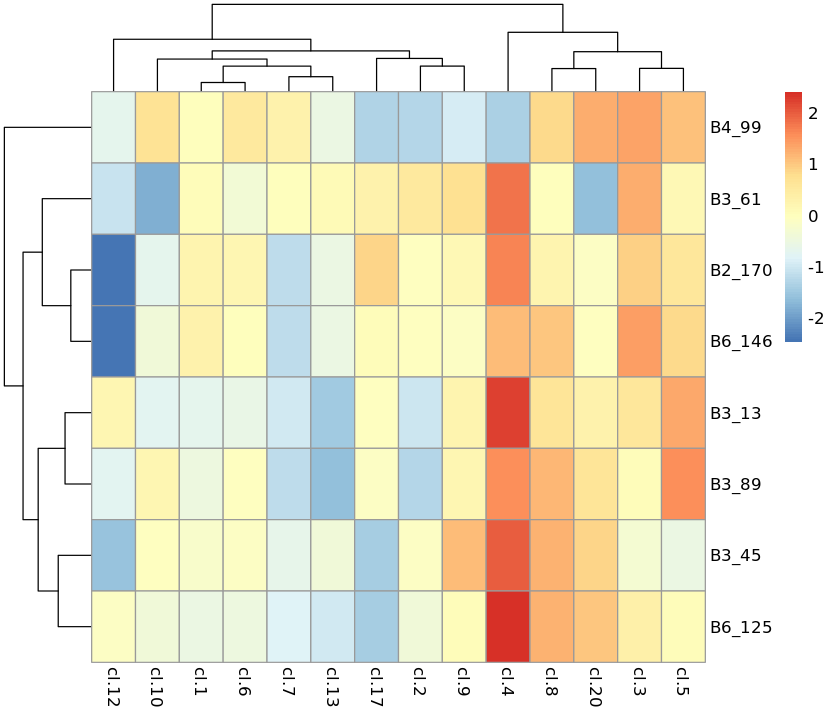

ERROR: Error in getproj(ltr, i = clnum): argument i has to be one of 1,2,3,4,5,6,7,8,9,10,11,12,13,17,20


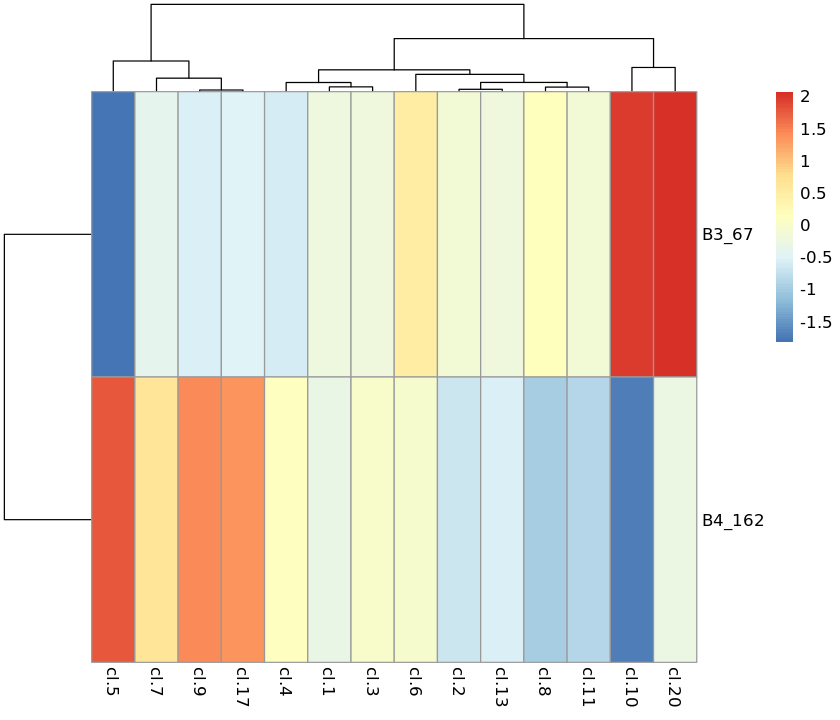

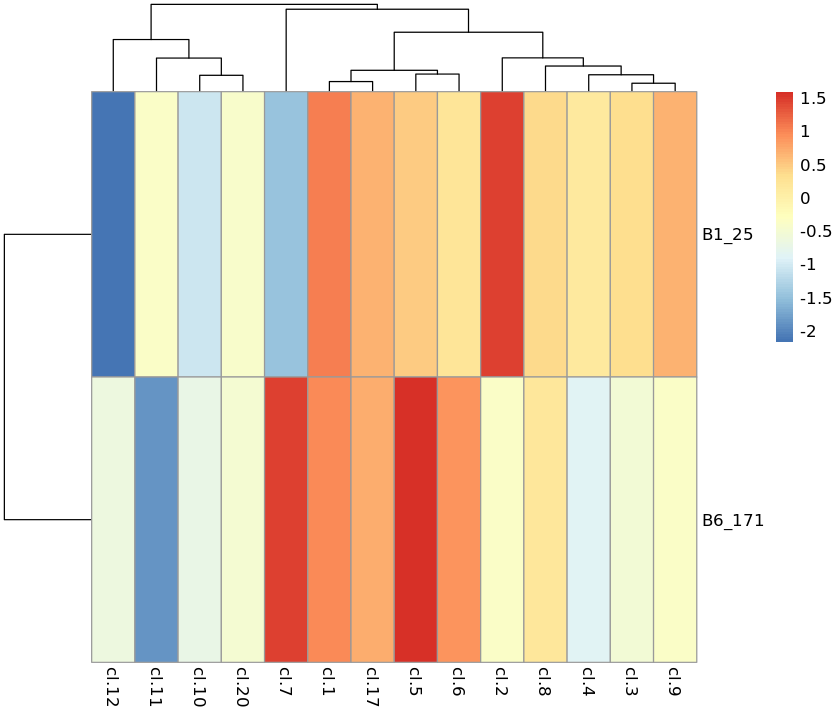

In [431]:
options(repr.plot.height = 6)
analyseClust <- function(clnum){
    x <- getproj(ltr,i=clnum)
    pheatmap(x$prz)
    #pheatmap(x$pr)
#    x <- branchcells(ltr,list("3.7"))
}

as.integer(sub("cl\\.([0-9]+)", "\\1", names(cdiff)))
x <- lapply(clust_nums, analyseClust)


## Examining Branches

In [562]:
# Methods
examineTop9InOut <- function(one_two_three){
    sects <- unlist(lapply(
        strsplit(one_two_three," → "), as.integer
    ))

    early <- paste(sort(sects[1:2]), collapse=".")
    later <- paste(sort(sects[2:3]), collapse=".")
    
    # insensitive to direction...
    x <- branchcells(ltr, list(later,early))

    lim <- 7
    
    par(mfrow=c(3,3))
    name_list <- names(x$diffgenes$z)[1:lim]
    
    if ("T" %in% names(x$diffgenes$z)){
        if (!("T" %in% name_list)){
            name_list <- c(name_list, "T")
        }
    }
    if ("Eomes" %in% names(x$diffgenes$z)){
        if (!("Eomes" %in% name_list)){
            name_list <- c(name_list, "Eomes")
        }
    }
    
    zz <- lapply(name_list, function(r){
        plotdiffgenes(x$diffgenes,r)
    })
    
    print(one_two_three)
    t(head(x$diffgenes$z,lim))
}

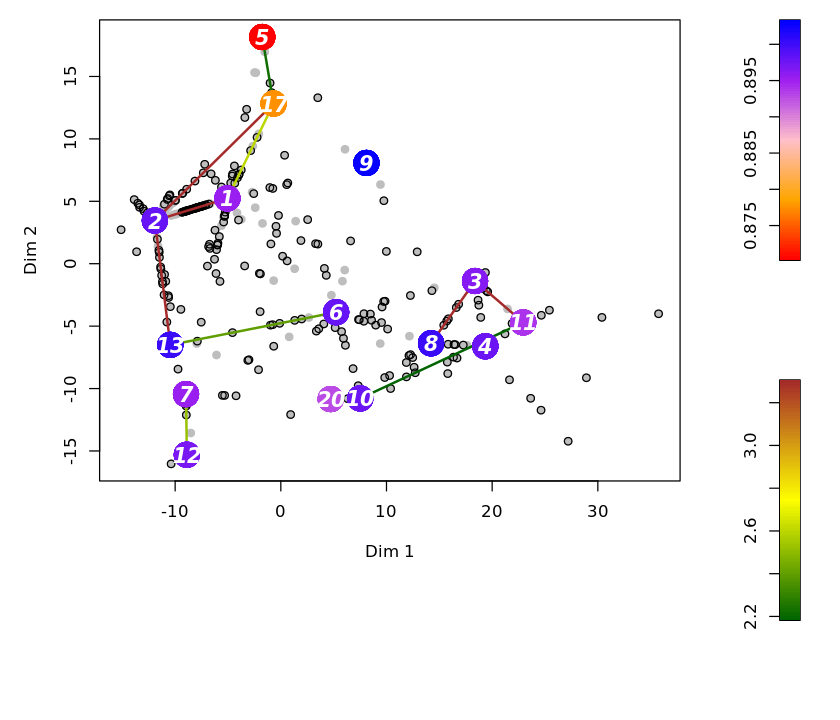

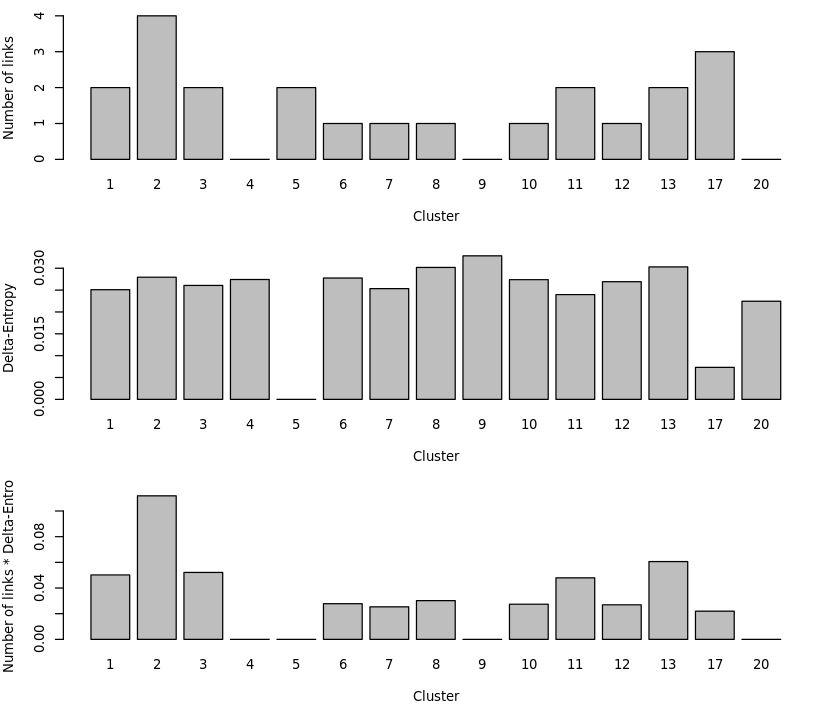

In [574]:
plottree(ltr,showCells=T,nmode=F,scthr=.3)
x <- compscore(ltr)
x <- plotscore(ltr)

Branches to examine:  
 
  | Strong | Moderate | Weak |
  | -----
  | 1 → 2 → 13 | 2 → 17 → 5 | 4 → 10 → 20 |
  | 1 → 2 → 17 | 1 → 17 → 5 |
  | 13 → 2 → 17 | 2 → 13 → 6 |
  |             | 8 → 3 → 11 |
  

### Strong branches

[1] "1 → 2 → 13"


Cnn2,Sltm,Kdm5a,Tpp2,Haus3,T,Mesp1
1.950005,1.839584,1.774125,1.690257,1.633329,1.620452,1.564845


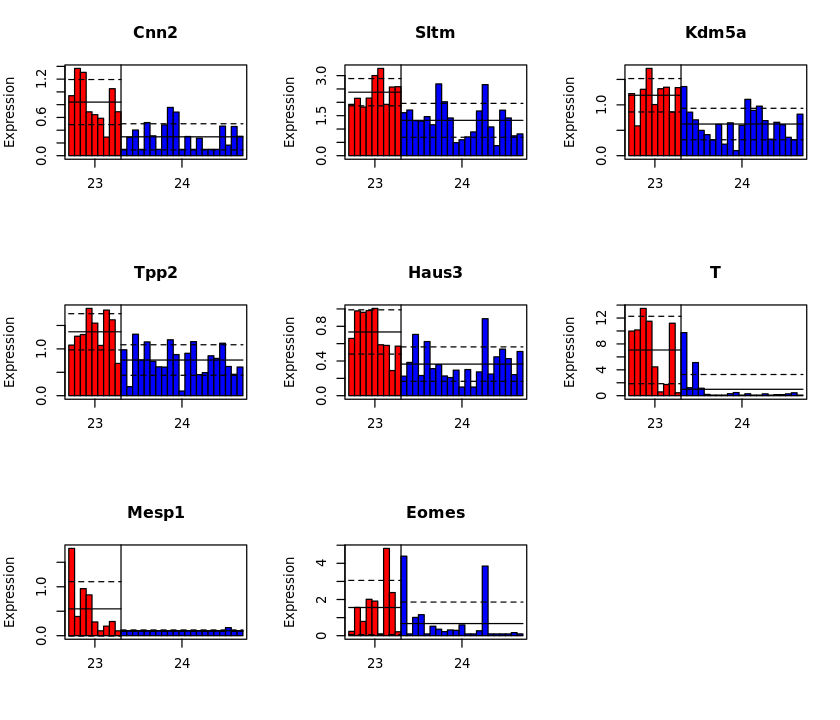

[1] "1 → 2 → 17"


Rps24,Rpl30,Rpl18a,Rps13,Rpl5,Otx2,Ran
1.556505,1.491975,1.472928,1.394318,1.357249,1.337906,1.328027


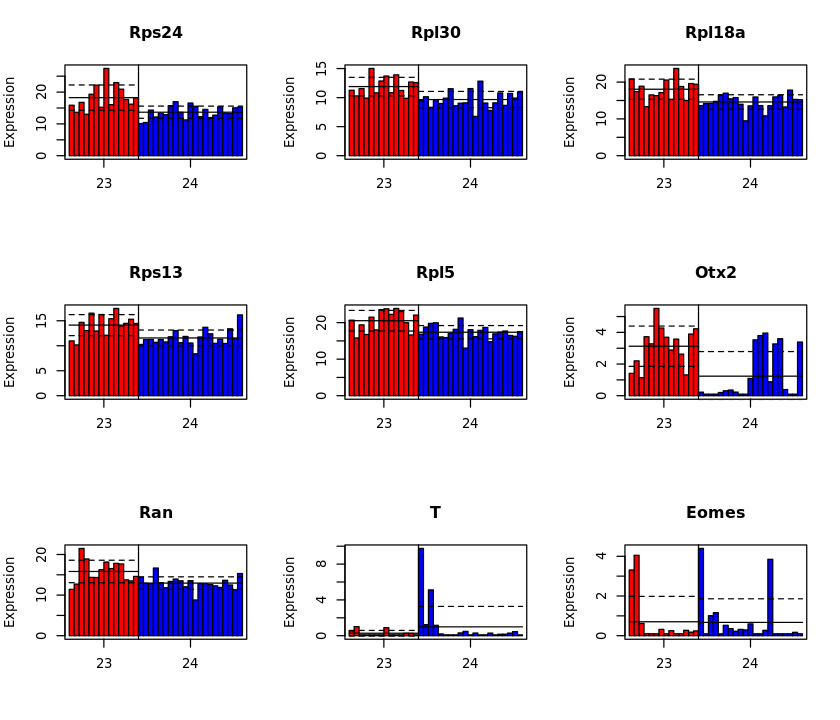

[1] "13 → 2 → 17"


Rpl30,Rps13,Cox7b,Rps24,Atp5g2,Phc1,0610007P14Rik
2.283927,2.1125,2.072632,2.031298,1.970042,1.861513,1.846103


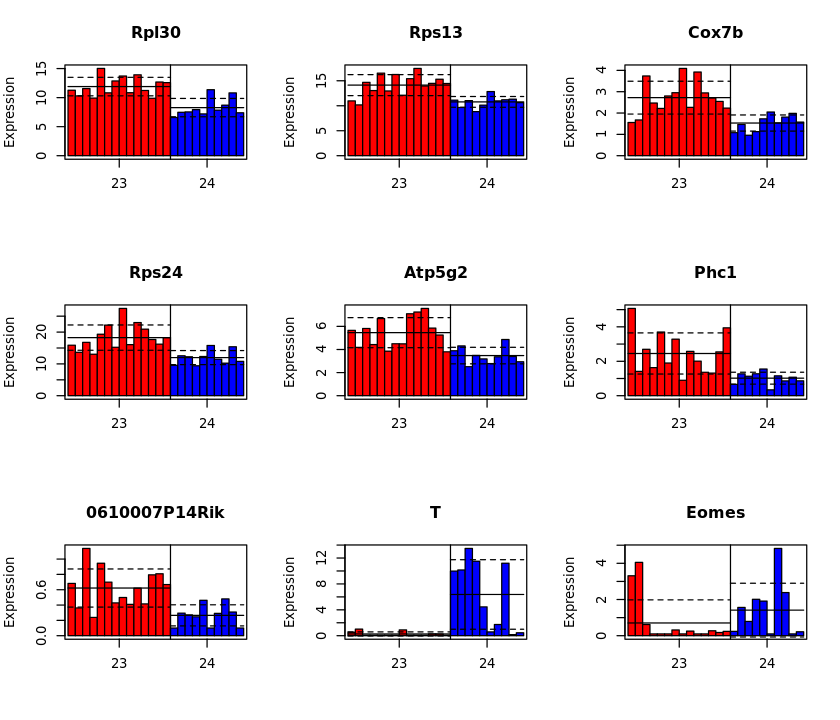

In [563]:
examineTop9InOut("1 → 2 → 13")
examineTop9InOut("1 → 2 → 17")
examineTop9InOut("13 → 2 → 17")

### Moderate branches

[1] "2 → 17 → 5"


Ndufb9,2810004N23Rik,Arxes2,Cisd2,Ddx18,Gtf2e2,Kars
14.10196,9.878239,9.878239,9.878239,9.878239,9.878239,9.878239


[1] "1 → 17 → 5"


Slc16a1,Lap3,Dynll1,Prps2,Seh1l,Clcn3,Ddx42
95.84089,23.62157,12.1838,8.988207,8.988207,7.611793,7.611793


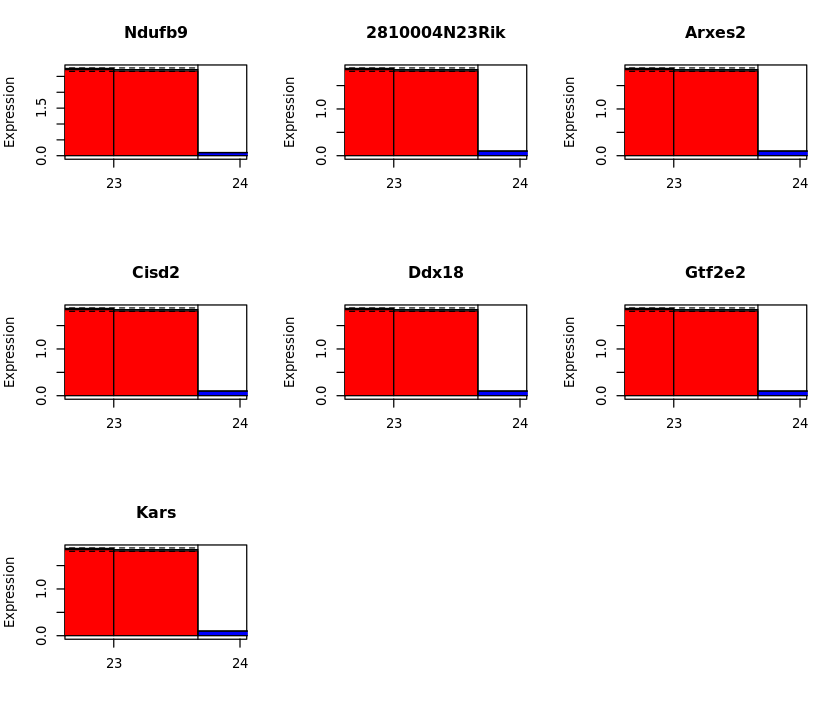

[1] "8 → 3 → 11"


Mphosph10,Cacybp,Gapvd1,Tomm20,Vapa,Cenpb,Tfrc
23.20154,20.37604,12.28814,11.1335,8.800614,8.259391,8.248227


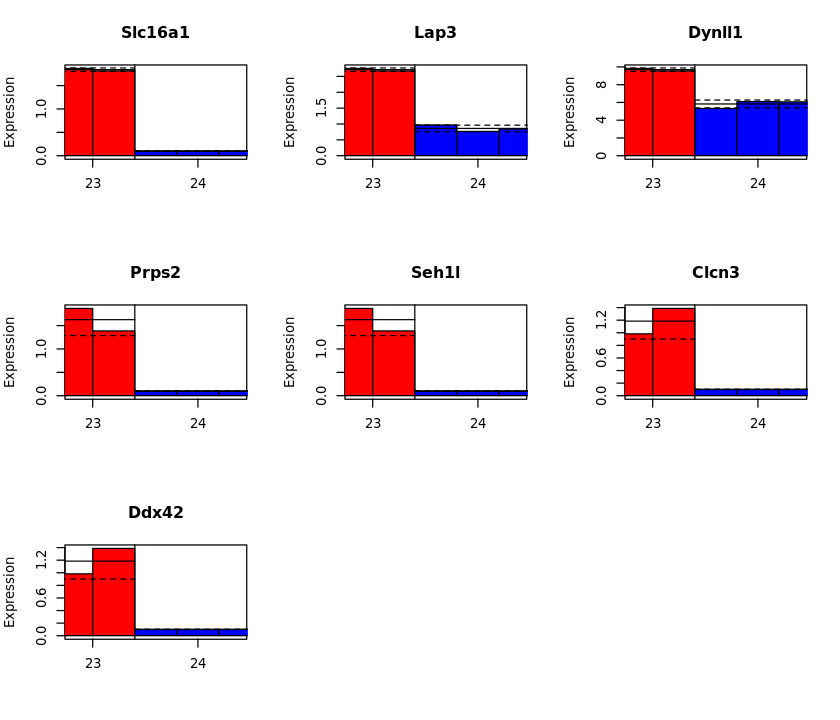

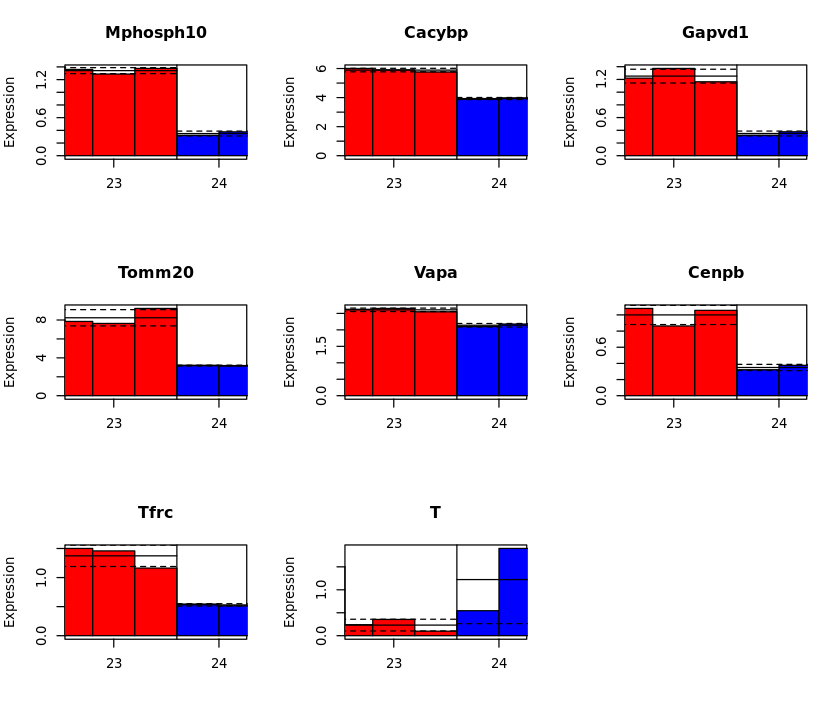

In [566]:
examineTop9InOut("2 → 17 → 5")
examineTop9InOut("1 → 17 → 5")
#examineTop9InOut("2 → 13 → 6") # fails...
examineTop9InOut("8 → 3 → 11")

In [572]:
#x <- branchcells(ltr, list("2.13","6.13"))

### Weak branches

[1] "4 → 10 → 20"


Phlda2,Cited1,Gm43549,Aldh1a2,Vim,Rbp1,Id3
3.212711,3.126568,3.042394,3.018957,2.908409,2.556375,2.431069


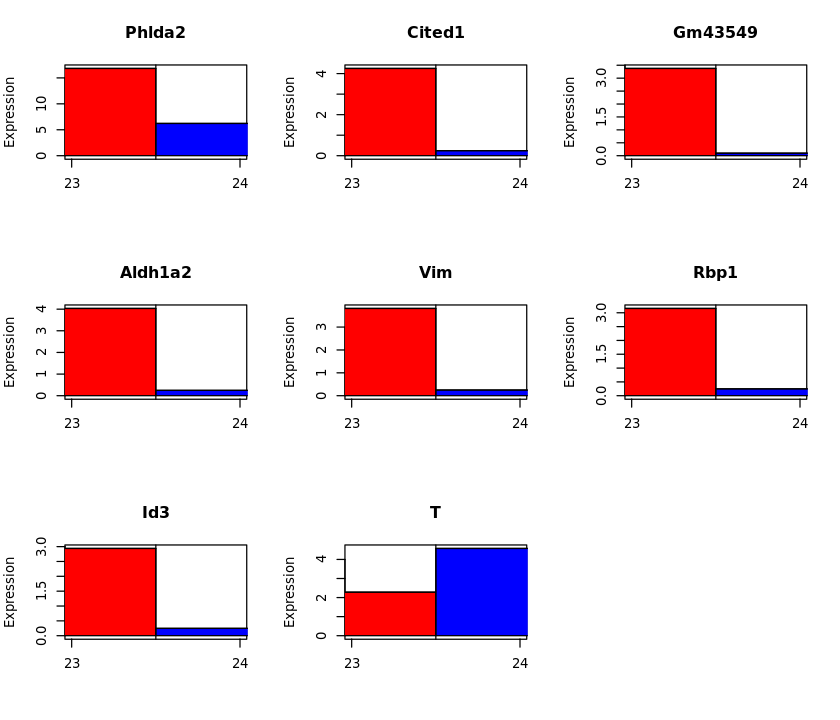

In [573]:
examineTop9InOut("4 → 10 → 20")

## Inspecting pseudo-temporal gene expression changes

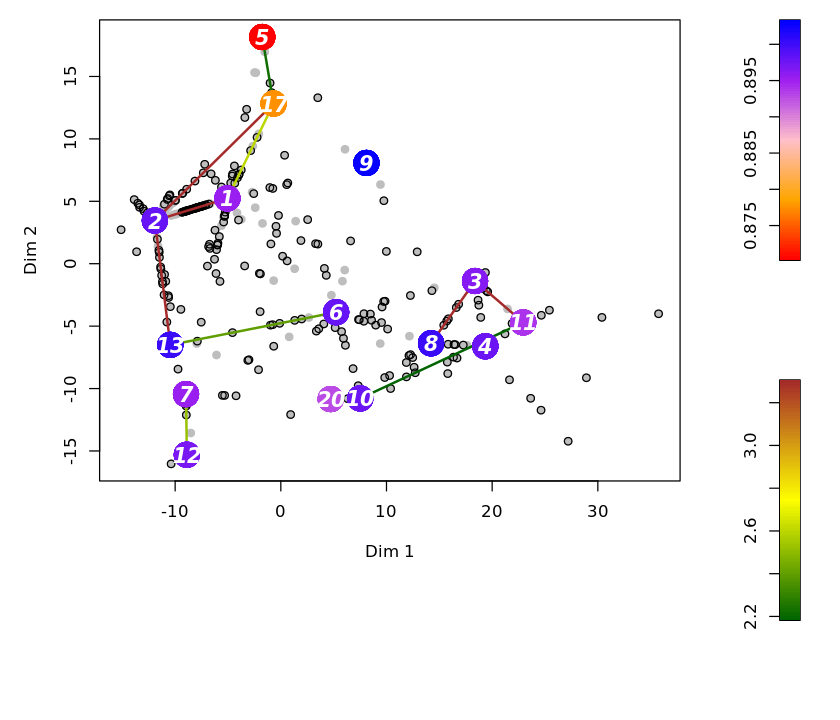

In [575]:
plottree(ltr,showCells=T,nmode=F,scthr=.3)

Genes with significant expression along a given trajectory are grouped by their expression profiles into modules within a z-score transformed SOM.

### How to inspect trajectories?

We could try to see how every possible gene is expressed along every single pathway, but this would be madness to sort. 

It is better to simply investigate how T and Eomes differ along each pathway since they are our main genes of interest.



#### Methods

In [705]:
# Method to see if T and Eomes diverge significantly 
# for a given trajectory


plotHeats <- function(ps, fcol){
    options(repr.plot.height = 5)
    plotheatmap(ps$nodes.z, xpart=y, xcol=fcol, ypart=unique(ps$nodes), xgrid=F, ygrid=T, xlab=F)
#    plotheatmap(
#        ps$all.z, xpart=y, xcol=fcol, ypart=ps$nodes, 
#        xgrid=F, ygrid=T, xlab=F)
#    plotheatmap(
#        ps$all.e, xpart=y, xcol=fcol, ypart=ps$nodes, 
#        xgrid=F, ygrid=T, xlab=F)
    plotheatmap(ps$all.b, xpart=y, xcol=fcol, ypart=ps$nodes, xgrid=F, ygrid=T, xlab=F)
}

findTandEomesNodes <- function(ps){
    # Find nodes where T and Eomes expressed
    t_node <- ps$nodes[names(ps$nodes) == "T"]
    e_node <- ps$nodes[names(ps$nodes) == "Eomes"]

    t_group_nodes <- names(ps$nodes[ps$nodes == t_node])
    e_group_nodes <- names(ps$nodes[ps$nodes == e_node])

    tab <- setNames(
        data.frame(
            rbind(
                c(t_node, length(t_group_nodes), paste(t_group_nodes, collapse=", ")),
                c(e_node, length(e_group_nodes), paste(e_group_nodes, collapse=", "))
            ),
            row.names = c("T","Eomes")
        ), c("Node", "Num", "Genes in same node")
    )
    
    return(list(
        table = tab,
        t_genes = t_group_nodes,
        e_genes = e_group_nodes
    ))    
}

plotTandE <- function(fs,y, fcol, n, t_nodes, e_nodes){
    #options(repr.plot.height = 8)
    par(mfrow=c(3,2))
    plotexpression(fs,y, t_nodes, n$f, k = 19, col = fcol, name="  T   group genes")
    plotexpression(fs,y, e_nodes, n$f, k = 19, col = fcol, name="Eomes group genes")
    plotexpression(fs,y, "T", n$f, k = 10, col = fcol)
    plotexpression(fs,y, "Eomes", n$f, k = 10, col = fcol)
}

doTrajectory <- function(trajectory){
    n <- cellsfromtree(ltr, trajectory)
    fs <- filterset(ltr@sc@ndata, n=n$f,  minexpr=2, minnumber=1)
    sld <- getsom(fs, nb=1000, k=5, locreg=T, alpha=.5)
    ps <- procsom(sld, corthr=.85, minsom=3)
    
    return(list("ps" = ps, "n" = n, "fs" = fs))
}


trajExplore <- function(trajectory){
    obj <- doTrajectory(trajectory)
    
    ps <- obj$ps
    n <- obj$n
    fs <- obj$fs
    
    t_and_e = findTandEomesNodes(ps)
    
    fcol = ltr@sc@fcol
    y = ltr@sc@cpart[n$f]

    plotHeats(ps, fcol)    

    #plot.new()
    par(mar=c(1,1,1,1))
    plotTandE(fs,y,fcol, n, t_and_e$t_genes, t_and_e$e_genes)
    return(t_and_e$table)
}




### Strong branches

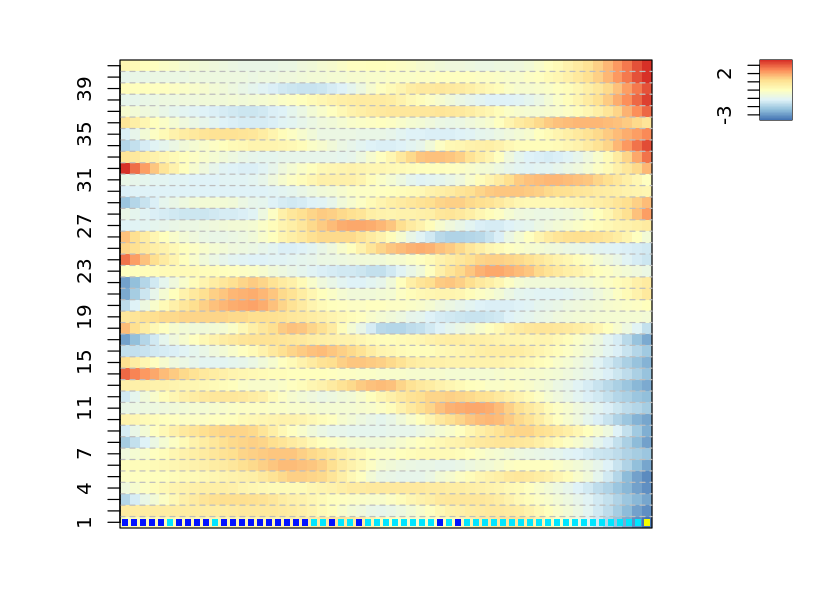

,Node,Num,Genes in same node
T,41,74,"Adgrl2, Adipor1, Ahctf1, Apc, Apln, Btbd1, Cachd1, Cbx2, Cdv3, Cited2, Cnih1, Eif2s3x, Eif4h, Eif5, Epha4, Hmgb3, Hnrnpr, Hspa5, Kcmf1, Mia3, Mns1, Mphosph8, Naa15, Nasp, Pmpcb, Ppp4r2, Prickle1, Prpf4, Sep15, Sept7, Sf3b1, Smarca4, Smc1a, Srsf11, Supt16, Tax1bp1, Tceal8, Tmed10, Trip12, Trnt1, Tsc22d1, Vcp, Wnk1, Ythdc1, Zfr, Ctsl, Dnajc5, Peg3, Pmaip1, Prtg, Thrap3, Fn1, Abi2, Crebbp, Ctbp2, Ddx3x, Dock11, Evx1, Frzb, Fst, Gas1, Hoxb1, Larp1, Meis2, Mixl1, Mtpn, Rab2a, Rai14, Rbbp7, Rlim, Rspo3, Sgk1, T, Tbx6"
Eomes,38,60,"1110004F10Rik, Atp6v1b2, Atp6v1g1, Azin1, Bcat1, Blmh, Braf, Cacybp, Cct5, Cct7, Csnk1a1, Ctdsp2, Cul3, Ddx17, Ddx21, Ddx27, Dnajc2, Dpf2, Eef2, Egln1, Eif1a, Eif2ak1, Eif3l, Eif5b, Elp3, Eomes, Fgf4, Glul, Gm16286, Gm38312, Ifitm1, Itgb5, Ly6e, Mapk1ip1l, Mtf2, Nolc1, Oat, Pafah1b1, Pdha1, Pgk1, Ppp2r1b, Prrc2b, Rbm3, Rps6ka6, Rps9, Rrp1, Sall3, Scd2, Sema6a, Setd8, Slc25a1, Sltm, Tcerg1, Tcf7l2, Tead2, Tomm20, Tpm4, Wdfy1, Zc3h15, Zfp322a"


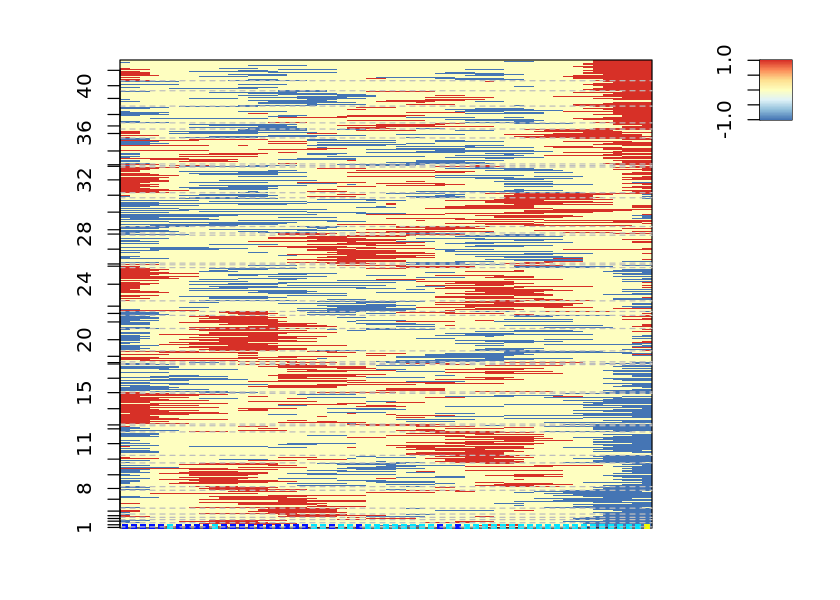

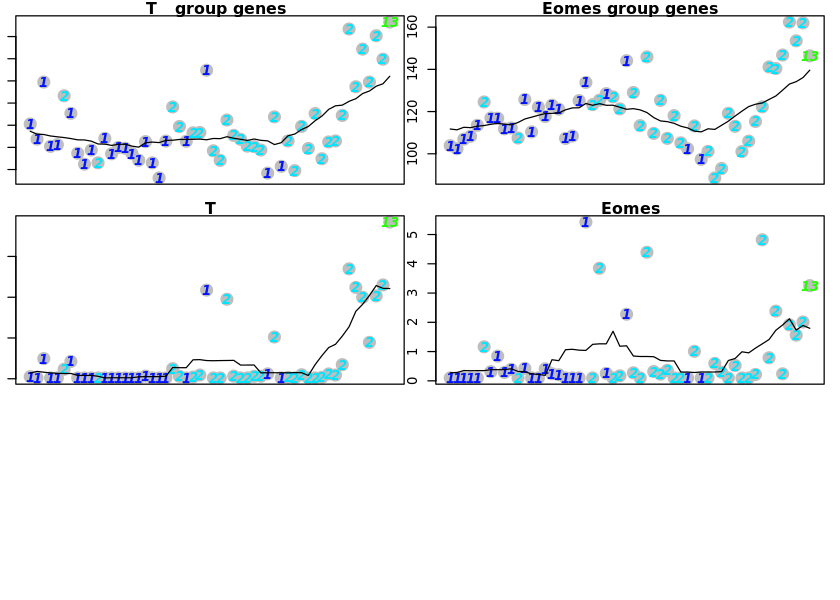

In [706]:
trajExplore(c(1,2,13))

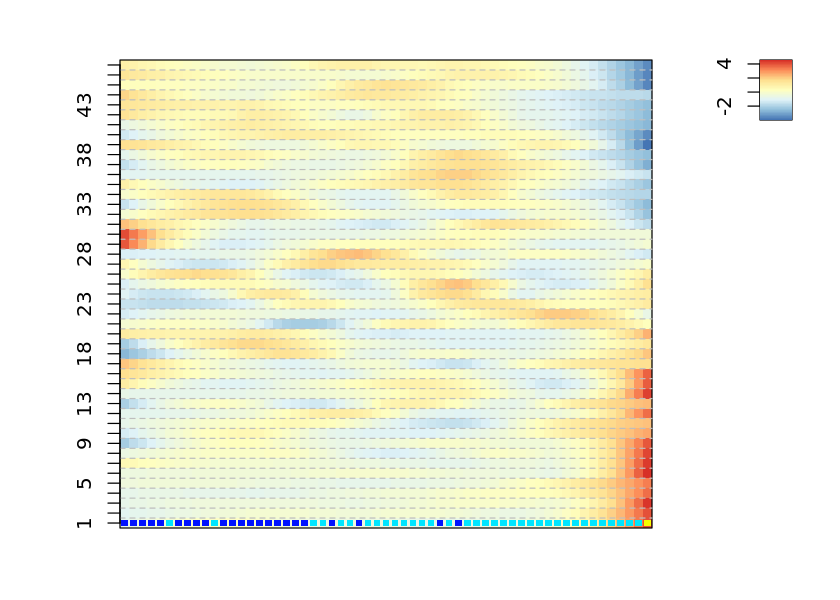

,Node,Num,Genes in same node
T,28,95,"Aars, Abi2, Acat2, Ahsa1, Aldh9a1, Anapc5, Arf1, Atp5b, Atp5g3, Basp1, Cacybp, Caprin1, Car2, Cbx2, Ccnt1, Cct3, Cct5, Ctdsp2, Cyb5a, Cyp26a1, Ddx27, Dgkk, Dnaja1, Dnajc8, Eftud2, Eif3e, Eif4a3, Eomes, Fgf4, Fgf5, Fn1, Frzb, Galk1, Gas1, Gnai2, Golga4, Got2, Gpbp1, Hmga1-rs1, Hras, Hypk, Idh3g, Igf2bp3, Igfbp2, Ilf2, Impdh2, Ireb2, Isyna1, Maea, Map2k2, Mllt10, Morf4l1, Mrfap1, Nol7, Nsa2, Nsmce4a, Nudcd2, Nup62, Orc3, Pdha1, Pgk1, Ppp1cc, Ppp1r14b, Prpf31, Psmc1, Psmd8, Rapgef1, Rep15, Rspo3, Rybp, Sde2, Sema6a, Sesn3, Setd8, Slc16a3, Slc3a2, Smc4, Smc6, Sod1, Sox9, Spop, Srpk1, Srsf2, T, Tcerg1, Tdgf1, Tead2, Tnks2, Trp53i11, Tti1, Ube2n, Ube2r2, Uck2, Uqcrc2, Zranb2"
Eomes,28,95,"Aars, Abi2, Acat2, Ahsa1, Aldh9a1, Anapc5, Arf1, Atp5b, Atp5g3, Basp1, Cacybp, Caprin1, Car2, Cbx2, Ccnt1, Cct3, Cct5, Ctdsp2, Cyb5a, Cyp26a1, Ddx27, Dgkk, Dnaja1, Dnajc8, Eftud2, Eif3e, Eif4a3, Eomes, Fgf4, Fgf5, Fn1, Frzb, Galk1, Gas1, Gnai2, Golga4, Got2, Gpbp1, Hmga1-rs1, Hras, Hypk, Idh3g, Igf2bp3, Igfbp2, Ilf2, Impdh2, Ireb2, Isyna1, Maea, Map2k2, Mllt10, Morf4l1, Mrfap1, Nol7, Nsa2, Nsmce4a, Nudcd2, Nup62, Orc3, Pdha1, Pgk1, Ppp1cc, Ppp1r14b, Prpf31, Psmc1, Psmd8, Rapgef1, Rep15, Rspo3, Rybp, Sde2, Sema6a, Sesn3, Setd8, Slc16a3, Slc3a2, Smc4, Smc6, Sod1, Sox9, Spop, Srpk1, Srsf2, T, Tcerg1, Tdgf1, Tead2, Tnks2, Trp53i11, Tti1, Ube2n, Ube2r2, Uck2, Uqcrc2, Zranb2"


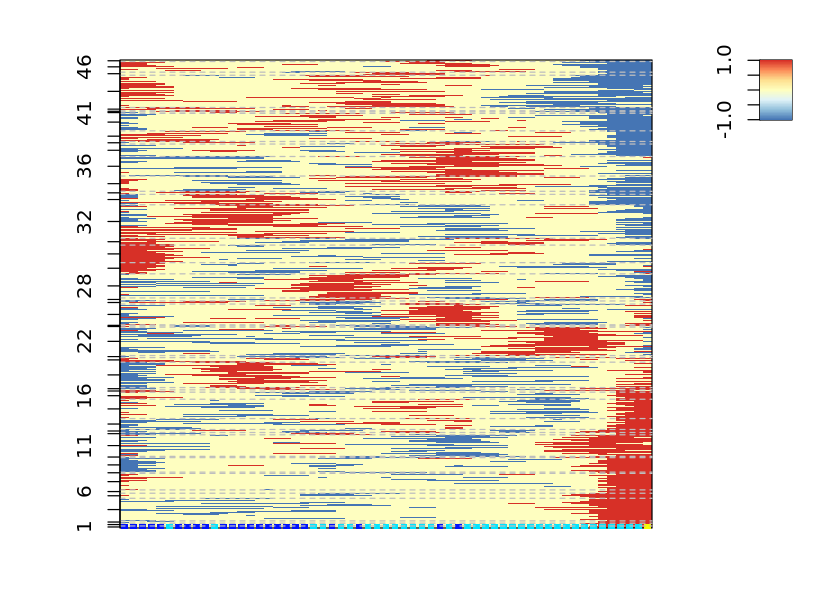

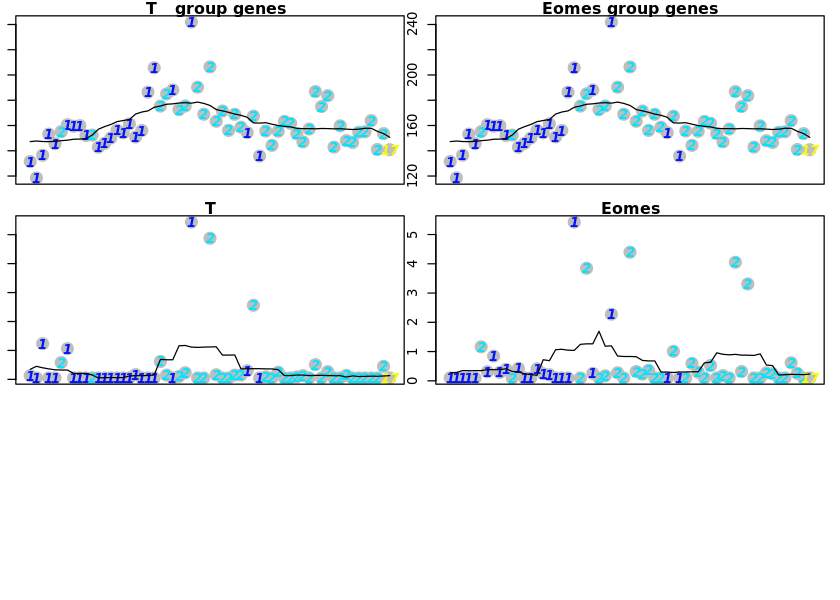

In [707]:
trajExplore(c(1,2,17))

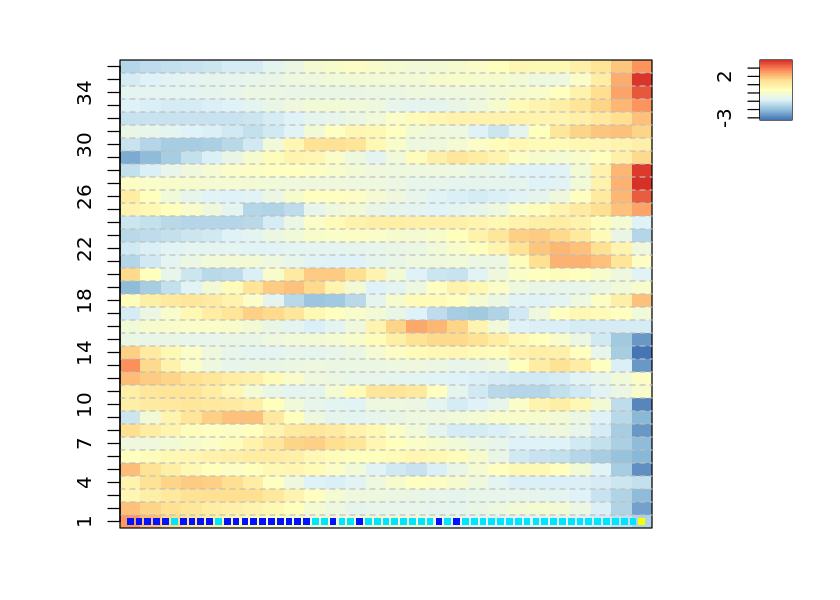

,Node,Num,Genes in same node
T,12,104,"Abcf1, Acp1, Amot, Amotl2, Ankrd11, Anp32b, Arid2, Bclaf1, Ccnd2, Cdc14b, Cebpz, Cited2, Ckap4, Ctcf, Cul3, Cxx1a|Cxx1b, Ddx24, Ddx3x, Dnajb6, Dock11, Dtl, Eif2s3x, Emb, Enah, Epha4, Eprs, Fn1, Frzb, Galnt1, Gja1, Gtf2i, Gusb, Hells, Hmga2, Hmgb3, Hnrnph1, Hnrnpr, Hoxb1, Kif5b, Lamb1, Lig1, Marcksl1, Mcm3, Meis2, Mixl1, Mphosph10, Mphosph8, Mrfap1, Ndufaf4, Nol8, Papola, Pdgfra, Pdha1, Pds5a, Peg3, Pmaip1, Pnn, Polr2m, Prpf4b, Prtg, Psmd1, Purb, Rbbp6, Rdx, Rps6ka6, Rrm2, Serp1, Setd5, Sf3b1, Sfxn1, Slbp, Smarcc1, Smu1, Snx3, Snx5, Snx6, Sox11, Srsf11, Srsf2, Srsf5, Strap, Stt3b, T, Tab2, Tceal8, Tcerg1, Tmed10, Tmem165, Tmem234, Top1, Tpr, Trip12, Tsc22d1, Ube2d2a, Ubxn4, Uhrf2, Ung, Usp10, Whsc1, Ythdc1, Zfp292, Zfp322a, Zfp644, Zranb2"
Eomes,4,50,"Abi2, Aldh9a1, Aldoa, Apoe, Atp5a1, Atp6v1b2, Bnip3l, Braf, Cct2, Cct7, Csnk1a1, Ctbp1, Ctsl, Dars, Dnajc2, Eef2, Egln1, Eif4b, Eif5b, Eomes, Evx1, Gm3839, Got2, Gpi1, Grsf1, Hax1, Helz, Lef1, Lsm14a, Myo10, Nucb1, Nup205, Ptbp1, Ptp4a2, Pum1, Rab2a, Rbbp7, Rspo3, Sdha, Sema6a, Smc2, Smc3, Smc6, Tcf7l2, Tnks2, Uba1, Usp7, Vps35, Xrn2, Ybx1"


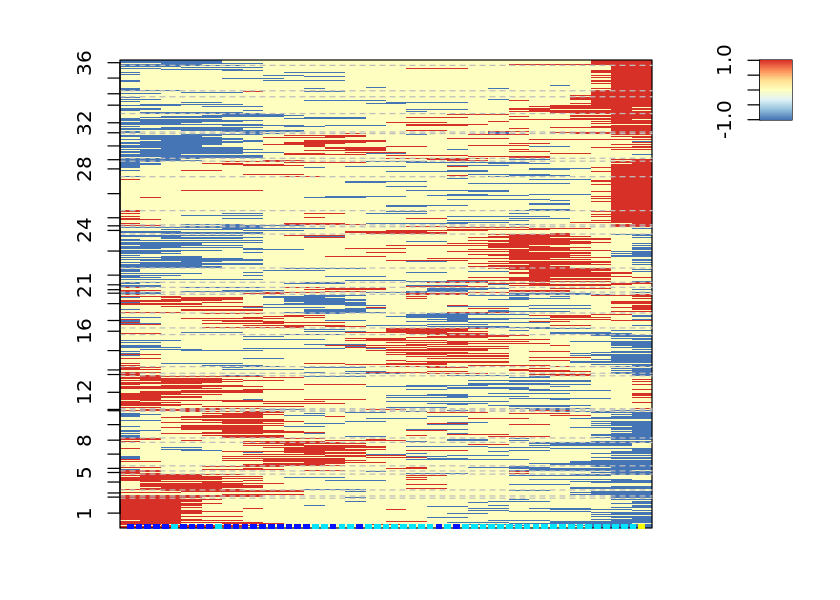

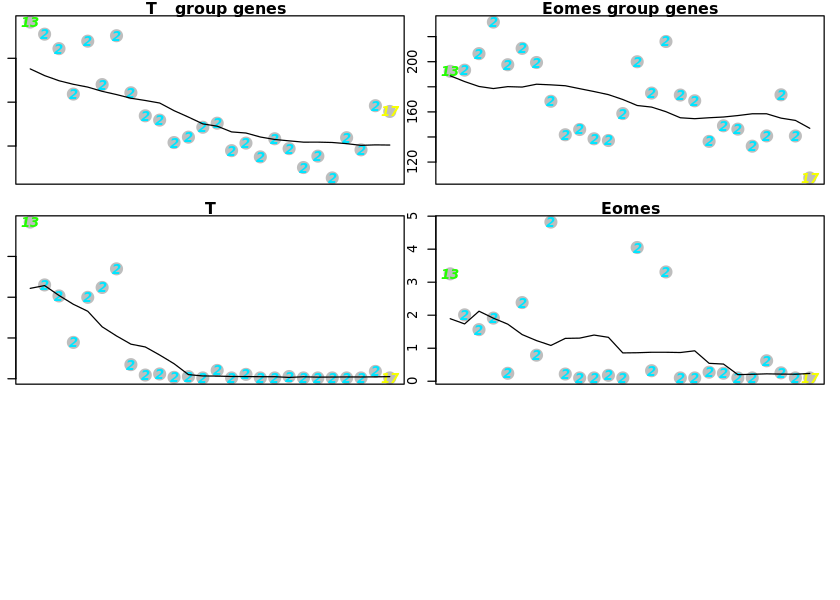

In [708]:
trajExplore(c(13, 2, 17))

### Moderate branches

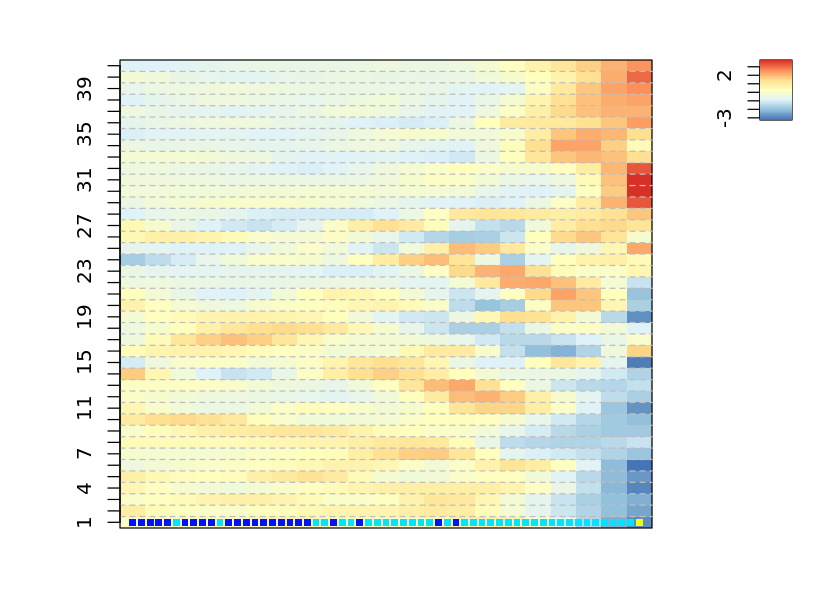

,Node,Num,Genes in same node
T,31,70,"Abhd17b, Ahctf1, Amotl2, Api5, Arl6ip1, Asnsd1, Atf1, Bbip1, BC023829, Bfar, Birc5, Bmi1, Caap1, Ccng1, Cd2ap, Cenpw, Chd6, Csnk1g3, Cst3, Ctnna1, Cul3, Dhx36, Dnajc9, Dnm1l, Eny2, Espl1, H3f3b, Higd2a, Hoxa1, Ifitm3, Klhl24, Lbr, Lgalsl, Lman1, Lrp6, Mcm6, Mettl7a3, Mgea5, Nck1, Ndufc1, Nubp1, Otud4, Parl, Pcgf5, Pdcd5, Pomp, Ppp1cb, Prim1, Psma5, Rab11b, Rad21, Rala, Rpl21, Rtn4, Shfm1, Slc38a4, Spc25, Spcs1, Stt3b, Suv420h1, Suz12, T, Tacc3, Thoc3, Tmeff1, Ubr5, Uqcrq, Xpot, Zfand6, Zmat3"
Eomes,17,116,"Abi2, Aco2, Akap9, Apela, Apoe, Arhgef2, Atp6v1b2, Atxn2l, Aurka, AW549877, Basp1, Bnip3l, Brd3, Bub1, Car2, Car4, Cbl, Ccna2, Cct2, Cdc123, Cebpz, Clic4, Cops4, Csnk1d, Csnk2b, Dad1, Ddx17, Dnajc8, Dtx3, Ebna1bp2, Eif3e, Eif4b, Eif5, Eif5b, Eomes, Fbl, Fbxo5, Fiz1, Fst, Glg1, Glyr1, Gmps, Gnpat, Golga4, Got2, Gpd2, Gtf2f1, Hdlbp, Helz, Hprt, Igf1r, Incenp, Ktn1, L1td1, Lamp1, Larp1, Larp7, Lig1, Luc7l3, Mesdc2, Mis18bp1, Mkrn1, Mphosph8, Msh2, Naa15, Nnat, Nol7, Nop58, Npepps, Nudt21, Ola1, Pfdn6, Pnisr, Pnrc1, Ppat, Pphln1, Ppig, Ppp1cc, Ppp1r15b, Ppp2ca, Prpf38b, Psme3, Rbm25, Rbpms, Rfc1, Rhoa, Rpl3, Scaf11, Sf3b1, Smc3, Snhg14, Snhg5, Sp1, Strbp, Swi5, Syce2, Tars, Tcea1, Tcerg1, Tdgf1, Tdh, Tmbim6, Tmem11, Trh, Trp53, Ubap2l, Ube2r2, Ubqln1, Uhrf2, Upf3b, Wapl, Xrn2, Yap1, Ybx1, Zfp106, Zmynd8"


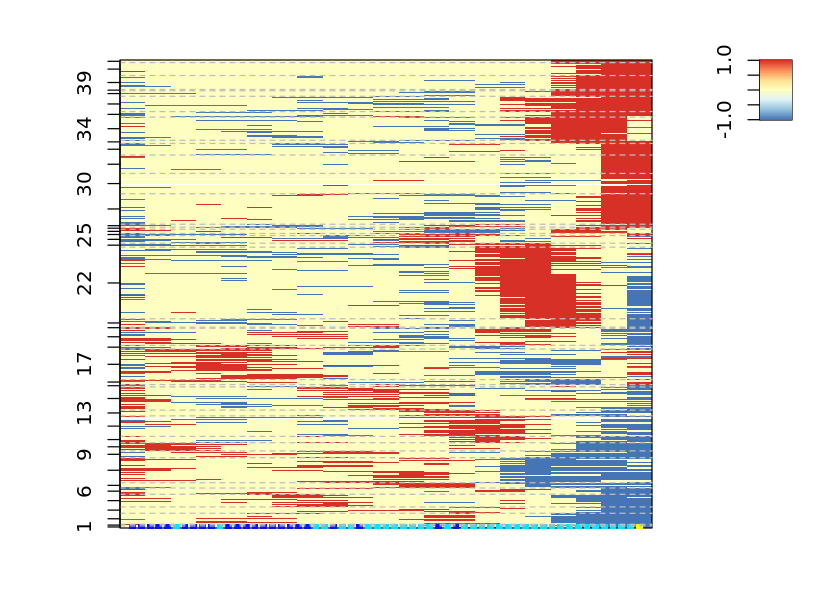

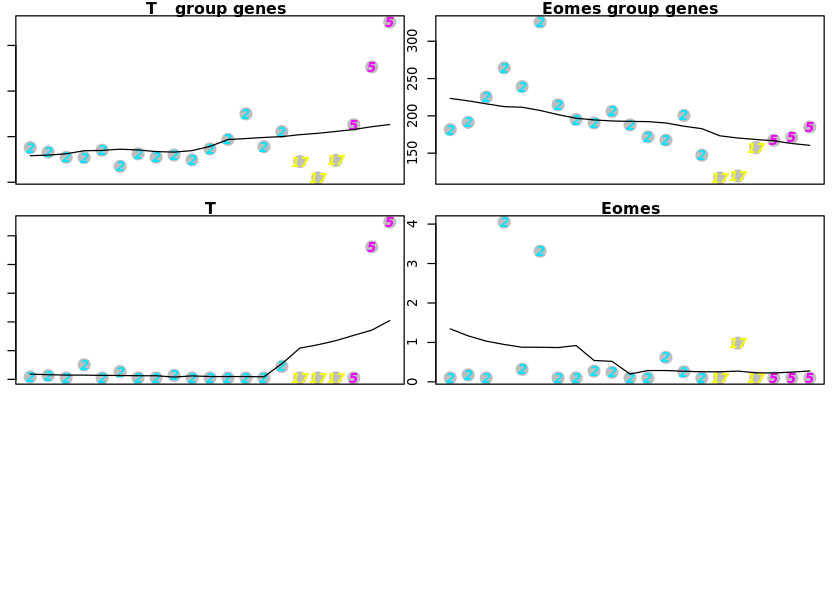

In [709]:
trajExplore(c(2, 17, 5))

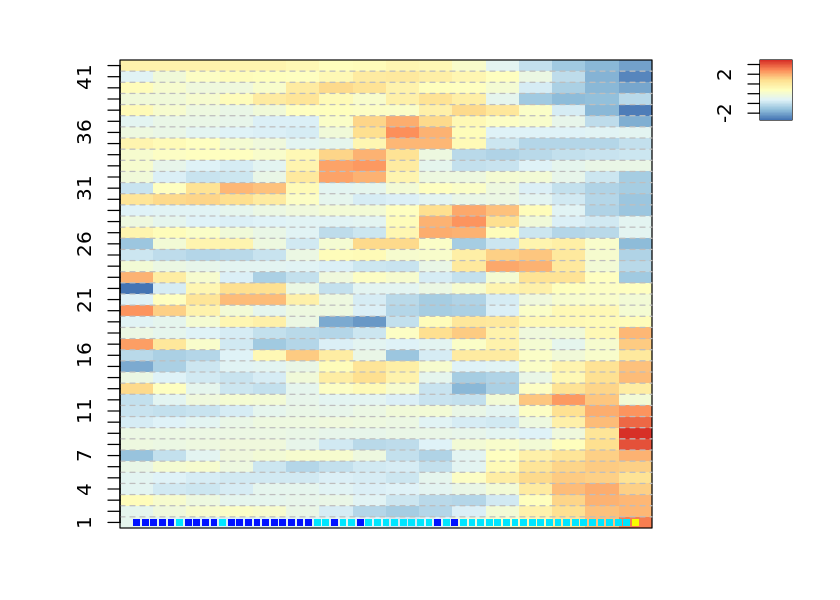

,Node,Num,Genes in same node
T,21,198,"Actn1, Appbp2, Arl6ip4, Asf1a, Atp6v1b2, Atxn7l3b, Bub1, Cct6a, Clic4, Cops7a, Csnk1d, Cul2, Ddx17, Ddx19a, Dennd5b, Ehmt1, Eif4a2, Ghitm, Gja1, Glud1, Gmnn, Gnl3, Grb10, Hcfc1, Helz, Hmga2, Hprt, Iars, Larp1, Mapk1, Mrpl35, Msh6, Mta2, Mtmr4, Ncor1, Ola1, Parn, Pbx1, Pdia3, Polr1d, Puf60, Rac1, Rad23b, Rbm25, Rtf1, Scd2, Seh1l, Sf3b4, Snrpn, Srsf2, Strap, Suz12, Tmed10, Topbp1, Trp53, Ubqln1, Ubr5, Wdr3, Wdr5, Wnk1, Yap1, 1110038B12Rik, 2810474O19Rik, Abce1, Armc1, Arpc5l, Atf4, Atp5g1, Atp6v1a, Bclaf1, Cd63, Cdc123, Cdv3, Chchd1, Clta, Crebbp, Csnk1a1, Cwf19l1, Cxxc5, Dact1, Drap1, Dstn, Eif3l, Eif4a3, Eif5, Etv1, Exosc2, Exosc7, Fam96b, Farsb, Fgf3, Fst, Gins2, Gltscr2, Hectd1, Hes7, Igfbp4, Ilf3, Jph4, Kdelr2, Kdm5a, Kpna6, Ktn1, Lef1, Mapre1, Mixl1, Ndufa10, Nedd8, Nrd1, Peg3, Pgam1, Pih1d1, Plekhg2, Pmaip1, Pphln1, Ppp1r12a, Psap, Psmc2, Ptp4a2, Purb, Rars, Rbm5, Rbp1, Rc3h2, Rpl7l1, Sept2, Setd5, Smc2, Smc3, Smc4, Smg1, Smu1, Spag5, Srp14, Srp68, Srrt, Tbcb, Tln1, Tmbim6, Tmed2, Tpm4, Tsen34, Txnl1, U2surp, Ubald1, Ubap2l, Ubr4, Vapa, Vps25, Ypel3, Ythdf2, Zfp217, Zmynd8, 2010107E04Rik, Akirin2, Capns1, Cbx3, Ccnb1, Cenpf, Clint1, Cnot8, Csnk2b, Cth, Cxx1a|Cxx1b, Dusp6, Fbl, Fkbp3, Got2, Gpc3, Hoxb1, Immp1l, Kif11, Laptm4b, M6pr, Mga, Ndufa12, Ppa1, Prkra, Psma4, Pum1, Rab11b, Rabggtb, Rai14, Rasl11a, Rnf20, Rnf34, Samhd1, Smpd4, Snx6, Stmn1, T, Tab2, Tbl1x, Tle3, Top2a, Ube2b, Wdr36, Wtap"
Eomes,31,94,"2810004N23Rik, Anapc11, Anp32a, Atad3a, Atp5e, Bivm, Blmh, Casp8ap2, Ccnf, Ccni, Cct5, Ctdspl2, Denr, Dnajb1, Dnajc7, Dnajc8, Ecd, Emc7, Esf1, Frzb, Gcn1l1, Hnrnpc, Hsp90ab1, Hspbp1, Immt, Lage3, Map1s, Map2k2, Mcm2, Mcm7, Med28, Mrps17, Mrps22, Nip7, Nudt14, Pafah1b1, Pdgfra, Phgdh, Phlda2, Pkm, Plp2, Pmf1, Ppme1, Prkcsh, Rbbp6, Rps9, Rrm1, Rrp1, Rwdd1, Serf2, Set, Siva1, Six5, Sltm, Snrnp48, Srpk1, Szrd1, Tdgf1, Tia1, Tpr, Trappc12, Ubn1, Ubr2, Uqcrc1, Vars, Xpo1, Ybx1, Zc3h4, Zfp266, Zfp428, Zmat2, Arhgdia, Atp5g3, Csde1, Eomes, Glrx5, Las1l, Mea1, Mrps27, Ngfrap1, Nop2, Pcgf2, Polr1c, Prpf40a, Psmc4, Rapgef6, Rbpms, Sf1, Sp5, Srm, Stag1, Tkt, Tmem234, Utp18"


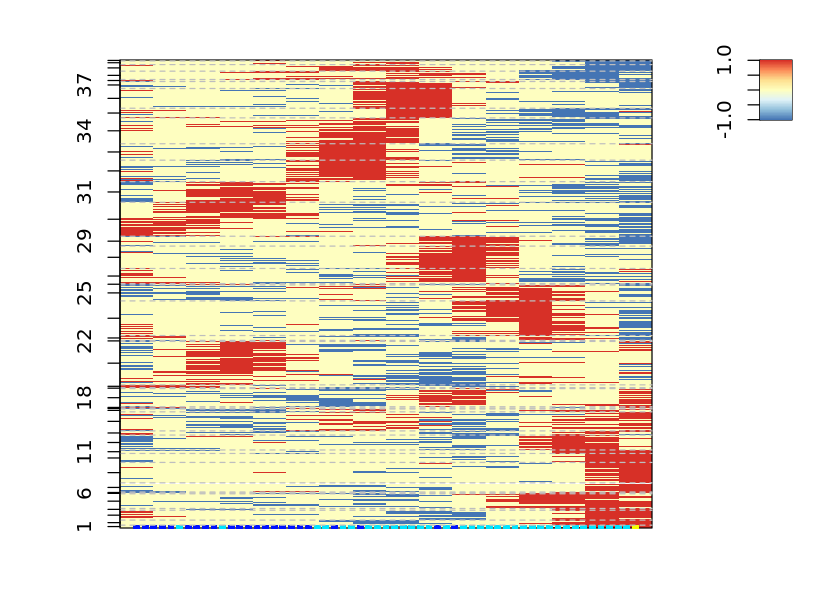

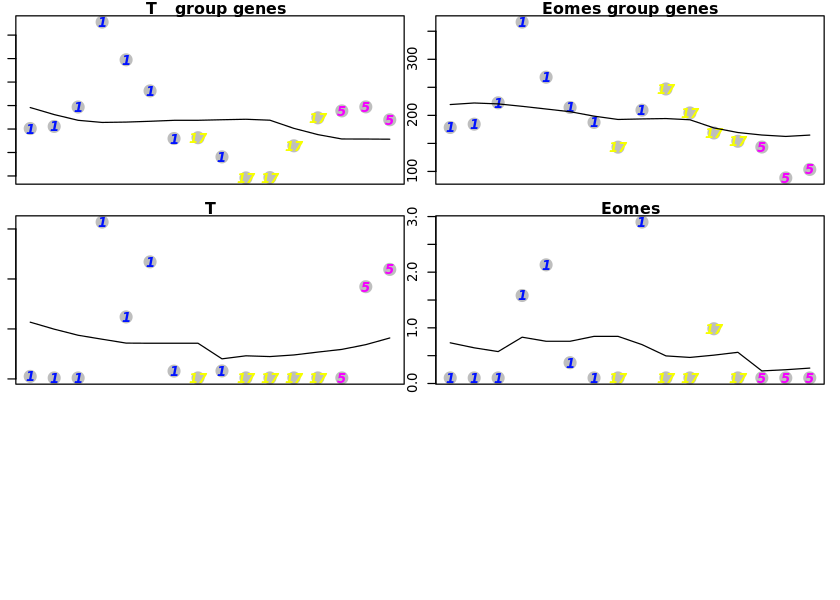

In [710]:
trajExplore(c(1, 17, 5))

Warning message in rbind(...):
“number of columns of result is not a multiple of vector length (arg 2)”

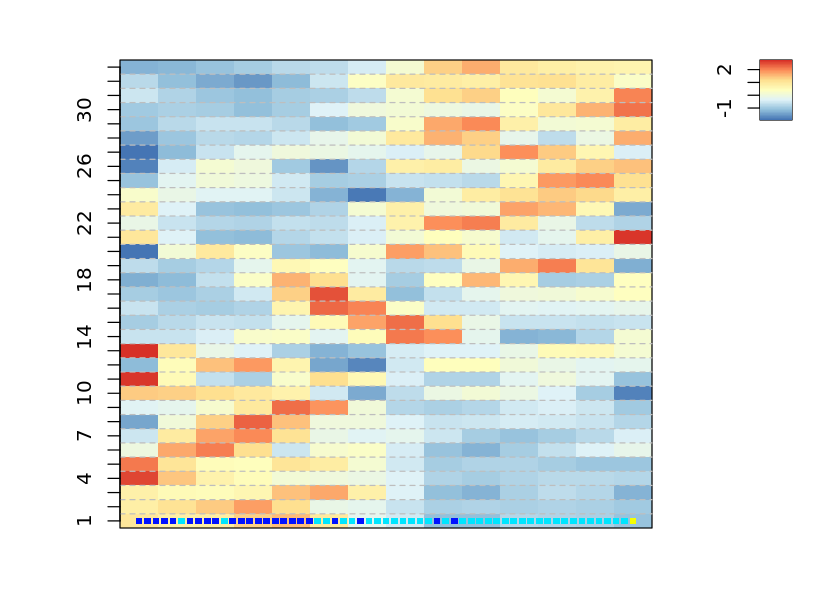

Warning message in min(x):
“no non-missing arguments to min; returning Inf”Warning message in max(x):
“no non-missing arguments to max; returning -Inf”

ERROR: Error in plot.window(...): need finite 'ylim' values


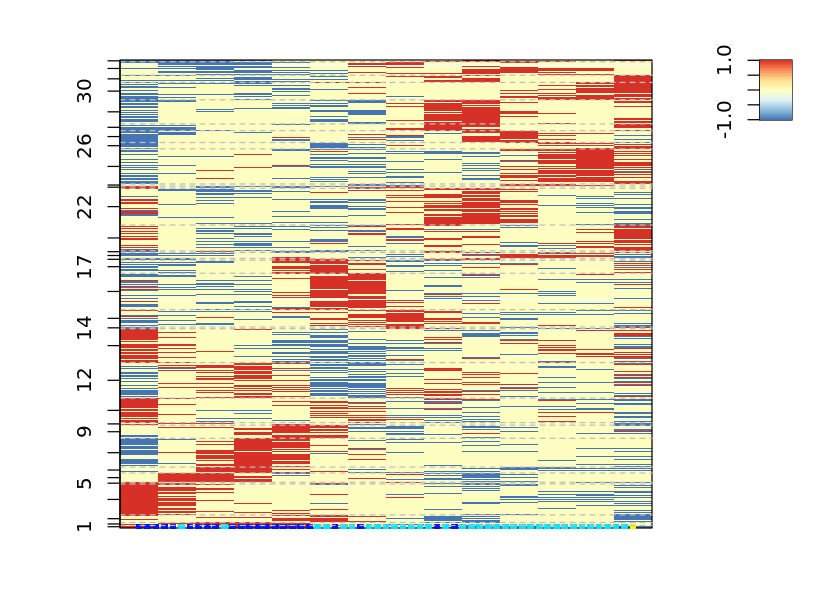

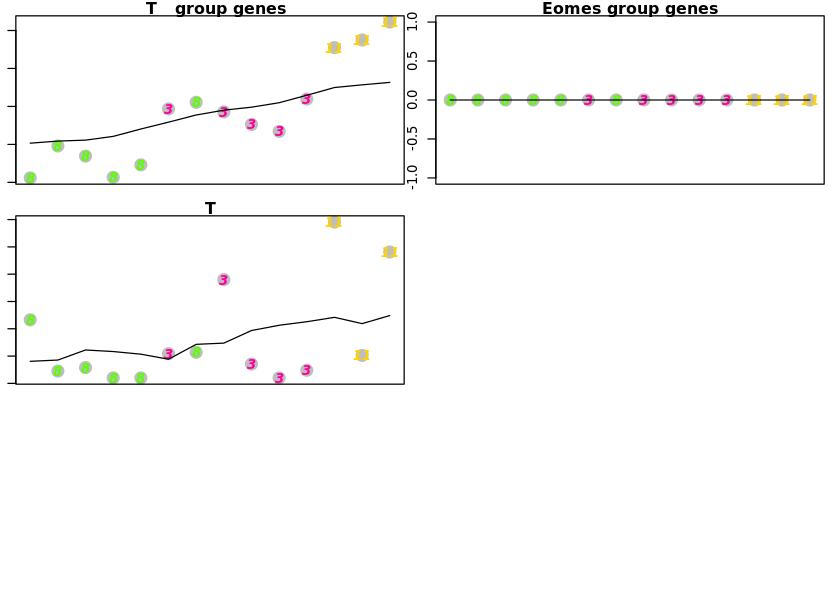

In [712]:
trajExplore(c(8, 3, 11))

Warning message in rbind(...):
“number of columns of result is not a multiple of vector length (arg 1)”

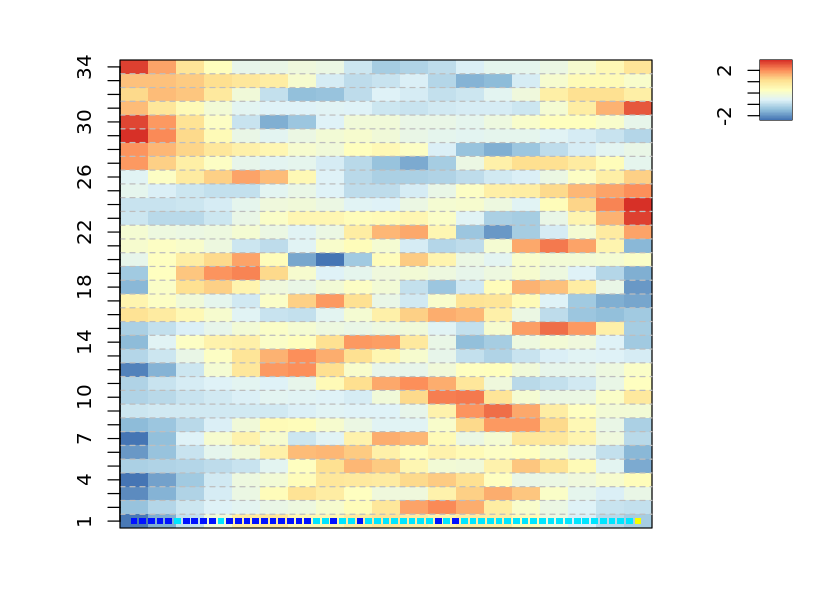

,Node,Num,Genes in same node
T,0,,0
Eomes,14,21,"Baz1b, Ctbp2, Ddx18, Eif4b, Eomes, Gnl3, Iars, Ik, Khdrbs1, L1td1, Mat2a, Mta2, Nap1l1, Pabpc1, Pgm2, Srpk1, Syncrip, Tcea1, U2surp, Zfp36l2, Zfp644"


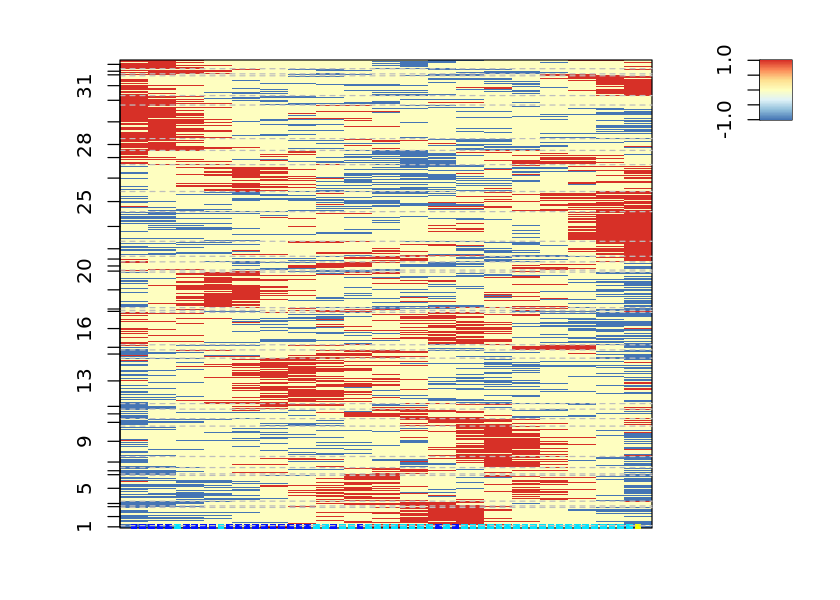

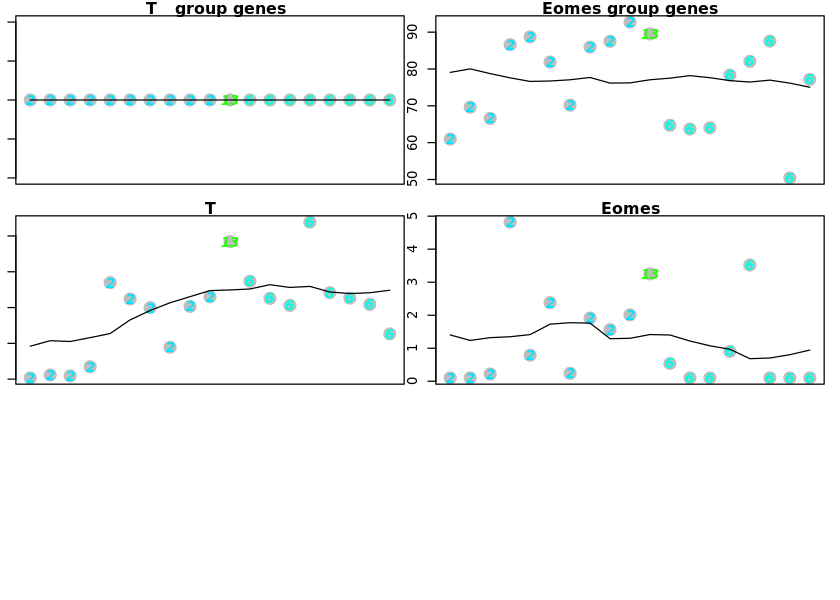

In [711]:
trajExplore(c(2, 13, 6)) # fails...

### Weak branches

Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.975”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.025”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1006”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.975”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = p

“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.975”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.025”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1006”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.975”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.025”Warning message in simpleLoess(y, x, w, span, degr

“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1006”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.975”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.025”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1006”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in sim

“pseudoinverse used at 0.975”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.025”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1006”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.975”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.025”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = para

“neighborhood radius 2.025”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1006”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.975”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.025”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1006”Warning message in simpleLoess(y, x, w, span, degree = de

“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.975”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.025”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1006”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.975”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.025”Warning message in simpleLoess(y, x, w, span, degr

“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1006”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.975”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.025”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1006”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in sim

“pseudoinverse used at 0.975”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.025”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1006”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.975”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.025”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = para

“neighborhood radius 2.025”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1006”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.975”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.025”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1006”Warning message in simpleLoess(y, x, w, span, degree = de

“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.975”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.025”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1006”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.975”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.025”Warning message in simpleLoess(y, x, w, span, degr

“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1006”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.975”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.025”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1006”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in sim

“pseudoinverse used at 0.975”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.025”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1006”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.975”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.025”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = para

“neighborhood radius 2.025”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1006”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.975”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.025”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1006”Warning message in simpleLoess(y, x, w, span, degree = de

“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.975”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.025”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1006”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.975”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.025”Warning message in simpleLoess(y, x, w, span, degr

“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1006”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.975”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.025”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1006”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in sim

“pseudoinverse used at 0.975”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.025”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1006”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.975”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.025”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = para

“neighborhood radius 2.025”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1006”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.975”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.025”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1006”Warning message in simpleLoess(y, x, w, span, degree = de

“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.975”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.025”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1006”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.975”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.025”Warning message in simpleLoess(y, x, w, span, degr

“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1006”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.975”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.025”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1006”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in sim

“pseudoinverse used at 0.975”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.025”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1006”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.975”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.025”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = para

“neighborhood radius 2.025”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1006”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.975”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.025”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1006”Warning message in simpleLoess(y, x, w, span, degree = de

“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.975”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.025”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1006”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.975”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.025”Warning message in simpleLoess(y, x, w, span, degr

“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1006”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.975”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.025”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1006”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in sim

“pseudoinverse used at 0.975”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.025”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1006”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.975”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.025”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = para

“neighborhood radius 2.025”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1006”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.975”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.025”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1006”Warning message in simpleLoess(y, x, w, span, degree = de

“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.975”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.025”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1006”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.975”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.025”Warning message in simpleLoess(y, x, w, span, degr

“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1006”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.975”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.025”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1006”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in sim

“pseudoinverse used at 0.975”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.025”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1006”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.975”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.025”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = para

“neighborhood radius 2.025”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1006”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.975”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.025”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1006”Warning message in simpleLoess(y, x, w, span, degree = de

“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.975”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.025”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1006”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.975”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.025”Warning message in simpleLoess(y, x, w, span, degr

“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1006”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.975”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.025”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1006”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in sim

“pseudoinverse used at 0.975”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.025”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1006”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.975”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.025”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = para

“neighborhood radius 2.025”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1006”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.975”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.025”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1006”Warning message in simpleLoess(y, x, w, span, degree = de

“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.975”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.025”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1006”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.975”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.025”Warning message in simpleLoess(y, x, w, span, degr

“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1006”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.975”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.025”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1006”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in sim

“pseudoinverse used at 0.975”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.025”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1006”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.975”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.025”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = para

“neighborhood radius 2.025”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1006”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.975”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.025”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1006”Warning message in simpleLoess(y, x, w, span, degree = de

“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.975”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.025”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1006”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.975”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.025”Warning message in simpleLoess(y, x, w, span, degr

“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1006”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.975”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.025”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1006”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in sim

“pseudoinverse used at 0.975”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.025”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1006”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.975”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.025”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = para

“neighborhood radius 2.025”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1006”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.975”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.025”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1006”Warning message in simpleLoess(y, x, w, span, degree = de

“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.975”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.025”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1006”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.975”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.025”Warning message in simpleLoess(y, x, w, span, degr

“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1006”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.975”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.025”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1006”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in sim

“pseudoinverse used at 0.975”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.025”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1006”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.975”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.025”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = para

“neighborhood radius 2.025”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1006”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.975”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.025”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1006”Warning message in simpleLoess(y, x, w, span, degree = de

“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.975”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.025”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1006”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.975”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.025”Warning message in simpleLoess(y, x, w, span, degr

“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1006”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.975”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.025”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1006”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in sim

“pseudoinverse used at 0.975”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.025”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1006”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.975”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.025”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = para

“neighborhood radius 2.025”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1006”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.975”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.025”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1006”Warning message in simpleLoess(y, x, w, span, degree = de

“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.975”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.025”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1006”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.975”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.025”Warning message in simpleLoess(y, x, w, span, degr

“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1006”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.975”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.025”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1006”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in sim

“pseudoinverse used at 0.975”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.025”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1006”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.975”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.025”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = para

“neighborhood radius 2.025”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1006”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.975”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.025”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1006”Warning message in simpleLoess(y, x, w, span, degree = de

“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.975”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.025”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1006”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.975”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.025”Warning message in simpleLoess(y, x, w, span, degr

“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1006”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.975”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.025”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1006”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in sim

“pseudoinverse used at 0.975”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.025”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1006”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.975”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.025”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = para

“neighborhood radius 2.025”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1006”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.975”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.025”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1006”Warning message in simpleLoess(y, x, w, span, degree = de

“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.975”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.025”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1006”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.975”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.025”Warning message in simpleLoess(y, x, w, span, degr

“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1006”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.975”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.025”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1006”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in sim

“pseudoinverse used at 0.975”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.025”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1006”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.975”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.025”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = para

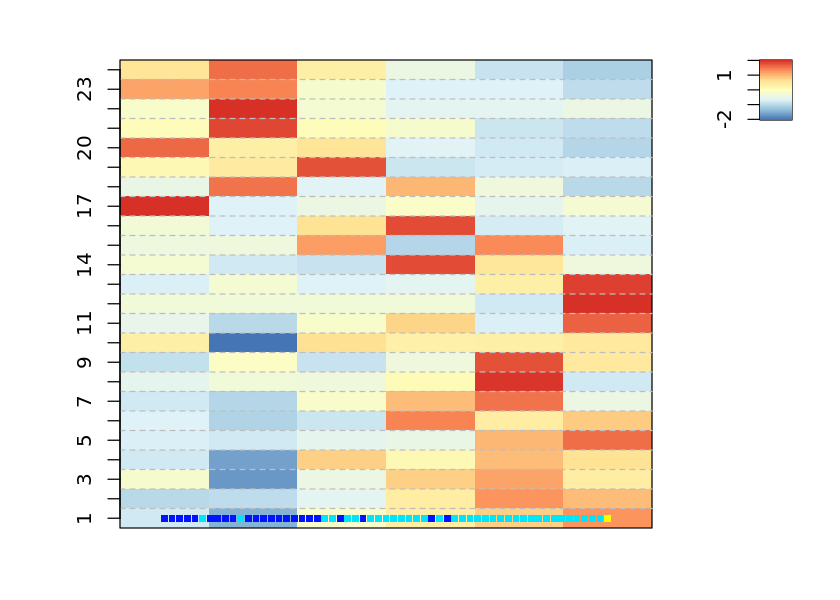

Warning message in min(x):
“no non-missing arguments to min; returning Inf”Warning message in max(x):
“no non-missing arguments to max; returning -Inf”

ERROR: Error in plot.window(...): need finite 'ylim' values


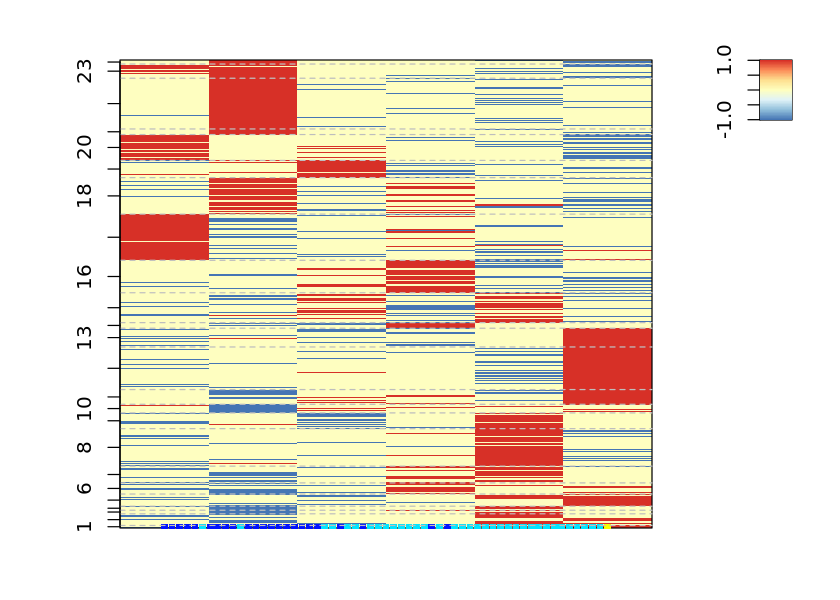

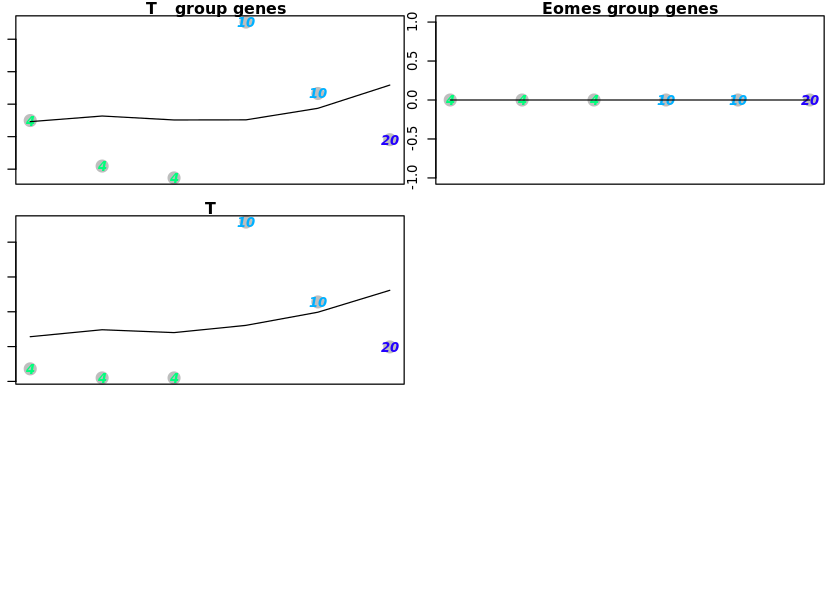

In [713]:
# Not enough values, failed to converge....
trajExplore(c(4, 10, 20))

Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.97”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.03”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1209”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.97”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = para

“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1209”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.97”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.03”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1209”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpl

“pseudoinverse used at 0.97”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.03”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1209”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.97”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.03”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametr

“neighborhood radius 2.03”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1209”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.97”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.03”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1209”Warning message in simpleLoess(y, x, w, span, degree = degre

“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1209”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.97”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.03”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1209”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpl

“pseudoinverse used at 0.97”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.03”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1209”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.97”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.03”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametr

“neighborhood radius 2.03”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1209”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.97”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.03”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1209”Warning message in simpleLoess(y, x, w, span, degree = degre

“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1209”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.97”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.03”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1209”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpl

“pseudoinverse used at 0.97”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.03”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1209”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.97”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.03”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametr

“neighborhood radius 2.03”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1209”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.97”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.03”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1209”Warning message in simpleLoess(y, x, w, span, degree = degre

“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1209”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.97”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.03”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1209”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpl

“pseudoinverse used at 0.97”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.03”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1209”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.97”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.03”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametr

“neighborhood radius 2.03”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1209”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.97”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.03”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1209”Warning message in simpleLoess(y, x, w, span, degree = degre

“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1209”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.97”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.03”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1209”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpl

“pseudoinverse used at 0.97”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.03”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1209”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.97”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.03”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametr

“neighborhood radius 2.03”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1209”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.97”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.03”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1209”Warning message in simpleLoess(y, x, w, span, degree = degre

“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1209”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.97”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.03”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1209”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpl

“pseudoinverse used at 0.97”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.03”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1209”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.97”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.03”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametr

“neighborhood radius 2.03”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1209”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.97”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.03”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1209”Warning message in simpleLoess(y, x, w, span, degree = degre

“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1209”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.97”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.03”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1209”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpl

“pseudoinverse used at 0.97”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.03”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1209”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.97”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.03”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametr

“neighborhood radius 2.03”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1209”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.97”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.03”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1209”Warning message in simpleLoess(y, x, w, span, degree = degre

“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1209”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.97”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.03”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1209”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpl

“pseudoinverse used at 0.97”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.03”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1209”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.97”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.03”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametr

“neighborhood radius 2.03”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1209”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.97”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.03”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1209”Warning message in simpleLoess(y, x, w, span, degree = degre

“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1209”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.97”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.03”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1209”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpl

“pseudoinverse used at 0.97”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.03”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1209”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.97”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.03”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametr

“neighborhood radius 2.03”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1209”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.97”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.03”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1209”Warning message in simpleLoess(y, x, w, span, degree = degre

“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1209”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.97”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.03”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1209”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpl

“pseudoinverse used at 0.97”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.03”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1209”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.97”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.03”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametr

“neighborhood radius 2.03”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1209”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.97”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.03”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1209”Warning message in simpleLoess(y, x, w, span, degree = degre

“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1209”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.97”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.03”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1209”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpl

“pseudoinverse used at 0.97”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.03”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1209”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.97”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.03”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametr

“neighborhood radius 2.03”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1209”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.97”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.03”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1209”Warning message in simpleLoess(y, x, w, span, degree = degre

“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1209”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.97”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.03”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1209”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpl

“pseudoinverse used at 0.97”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.03”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1209”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.97”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.03”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametr

“neighborhood radius 2.03”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1209”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.97”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.03”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1209”Warning message in simpleLoess(y, x, w, span, degree = degre

“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1209”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.97”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.03”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1209”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpl

“pseudoinverse used at 0.97”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.03”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1209”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.97”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.03”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametr

“neighborhood radius 2.03”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1209”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.97”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.03”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1209”Warning message in simpleLoess(y, x, w, span, degree = degre

“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1209”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.97”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.03”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1209”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpl

“pseudoinverse used at 0.97”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.03”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1209”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.97”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.03”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametr

“neighborhood radius 2.03”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1209”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.97”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.03”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1209”Warning message in simpleLoess(y, x, w, span, degree = degre

“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1209”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.97”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.03”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1209”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpl

“pseudoinverse used at 0.97”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.03”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1209”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.97”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.03”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametr

“neighborhood radius 2.03”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1209”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.97”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.03”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1209”Warning message in simpleLoess(y, x, w, span, degree = degre

“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1209”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.97”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.03”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1209”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpl

“pseudoinverse used at 0.97”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.03”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1209”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.97”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.03”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametr

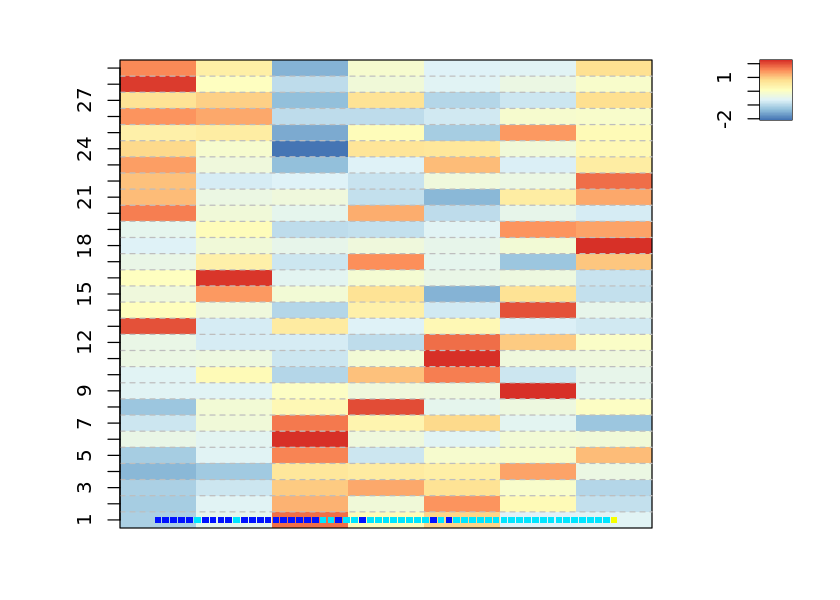

Warning message in min(x):
“no non-missing arguments to min; returning Inf”Warning message in max(x):
“no non-missing arguments to max; returning -Inf”

ERROR: Error in plot.window(...): need finite 'ylim' values


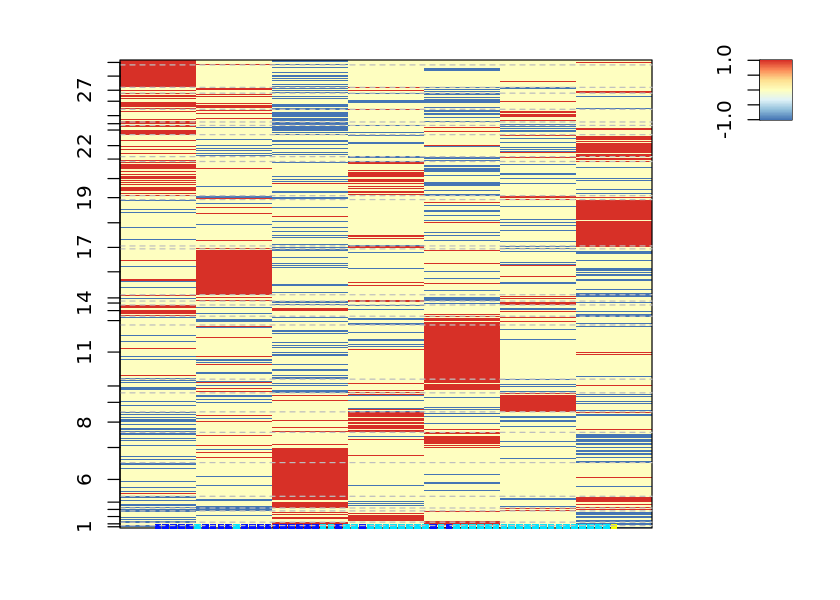

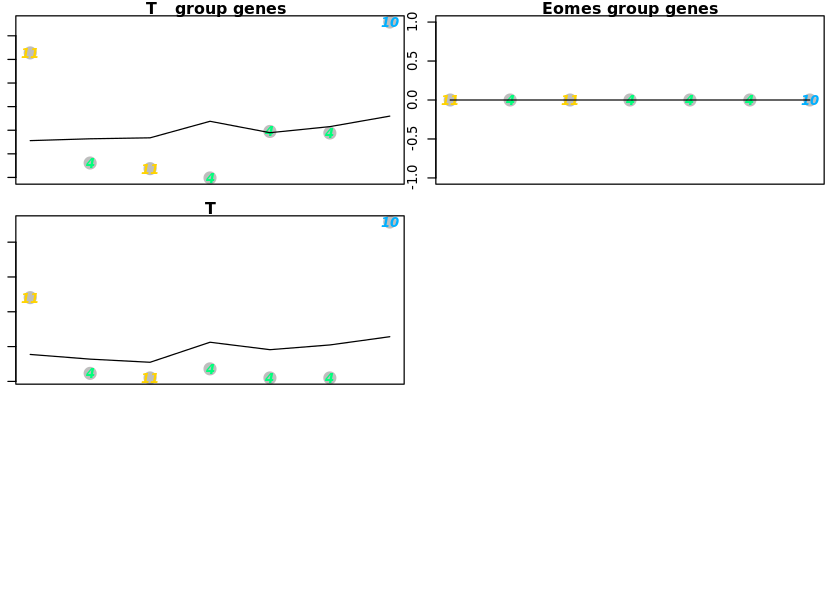

In [714]:
# Also not enough values, failed to converge....
trajExplore(c(11, 4, 10))